<center><h1>1-cd: Convolutional Neural Networks (ConvNets)</h1></center>

<center><h2><a href="https://rdfia.github.io/">Course link</a></h2></center>



In [14]:
#!git clone https://github.com/cdancette/deep-learning-polytech-tp6-7.git
! wget https://github.com/rdfia/rdfia.github.io/raw/master/code/2-cd/utils.py

--2023-11-07 10:09:25--  https://github.com/rdfia/rdfia.github.io/raw/master/code/2-cd/utils.py
Resolving github.com (github.com)... 140.82.113.3
Connecting to github.com (github.com)|140.82.113.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/code/2-cd/utils.py [following]
--2023-11-07 10:09:25--  https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/code/2-cd/utils.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.108.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2627 (2.6K) [text/plain]
Saving to: ‘utils.py’

utils.py            100%[===================>]   2.57K  --.-KB/s    in 0s      

2023-11-07 10:09:25 (47.4 MB/s) - ‘utils.py’ saved [2627/2627]



In [15]:
%run 'utils.py'

In [16]:
import argparse
import os
import time

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim
import torch.utils.data
import torchvision.transforms as transforms
import torchvision.datasets as datasets

from utils import *
from google.colab import drive

PRINT_INTERVAL = 200
PATH="datasets"

In [17]:
# styling and helper packages

import seaborn as sns
from tqdm import tqdm
import matplotlib as mpl

#sns.set_theme()
mpl.rcParams.update(mpl.rcParamsDefault)
mpl.rcParams['lines.markersize'] = 4
plt.style.use('seaborn-white')


<ipython-input-17-24f6f42fbfac>:10: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-white')


# Part 1: Introduction to convolutional networks

In [18]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(1, 6, (5, 5), stride=1, padding=2),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(6, 16, (5, 5), stride=1, padding=0),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(400, 120),
            nn.Tanh(),
            nn.Linear(120, 84),
            nn.Tanh(),
            nn.Linear(84, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.MNIST(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.MNIST(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader


def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


100%|██████████| 9912422/9912422 [00:00<00:00, 105521574.11it/s]


Extracting datasets/MNIST/raw/train-images-idx3-ubyte.gz to datasets/MNIST/raw



100%|██████████| 28881/28881 [00:00<00:00, 39291499.78it/s]


Extracting datasets/MNIST/raw/train-labels-idx1-ubyte.gz to datasets/MNIST/raw



100%|██████████| 1648877/1648877 [00:00<00:00, 29666658.36it/s]


Extracting datasets/MNIST/raw/t10k-images-idx3-ubyte.gz to datasets/MNIST/raw



100%|██████████| 4542/4542 [00:00<00:00, 7358257.54it/s]

Extracting datasets/MNIST/raw/t10k-labels-idx1-ubyte.gz to datasets/MNIST/raw

=== EPOCH 1 =====



[TRAIN Batch 000/469]	Time 2.146s (2.146s)	Loss 2.3127 (2.3127)	Prec@1   6.2 (  6.2)	Prec@5  35.9 ( 35.9)


<Figure size 640x480 with 0 Axes>

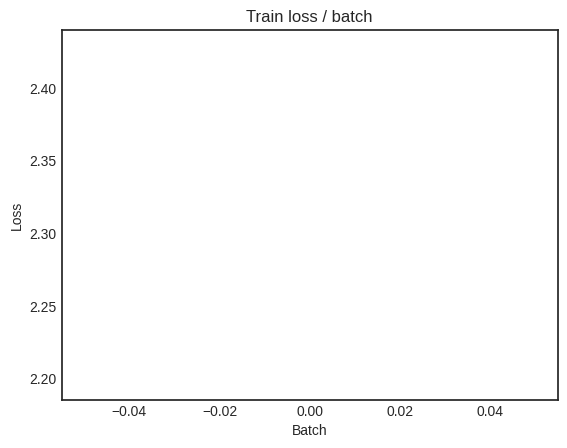

[TRAIN Batch 200/469]	Time 0.042s (0.026s)	Loss 0.3499 (1.1725)	Prec@1  93.0 ( 66.2)	Prec@5  99.2 ( 92.0)


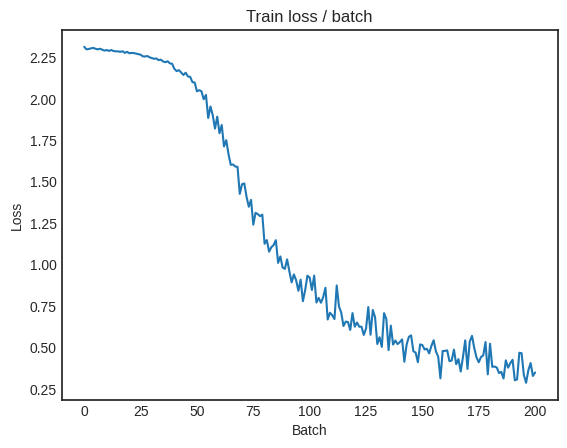

[TRAIN Batch 400/469]	Time 0.004s (0.021s)	Loss 0.1917 (0.7125)	Prec@1  96.9 ( 79.6)	Prec@5 100.0 ( 95.9)


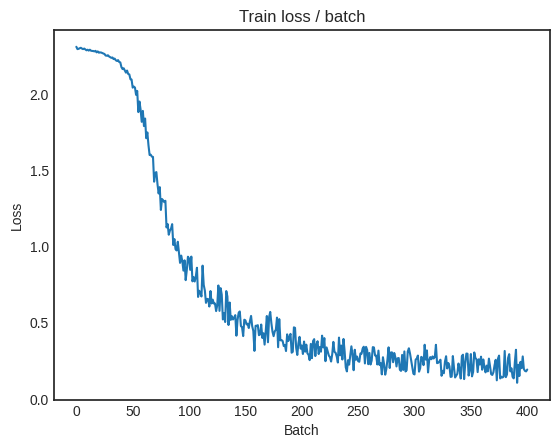


===============> Total time 9s	Avg loss 0.6345	Avg Prec@1 81.84 %	Avg Prec@5 96.44 %

[EVAL Batch 000/079]	Time 0.093s (0.093s)	Loss 0.1003 (0.1003)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.1489	Avg Prec@1 95.60 %	Avg Prec@5 99.97 %



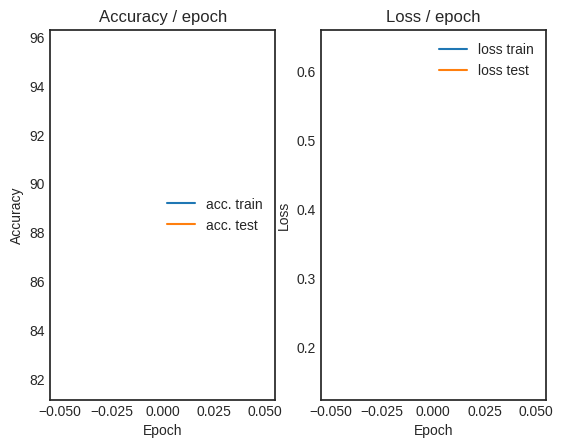

=== EPOCH 2 =====

[TRAIN Batch 000/469]	Time 0.106s (0.106s)	Loss 0.1447 (0.1447)	Prec@1  96.9 ( 96.9)	Prec@5  99.2 ( 99.2)


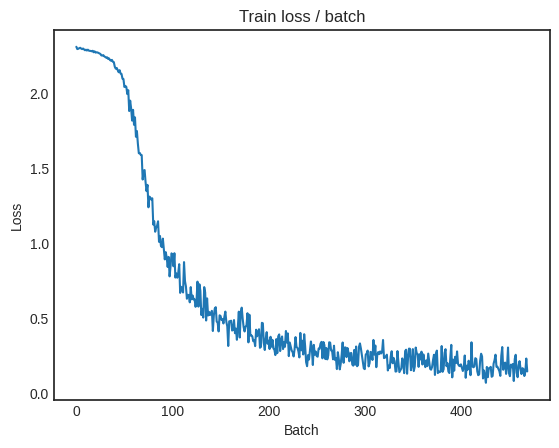

[TRAIN Batch 200/469]	Time 0.015s (0.021s)	Loss 0.0721 (0.1445)	Prec@1  97.7 ( 95.8)	Prec@5 100.0 ( 99.9)


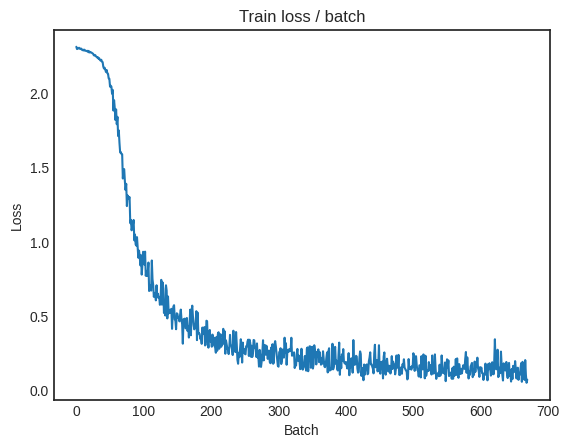

[TRAIN Batch 400/469]	Time 0.004s (0.019s)	Loss 0.0545 (0.1262)	Prec@1  97.7 ( 96.3)	Prec@5 100.0 ( 99.9)


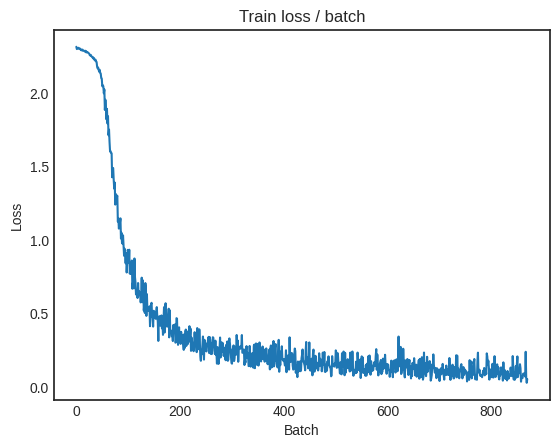


===============> Total time 8s	Avg loss 0.1223	Avg Prec@1 96.38 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.095s (0.095s)	Loss 0.0780 (0.0780)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.1022	Avg Prec@1 96.77 %	Avg Prec@5 99.98 %



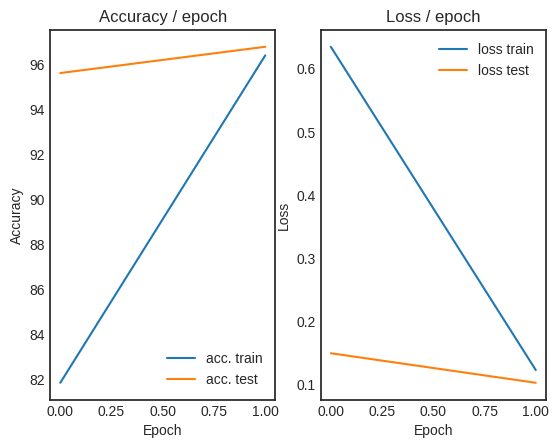

=== EPOCH 3 =====

[TRAIN Batch 000/469]	Time 0.112s (0.112s)	Loss 0.0622 (0.0622)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


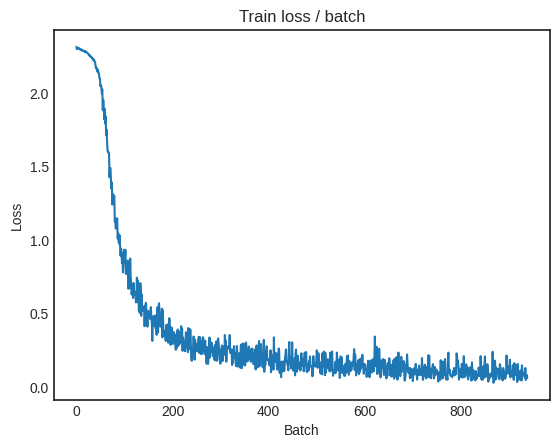

[TRAIN Batch 200/469]	Time 0.003s (0.020s)	Loss 0.1403 (0.0888)	Prec@1  96.1 ( 97.4)	Prec@5 100.0 ( 99.9)


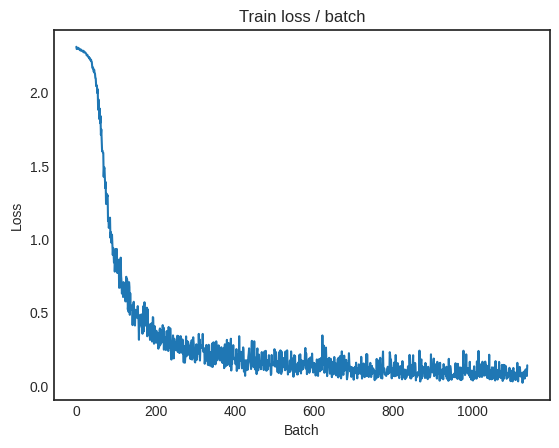

[TRAIN Batch 400/469]	Time 0.007s (0.019s)	Loss 0.1392 (0.0846)	Prec@1  93.8 ( 97.5)	Prec@5 100.0 ( 99.9)


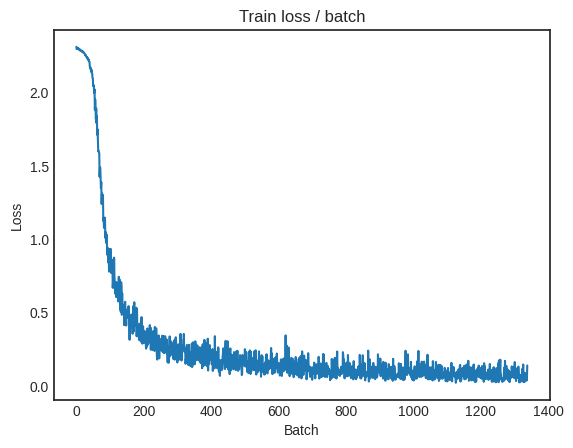


===============> Total time 8s	Avg loss 0.0829	Avg Prec@1 97.58 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.094s (0.094s)	Loss 0.0309 (0.0309)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0742	Avg Prec@1 97.55 %	Avg Prec@5 99.99 %



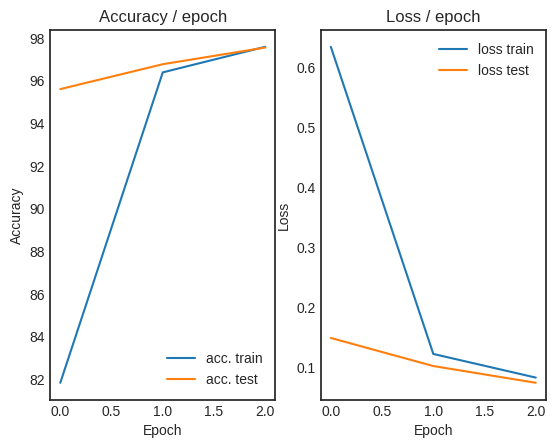

=== EPOCH 4 =====

[TRAIN Batch 000/469]	Time 0.116s (0.116s)	Loss 0.1503 (0.1503)	Prec@1  97.7 ( 97.7)	Prec@5  99.2 ( 99.2)


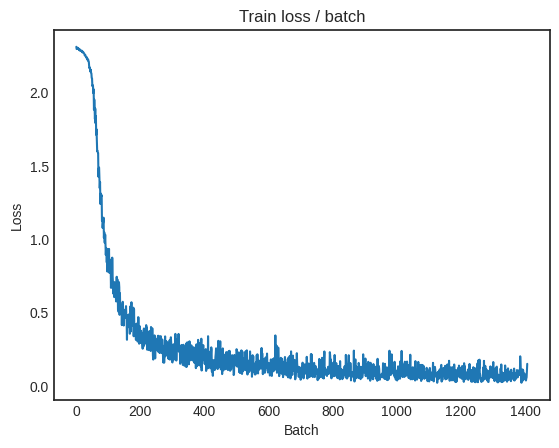

[TRAIN Batch 200/469]	Time 0.004s (0.017s)	Loss 0.0590 (0.0679)	Prec@1  98.4 ( 98.0)	Prec@5 100.0 (100.0)


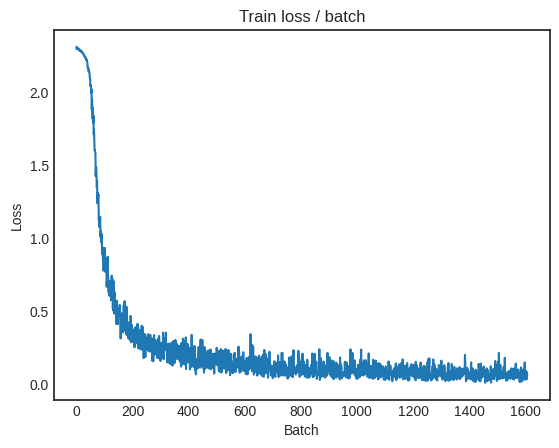

[TRAIN Batch 400/469]	Time 0.004s (0.019s)	Loss 0.0189 (0.0664)	Prec@1 100.0 ( 98.1)	Prec@5 100.0 (100.0)


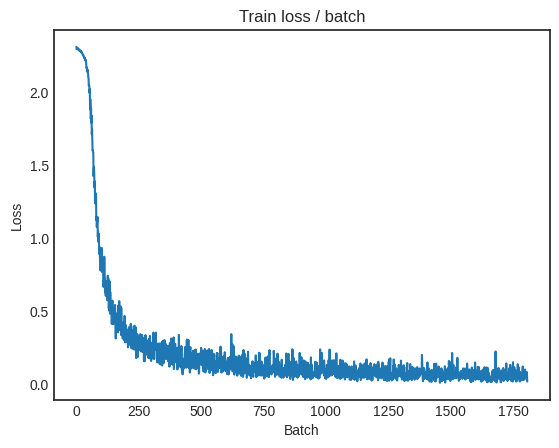


===============> Total time 8s	Avg loss 0.0662	Avg Prec@1 98.07 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.103s (0.103s)	Loss 0.0184 (0.0184)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0545	Avg Prec@1 98.23 %	Avg Prec@5 99.98 %



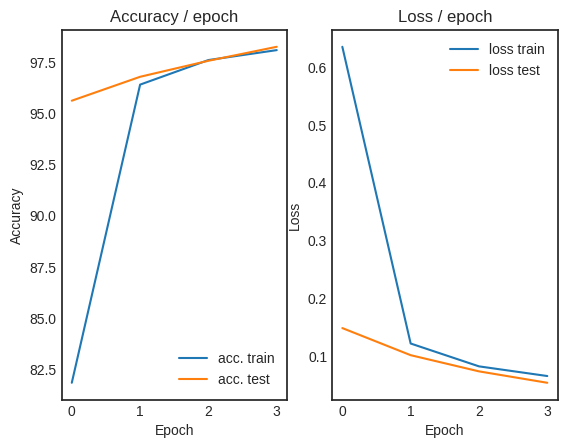

=== EPOCH 5 =====

[TRAIN Batch 000/469]	Time 0.120s (0.120s)	Loss 0.1136 (0.1136)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


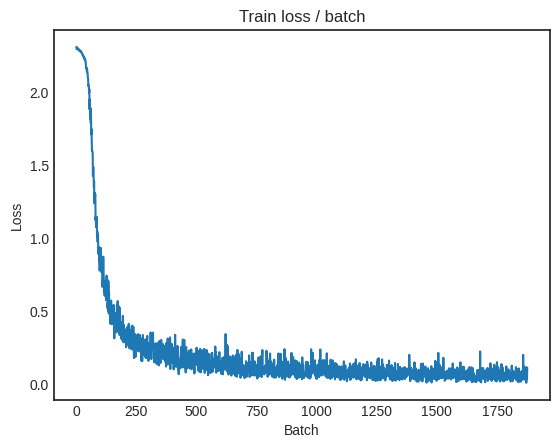

[TRAIN Batch 200/469]	Time 0.025s (0.017s)	Loss 0.0694 (0.0552)	Prec@1  96.9 ( 98.4)	Prec@5 100.0 (100.0)


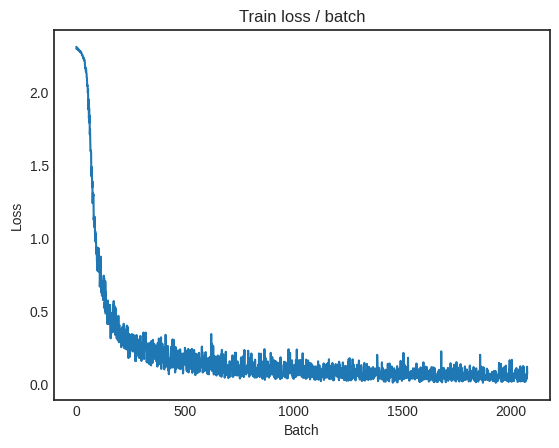

[TRAIN Batch 400/469]	Time 0.048s (0.017s)	Loss 0.0376 (0.0553)	Prec@1  97.7 ( 98.4)	Prec@5 100.0 (100.0)


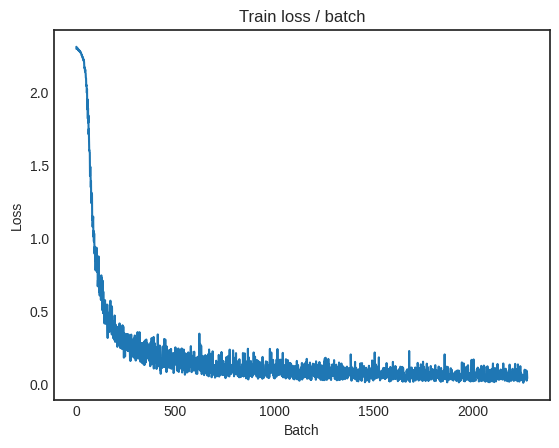


===============> Total time 8s	Avg loss 0.0558	Avg Prec@1 98.33 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.0148 (0.0148)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0473	Avg Prec@1 98.42 %	Avg Prec@5 100.00 %



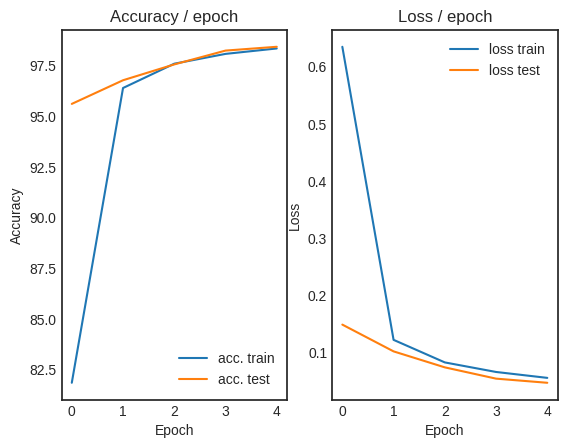

=== EPOCH 6 =====

[TRAIN Batch 000/469]	Time 0.114s (0.114s)	Loss 0.0292 (0.0292)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


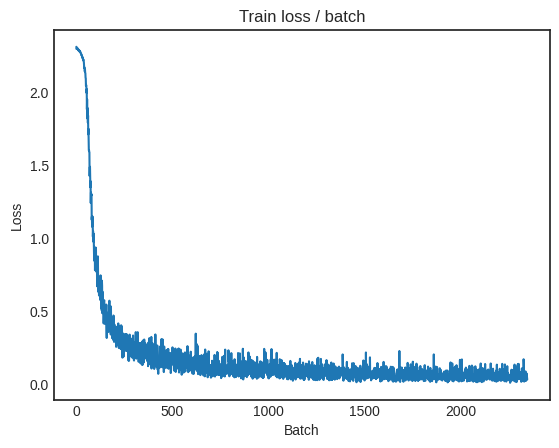

[TRAIN Batch 200/469]	Time 0.028s (0.017s)	Loss 0.0970 (0.0480)	Prec@1  96.9 ( 98.6)	Prec@5 100.0 (100.0)


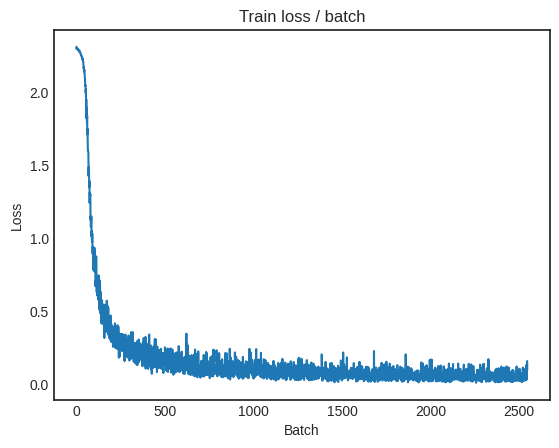

[TRAIN Batch 400/469]	Time 0.003s (0.016s)	Loss 0.0731 (0.0484)	Prec@1  97.7 ( 98.6)	Prec@5 100.0 (100.0)


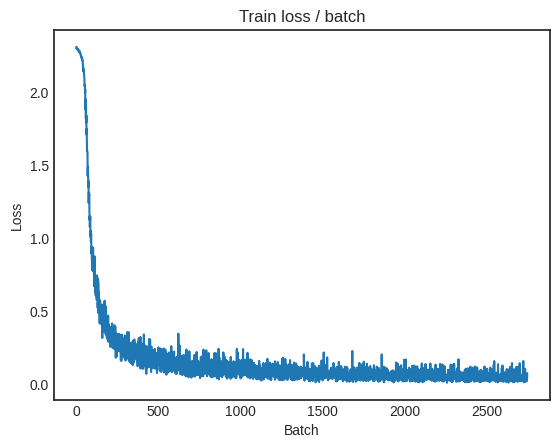


===============> Total time 7s	Avg loss 0.0478	Avg Prec@1 98.60 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.100s (0.100s)	Loss 0.0146 (0.0146)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0421	Avg Prec@1 98.58 %	Avg Prec@5 100.00 %



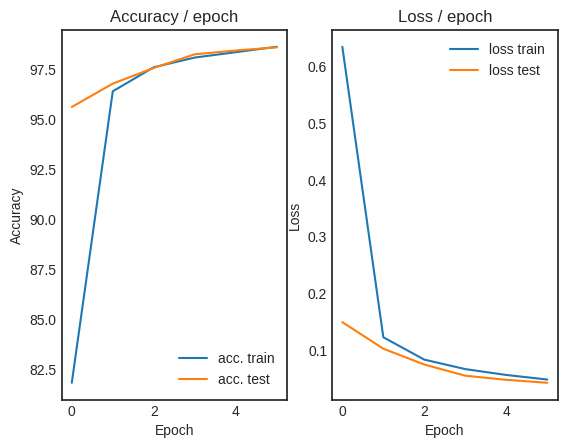

=== EPOCH 7 =====

[TRAIN Batch 000/469]	Time 0.139s (0.139s)	Loss 0.0150 (0.0150)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


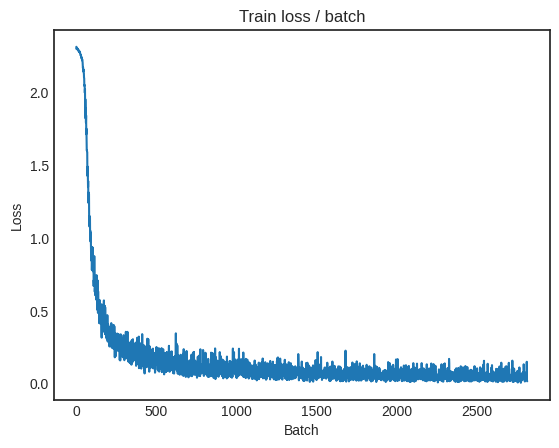

[TRAIN Batch 200/469]	Time 0.020s (0.018s)	Loss 0.0621 (0.0421)	Prec@1  96.1 ( 98.7)	Prec@5 100.0 (100.0)


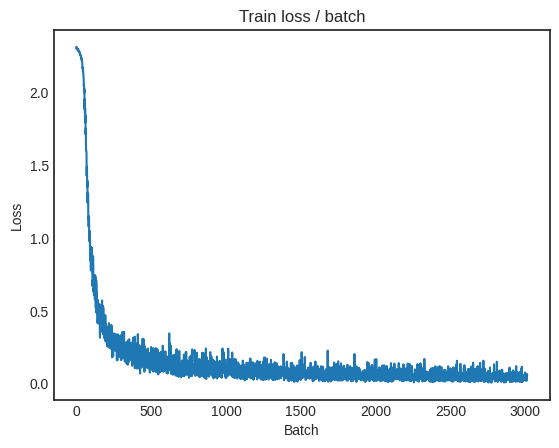

[TRAIN Batch 400/469]	Time 0.003s (0.017s)	Loss 0.0345 (0.0418)	Prec@1  98.4 ( 98.8)	Prec@5 100.0 (100.0)


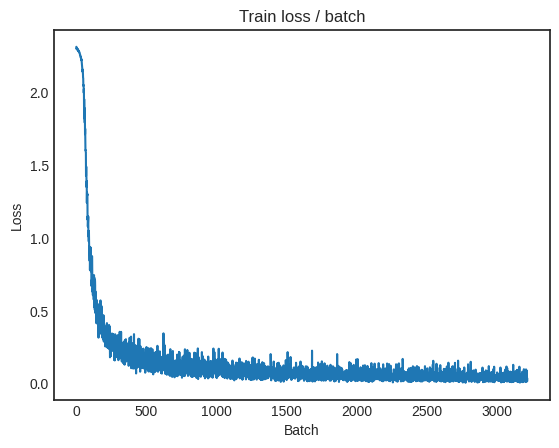


===============> Total time 8s	Avg loss 0.0419	Avg Prec@1 98.75 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.096s (0.096s)	Loss 0.0200 (0.0200)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0421	Avg Prec@1 98.55 %	Avg Prec@5 100.00 %



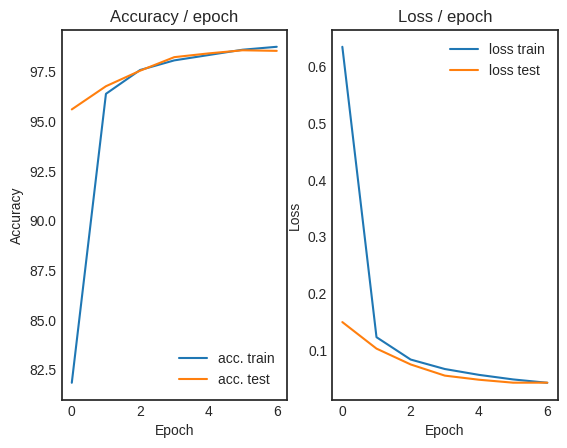

=== EPOCH 8 =====

[TRAIN Batch 000/469]	Time 0.134s (0.134s)	Loss 0.0765 (0.0765)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


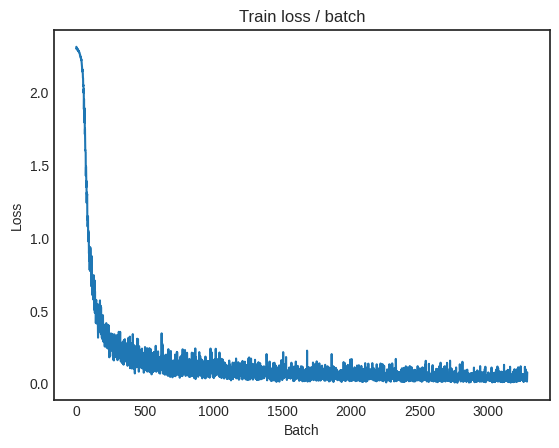

[TRAIN Batch 200/469]	Time 0.025s (0.021s)	Loss 0.0064 (0.0361)	Prec@1 100.0 ( 98.9)	Prec@5 100.0 (100.0)


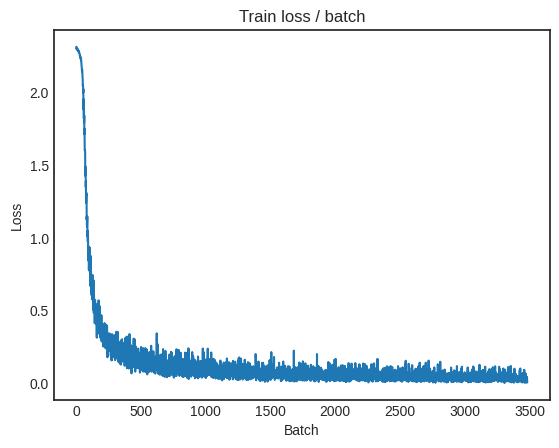

[TRAIN Batch 400/469]	Time 0.004s (0.019s)	Loss 0.0884 (0.0384)	Prec@1  96.9 ( 98.9)	Prec@5 100.0 (100.0)


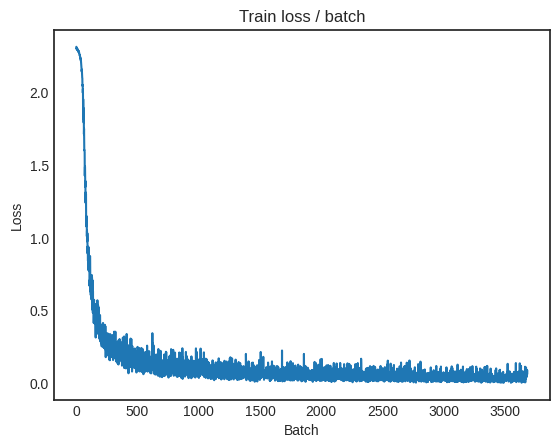


===============> Total time 8s	Avg loss 0.0378	Avg Prec@1 98.89 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.100s (0.100s)	Loss 0.0121 (0.0121)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0395	Avg Prec@1 98.68 %	Avg Prec@5 99.99 %



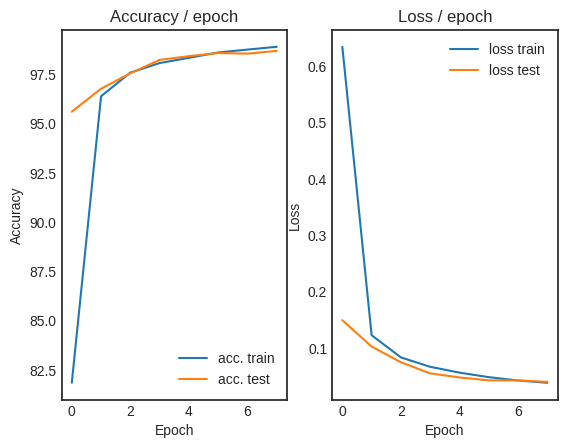

=== EPOCH 9 =====

[TRAIN Batch 000/469]	Time 0.127s (0.127s)	Loss 0.0494 (0.0494)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


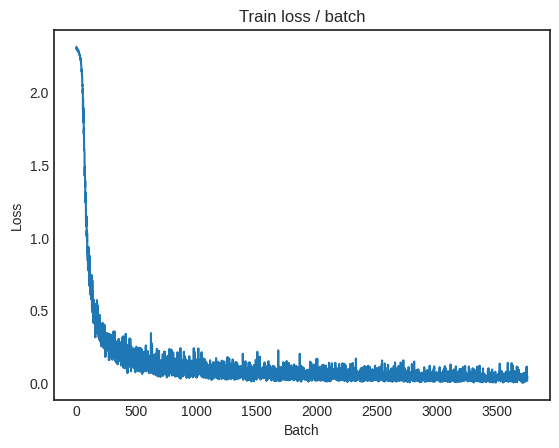

[TRAIN Batch 200/469]	Time 0.003s (0.017s)	Loss 0.0803 (0.0344)	Prec@1  97.7 ( 99.0)	Prec@5 100.0 (100.0)


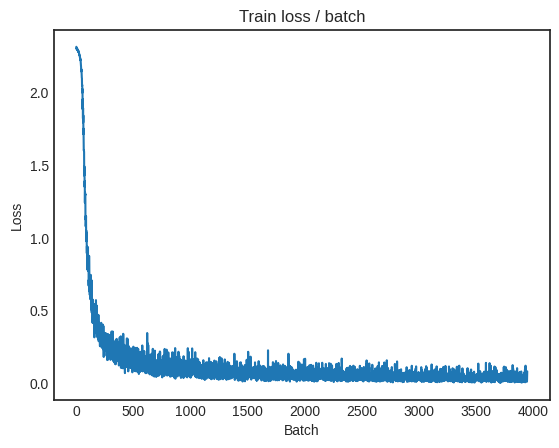

[TRAIN Batch 400/469]	Time 0.023s (0.019s)	Loss 0.0794 (0.0341)	Prec@1  98.4 ( 99.0)	Prec@5 100.0 (100.0)


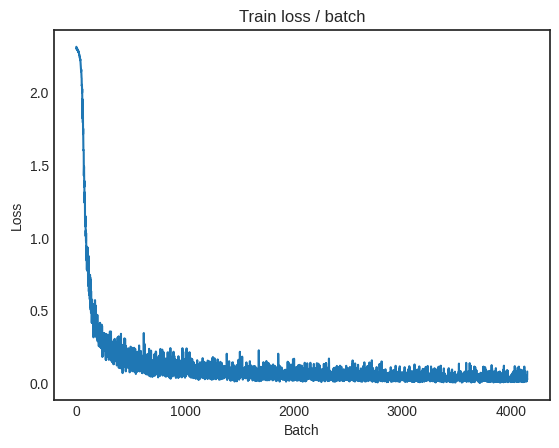


===============> Total time 8s	Avg loss 0.0342	Avg Prec@1 98.99 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.101s (0.101s)	Loss 0.0154 (0.0154)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0354	Avg Prec@1 98.82 %	Avg Prec@5 100.00 %



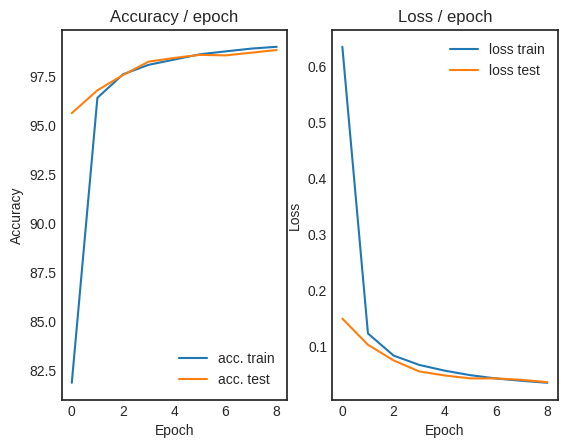

=== EPOCH 10 =====

[TRAIN Batch 000/469]	Time 0.131s (0.131s)	Loss 0.0406 (0.0406)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


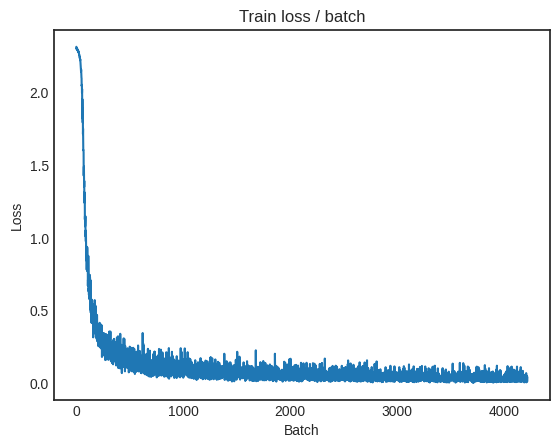

[TRAIN Batch 200/469]	Time 0.015s (0.017s)	Loss 0.0200 (0.0306)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


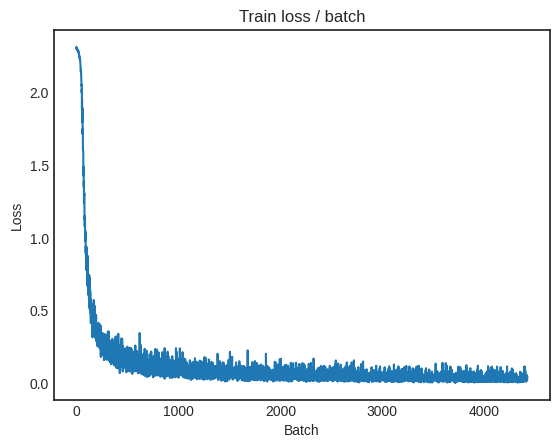

[TRAIN Batch 400/469]	Time 0.048s (0.018s)	Loss 0.0301 (0.0309)	Prec@1  97.7 ( 99.1)	Prec@5 100.0 (100.0)


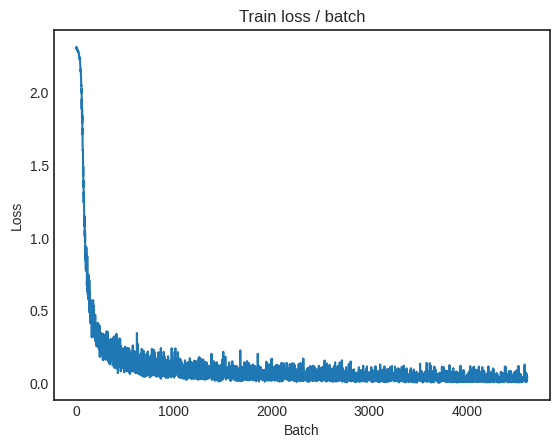


===============> Total time 8s	Avg loss 0.0303	Avg Prec@1 99.14 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.099s (0.099s)	Loss 0.0123 (0.0123)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0353	Avg Prec@1 98.71 %	Avg Prec@5 100.00 %



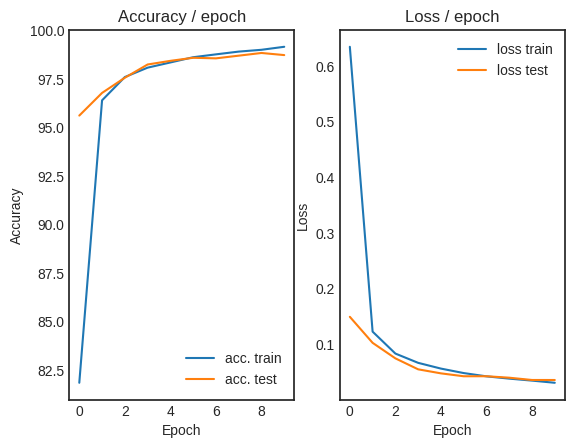

=== EPOCH 11 =====

[TRAIN Batch 000/469]	Time 0.121s (0.121s)	Loss 0.0489 (0.0489)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


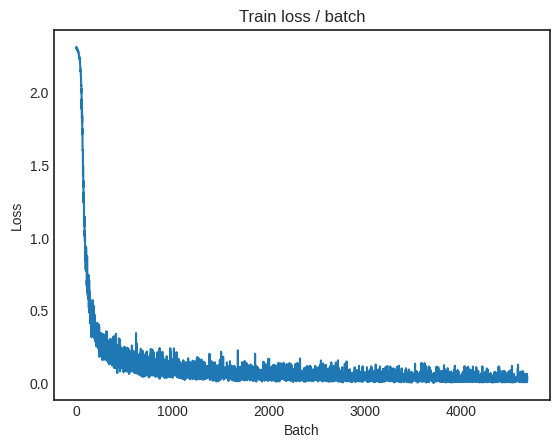

[TRAIN Batch 200/469]	Time 0.026s (0.017s)	Loss 0.0151 (0.0261)	Prec@1 100.0 ( 99.3)	Prec@5 100.0 (100.0)


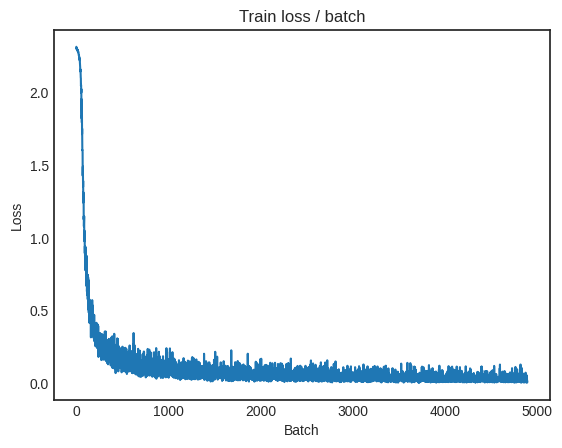

[TRAIN Batch 400/469]	Time 0.005s (0.016s)	Loss 0.0371 (0.0273)	Prec@1  98.4 ( 99.2)	Prec@5 100.0 (100.0)


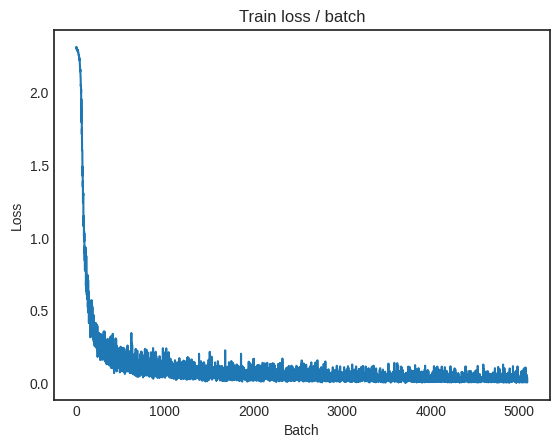


===============> Total time 7s	Avg loss 0.0273	Avg Prec@1 99.21 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.0074 (0.0074)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0347	Avg Prec@1 98.84 %	Avg Prec@5 100.00 %



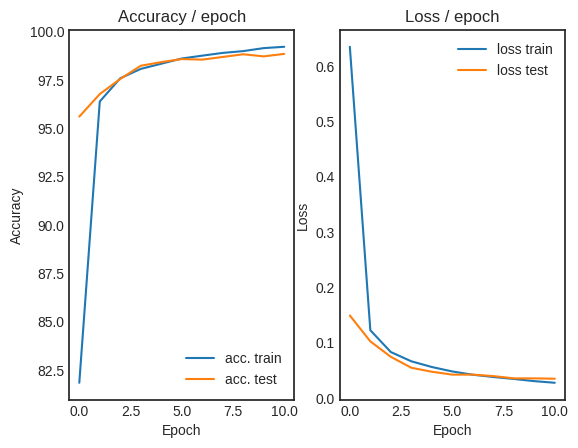

=== EPOCH 12 =====

[TRAIN Batch 000/469]	Time 0.181s (0.181s)	Loss 0.0146 (0.0146)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


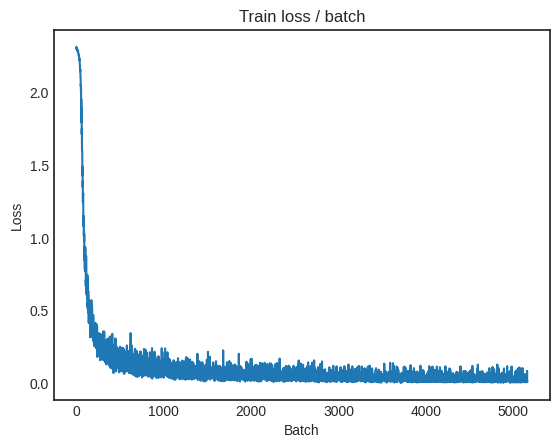

[TRAIN Batch 200/469]	Time 0.022s (0.017s)	Loss 0.0386 (0.0243)	Prec@1  99.2 ( 99.3)	Prec@5 100.0 (100.0)


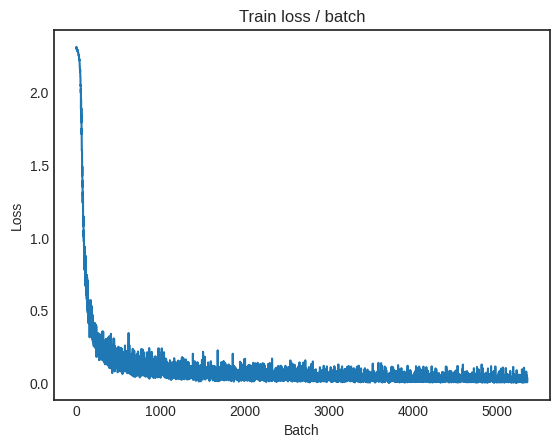

[TRAIN Batch 400/469]	Time 0.010s (0.017s)	Loss 0.0312 (0.0251)	Prec@1  99.2 ( 99.3)	Prec@5 100.0 (100.0)


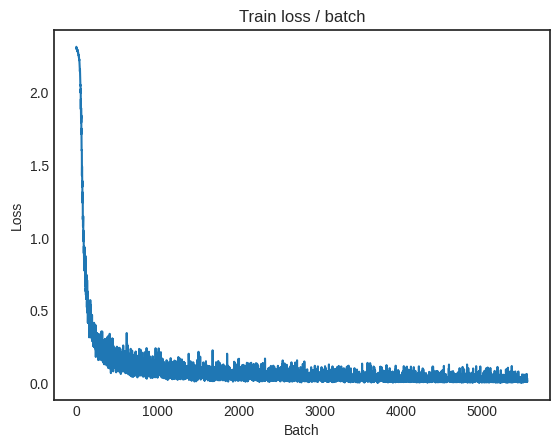


===============> Total time 7s	Avg loss 0.0253	Avg Prec@1 99.25 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.106s (0.106s)	Loss 0.0080 (0.0080)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0332	Avg Prec@1 98.86 %	Avg Prec@5 100.00 %



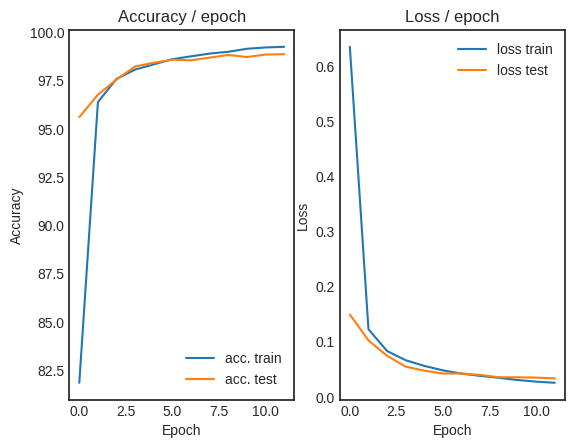

=== EPOCH 13 =====

[TRAIN Batch 000/469]	Time 0.128s (0.128s)	Loss 0.0053 (0.0053)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


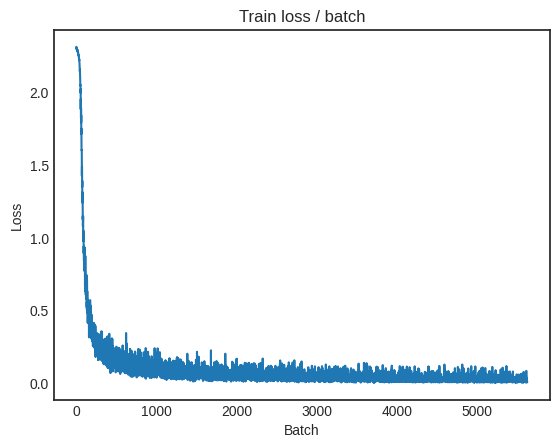

[TRAIN Batch 200/469]	Time 0.027s (0.022s)	Loss 0.0111 (0.0230)	Prec@1 100.0 ( 99.3)	Prec@5 100.0 (100.0)


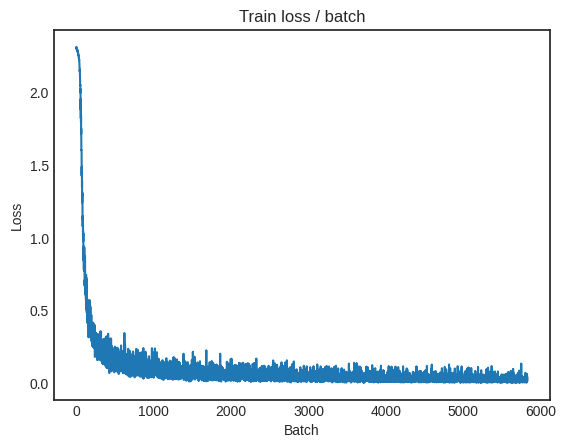

[TRAIN Batch 400/469]	Time 0.016s (0.019s)	Loss 0.0285 (0.0228)	Prec@1  98.4 ( 99.3)	Prec@5 100.0 (100.0)


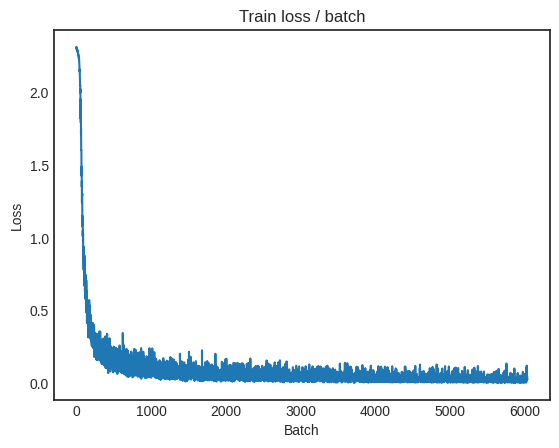


===============> Total time 8s	Avg loss 0.0228	Avg Prec@1 99.33 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.111s (0.111s)	Loss 0.0109 (0.0109)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0373	Avg Prec@1 98.83 %	Avg Prec@5 100.00 %



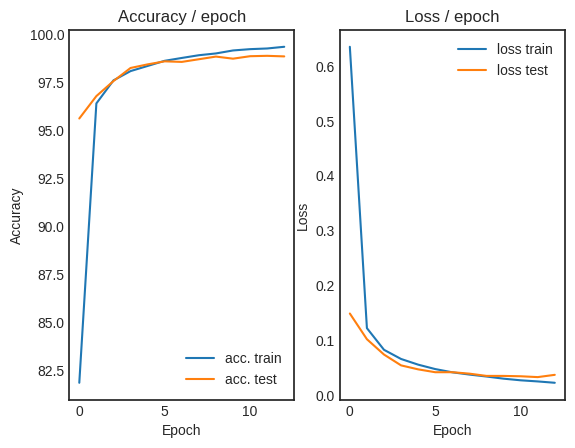

=== EPOCH 14 =====

[TRAIN Batch 000/469]	Time 0.122s (0.122s)	Loss 0.0063 (0.0063)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


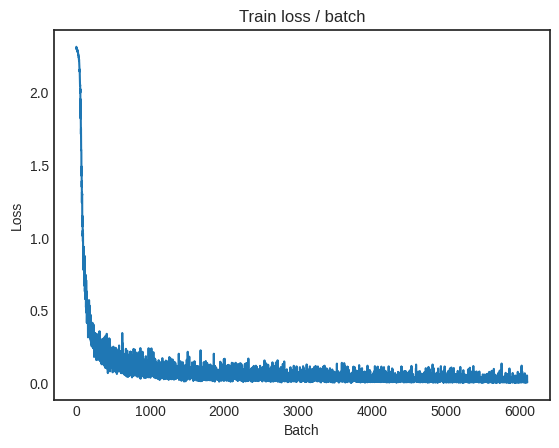

[TRAIN Batch 200/469]	Time 0.003s (0.018s)	Loss 0.0097 (0.0198)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


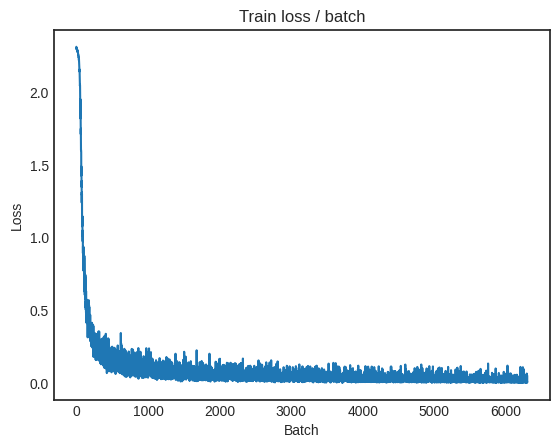

[TRAIN Batch 400/469]	Time 0.005s (0.019s)	Loss 0.0154 (0.0203)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


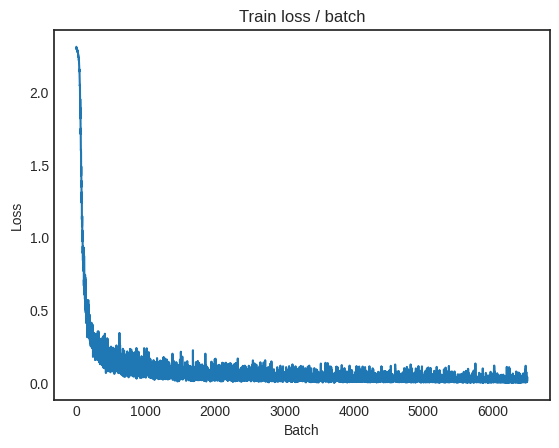


===============> Total time 8s	Avg loss 0.0206	Avg Prec@1 99.46 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 0.0076 (0.0076)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0311	Avg Prec@1 98.94 %	Avg Prec@5 100.00 %



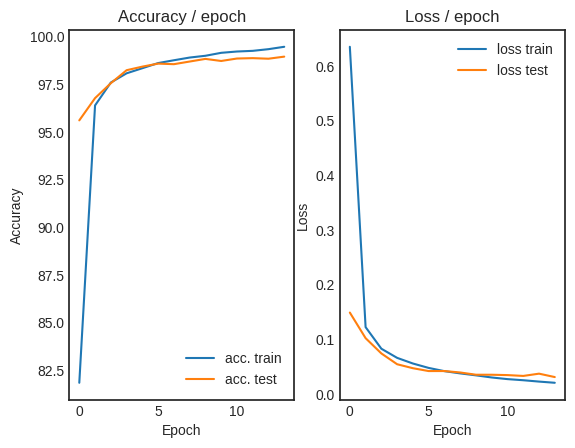

=== EPOCH 15 =====

[TRAIN Batch 000/469]	Time 0.136s (0.136s)	Loss 0.0069 (0.0069)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


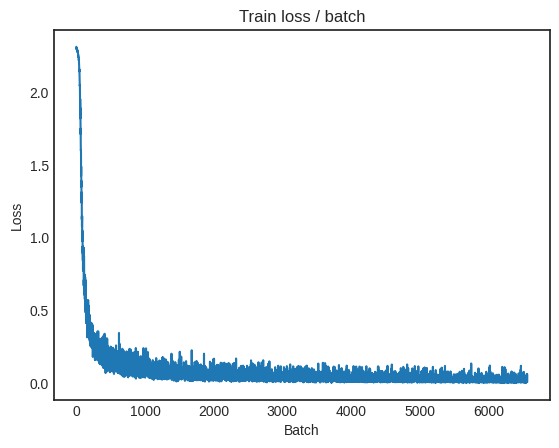

[TRAIN Batch 200/469]	Time 0.028s (0.017s)	Loss 0.0097 (0.0188)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


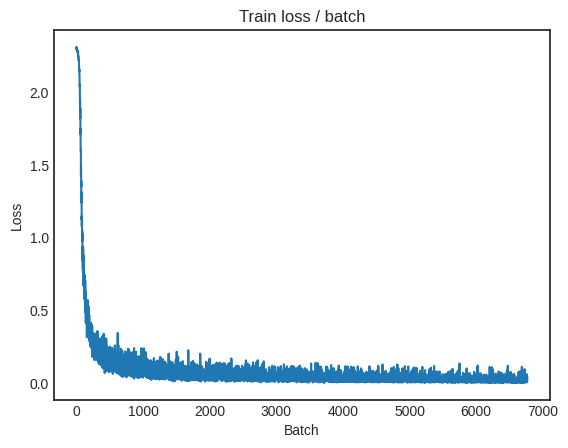

[TRAIN Batch 400/469]	Time 0.024s (0.019s)	Loss 0.0013 (0.0188)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


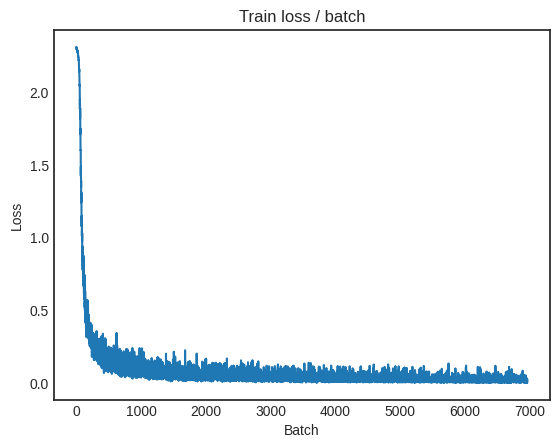


===============> Total time 8s	Avg loss 0.0191	Avg Prec@1 99.48 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.105s (0.105s)	Loss 0.0102 (0.0102)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0347	Avg Prec@1 98.84 %	Avg Prec@5 100.00 %



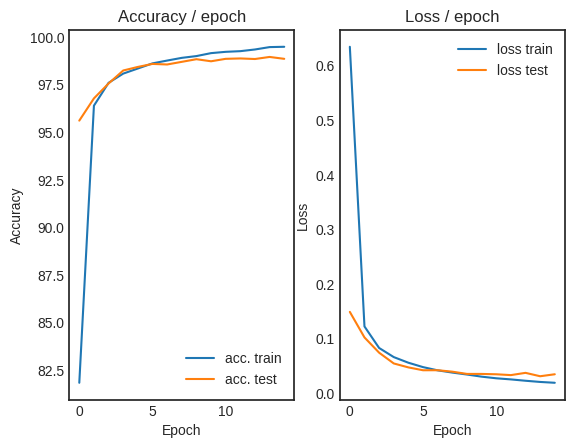

=== EPOCH 16 =====

[TRAIN Batch 000/469]	Time 0.127s (0.127s)	Loss 0.0184 (0.0184)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


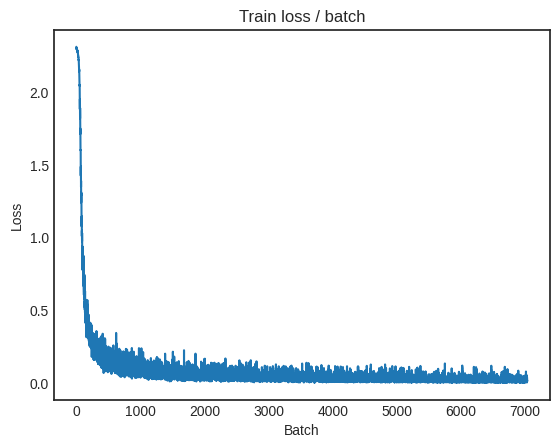

[TRAIN Batch 200/469]	Time 0.004s (0.017s)	Loss 0.0060 (0.0166)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


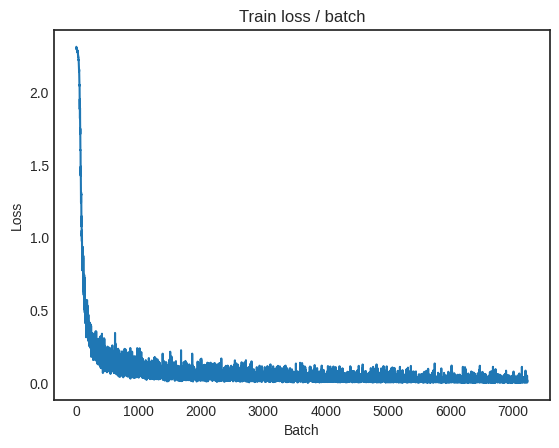

[TRAIN Batch 400/469]	Time 0.004s (0.016s)	Loss 0.0058 (0.0170)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


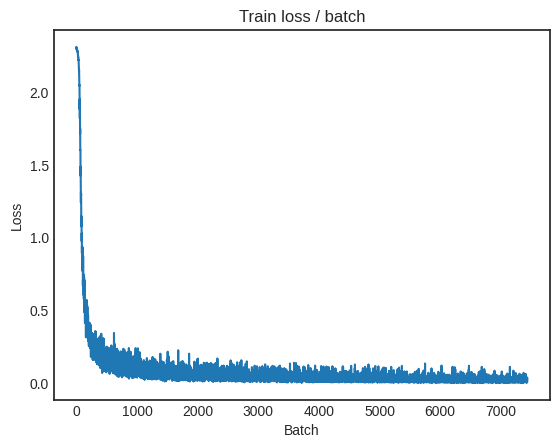


===============> Total time 8s	Avg loss 0.0176	Avg Prec@1 99.53 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.0056 (0.0056)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0321	Avg Prec@1 98.97 %	Avg Prec@5 100.00 %



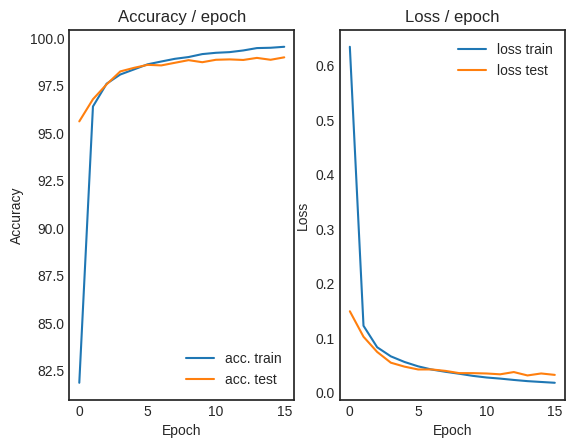

=== EPOCH 17 =====

[TRAIN Batch 000/469]	Time 0.126s (0.126s)	Loss 0.0086 (0.0086)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


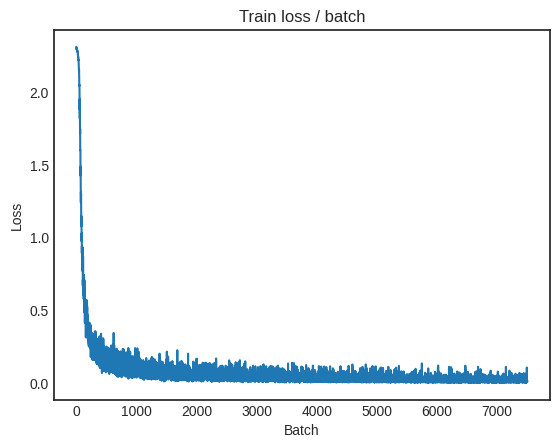

[TRAIN Batch 200/469]	Time 0.003s (0.016s)	Loss 0.0261 (0.0163)	Prec@1  99.2 ( 99.5)	Prec@5 100.0 (100.0)


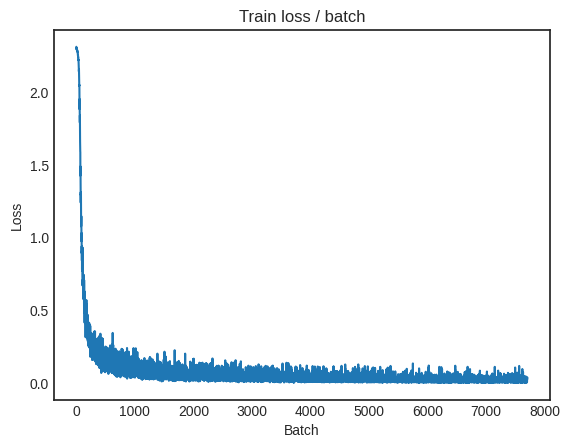

[TRAIN Batch 400/469]	Time 0.019s (0.017s)	Loss 0.0044 (0.0165)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


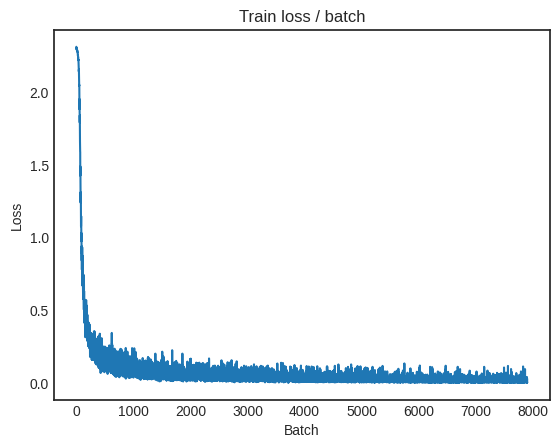


===============> Total time 8s	Avg loss 0.0161	Avg Prec@1 99.57 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.116s (0.116s)	Loss 0.0087 (0.0087)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0341	Avg Prec@1 98.80 %	Avg Prec@5 100.00 %



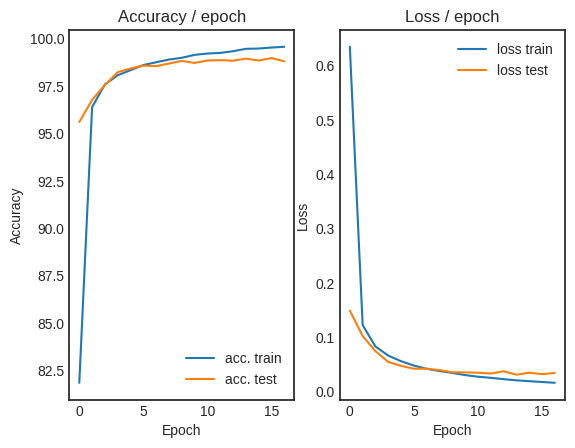

=== EPOCH 18 =====

[TRAIN Batch 000/469]	Time 0.187s (0.187s)	Loss 0.0381 (0.0381)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


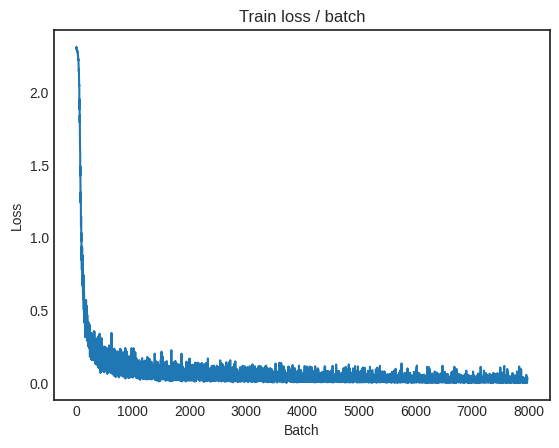

[TRAIN Batch 200/469]	Time 0.004s (0.020s)	Loss 0.0111 (0.0147)	Prec@1  99.2 ( 99.6)	Prec@5 100.0 (100.0)


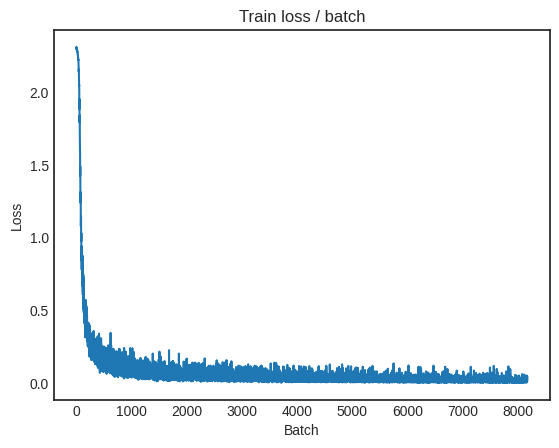

[TRAIN Batch 400/469]	Time 0.021s (0.018s)	Loss 0.0472 (0.0146)	Prec@1  98.4 ( 99.6)	Prec@5 100.0 (100.0)


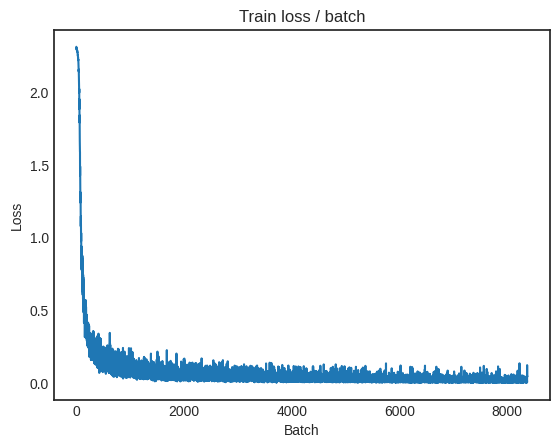


===============> Total time 8s	Avg loss 0.0148	Avg Prec@1 99.60 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.116s (0.116s)	Loss 0.0213 (0.0213)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0340	Avg Prec@1 98.77 %	Avg Prec@5 99.99 %



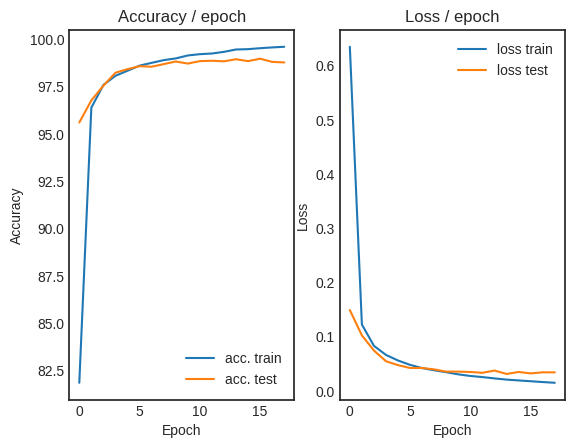

=== EPOCH 19 =====

[TRAIN Batch 000/469]	Time 0.138s (0.138s)	Loss 0.0701 (0.0701)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


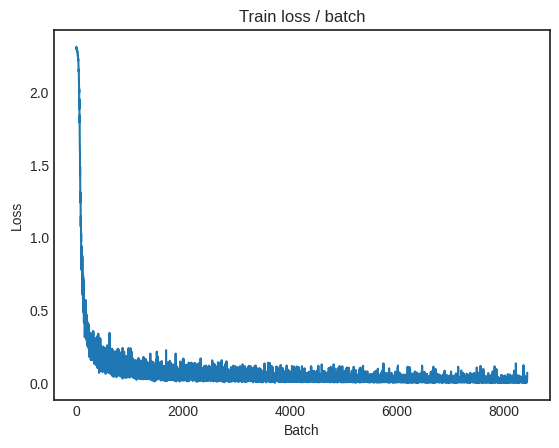

[TRAIN Batch 200/469]	Time 0.003s (0.021s)	Loss 0.0124 (0.0126)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


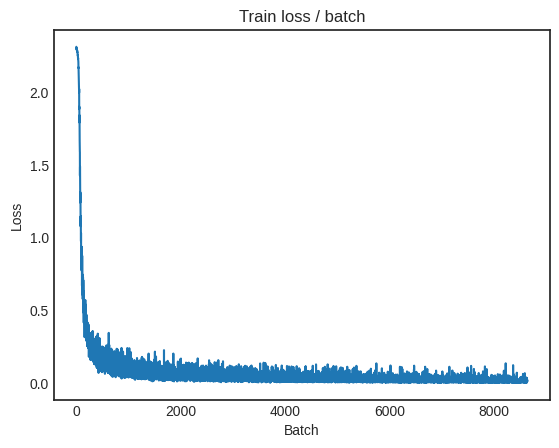

[TRAIN Batch 400/469]	Time 0.003s (0.019s)	Loss 0.0043 (0.0138)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


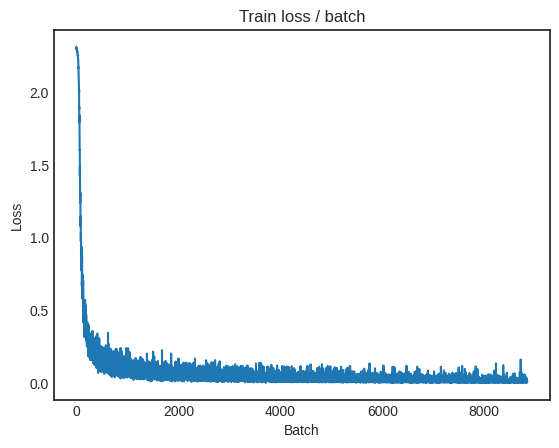


===============> Total time 9s	Avg loss 0.0137	Avg Prec@1 99.64 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.124s (0.124s)	Loss 0.0062 (0.0062)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0313	Avg Prec@1 99.05 %	Avg Prec@5 100.00 %



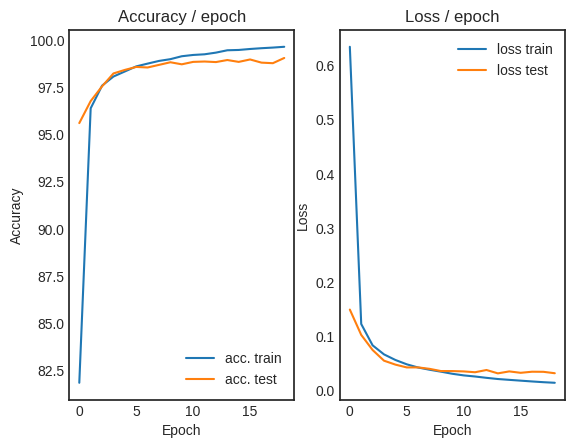

=== EPOCH 20 =====

[TRAIN Batch 000/469]	Time 0.133s (0.133s)	Loss 0.0046 (0.0046)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


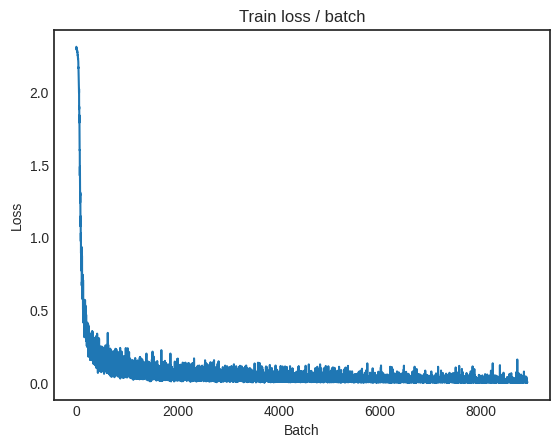

[TRAIN Batch 200/469]	Time 0.015s (0.017s)	Loss 0.0027 (0.0124)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


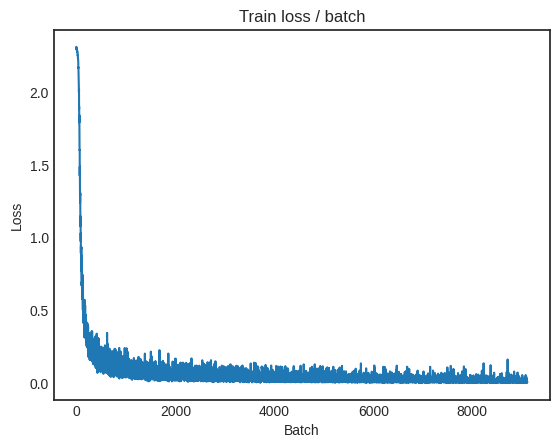

[TRAIN Batch 400/469]	Time 0.003s (0.019s)	Loss 0.0060 (0.0124)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


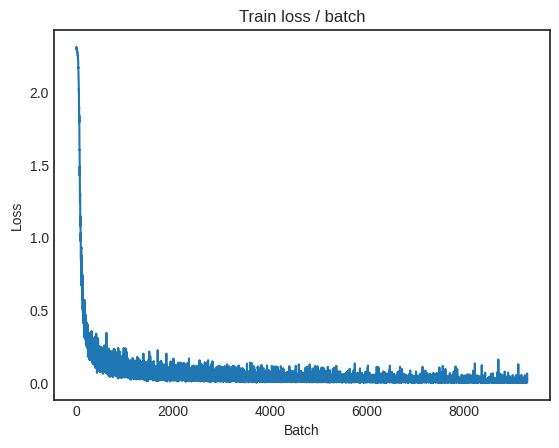


===============> Total time 8s	Avg loss 0.0124	Avg Prec@1 99.69 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.107s (0.107s)	Loss 0.0043 (0.0043)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0306	Avg Prec@1 98.89 %	Avg Prec@5 100.00 %



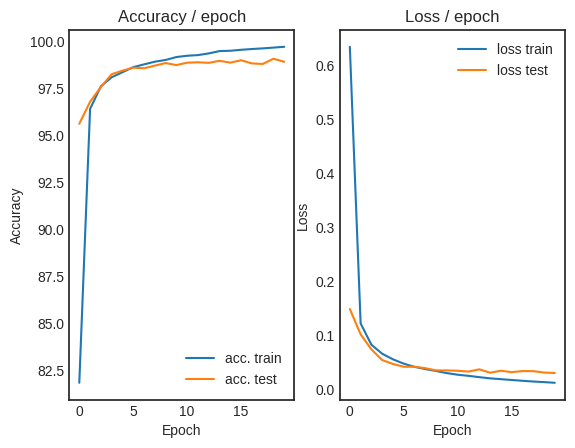

In [19]:
main(128, 0.1, 20, cuda=True)

# Part 2 : Training from scratch of the model

## 2.1 Network architecture

- conv1 : 32 convolutions 5 × 5, followed by ReLU
- pool1 : max-pooling 2 × 2
- conv2 : 64 convolutions 5 × 5, followed by ReLU
- pool2 : max-pooling 2 × 2
- conv3 : 64 convolutions 5 × 5, followed by ReLU
- pool3 : max-pooling 2 × 2
- fc4 : fully-connected, 1000 output neurons, followed by ReLU
- fc5 : fully-connected, 10 neurons output, followed by softmax

In [20]:
class ConvNet2(nn.Module):
    def __init__(self, channels = 3):
        super(ConvNet2, self).__init__()

        self.channels = channels # to handle color images
        self.conv1 = 32
        self.conv2 = 64
        self.conv3 = 64
        self.fc4 = 1000
        self.fc5 = 10

        # conv net as feature extractor
        self.features = nn.Sequential(
            #--> input: [4, 3, 32, 32] rgb image
            nn.Conv2d(self.channels, 32, (5, 5), stride=1, padding=2), # --> output: [4, 32, 32, 32]
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0), # --> output: [4, 32, 16, 16]

            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2), # --> output: [4, 64, 16, 16]
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0), #--> ouput: [4, 64, 8, 8])

            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2), # --> output: [4, 64, 8, 8]
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0), #--> output: [4, 64, 4, 4])
        )

        self.classifier = nn.Sequential(
            nn.Linear(64 * 4 * 4, self.fc4), # --> output: [4, 1000]
            nn.ReLU(),
            nn.Linear(self.fc4, self.fc5), # --> output: [4, 10]

            # Reminder: The softmax is included in the loss, do not put it here
            # nn.Softmax()
        )


    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers

        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers

        return output

In [21]:
# adapting the dataset function to CIFAR10

def get_dataset_CIFAR(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

In [22]:
CNN_CIFAR = ConvNet2()

100%|██████████| 170498071/170498071 [00:05<00:00, 29851001.50it/s]


Extracting datasets/cifar-10-python.tar.gz to datasets
Files already downloaded and verified
Input shape =  torch.Size([4, 3, 32, 32])


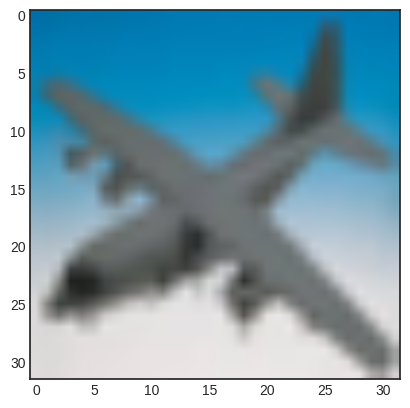

Output shape =  torch.Size([4, 10])


In [23]:
train, test = get_dataset_CIFAR(batch_size = 4, cuda = True)

for i, (input, target) in enumerate(train):
  if i == 2:
    print('Input shape = ', input.shape)
    plt.imshow(input[0].permute(1,2,0).detach().numpy(), interpolation = 'bilinear')
    plt.show()

    output = CNN_CIFAR(input)
    print('Output shape = ', output.shape)
    break

In [24]:
# Count number of (learnable) model paramters

model_parameters = filter(lambda p: p.requires_grad, CNN_CIFAR.parameters())
num_params = sum([np.prod(p.size()) for p in model_parameters])

print(num_params)

1191170


## 2.2 Network learning

In [25]:
# test new dataloader function

classes = ('plane', 'car', 'bird', 'cat',
           'deer', 'dog', 'frog', 'horse', 'ship', 'truck')

CIFAR10 = get_dataset_CIFAR(batch_size = 16, cuda = True)

Files already downloaded and verified
Files already downloaded and verified


In [26]:
# make modifications to main function to accomodate CIFAR10

def main_CIFAR(batch_size=128, lr=0.1, epochs=25, cuda=True):

    # ex :{"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet2()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset_CIFAR(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.625s (0.625s)	Loss 2.3060 (2.3060)	Prec@1   6.2 (  6.2)	Prec@5  41.4 ( 41.4)


<Figure size 640x480 with 0 Axes>

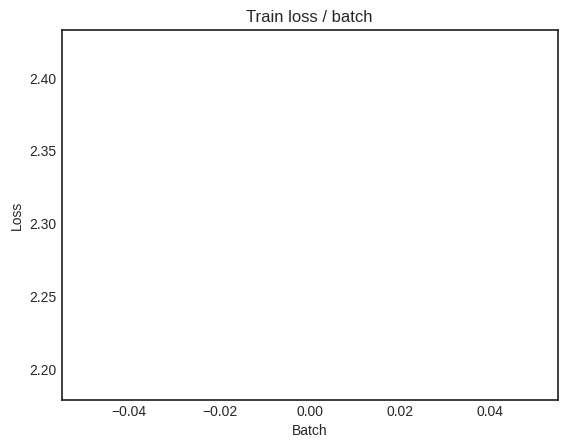

[TRAIN Batch 200/391]	Time 0.070s (0.024s)	Loss 2.0428 (2.2165)	Prec@1  31.2 ( 17.5)	Prec@5  75.0 ( 64.2)


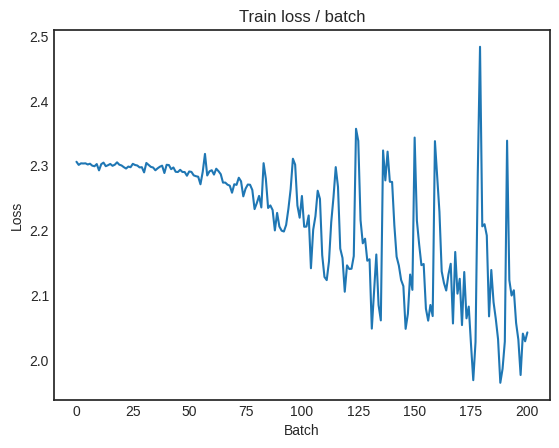


===============> Total time 10s	Avg loss 2.1317	Avg Prec@1 21.72 %	Avg Prec@5 70.58 %

[EVAL Batch 000/079]	Time 0.111s (0.111s)	Loss 2.1284 (2.1284)	Prec@1  21.1 ( 21.1)	Prec@5  68.0 ( 68.0)

===============> Total time 1s	Avg loss 2.0845	Avg Prec@1 24.72 %	Avg Prec@5 70.33 %



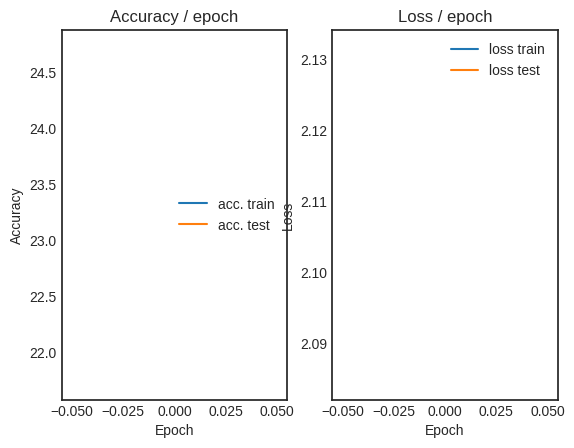

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 2.0455 (2.0455)	Prec@1  26.6 ( 26.6)	Prec@5  73.4 ( 73.4)


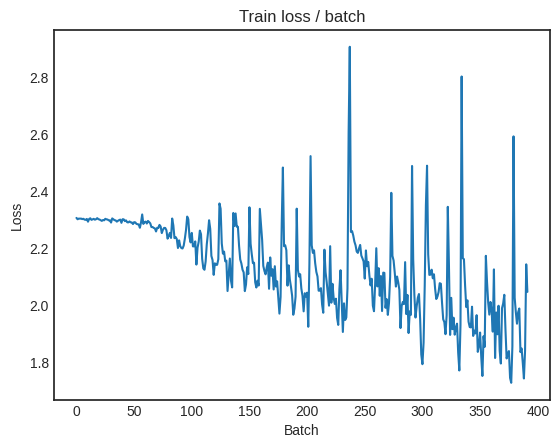

[TRAIN Batch 200/391]	Time 0.013s (0.023s)	Loss 1.7162 (1.7666)	Prec@1  36.7 ( 36.1)	Prec@5  88.3 ( 86.2)


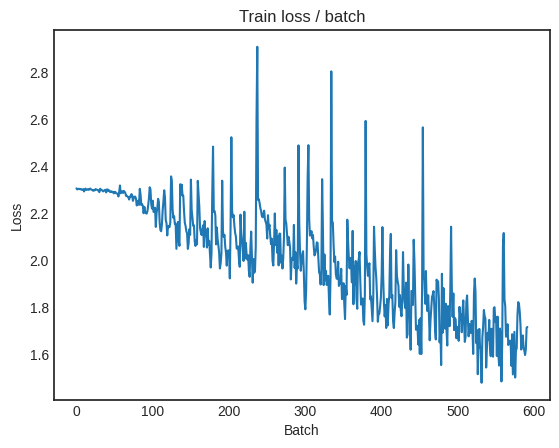


===============> Total time 9s	Avg loss 1.6740	Avg Prec@1 39.39 %	Avg Prec@5 88.17 %

[EVAL Batch 000/079]	Time 0.116s (0.116s)	Loss 1.5115 (1.5115)	Prec@1  47.7 ( 47.7)	Prec@5  89.8 ( 89.8)

===============> Total time 1s	Avg loss 1.5255	Avg Prec@1 44.81 %	Avg Prec@5 90.91 %



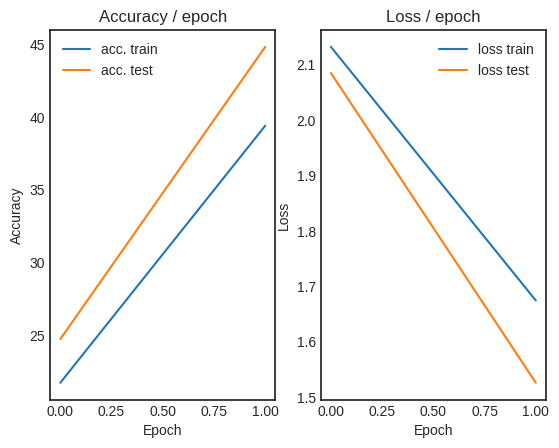

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 1.4460 (1.4460)	Prec@1  46.9 ( 46.9)	Prec@5  90.6 ( 90.6)


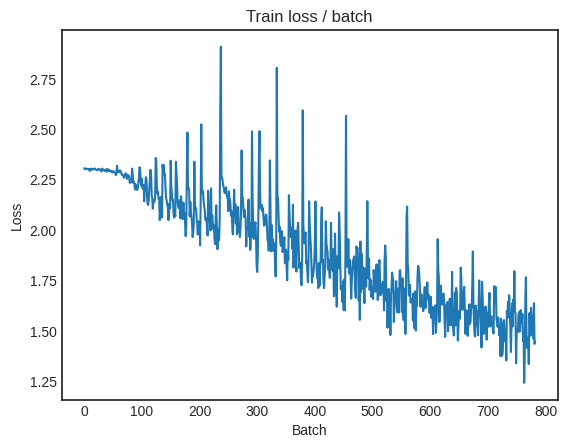

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 1.4034 (1.4559)	Prec@1  51.6 ( 47.7)	Prec@5  93.0 ( 92.2)


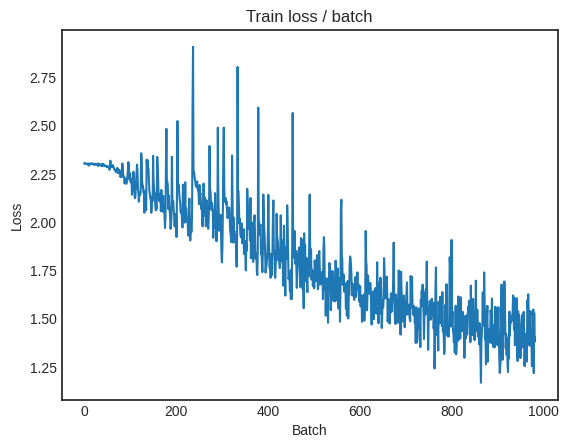


===============> Total time 9s	Avg loss 1.4222	Avg Prec@1 48.98 %	Avg Prec@5 92.62 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 1.2503 (1.2503)	Prec@1  59.4 ( 59.4)	Prec@5  92.2 ( 92.2)

===============> Total time 1s	Avg loss 1.3817	Avg Prec@1 50.36 %	Avg Prec@5 93.62 %



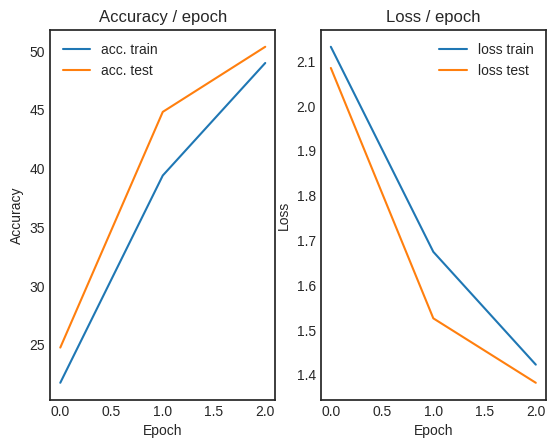

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 1.2756 (1.2756)	Prec@1  53.9 ( 53.9)	Prec@5  97.7 ( 97.7)


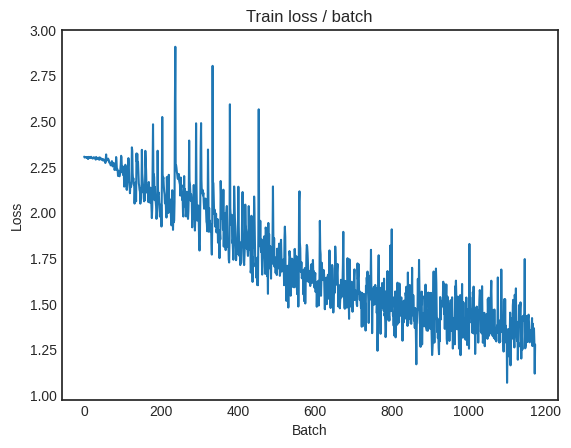

[TRAIN Batch 200/391]	Time 0.012s (0.022s)	Loss 1.3436 (1.2899)	Prec@1  51.6 ( 53.8)	Prec@5  95.3 ( 94.3)


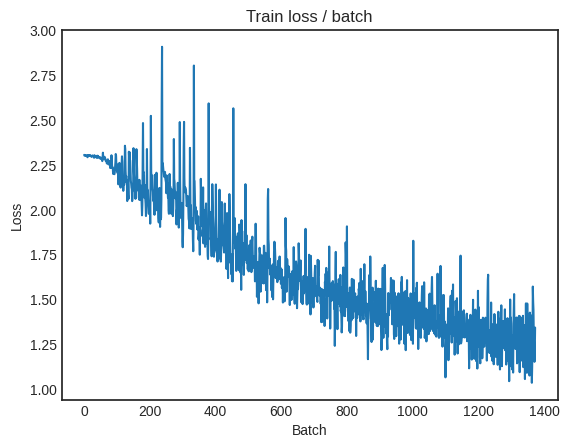


===============> Total time 10s	Avg loss 1.2590	Avg Prec@1 55.15 %	Avg Prec@5 94.45 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 1.0801 (1.0801)	Prec@1  64.8 ( 64.8)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.1928	Avg Prec@1 57.55 %	Avg Prec@5 95.03 %



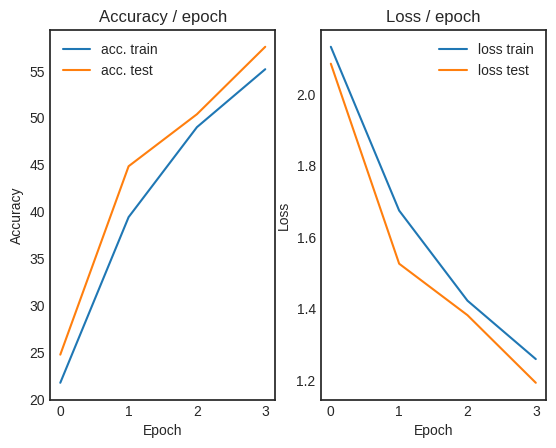

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 1.1412 (1.1412)	Prec@1  62.5 ( 62.5)	Prec@5  96.1 ( 96.1)


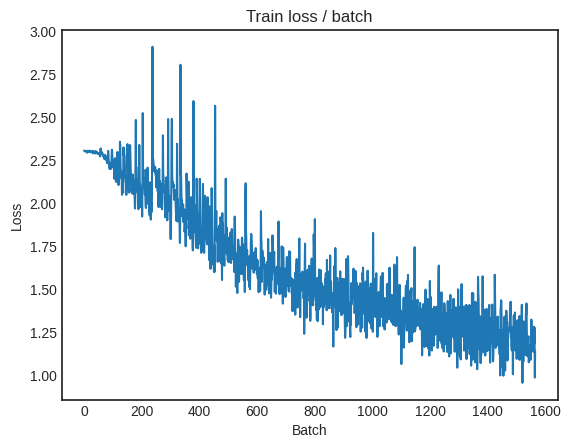

[TRAIN Batch 200/391]	Time 0.016s (0.022s)	Loss 1.0619 (1.1434)	Prec@1  60.2 ( 59.4)	Prec@5  97.7 ( 95.6)


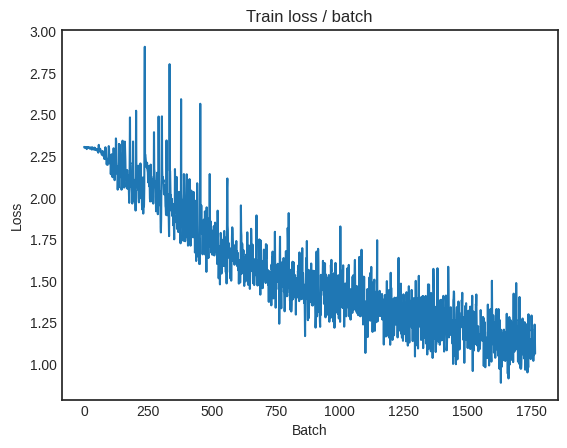


===============> Total time 9s	Avg loss 1.1220	Avg Prec@1 60.29 %	Avg Prec@5 95.79 %

[EVAL Batch 000/079]	Time 0.127s (0.127s)	Loss 1.0520 (1.0520)	Prec@1  64.8 ( 64.8)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.1757	Avg Prec@1 57.75 %	Avg Prec@5 95.58 %



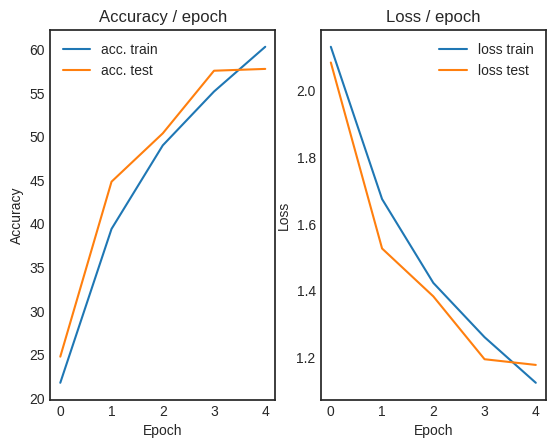

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 1.1368 (1.1368)	Prec@1  60.2 ( 60.2)	Prec@5  95.3 ( 95.3)


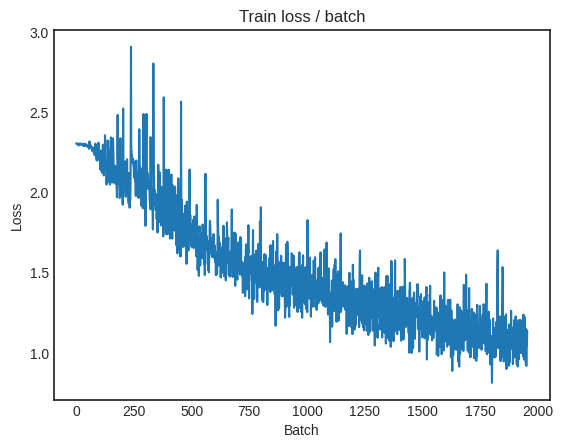

[TRAIN Batch 200/391]	Time 0.029s (0.023s)	Loss 1.0334 (1.0152)	Prec@1  60.2 ( 64.3)	Prec@5  96.9 ( 96.7)


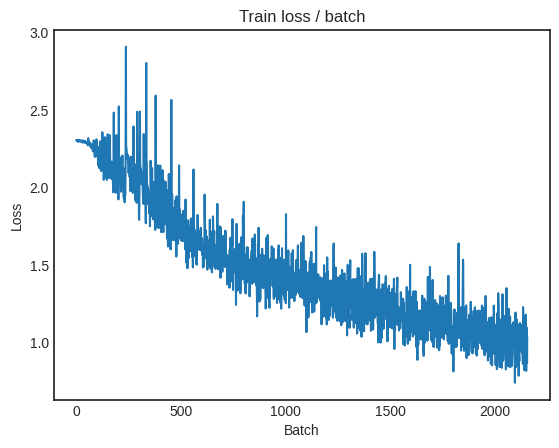


===============> Total time 8s	Avg loss 0.9955	Avg Prec@1 65.00 %	Avg Prec@5 96.78 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 1.2827 (1.2827)	Prec@1  57.8 ( 57.8)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.2732	Avg Prec@1 56.58 %	Avg Prec@5 94.68 %



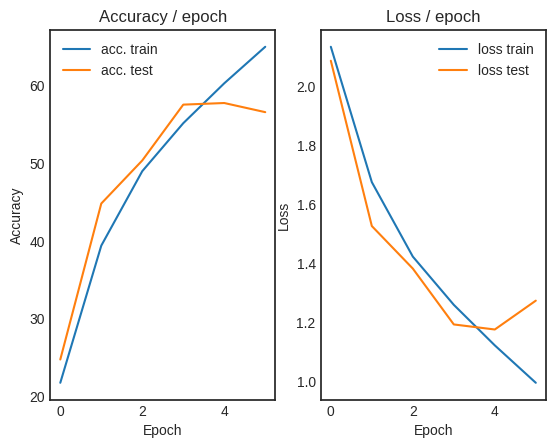

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.147s (0.147s)	Loss 0.9966 (0.9966)	Prec@1  65.6 ( 65.6)	Prec@5  96.1 ( 96.1)


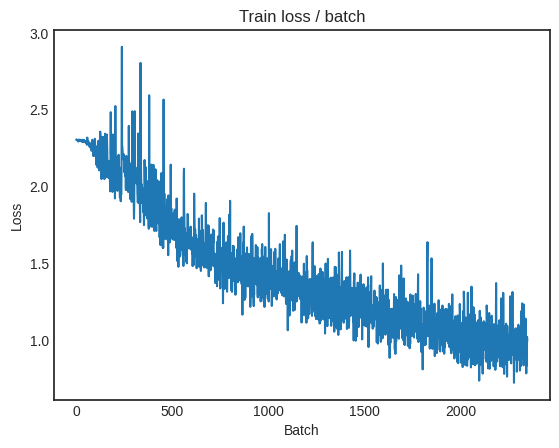

[TRAIN Batch 200/391]	Time 0.015s (0.023s)	Loss 0.8602 (0.8943)	Prec@1  74.2 ( 68.4)	Prec@5  95.3 ( 97.6)


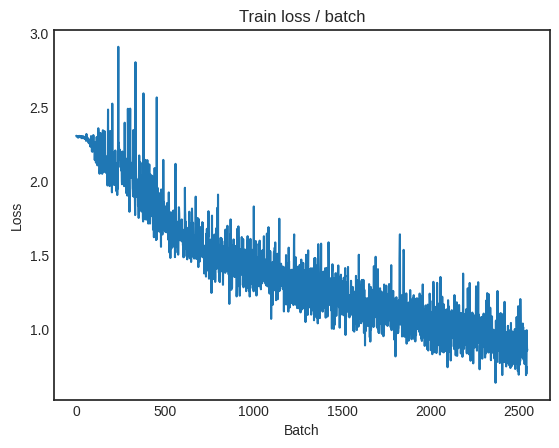


===============> Total time 8s	Avg loss 0.8888	Avg Prec@1 68.81 %	Avg Prec@5 97.53 %

[EVAL Batch 000/079]	Time 0.122s (0.122s)	Loss 0.9791 (0.9791)	Prec@1  65.6 ( 65.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.0079	Avg Prec@1 64.07 %	Avg Prec@5 96.82 %



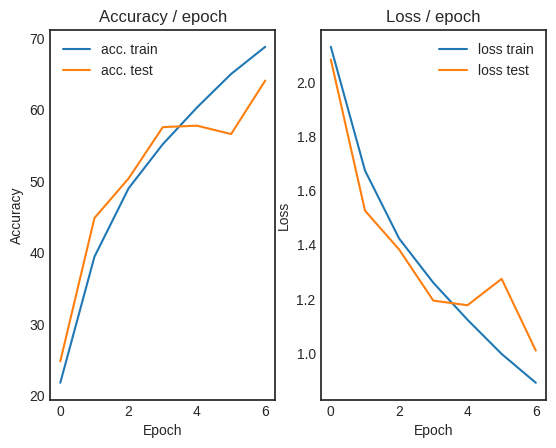

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.211s (0.211s)	Loss 0.7745 (0.7745)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)


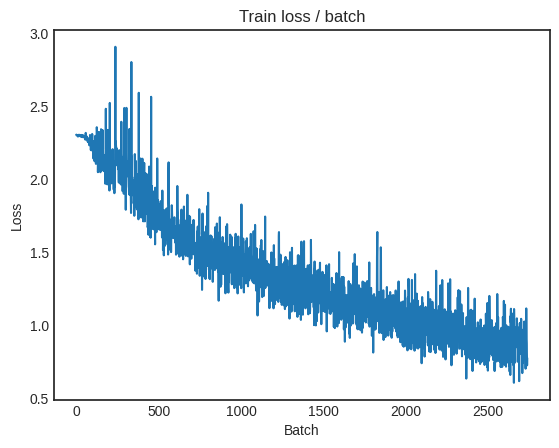

[TRAIN Batch 200/391]	Time 0.017s (0.023s)	Loss 0.7911 (0.7887)	Prec@1  77.3 ( 72.3)	Prec@5  95.3 ( 98.2)


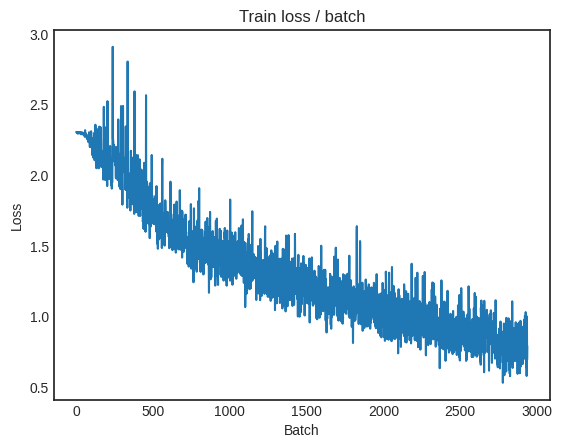


===============> Total time 8s	Avg loss 0.7929	Avg Prec@1 72.18 %	Avg Prec@5 98.08 %

[EVAL Batch 000/079]	Time 0.120s (0.120s)	Loss 1.0033 (1.0033)	Prec@1  65.6 ( 65.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9789	Avg Prec@1 65.40 %	Avg Prec@5 97.06 %



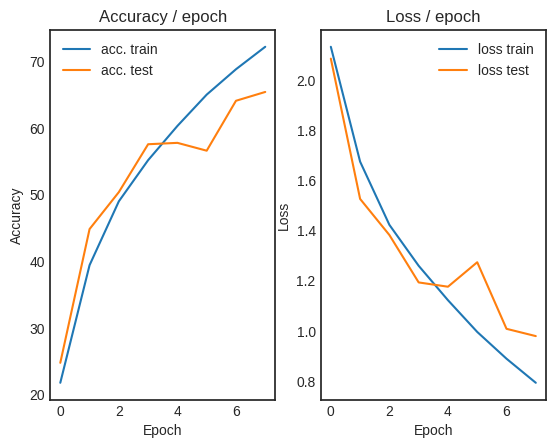

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.206s (0.206s)	Loss 0.7347 (0.7347)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)


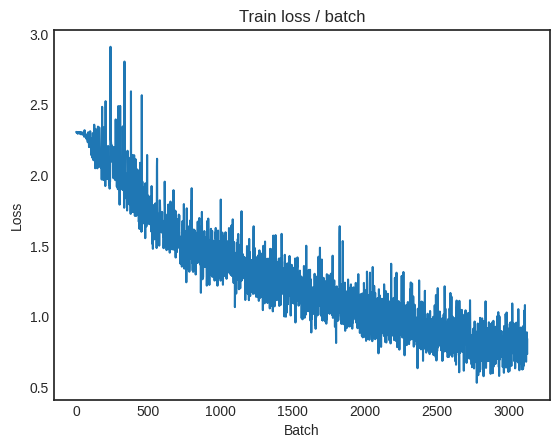

[TRAIN Batch 200/391]	Time 0.031s (0.026s)	Loss 0.6767 (0.7012)	Prec@1  75.0 ( 75.9)	Prec@5  99.2 ( 98.4)


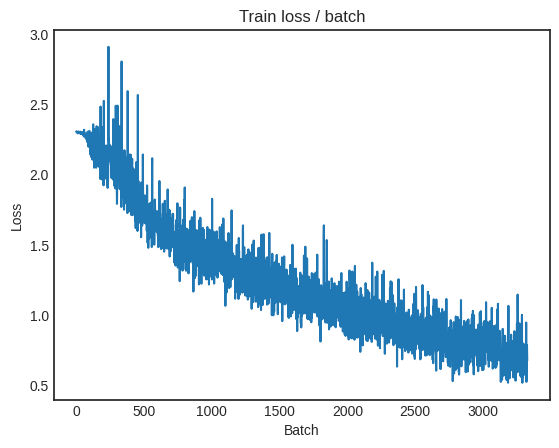


===============> Total time 9s	Avg loss 0.6949	Avg Prec@1 75.93 %	Avg Prec@5 98.51 %

[EVAL Batch 000/079]	Time 0.129s (0.129s)	Loss 0.9634 (0.9634)	Prec@1  68.8 ( 68.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0766	Avg Prec@1 65.98 %	Avg Prec@5 96.88 %



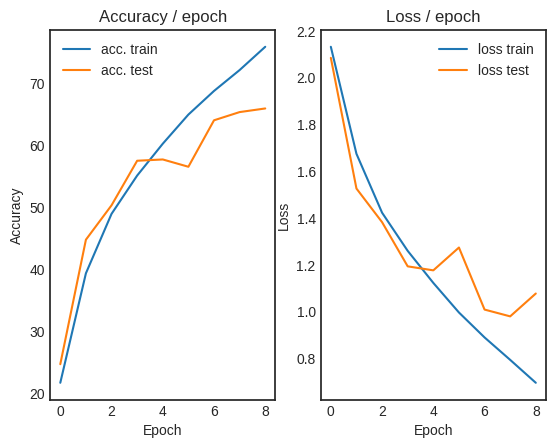

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.6277 (0.6277)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)


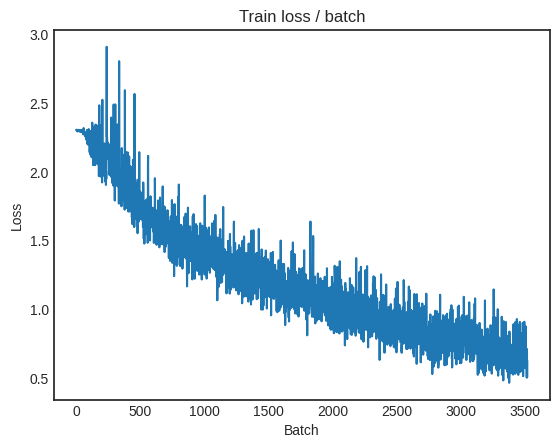

[TRAIN Batch 200/391]	Time 0.015s (0.028s)	Loss 0.4916 (0.5967)	Prec@1  83.6 ( 79.4)	Prec@5 100.0 ( 99.0)


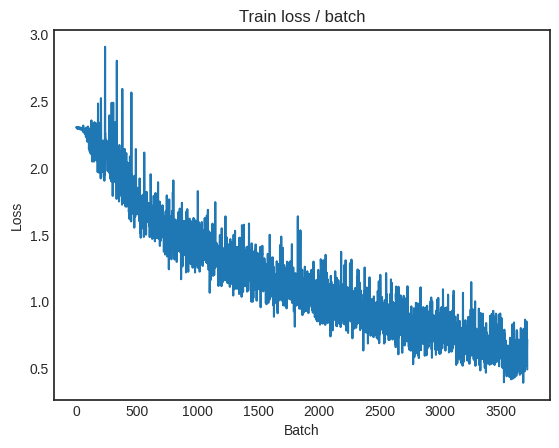


===============> Total time 9s	Avg loss 0.6040	Avg Prec@1 78.95 %	Avg Prec@5 98.98 %

[EVAL Batch 000/079]	Time 0.131s (0.131s)	Loss 1.0017 (1.0017)	Prec@1  68.0 ( 68.0)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.9696	Avg Prec@1 67.59 %	Avg Prec@5 97.04 %



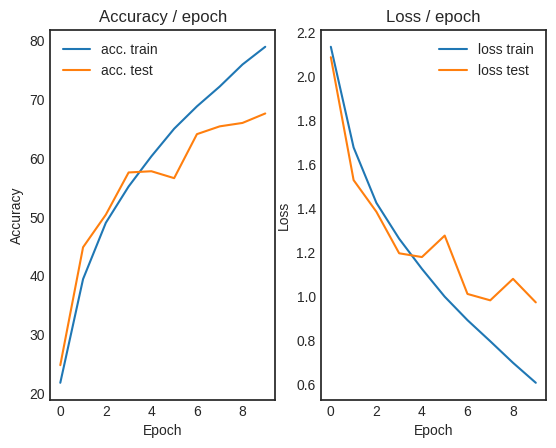

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 0.6259 (0.6259)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)


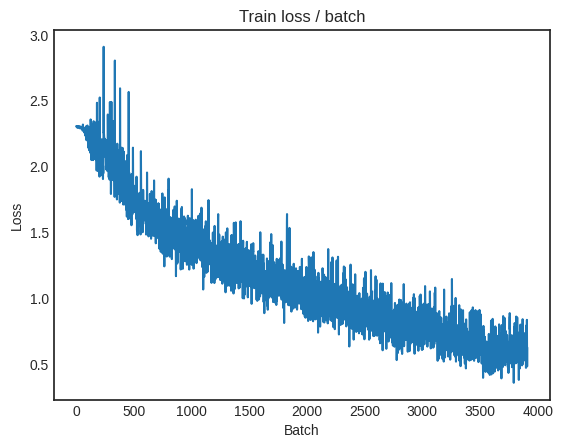

[TRAIN Batch 200/391]	Time 0.048s (0.027s)	Loss 0.4114 (0.4987)	Prec@1  85.2 ( 82.4)	Prec@5 100.0 ( 99.4)


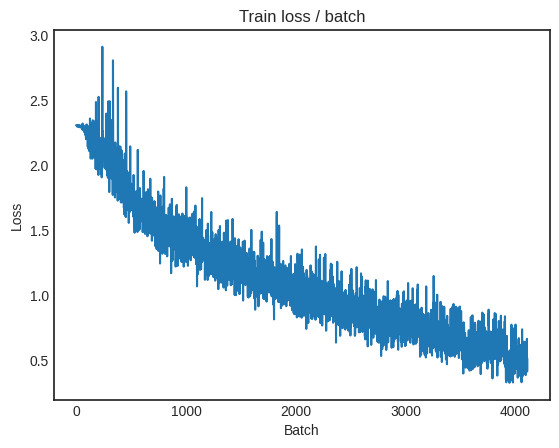


===============> Total time 9s	Avg loss 0.5102	Avg Prec@1 81.97 %	Avg Prec@5 99.36 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 0.8954 (0.8954)	Prec@1  72.7 ( 72.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.8993	Avg Prec@1 70.60 %	Avg Prec@5 97.49 %



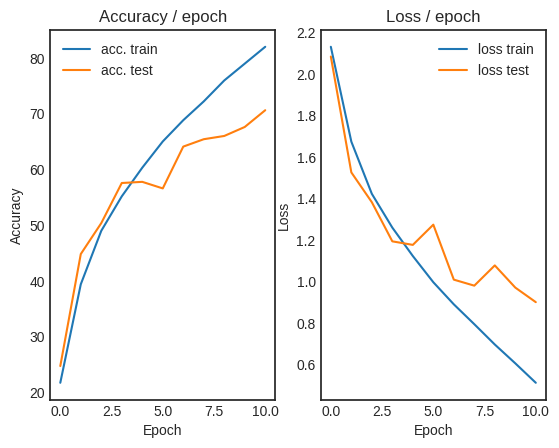

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 0.3856 (0.3856)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)


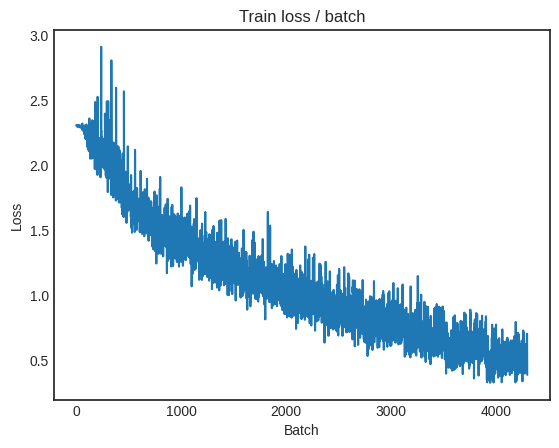

[TRAIN Batch 200/391]	Time 0.028s (0.028s)	Loss 0.4340 (0.3976)	Prec@1  87.5 ( 86.3)	Prec@5 100.0 ( 99.7)


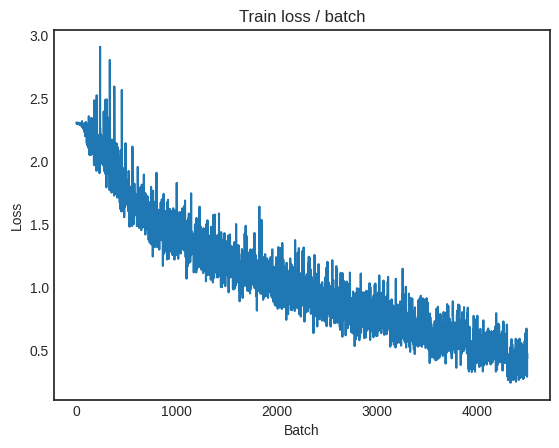


===============> Total time 9s	Avg loss 0.4204	Avg Prec@1 85.28 %	Avg Prec@5 99.63 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 1.0521 (1.0521)	Prec@1  68.0 ( 68.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.0190	Avg Prec@1 69.38 %	Avg Prec@5 97.57 %



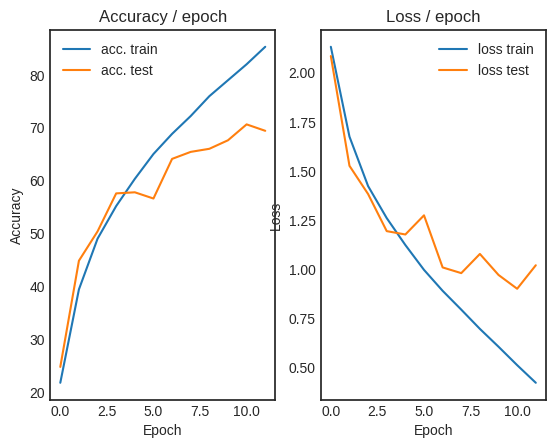

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.142s (0.142s)	Loss 0.3081 (0.3081)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


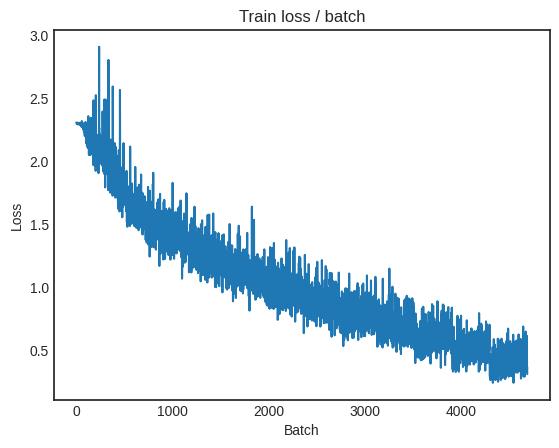

[TRAIN Batch 200/391]	Time 0.012s (0.028s)	Loss 0.2673 (0.3144)	Prec@1  89.8 ( 89.1)	Prec@5 100.0 ( 99.8)


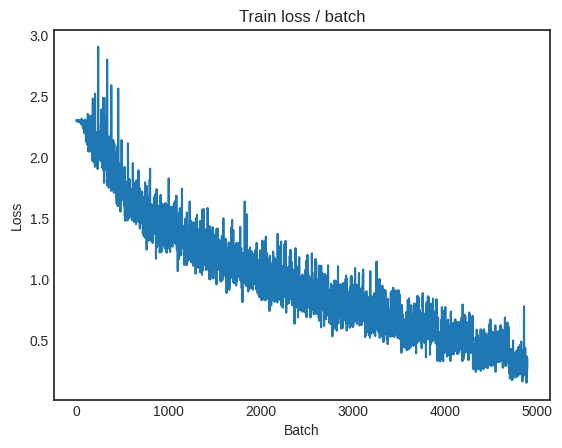


===============> Total time 10s	Avg loss 0.3322	Avg Prec@1 88.33 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 1.2523 (1.2523)	Prec@1  65.6 ( 65.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.0862	Avg Prec@1 68.45 %	Avg Prec@5 97.05 %



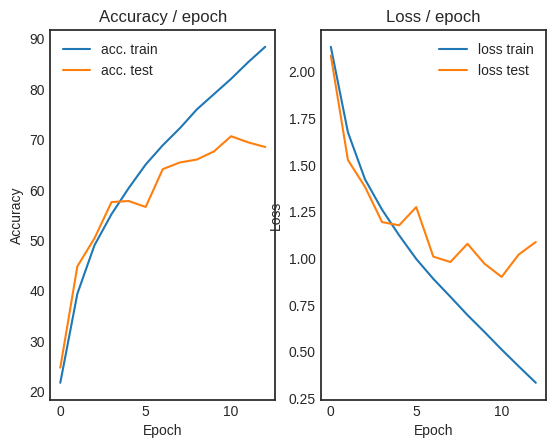

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 0.3217 (0.3217)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


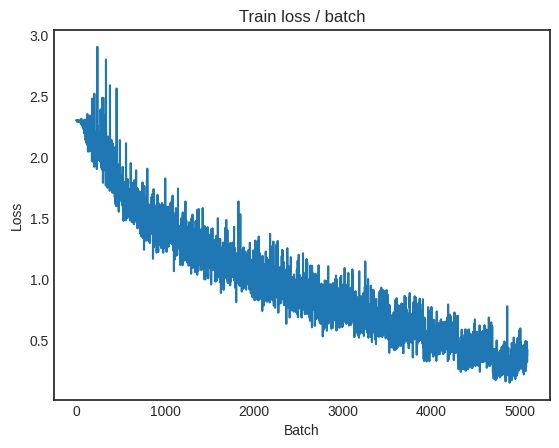

[TRAIN Batch 200/391]	Time 0.014s (0.028s)	Loss 0.2473 (0.2196)	Prec@1  93.0 ( 92.7)	Prec@5 100.0 ( 99.9)


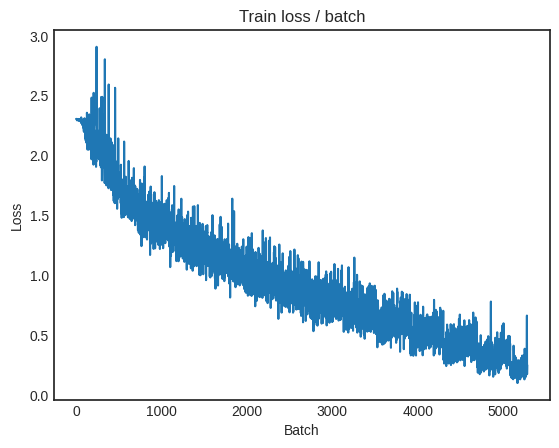


===============> Total time 9s	Avg loss 0.2425	Avg Prec@1 91.68 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 1.3049 (1.3049)	Prec@1  64.1 ( 64.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.2552	Avg Prec@1 68.25 %	Avg Prec@5 96.94 %



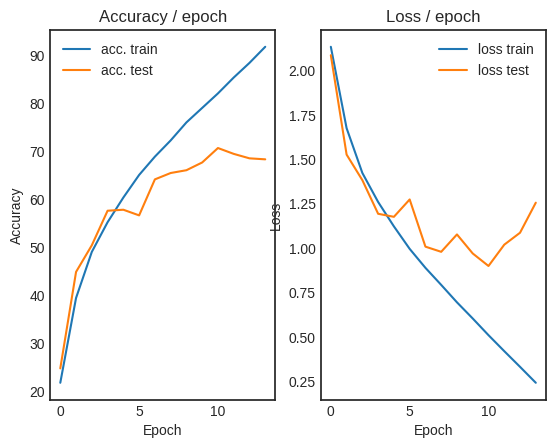

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.154s (0.154s)	Loss 0.2242 (0.2242)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


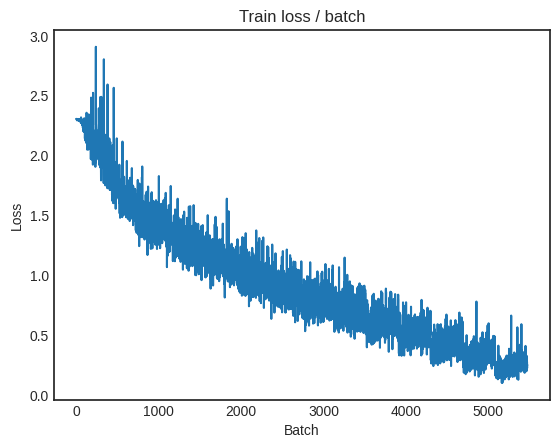

[TRAIN Batch 200/391]	Time 0.009s (0.028s)	Loss 0.1866 (0.1691)	Prec@1  93.8 ( 94.3)	Prec@5 100.0 (100.0)


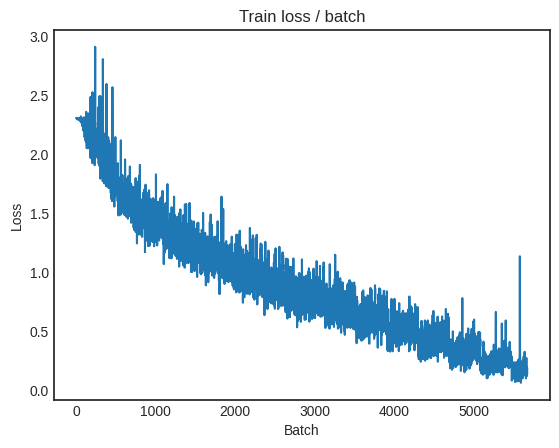


===============> Total time 9s	Avg loss 0.1847	Avg Prec@1 93.71 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.120s (0.120s)	Loss 1.2098 (1.2098)	Prec@1  65.6 ( 65.6)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 1.2033	Avg Prec@1 68.83 %	Avg Prec@5 96.97 %



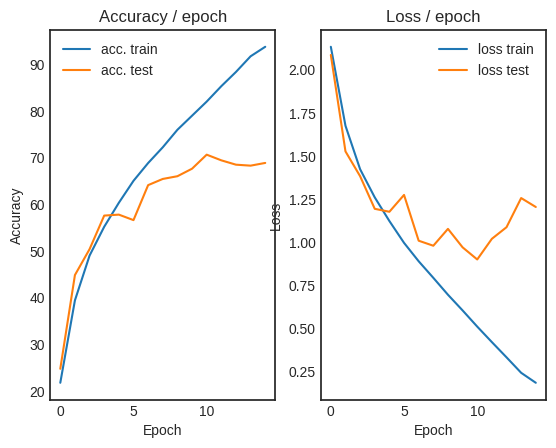

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.152s (0.152s)	Loss 0.2076 (0.2076)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


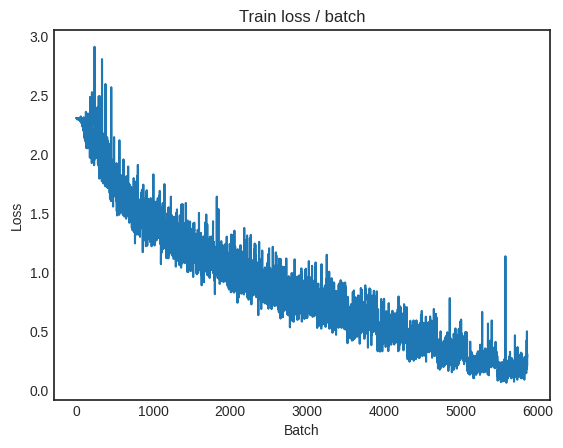

[TRAIN Batch 200/391]	Time 0.029s (0.028s)	Loss 0.1820 (0.1287)	Prec@1  95.3 ( 95.9)	Prec@5 100.0 (100.0)


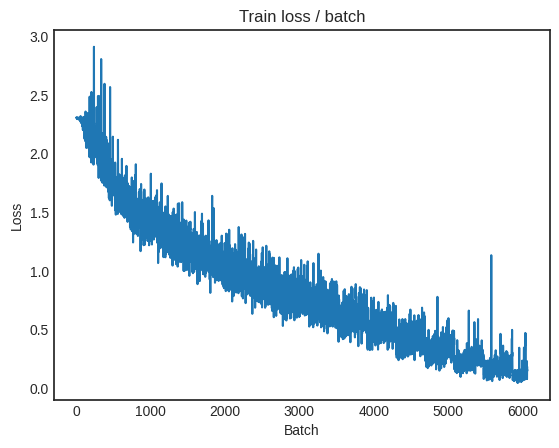


===============> Total time 9s	Avg loss 0.1373	Avg Prec@1 95.54 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.125s (0.125s)	Loss 1.2659 (1.2659)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.2294	Avg Prec@1 69.85 %	Avg Prec@5 96.98 %



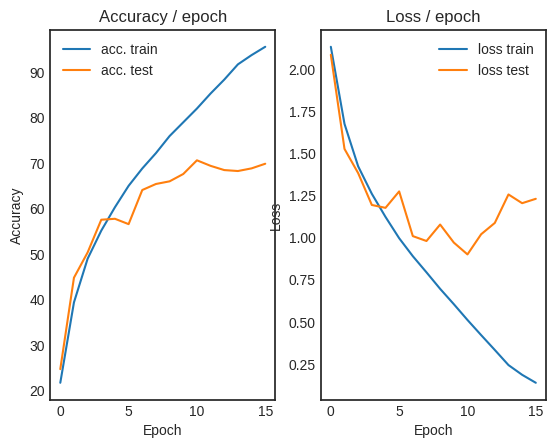

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.152s (0.152s)	Loss 0.1012 (0.1012)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


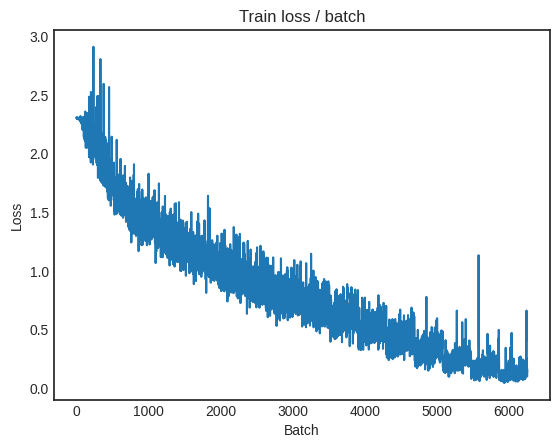

[TRAIN Batch 200/391]	Time 0.044s (0.028s)	Loss 0.0581 (0.0619)	Prec@1  98.4 ( 98.3)	Prec@5 100.0 (100.0)


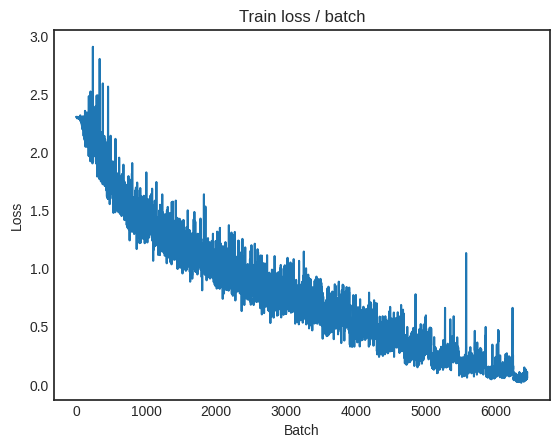


===============> Total time 10s	Avg loss 0.0837	Avg Prec@1 97.40 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 1.5763 (1.5763)	Prec@1  65.6 ( 65.6)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.5507	Avg Prec@1 69.50 %	Avg Prec@5 97.09 %



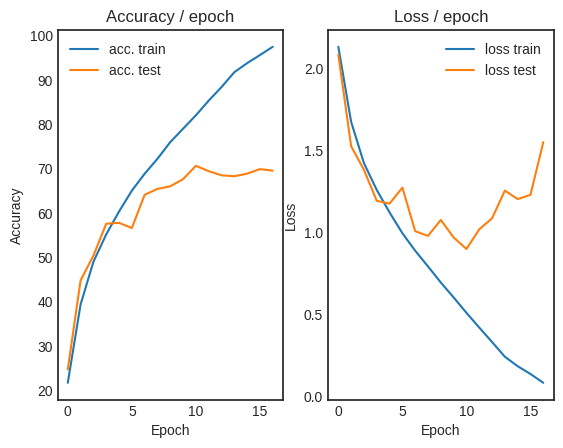

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.160s (0.160s)	Loss 0.1152 (0.1152)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


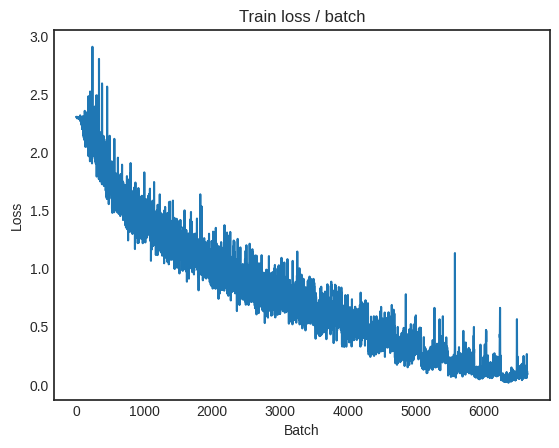

[TRAIN Batch 200/391]	Time 0.065s (0.024s)	Loss 0.0360 (0.0538)	Prec@1  98.4 ( 98.5)	Prec@5 100.0 (100.0)


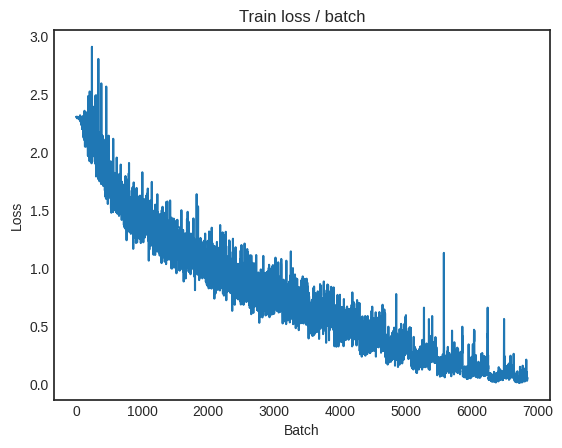


===============> Total time 9s	Avg loss 0.0613	Avg Prec@1 98.16 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 1.7194 (1.7194)	Prec@1  68.0 ( 68.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.6503	Avg Prec@1 69.65 %	Avg Prec@5 96.90 %



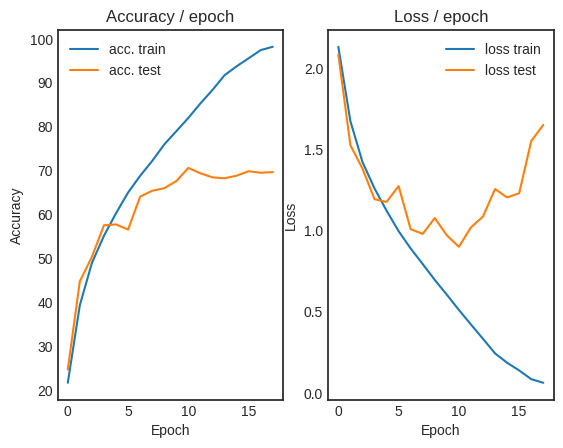

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.160s (0.160s)	Loss 0.0471 (0.0471)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


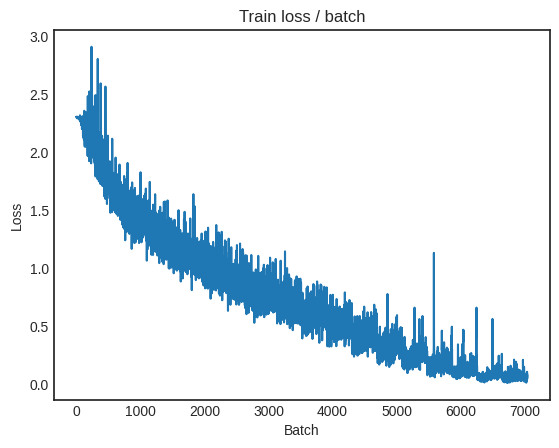

[TRAIN Batch 200/391]	Time 0.015s (0.023s)	Loss 0.1039 (0.0418)	Prec@1  96.1 ( 98.7)	Prec@5 100.0 (100.0)


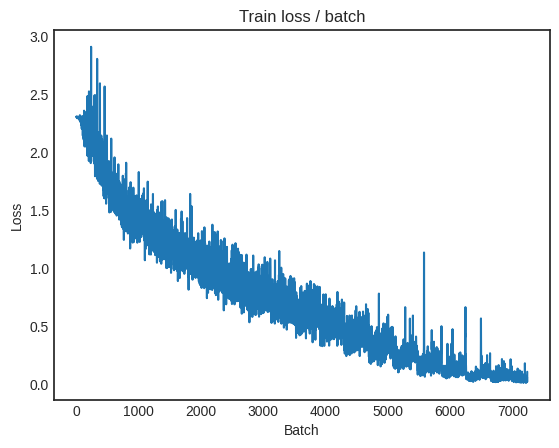


===============> Total time 9s	Avg loss 0.0510	Avg Prec@1 98.40 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 1.6608 (1.6608)	Prec@1  71.1 ( 71.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.5885	Avg Prec@1 70.07 %	Avg Prec@5 97.10 %



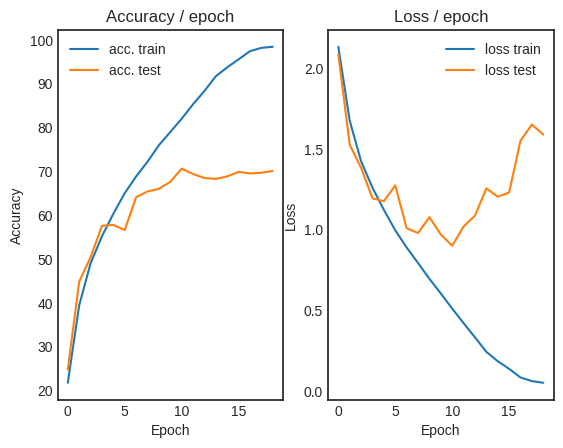

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 0.1087 (0.1087)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


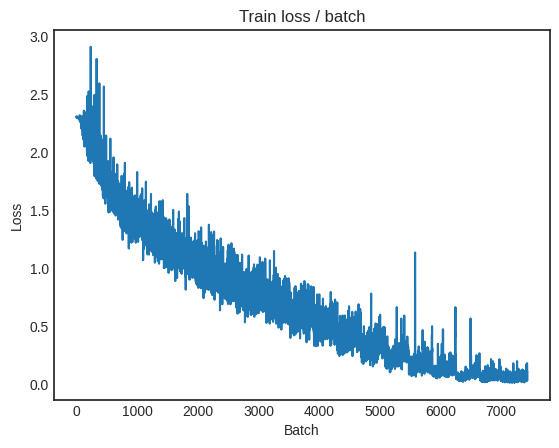

[TRAIN Batch 200/391]	Time 0.015s (0.023s)	Loss 0.0070 (0.0246)	Prec@1 100.0 ( 99.4)	Prec@5 100.0 (100.0)


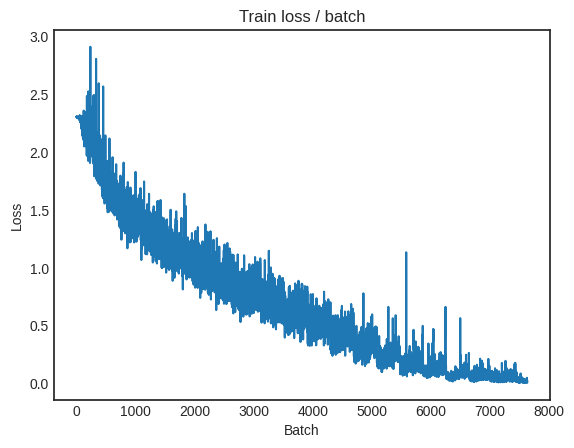


===============> Total time 9s	Avg loss 0.0419	Avg Prec@1 98.75 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 1.4951 (1.4951)	Prec@1  69.5 ( 69.5)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 1.5723	Avg Prec@1 69.91 %	Avg Prec@5 97.23 %



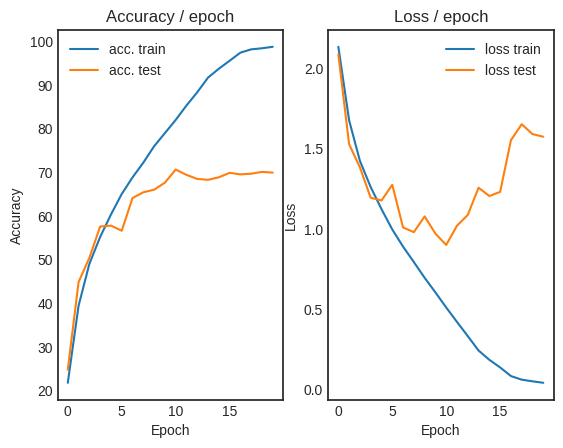

In [27]:
#start training on CIFAR
main_CIFAR(batch_size=128, lr=0.1, epochs=20, cuda=True)

### Interlude: visualizing network filters & saliency maps

In [28]:
CNN_CIFAR.features

Sequential(
  (0): Conv2d(3, 32, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
  (1): ReLU()
  (2): MaxPool2d(kernel_size=(2, 2), stride=2, padding=0, dilation=1, ceil_mode=False)
  (3): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
  (4): ReLU()
  (5): MaxPool2d(kernel_size=(2, 2), stride=2, padding=0, dilation=1, ceil_mode=False)
  (6): Conv2d(64, 64, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
  (7): ReLU()
  (8): MaxPool2d(kernel_size=(2, 2), stride=2, padding=0, dilation=1, ceil_mode=False)
)

In [29]:
CNN_CIFAR.features[0]

Conv2d(3, 32, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))

#### Show filters maps in first convolutional layer

(32, 5, 5, 3)


<Figure size 1600x200 with 0 Axes>

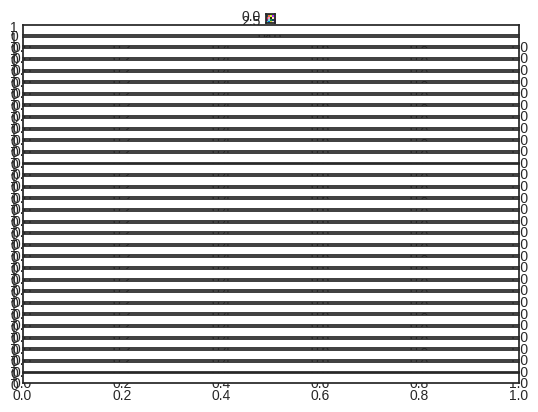

In [30]:
# Visualize convolutional filter
kernels = np.array(CNN_CIFAR.features[0].weight.detach().permute(0, 2, 3, 1))
print(kernels.shape)

kernels -= np.min(kernels)
kernels /= np.max(kernels) - np.min(kernels)

#print(kernels[0].shape)
#plt.imshow(kernels[0])
#plt.show()

plt.figure(figsize = (16, 2))
fig, axarr = plt.subplots(kernels.shape[0])

for idx in range(1):
    axarr[idx].imshow(kernels[idx])

plt.show()

#### Display saliency map

In [31]:
# specify test_model
test_model = CNN_CIFAR

# load sample image
train, test = get_dataset_CIFAR(batch_size = 4, cuda = True)
input_img, target_img = next(iter(test))

# enforce gradient calculation for the input_img
input_img.requires_grad = True

# forward/inference
out = test_model(input_img)
print(out.shape)

Files already downloaded and verified
Files already downloaded and verified
torch.Size([4, 10])


# Part 3 : Results improvements

## 3.1 Standardization

In [32]:
from PIL import Image

In [33]:
# adapting the dataset function to CIFAR10

def get_dataset_CIFAR_improved(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """

    # image mean and std for CIFAR10
    mean_CIFAR = (0.491, 0.482, 0.447)
    sig_CIFAR = (0.202, 0.199, 0.201)


    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=mean_CIFAR, std=sig_CIFAR)
        ]))


    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=mean_CIFAR, std=sig_CIFAR)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

In [34]:
# make modifications to main function to accomodate CIFAR10

def main_CIFAR_standardized(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :{"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet2()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset_CIFAR_improved(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in tqdm(range(epochs)):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

Files already downloaded and verified
Files already downloaded and verified


  0%|          | 0/20 [00:00<?, ?it/s]

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.267s (0.267s)	Loss 2.3051 (2.3051)	Prec@1   6.2 (  6.2)	Prec@5  53.1 ( 53.1)


<Figure size 640x480 with 0 Axes>

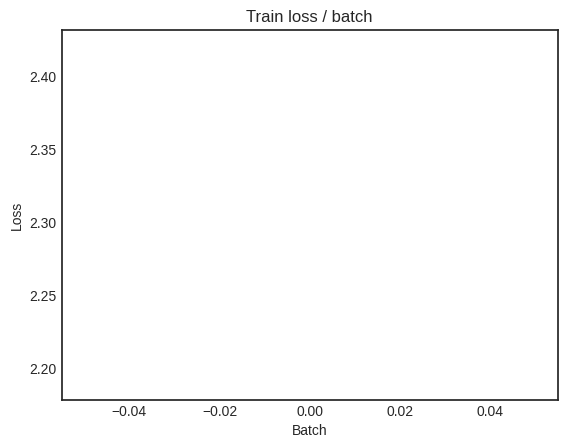

[TRAIN Batch 200/391]	Time 0.010s (0.039s)	Loss 1.6969 (1.9328)	Prec@1  31.2 ( 29.7)	Prec@5  82.8 ( 79.9)


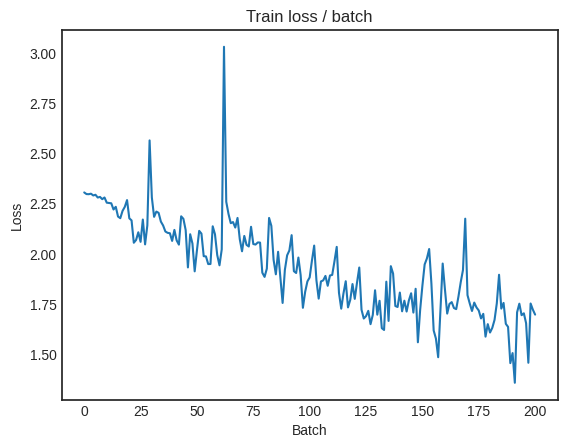


===============> Total time 15s	Avg loss 1.7337	Avg Prec@1 37.18 %	Avg Prec@5 85.45 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 1.5373 (1.5373)	Prec@1  47.7 ( 47.7)	Prec@5  89.1 ( 89.1)

===============> Total time 2s	Avg loss 1.6311	Avg Prec@1 42.61 %	Avg Prec@5 89.92 %



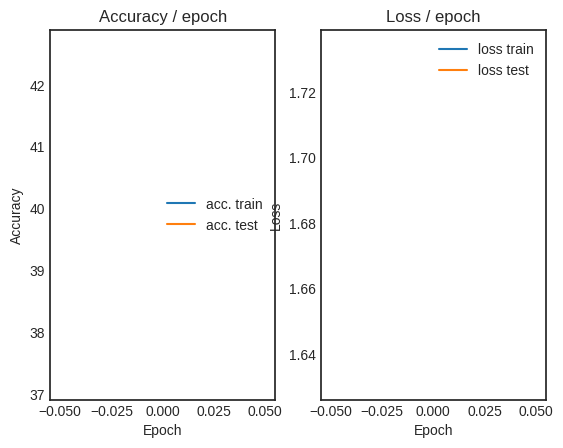

  5%|▌         | 1/20 [00:18<05:50, 18.46s/it]

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.157s (0.157s)	Loss 1.6921 (1.6921)	Prec@1  35.9 ( 35.9)	Prec@5  87.5 ( 87.5)


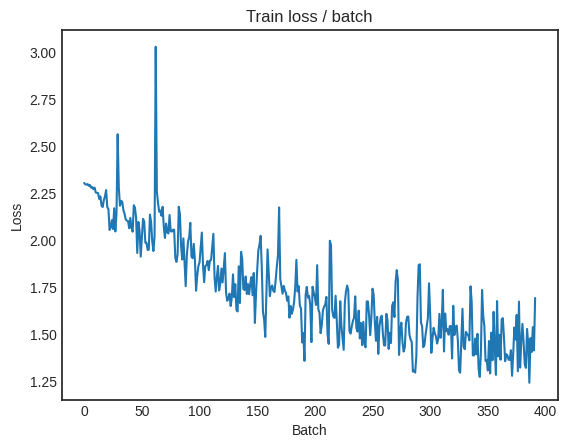

[TRAIN Batch 200/391]	Time 0.011s (0.037s)	Loss 1.2633 (1.3139)	Prec@1  53.1 ( 52.9)	Prec@5  95.3 ( 94.2)


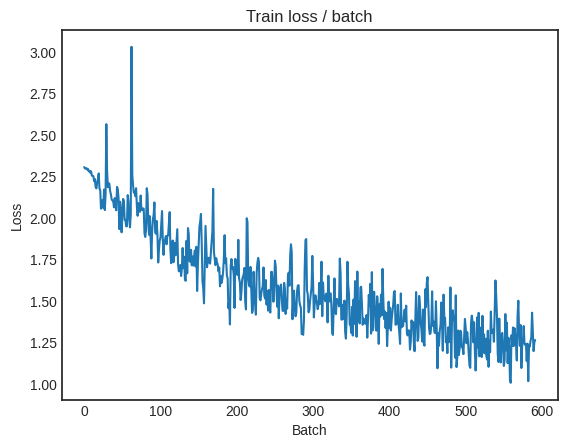


===============> Total time 14s	Avg loss 1.2595	Avg Prec@1 55.14 %	Avg Prec@5 94.64 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 1.0344 (1.0344)	Prec@1  63.3 ( 63.3)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.1427	Avg Prec@1 59.59 %	Avg Prec@5 95.75 %



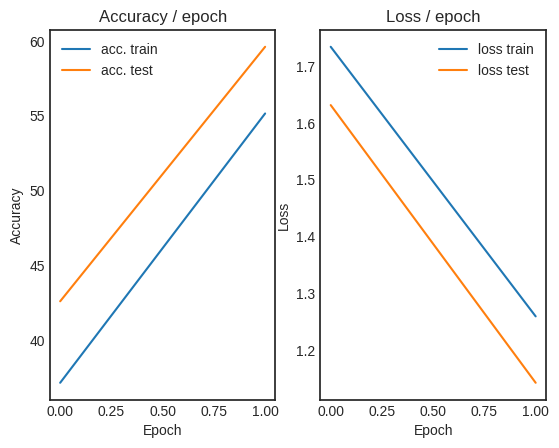

 10%|█         | 2/20 [00:35<05:21, 17.86s/it]

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.161s (0.161s)	Loss 1.1027 (1.1027)	Prec@1  60.9 ( 60.9)	Prec@5  97.7 ( 97.7)


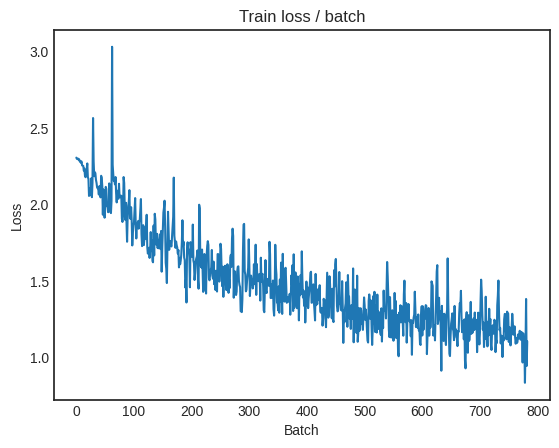

[TRAIN Batch 200/391]	Time 0.042s (0.041s)	Loss 0.8418 (1.0533)	Prec@1  74.2 ( 62.9)	Prec@5  98.4 ( 96.5)


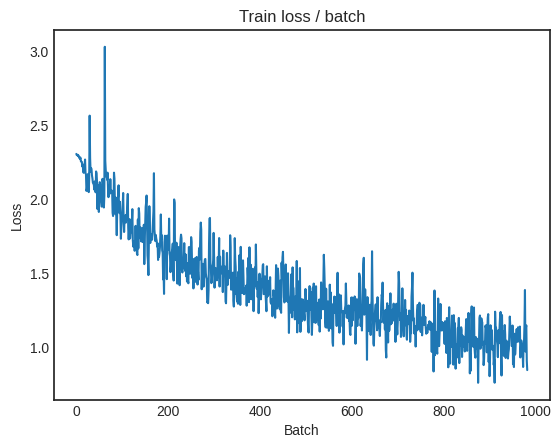


===============> Total time 14s	Avg loss 1.0263	Avg Prec@1 63.87 %	Avg Prec@5 96.60 %

[EVAL Batch 000/079]	Time 0.271s (0.271s)	Loss 0.9267 (0.9267)	Prec@1  65.6 ( 65.6)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.9997	Avg Prec@1 64.24 %	Avg Prec@5 96.80 %



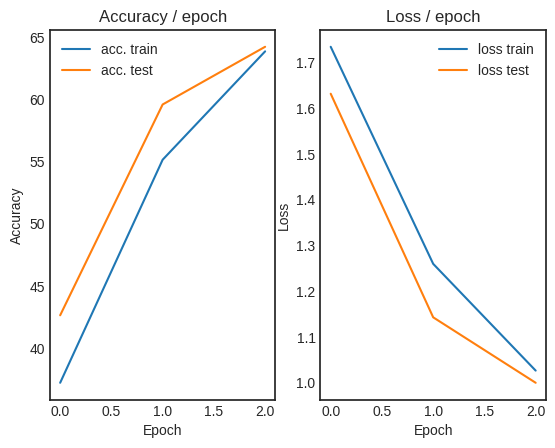

 15%|█▌        | 3/20 [00:54<05:10, 18.24s/it]

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 0.8680 (0.8680)	Prec@1  65.6 ( 65.6)	Prec@5  98.4 ( 98.4)


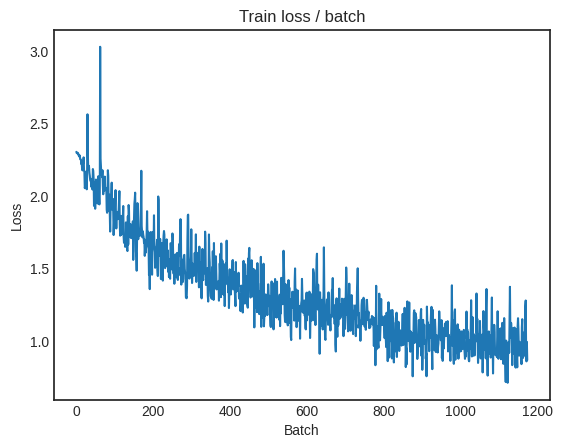

[TRAIN Batch 200/391]	Time 0.040s (0.034s)	Loss 0.8642 (0.8838)	Prec@1  69.5 ( 69.1)	Prec@5  96.1 ( 97.5)


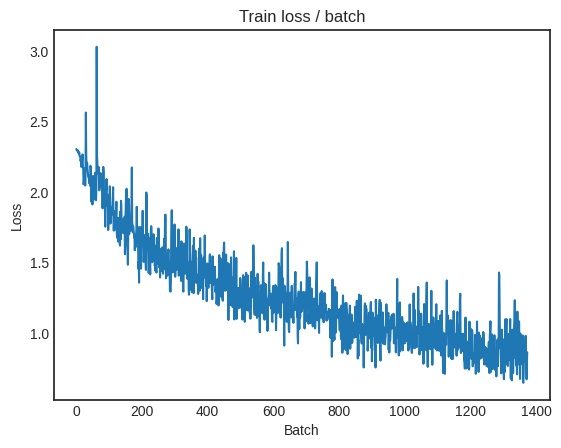


===============> Total time 14s	Avg loss 0.8624	Avg Prec@1 69.89 %	Avg Prec@5 97.68 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.8838 (0.8838)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9457	Avg Prec@1 67.76 %	Avg Prec@5 97.00 %



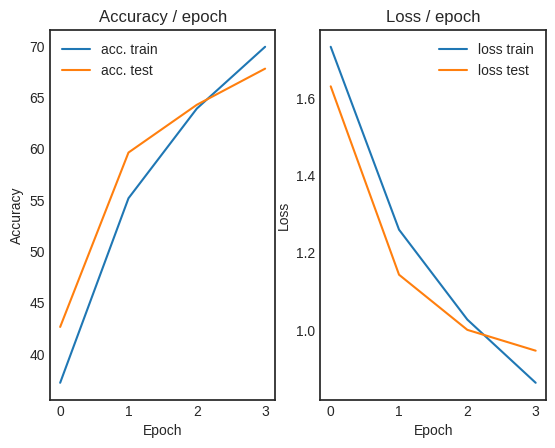

 20%|██        | 4/20 [01:11<04:45, 17.86s/it]

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.7500 (0.7500)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)


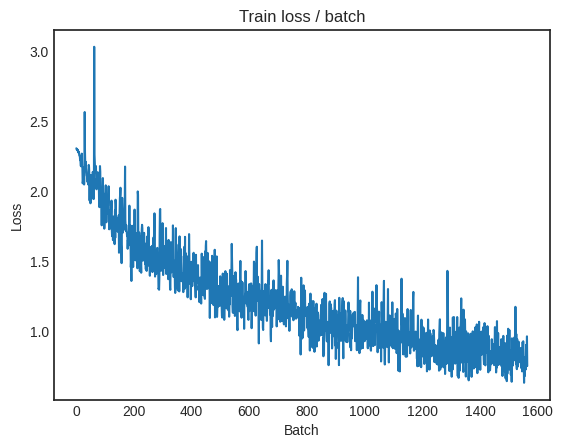

[TRAIN Batch 200/391]	Time 0.015s (0.040s)	Loss 0.8410 (0.7260)	Prec@1  71.9 ( 74.3)	Prec@5  96.9 ( 98.5)


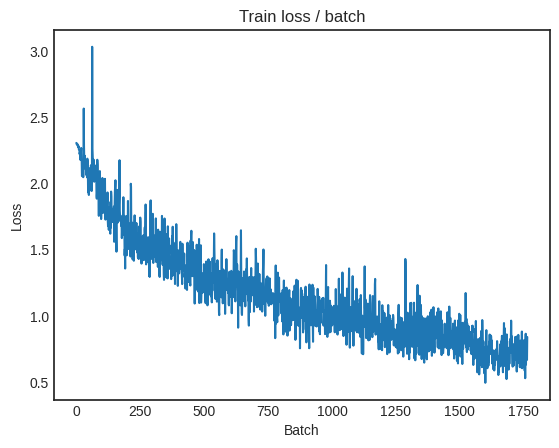


===============> Total time 14s	Avg loss 0.7221	Avg Prec@1 74.56 %	Avg Prec@5 98.51 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.9549 (0.9549)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9873	Avg Prec@1 66.22 %	Avg Prec@5 96.90 %



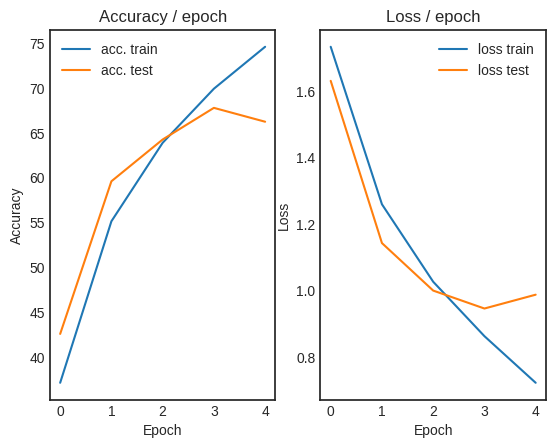

 25%|██▌       | 5/20 [01:29<04:25, 17.72s/it]

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 0.6667 (0.6667)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)


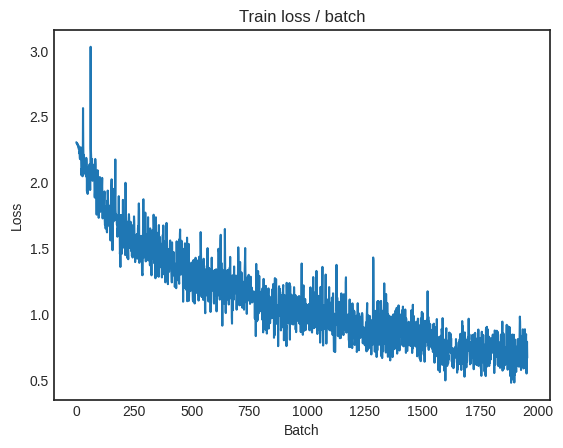

[TRAIN Batch 200/391]	Time 0.034s (0.038s)	Loss 0.5371 (0.6012)	Prec@1  85.9 ( 79.1)	Prec@5  97.7 ( 99.0)


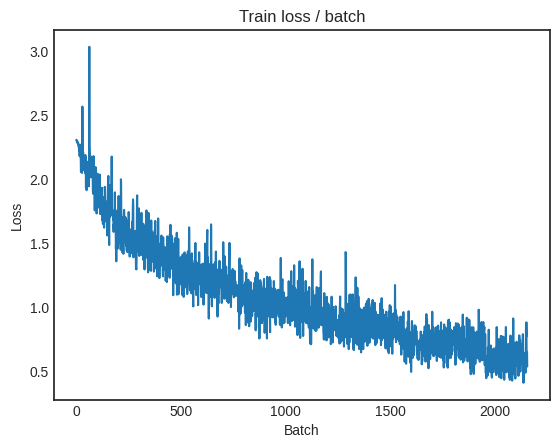


===============> Total time 15s	Avg loss 0.5996	Avg Prec@1 79.07 %	Avg Prec@5 99.00 %

[EVAL Batch 000/079]	Time 0.166s (0.166s)	Loss 0.7467 (0.7467)	Prec@1  73.4 ( 73.4)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8622	Avg Prec@1 71.12 %	Avg Prec@5 97.53 %



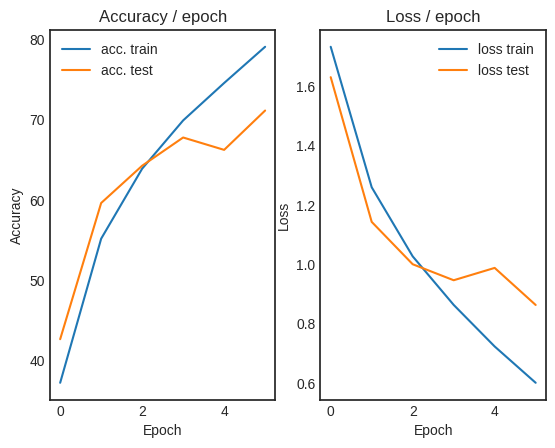

 30%|███       | 6/20 [01:47<04:09, 17.82s/it]

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.4159 (0.4159)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


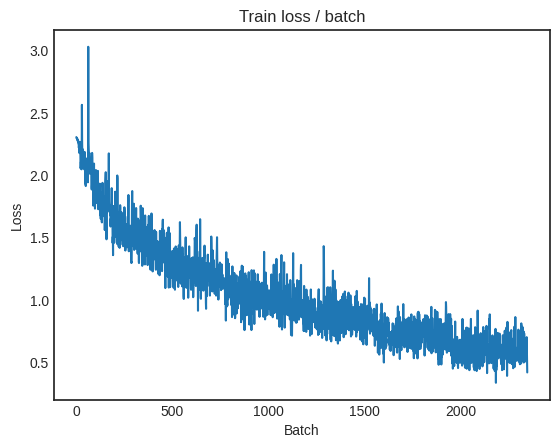

[TRAIN Batch 200/391]	Time 0.060s (0.035s)	Loss 0.5658 (0.4796)	Prec@1  82.0 ( 83.0)	Prec@5  99.2 ( 99.5)


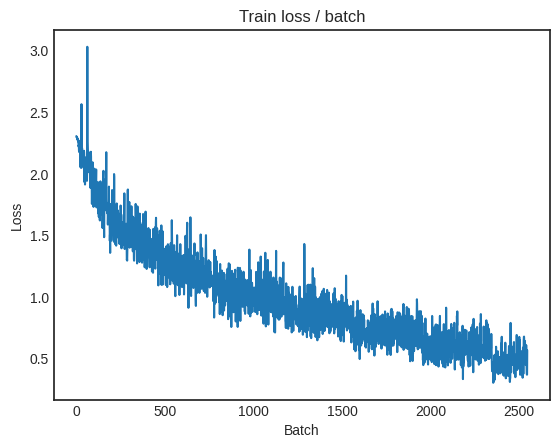


===============> Total time 14s	Avg loss 0.4890	Avg Prec@1 82.68 %	Avg Prec@5 99.43 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.8058 (0.8058)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8138	Avg Prec@1 72.74 %	Avg Prec@5 97.81 %



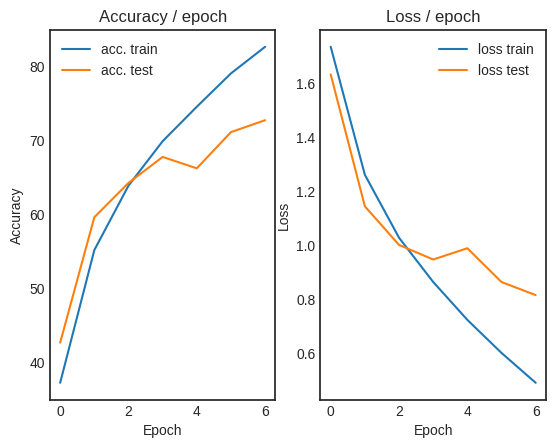

 35%|███▌      | 7/20 [02:04<03:48, 17.60s/it]

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.3764 (0.3764)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


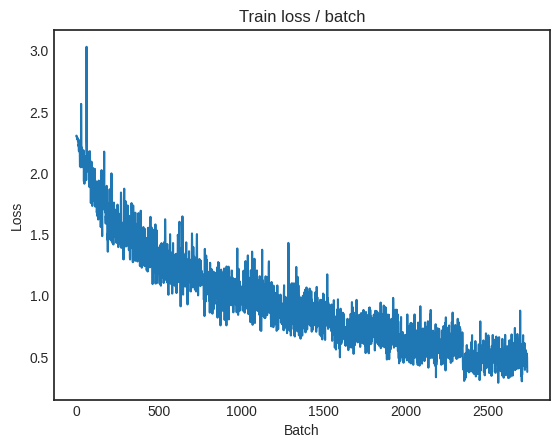

[TRAIN Batch 200/391]	Time 0.016s (0.040s)	Loss 0.4284 (0.3669)	Prec@1  85.2 ( 87.4)	Prec@5 100.0 ( 99.7)


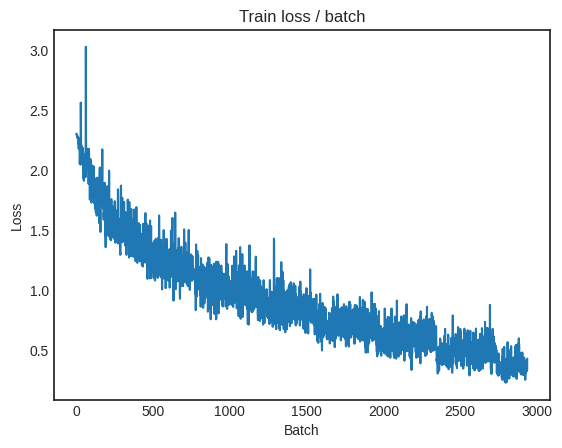


===============> Total time 14s	Avg loss 0.3842	Avg Prec@1 86.62 %	Avg Prec@5 99.66 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 1.0609 (1.0609)	Prec@1  68.0 ( 68.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.9707	Avg Prec@1 69.97 %	Avg Prec@5 97.60 %



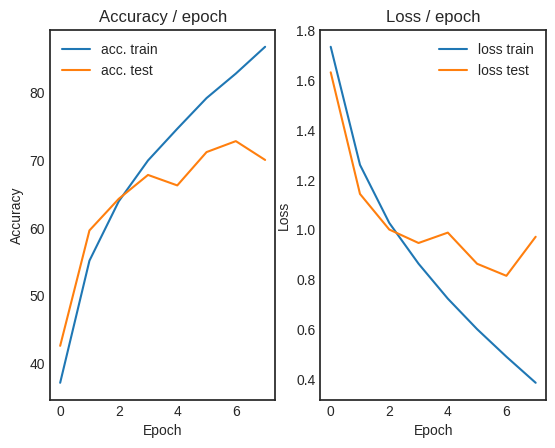

 40%|████      | 8/20 [02:22<03:34, 17.88s/it]

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.186s (0.186s)	Loss 0.3887 (0.3887)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


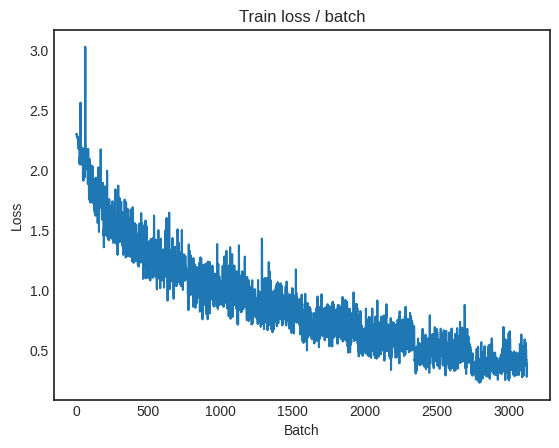

[TRAIN Batch 200/391]	Time 0.062s (0.034s)	Loss 0.2731 (0.2622)	Prec@1  88.3 ( 90.8)	Prec@5 100.0 ( 99.9)


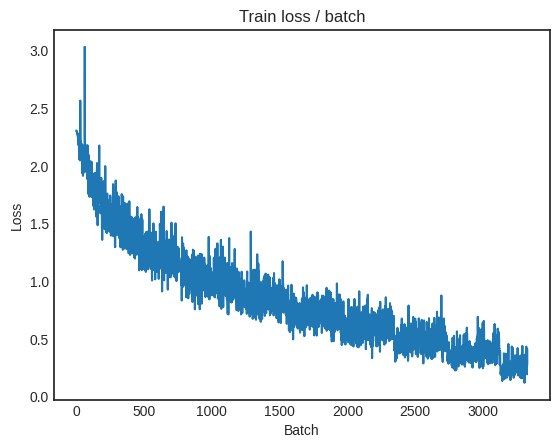


===============> Total time 14s	Avg loss 0.2882	Avg Prec@1 90.01 %	Avg Prec@5 99.86 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 1.0589 (1.0589)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.0421	Avg Prec@1 70.92 %	Avg Prec@5 97.48 %



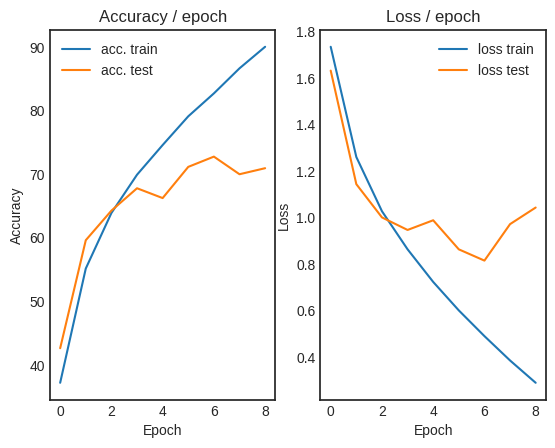

 45%|████▌     | 9/20 [02:40<03:14, 17.65s/it]

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.187s (0.187s)	Loss 0.2286 (0.2286)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


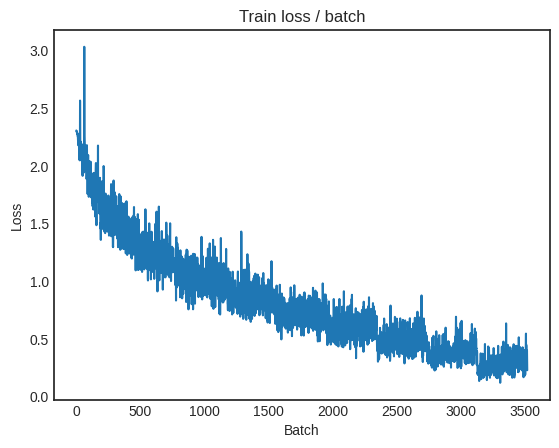

[TRAIN Batch 200/391]	Time 0.015s (0.040s)	Loss 0.4064 (0.1813)	Prec@1  83.6 ( 93.6)	Prec@5 100.0 (100.0)


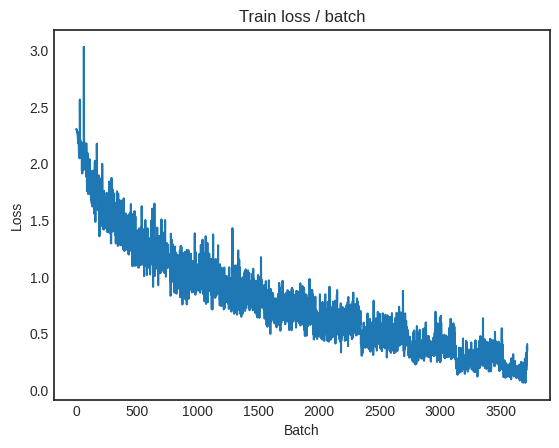


===============> Total time 14s	Avg loss 0.2027	Avg Prec@1 92.88 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 1.1982 (1.1982)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.0395	Avg Prec@1 73.36 %	Avg Prec@5 97.43 %



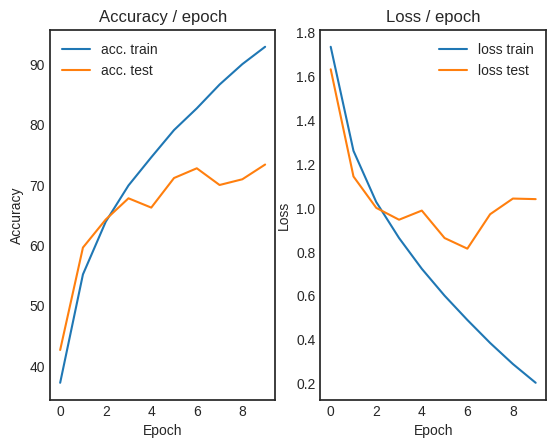

 50%|█████     | 10/20 [02:57<02:55, 17.59s/it]

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.1369 (0.1369)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


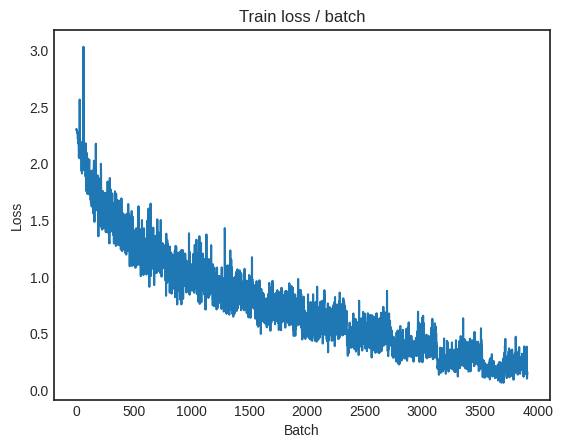

[TRAIN Batch 200/391]	Time 0.059s (0.040s)	Loss 0.2457 (0.1260)	Prec@1  90.6 ( 95.6)	Prec@5 100.0 (100.0)


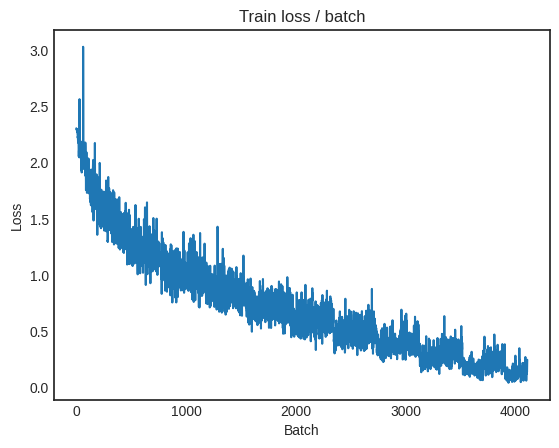


===============> Total time 15s	Avg loss 0.1502	Avg Prec@1 94.76 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 1.1326 (1.1326)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.1040	Avg Prec@1 73.87 %	Avg Prec@5 97.67 %



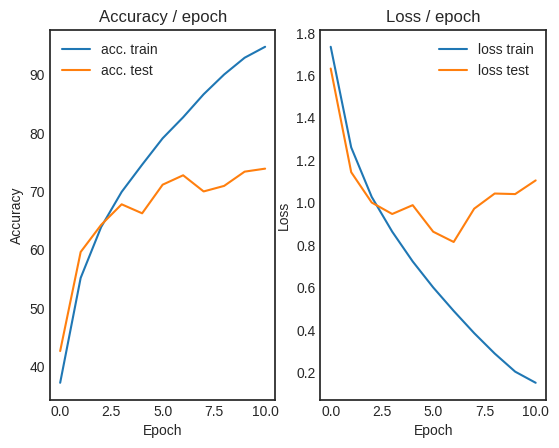

 55%|█████▌    | 11/20 [03:16<02:40, 17.85s/it]

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.191s (0.191s)	Loss 0.1020 (0.1020)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


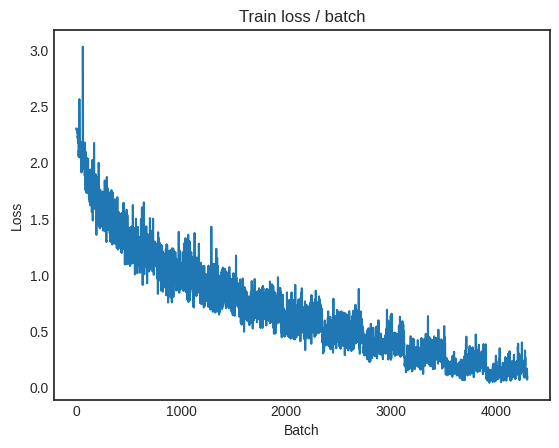

[TRAIN Batch 200/391]	Time 0.053s (0.034s)	Loss 0.2075 (0.1019)	Prec@1  91.4 ( 96.5)	Prec@5 100.0 (100.0)


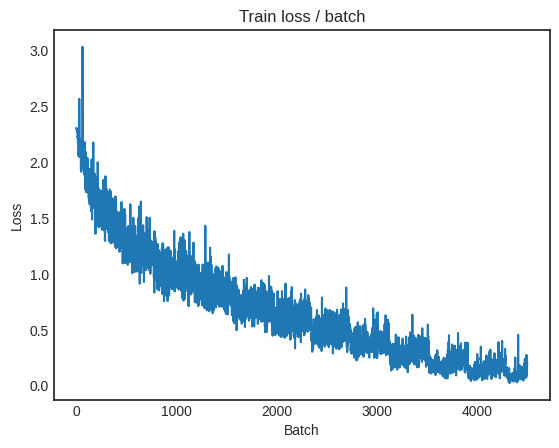


===============> Total time 14s	Avg loss 0.1149	Avg Prec@1 96.01 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 1.2478 (1.2478)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.3191	Avg Prec@1 72.24 %	Avg Prec@5 97.56 %



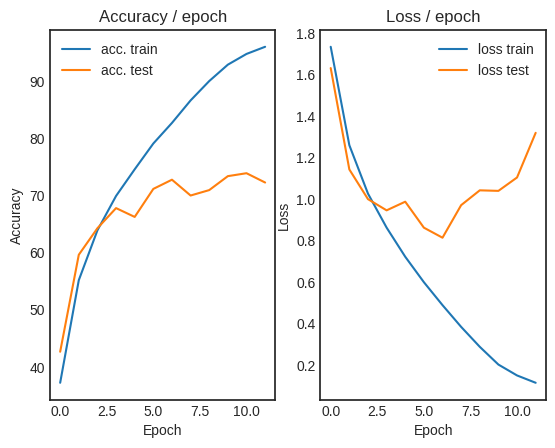

 60%|██████    | 12/20 [03:33<02:21, 17.66s/it]

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 0.1365 (0.1365)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


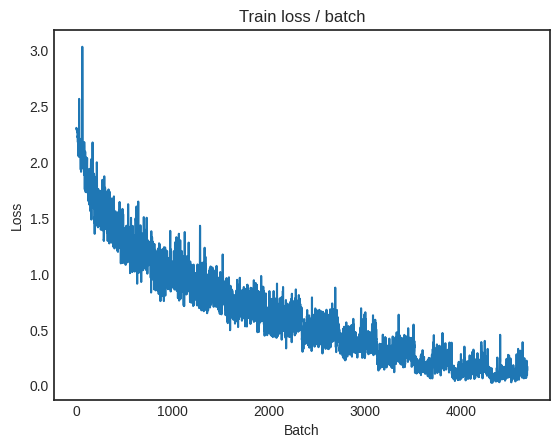

[TRAIN Batch 200/391]	Time 0.040s (0.040s)	Loss 0.0326 (0.0652)	Prec@1  99.2 ( 97.9)	Prec@5 100.0 (100.0)


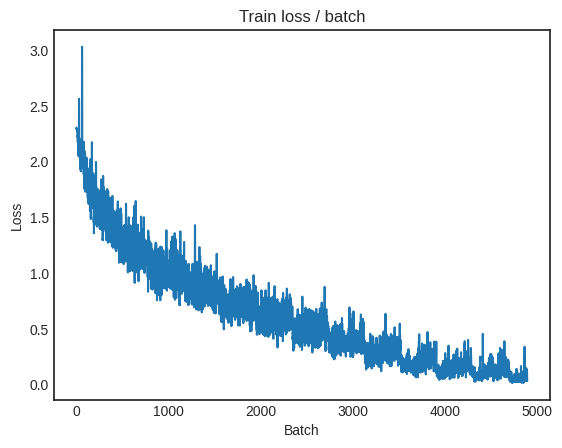


===============> Total time 14s	Avg loss 0.0785	Avg Prec@1 97.44 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 1.3625 (1.3625)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 1.3844	Avg Prec@1 72.91 %	Avg Prec@5 97.41 %



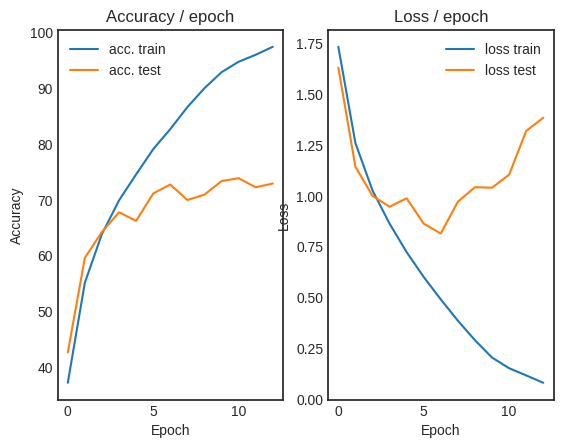

 65%|██████▌   | 13/20 [03:52<02:06, 18.02s/it]

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.189s (0.189s)	Loss 0.0567 (0.0567)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


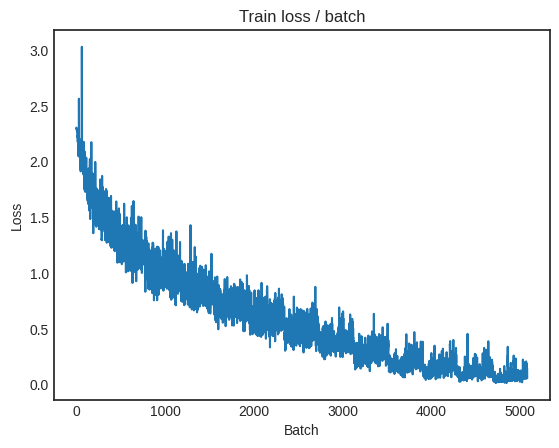

[TRAIN Batch 200/391]	Time 0.039s (0.035s)	Loss 0.0512 (0.0524)	Prec@1  97.7 ( 98.4)	Prec@5 100.0 (100.0)


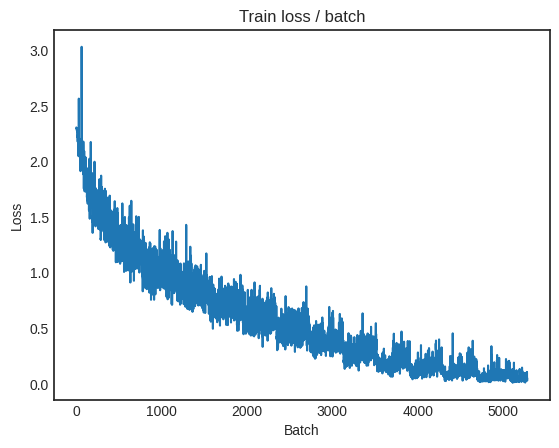


===============> Total time 14s	Avg loss 0.0623	Avg Prec@1 97.93 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 1.4632 (1.4632)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.4713	Avg Prec@1 73.13 %	Avg Prec@5 97.74 %



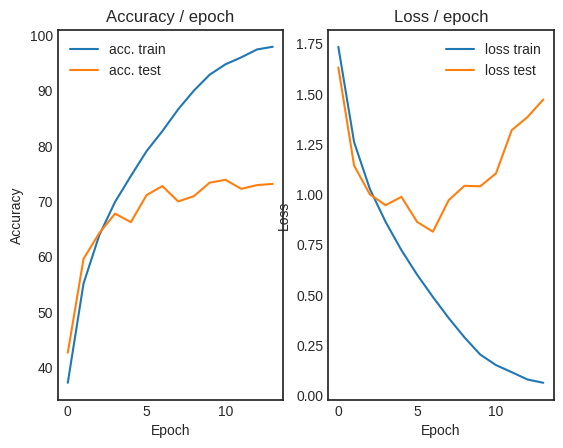

 70%|███████   | 14/20 [04:09<01:47, 17.84s/it]

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.186s (0.186s)	Loss 0.0641 (0.0641)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


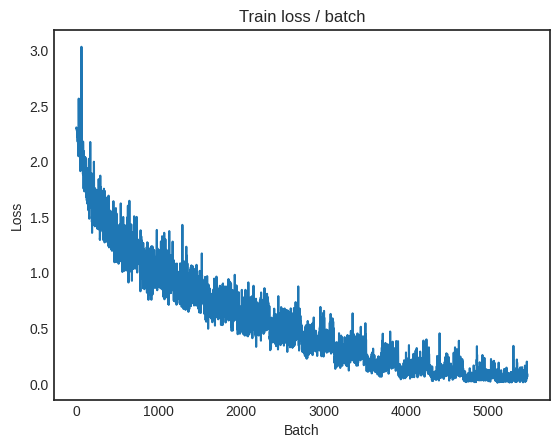

[TRAIN Batch 200/391]	Time 0.066s (0.041s)	Loss 0.0415 (0.0508)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


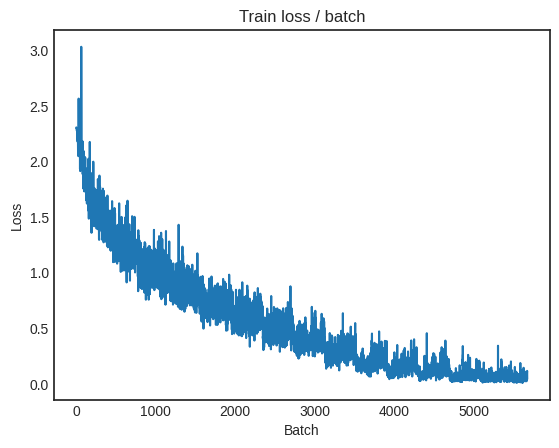


===============> Total time 14s	Avg loss 0.0692	Avg Prec@1 97.71 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 1.4625 (1.4625)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.4303	Avg Prec@1 73.65 %	Avg Prec@5 97.33 %



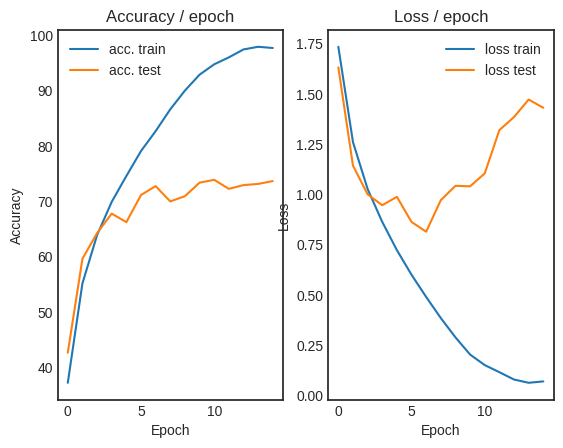

 75%|███████▌  | 15/20 [04:26<01:28, 17.73s/it]

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.218s (0.218s)	Loss 0.0282 (0.0282)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


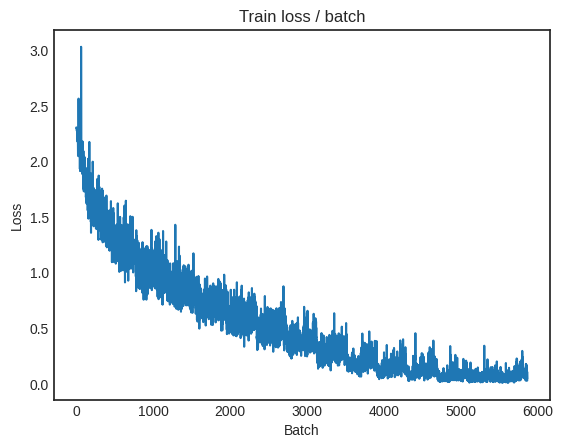

[TRAIN Batch 200/391]	Time 0.020s (0.042s)	Loss 0.0198 (0.0380)	Prec@1  99.2 ( 98.8)	Prec@5 100.0 (100.0)


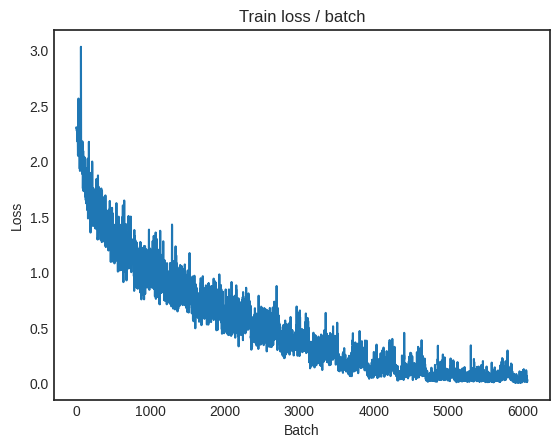


===============> Total time 17s	Avg loss 0.0464	Avg Prec@1 98.52 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 2.2713 (2.2713)	Prec@1  66.4 ( 66.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 2.0170	Avg Prec@1 67.77 %	Avg Prec@5 97.03 %



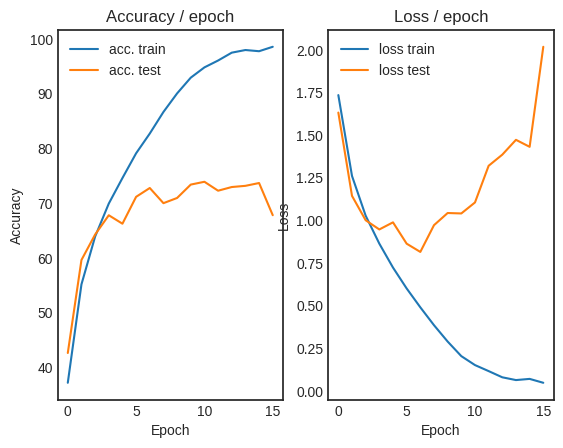

 80%|████████  | 16/20 [04:47<01:14, 18.53s/it]

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.230s (0.230s)	Loss 0.3739 (0.3739)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


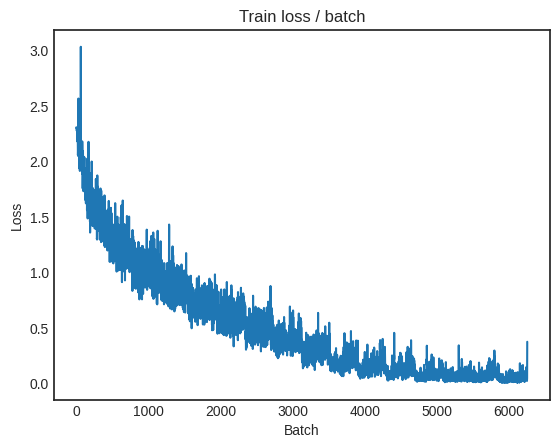

[TRAIN Batch 200/391]	Time 0.082s (0.039s)	Loss 0.0202 (0.0400)	Prec@1 100.0 ( 98.8)	Prec@5 100.0 (100.0)


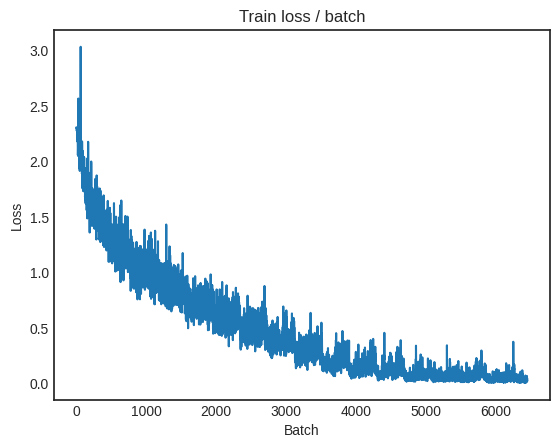


===============> Total time 14s	Avg loss 0.0489	Avg Prec@1 98.41 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 1.5515 (1.5515)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.6193	Avg Prec@1 73.24 %	Avg Prec@5 97.40 %



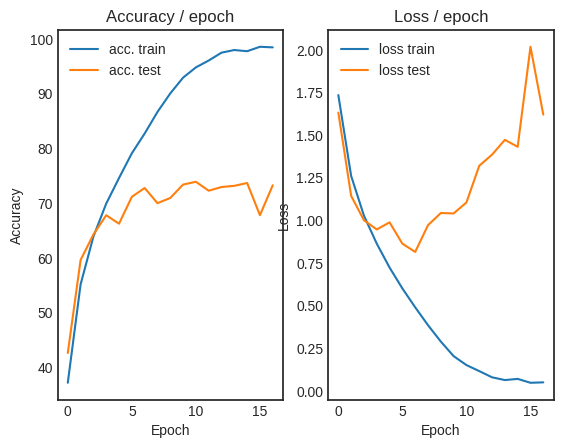

 85%|████████▌ | 17/20 [05:04<00:54, 18.17s/it]

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.186s (0.186s)	Loss 0.0929 (0.0929)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


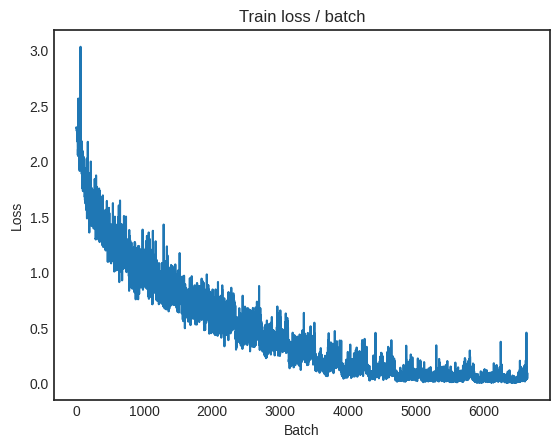

[TRAIN Batch 200/391]	Time 0.014s (0.041s)	Loss 0.0294 (0.0268)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


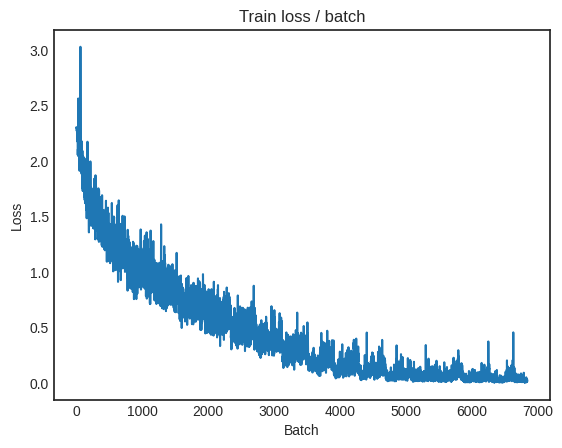


===============> Total time 15s	Avg loss 0.0397	Avg Prec@1 98.73 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.175s (0.175s)	Loss 1.4819 (1.4819)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 1.6320	Avg Prec@1 73.85 %	Avg Prec@5 97.48 %



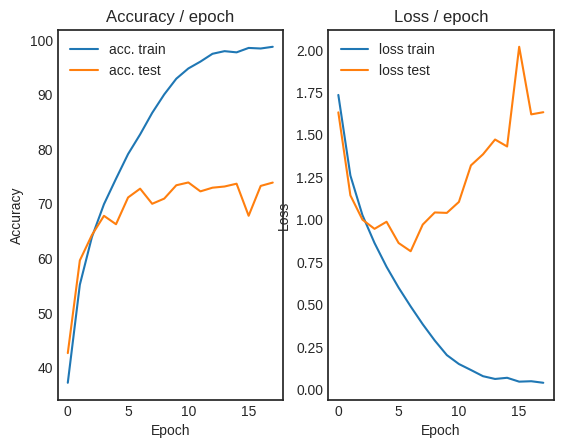

 90%|█████████ | 18/20 [05:23<00:36, 18.28s/it]

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.191s (0.191s)	Loss 0.0332 (0.0332)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


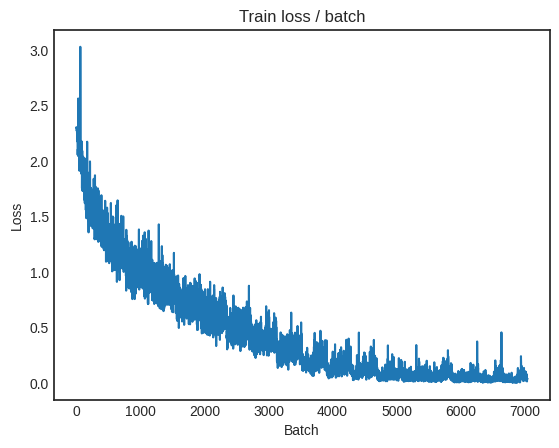

[TRAIN Batch 200/391]	Time 0.039s (0.034s)	Loss 0.0255 (0.0403)	Prec@1 100.0 ( 98.7)	Prec@5 100.0 (100.0)


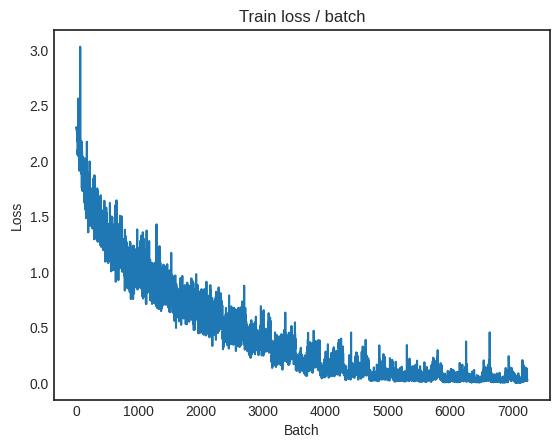


===============> Total time 14s	Avg loss 0.0532	Avg Prec@1 98.28 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 1.6701 (1.6701)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.5178	Avg Prec@1 73.62 %	Avg Prec@5 97.60 %



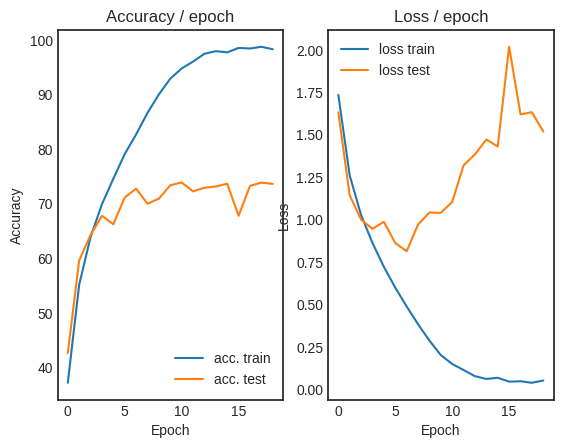

 95%|█████████▌| 19/20 [05:40<00:18, 18.04s/it]

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.207s (0.207s)	Loss 0.0348 (0.0348)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


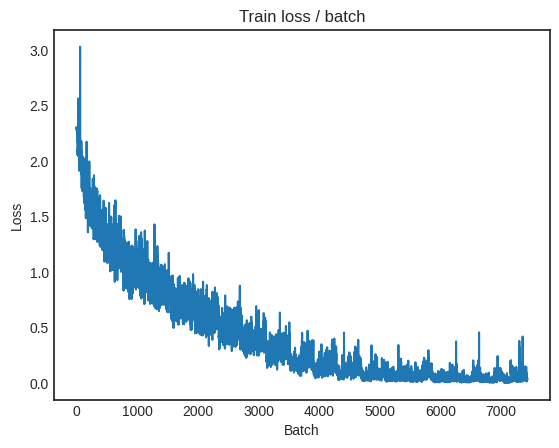

[TRAIN Batch 200/391]	Time 0.049s (0.040s)	Loss 0.0037 (0.0265)	Prec@1 100.0 ( 99.1)	Prec@5 100.0 (100.0)


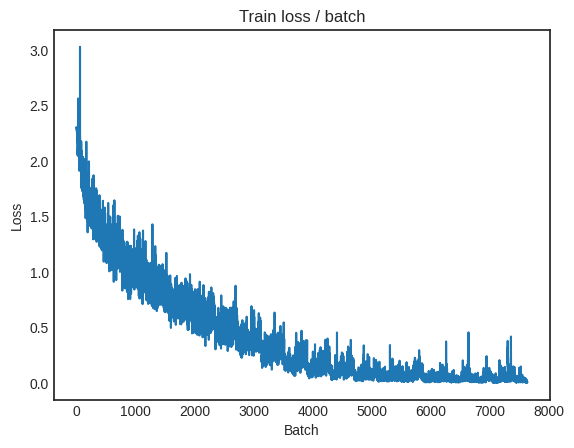


===============> Total time 14s	Avg loss 0.0325	Avg Prec@1 98.97 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 1.9172 (1.9172)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 1.7587	Avg Prec@1 73.90 %	Avg Prec@5 97.45 %



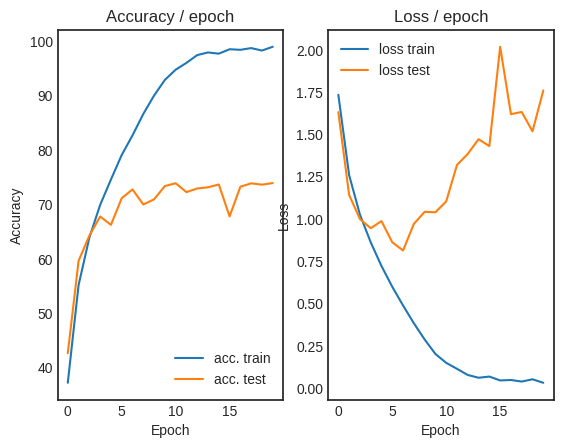

100%|██████████| 20/20 [05:59<00:00, 17.96s/it]


In [35]:
#start training on CIFAR

main_CIFAR_standardized(128, 0.1,epochs = 20, cuda=True)

21.**BONUS**: There are other normalization schemes that can be more efficient like ZCA normalization. Try other methods, explain the differences and compare them to the one requested.

**ATTENTION**: here in the notebook we encountered some problem regarding loading the batches files to calculate the PCA for the ZCA normalization. For this reason we founded easier to train and test the code outside the colab notebook. You can find the runnable implementation of this code inside the repository at project1cd/project1cd3_1_bonus.py

To easily have a look at our implementation without having to run the code, you can find the commented code of the ZCA Normalization below that you can also find in the repository mentioned. We decided to comment it because in case of a "run all cell" operation, the notebook won't have an exception.

In [36]:
# # Calculate pca.pkl

# from sklearn.decomposition import PCA
# import numpy as np
# import matplotlib.pyplot as plt
# from PIL import Image
# import pickle as pk

# def calculate_pca(dataset):
#     # initialize PCA
#     pca = PCA(n_components=400, random_state=0, svd_solver='randomized')
#     # fit PCA to dataset
#     pca.fit(dataset)
#     pk.dump(pca, open("pca.pkl","wb"))

# def unpickle(file):
#     with open(file, 'rb') as fo:
#         dict = pk.load(fo, encoding='bytes')
#     return dict


In [37]:
# ! wget https://www.cs.toronto.edu/~kriz/cifar-10-binary.tar.gz
# ! tar -xzf cifar-10-binary.tar.gz

In [38]:
# # Function to add ".bin" to each filename
# def add_bin_extension(filename):
#     return filename + ".bin"

# # Creating a list of modified filenames
# file_list_with_bin = [add_bin_extension("/content/cifar-10-batches-bin/data_batch_{}".format(n)) for n in range(1, 6)]

# file_list_with_bin

In [39]:
# # Using the list of filenames
# dd = np.vstack(tuple(unpickle(filename) for filename in file_list_with_bin))
# calculate_pca(dd)

In [40]:
# # zca normalization
# import pickle as pk

# from sklearn.decomposition import PCA

# import pandas as pd

# PRINT_INTERVAL = 200
# PATH="datasets"

# # styling and helper packages

# from tqdm import tqdm
# import matplotlib as mpl

# # ------------------------------ ZCA utils functions ---------------------------------

# class ZCA_whitening(object):
#     """Normalize images according to ZCA"""

#     def __init__(self, computed_pca):
#         self.computed_pca = computed_pca

#     def __call__(self, sample):
#         whitened_image = self.vtoimg(self.whiten(self.computed_pca, sample))
#         whitened_image = whitened_image.transpose(2, 0, 1)
#         torch_tensor = torch.tensor(whitened_image)
#         torch_tensor = torch_tensor.to(torch.float32)
#         return torch_tensor

#     def vtoimg(self, v):
#         return np.array(v, dtype=np.uint8).reshape(3,32,32).transpose([1,2,0]) / 255.0
#         # return np.array(np.clip(v, 0, 255), dtype=np.uint8).reshape(3,32,32).transpose([1,2,0])

#     def whiten(self, pca, vec):
#         _vec = vec.reshape(vec.shape[0] * vec.shape[1] * vec.shape[2])
#         QQ = np.dot(_vec - pca.mean_, pca.components_.T)
#         return np.dot(QQ / pca.singular_values_, pca.components_) * np.sqrt(60000) * 64 + 128


# # ----------------------------------------------------------------------------------------------


# def get_dataset_CIFAR_improved(batch_size, cuda=True):
#     """
#     This function loads the dataset and performs transformations on each
#     image (listed in `transform = ...`).
#     """

#     # image mean and std for CIFAR10
#     mean_CIFAR = (0.491, 0.482, 0.447)
#     sig_CIFAR = (0.202, 0.199, 0.201)

#     pca_reload = pk.load(open("pca.pkl",'rb'))
#     zca_transform = ZCA_whitening(computed_pca=pca_reload)


#     train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
#         transform=transforms.Compose([
#             transforms.ToTensor(),
#             zca_transform,
#             # transforms.Normalize(mean=mean_CIFAR, std=sig_CIFAR),
#         ]))


#     val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
#         transform=transforms.Compose([
#             transforms.ToTensor(),
#             zca_transform,
#             # transforms.Normalize(mean=mean_CIFAR, std=sig_CIFAR) #should we noramlize the validation set as well?
#         ]))

#     train_loader = torch.utils.data.DataLoader(train_dataset,
#                         batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
#     val_loader = torch.utils.data.DataLoader(val_dataset,
#                         batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

#     return train_loader, val_loader

# # make modifications to main function to accomodate CIFAR10

# def main_CIFAR_standardized(batch_size, lr, epochs, cuda):

#     # ex :
#     #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

#     # define model, loss, optim
#     model = ConvNet2()
#     criterion = nn.CrossEntropyLoss()
#     optimizer = torch.optim.SGD(model.parameters(), lr)

#     if cuda: # only with GPU, and not with CPU
#         cudnn.benchmark = True
#         model = model.cuda()
#         criterion = criterion.cuda()

#     # Get the data
#     train, test = get_dataset_CIFAR_improved(batch_size, cuda)

#     # init plots
#     plot = AccLossPlot()
#     global loss_plot
#     loss_plot = TrainLossPlot()

#     # We iterate on the epochs
#     for i in tqdm(range(epochs)):
#         print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
#         # Train phase
#         top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
#         # Test phase
#         top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
#         # plot
#         plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

# #start training on CIFAR

# main_CIFAR_standardized(batch_size=128, lr=0.1, epochs=20, cuda=True)

## 3.2 Increase in the number of training examples by data increase

### Modify network architecture

In [41]:
class ConvNet2(nn.Module):

    def __init__(self, channels = 3):
        super(ConvNet2, self).__init__()

        self.channels = channels # to handle color images
        self.conv1 = 32
        self.conv2 = 64
        self.conv3 = 64
        self.fc4 = 1000
        self.fc5 = 10

        # conv net as feature extractor
        self.features = nn.Sequential(
            nn.Conv2d(self.channels, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),

            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),

            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode = True),
        )

        self.classifier = nn.Sequential(
            nn.Linear(64 * 4 * 4, self.fc4),
            nn.ReLU(),
            nn.Linear(self.fc4, self.fc5),

            # Reminder: The softmax is included in the loss, do not put it here
            # nn.Softmax()
        )


    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers


        return output

### Modify call to dataset for more data augmentations

In [42]:
# adapting the dataset function to CIFAR10

def get_dataset_CIFAR(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """

    # image mean and std for CIFAR10
    mean_CIFAR = (0.491, 0.482, 0.447)
    sig_CIFAR = (0.202, 0.199, 0.201)


    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=mean_CIFAR, std=sig_CIFAR),
            transforms.RandomCrop(size = 28),
            transforms.RandomHorizontalFlip(p=0.5)
        ]))


    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=mean_CIFAR, std=sig_CIFAR)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

### New main function

In [43]:
def main_CIFAR_standardized(batch_size=128, lr=0.1, epochs=5, cuda=False):

    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet2()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset_CIFAR(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in tqdm(range(epochs)):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

Files already downloaded and verified
Files already downloaded and verified


  0%|          | 0/20 [00:00<?, ?it/s]

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.491s (0.491s)	Loss 2.2999 (2.2999)	Prec@1  10.9 ( 10.9)	Prec@5  58.6 ( 58.6)


<Figure size 640x480 with 0 Axes>

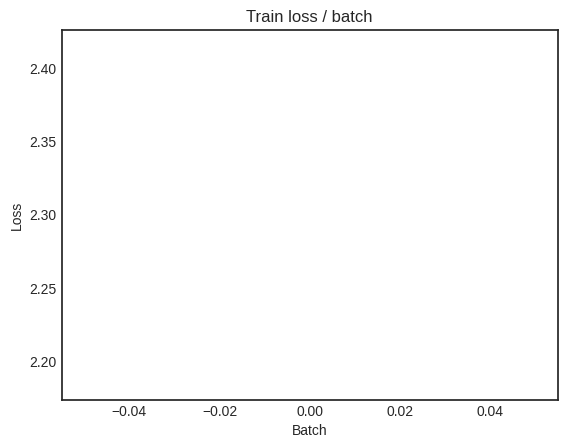

[TRAIN Batch 200/391]	Time 0.063s (0.050s)	Loss 1.9140 (1.9762)	Prec@1  35.2 ( 26.9)	Prec@5  82.8 ( 78.6)


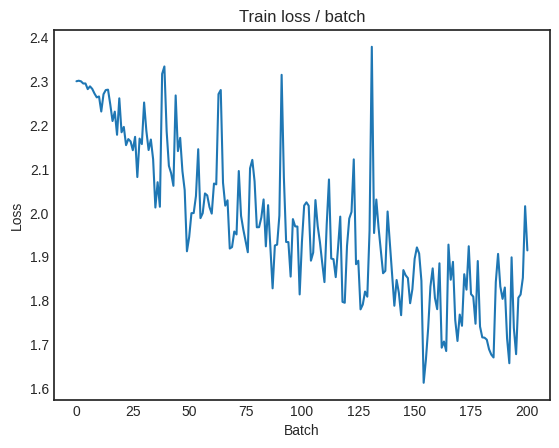


===============> Total time 18s	Avg loss 1.8117	Avg Prec@1 33.48 %	Avg Prec@5 83.84 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 1.6340 (1.6340)	Prec@1  44.5 ( 44.5)	Prec@5  88.3 ( 88.3)

===============> Total time 2s	Avg loss 1.5315	Avg Prec@1 44.69 %	Avg Prec@5 91.64 %



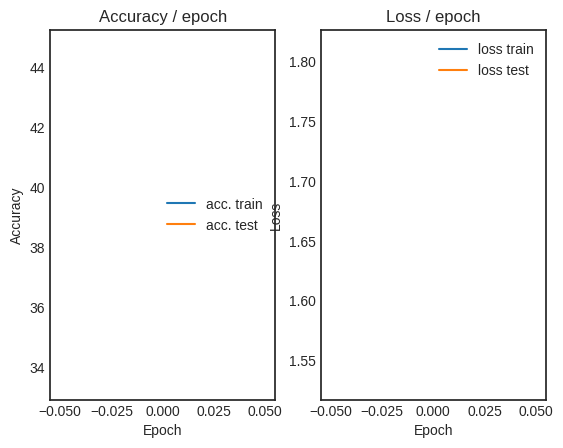

  5%|▌         | 1/20 [00:21<06:57, 21.99s/it]

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.348s (0.348s)	Loss 1.5503 (1.5503)	Prec@1  45.3 ( 45.3)	Prec@5  91.4 ( 91.4)


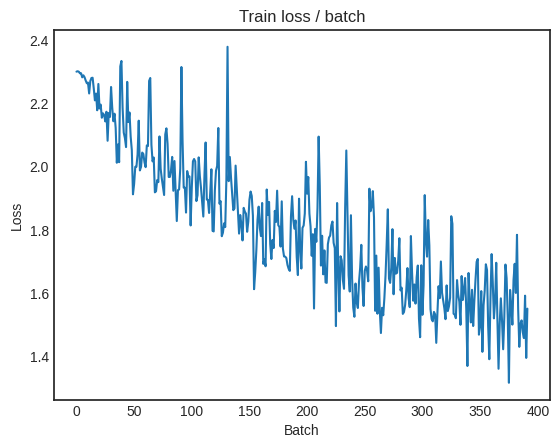

[TRAIN Batch 200/391]	Time 0.010s (0.047s)	Loss 1.4268 (1.4672)	Prec@1  49.2 ( 47.3)	Prec@5  95.3 ( 92.2)


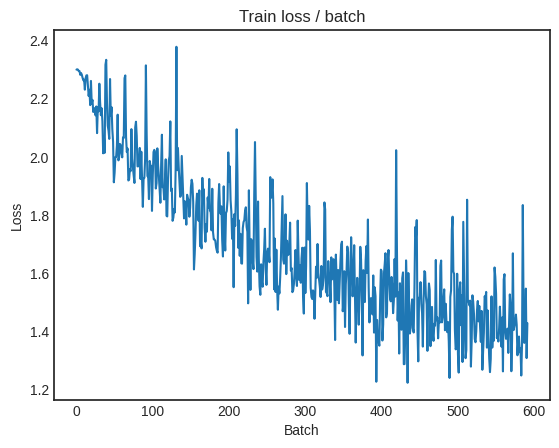


===============> Total time 18s	Avg loss 1.4030	Avg Prec@1 49.70 %	Avg Prec@5 92.95 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 1.3684 (1.3684)	Prec@1  55.5 ( 55.5)	Prec@5  93.8 ( 93.8)

===============> Total time 2s	Avg loss 1.5032	Avg Prec@1 49.96 %	Avg Prec@5 92.08 %



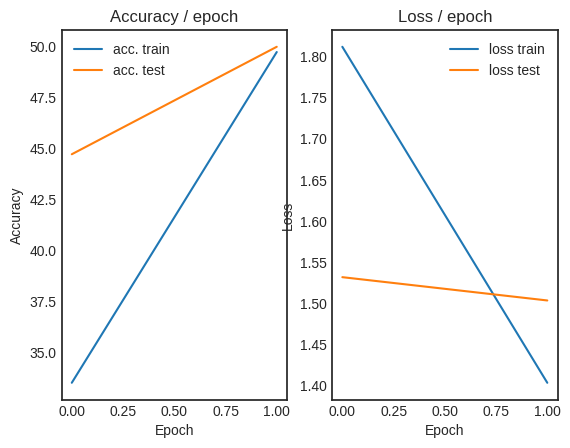

 10%|█         | 2/20 [00:43<06:35, 21.95s/it]

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 1.5353 (1.5353)	Prec@1  51.6 ( 51.6)	Prec@5  91.4 ( 91.4)


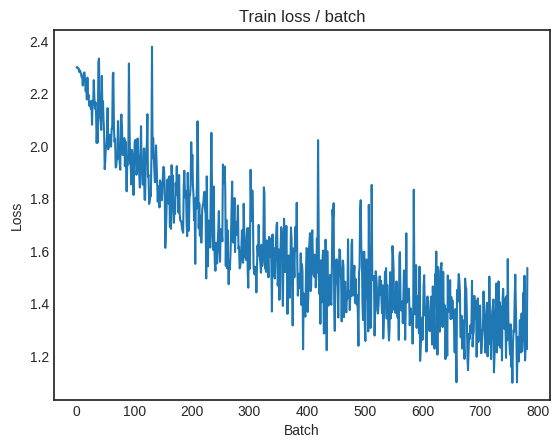

[TRAIN Batch 200/391]	Time 0.092s (0.052s)	Loss 1.2419 (1.2334)	Prec@1  56.2 ( 56.3)	Prec@5  93.8 ( 94.8)


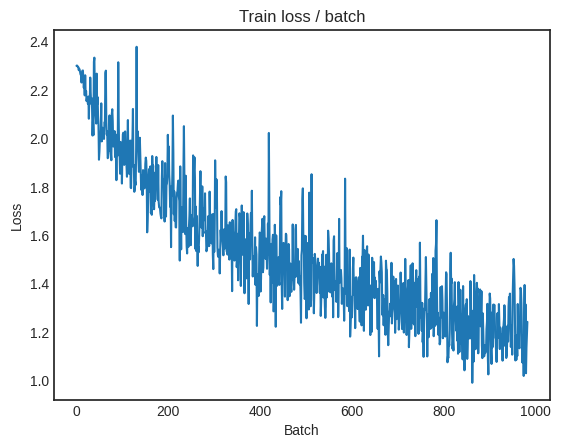


===============> Total time 19s	Avg loss 1.1904	Avg Prec@1 58.08 %	Avg Prec@5 95.19 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 1.1390 (1.1390)	Prec@1  63.3 ( 63.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.1526	Avg Prec@1 60.18 %	Avg Prec@5 95.70 %



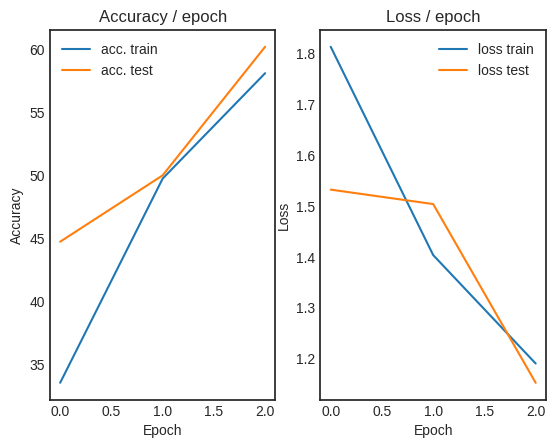

 15%|█▌        | 3/20 [01:06<06:20, 22.37s/it]

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.211s (0.211s)	Loss 1.1557 (1.1557)	Prec@1  57.0 ( 57.0)	Prec@5  96.1 ( 96.1)


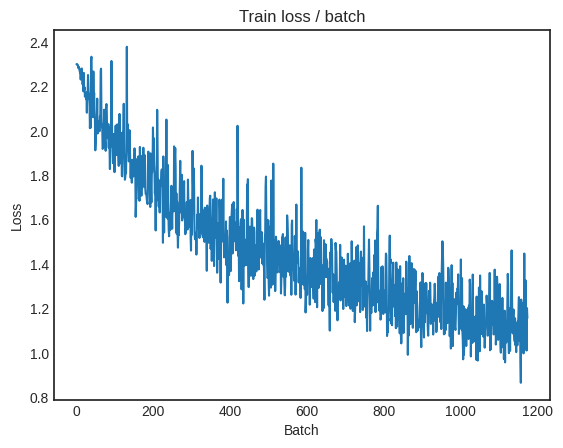

[TRAIN Batch 200/391]	Time 0.036s (0.051s)	Loss 1.0159 (1.0577)	Prec@1  67.2 ( 62.6)	Prec@5  95.3 ( 96.4)


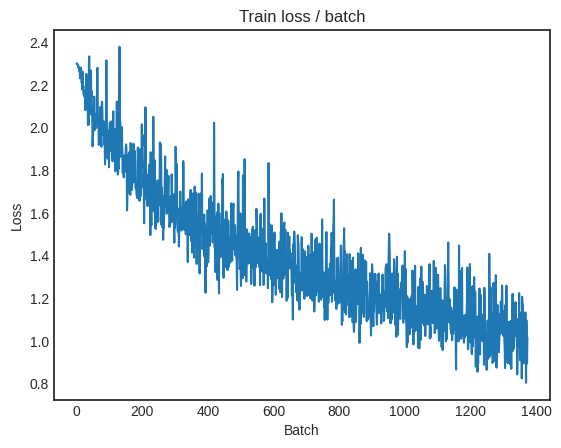


===============> Total time 19s	Avg loss 1.0315	Avg Prec@1 63.88 %	Avg Prec@5 96.55 %

[EVAL Batch 000/079]	Time 0.251s (0.251s)	Loss 1.0035 (1.0035)	Prec@1  64.8 ( 64.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.0150	Avg Prec@1 64.61 %	Avg Prec@5 96.57 %



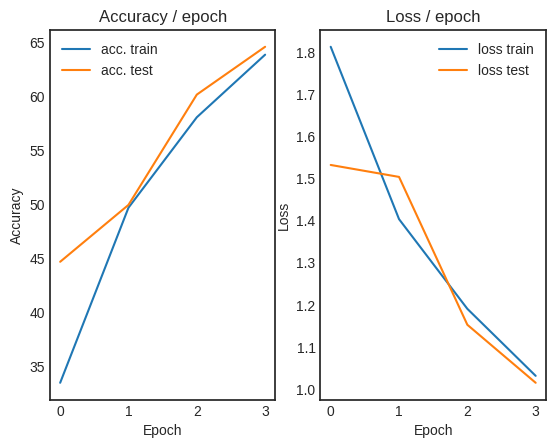

 20%|██        | 4/20 [01:29<06:00, 22.54s/it]

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.9498 (0.9498)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)


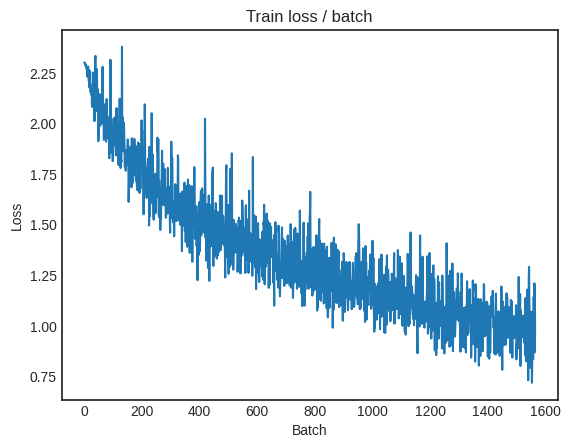

[TRAIN Batch 200/391]	Time 0.138s (0.049s)	Loss 0.9818 (0.9341)	Prec@1  64.8 ( 67.6)	Prec@5  98.4 ( 97.0)


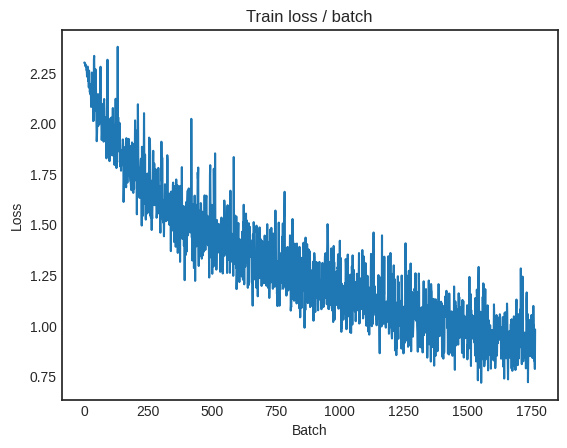


===============> Total time 18s	Avg loss 0.9240	Avg Prec@1 68.01 %	Avg Prec@5 97.16 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.8812 (0.8812)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9449	Avg Prec@1 67.61 %	Avg Prec@5 96.87 %



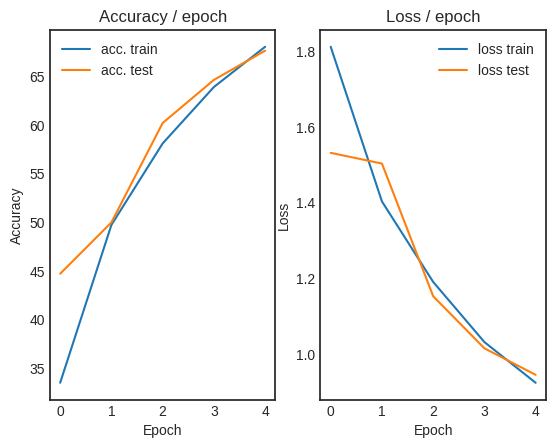

 25%|██▌       | 5/20 [01:51<05:34, 22.28s/it]

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.289s (0.289s)	Loss 0.8252 (0.8252)	Prec@1  71.1 ( 71.1)	Prec@5  96.1 ( 96.1)


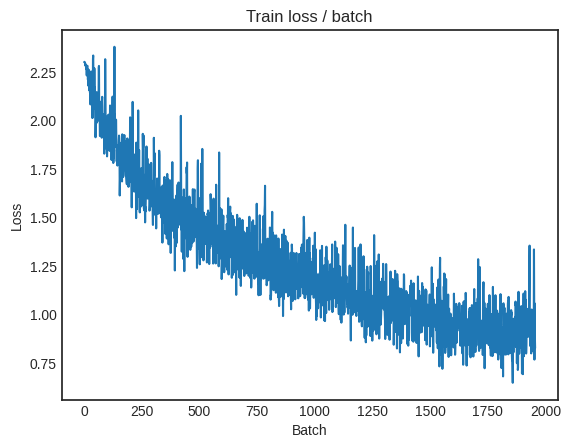

[TRAIN Batch 200/391]	Time 0.060s (0.047s)	Loss 0.9972 (0.8440)	Prec@1  70.3 ( 70.7)	Prec@5  96.9 ( 97.8)


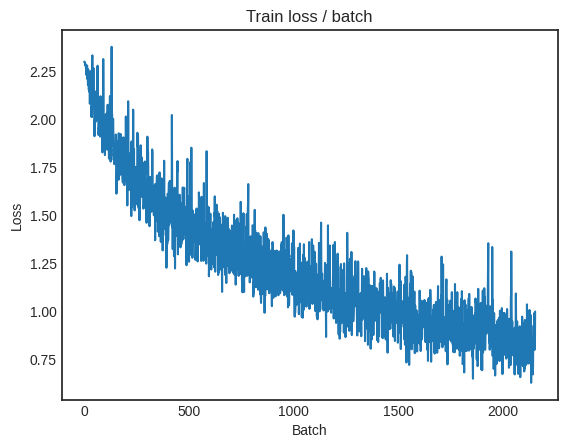


===============> Total time 18s	Avg loss 0.8326	Avg Prec@1 71.05 %	Avg Prec@5 97.80 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 1.1072 (1.1072)	Prec@1  59.4 ( 59.4)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.0555	Avg Prec@1 63.33 %	Avg Prec@5 96.70 %



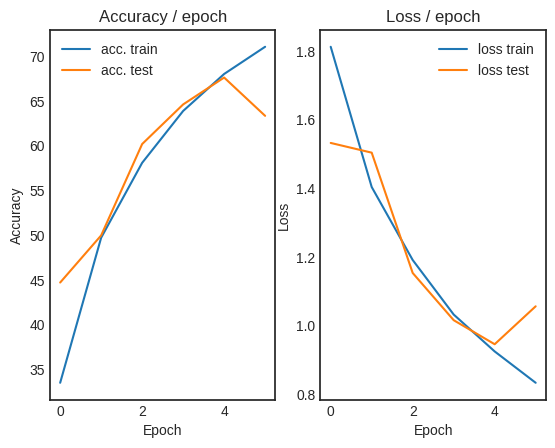

 30%|███       | 6/20 [02:13<05:09, 22.11s/it]

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 1.0964 (1.0964)	Prec@1  64.1 ( 64.1)	Prec@5  96.1 ( 96.1)


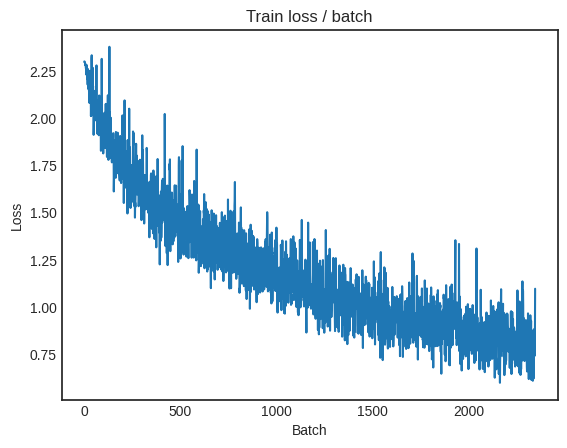

[TRAIN Batch 200/391]	Time 0.015s (0.050s)	Loss 0.7235 (0.7775)	Prec@1  70.3 ( 72.8)	Prec@5 100.0 ( 98.1)


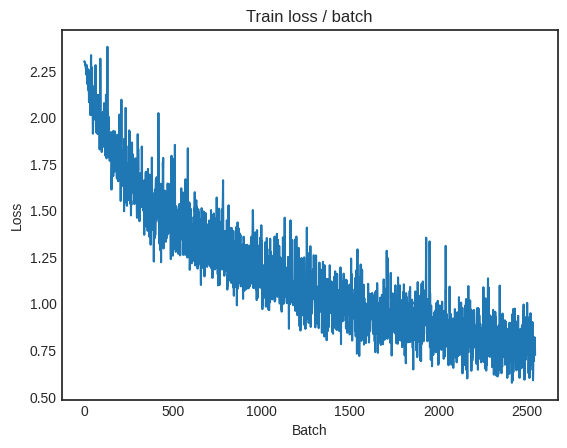


===============> Total time 19s	Avg loss 0.7719	Avg Prec@1 73.06 %	Avg Prec@5 98.12 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.8180 (0.8180)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8197	Avg Prec@1 71.38 %	Avg Prec@5 97.82 %



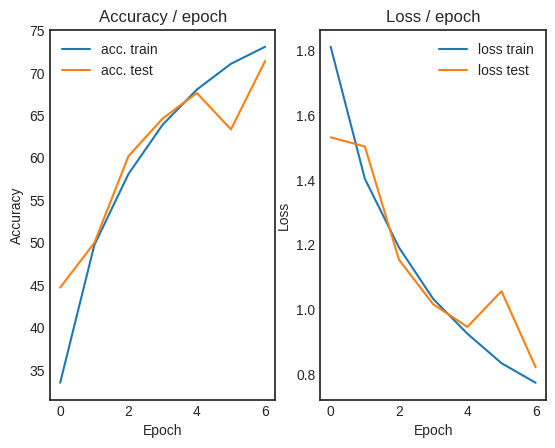

 35%|███▌      | 7/20 [02:35<04:48, 22.17s/it]

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 0.6599 (0.6599)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)


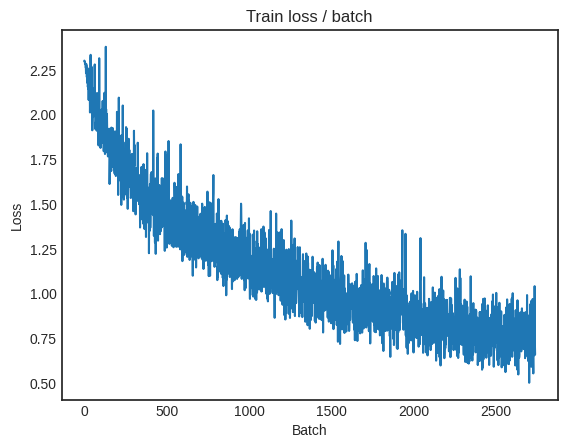

[TRAIN Batch 200/391]	Time 0.064s (0.051s)	Loss 0.6958 (0.7150)	Prec@1  74.2 ( 75.1)	Prec@5  97.7 ( 98.5)


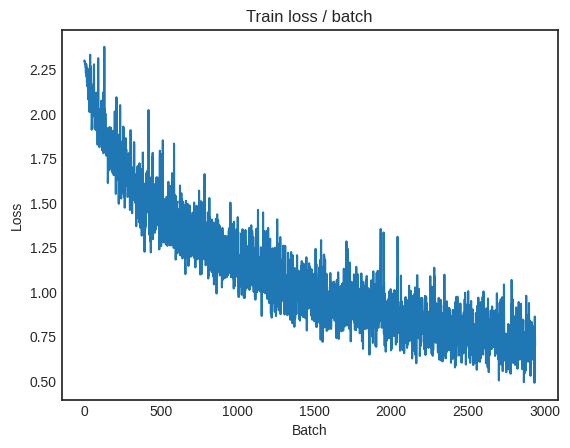


===============> Total time 18s	Avg loss 0.7108	Avg Prec@1 75.35 %	Avg Prec@5 98.45 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.7653 (0.7653)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8036	Avg Prec@1 72.59 %	Avg Prec@5 97.77 %



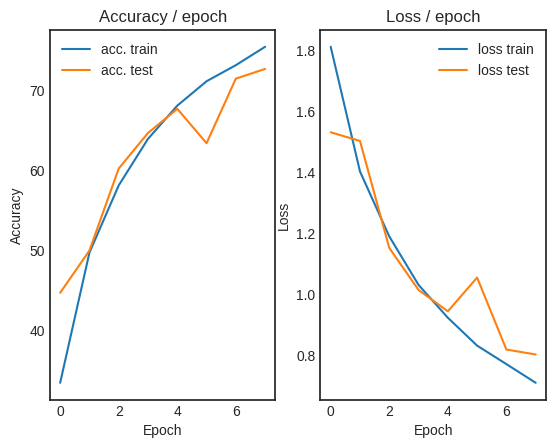

 40%|████      | 8/20 [02:57<04:27, 22.28s/it]

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.5239 (0.5239)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)


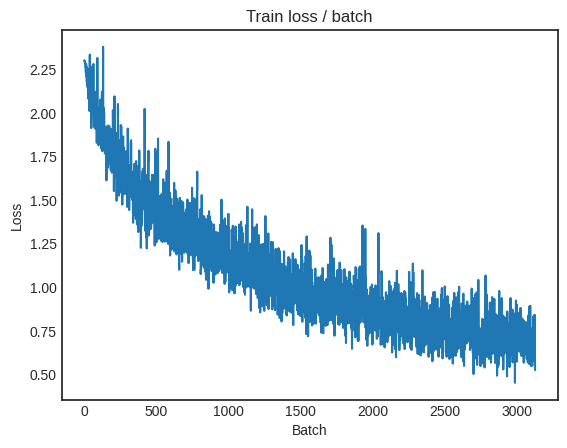

[TRAIN Batch 200/391]	Time 0.112s (0.045s)	Loss 0.7388 (0.6619)	Prec@1  75.8 ( 77.0)	Prec@5 100.0 ( 98.6)


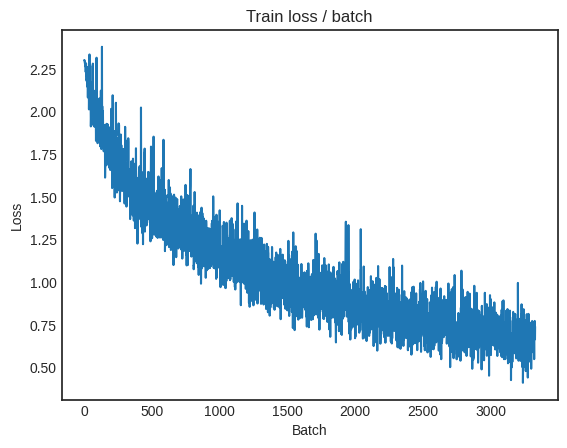


===============> Total time 18s	Avg loss 0.6646	Avg Prec@1 76.81 %	Avg Prec@5 98.61 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 0.8080 (0.8080)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8334	Avg Prec@1 71.28 %	Avg Prec@5 98.00 %



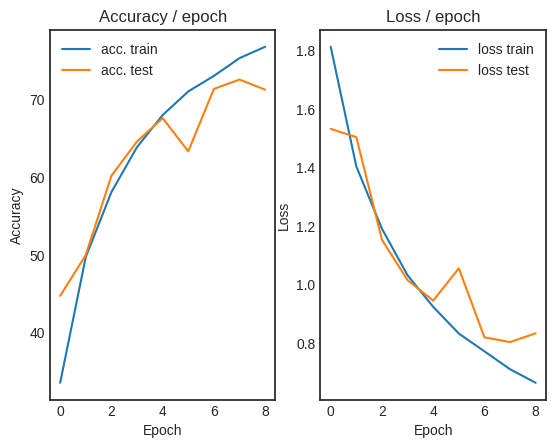

 45%|████▌     | 9/20 [03:19<04:01, 21.96s/it]

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 0.5712 (0.5712)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)


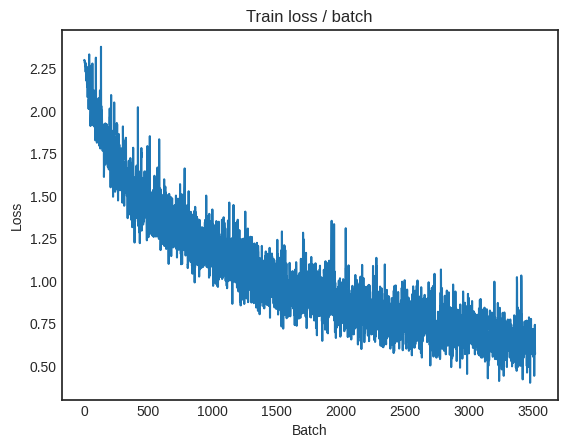

[TRAIN Batch 200/391]	Time 0.015s (0.050s)	Loss 0.8540 (0.6247)	Prec@1  68.0 ( 78.5)	Prec@5  97.7 ( 98.9)


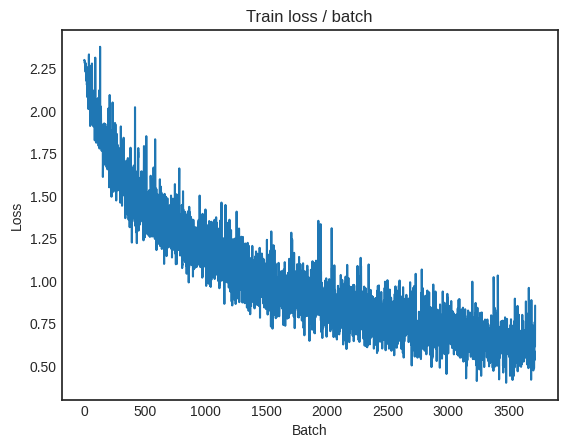


===============> Total time 19s	Avg loss 0.6187	Avg Prec@1 78.55 %	Avg Prec@5 98.85 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 0.8624 (0.8624)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7447	Avg Prec@1 74.74 %	Avg Prec@5 98.13 %



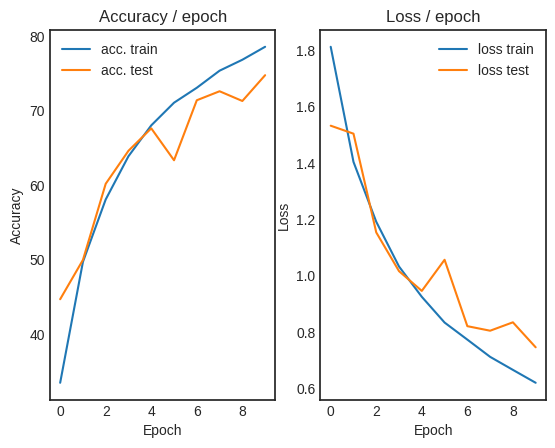

 50%|█████     | 10/20 [03:41<03:41, 22.17s/it]

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 0.6625 (0.6625)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)


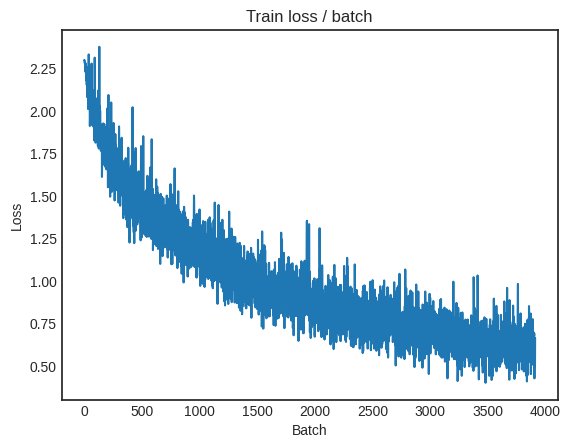

[TRAIN Batch 200/391]	Time 0.078s (0.050s)	Loss 0.5222 (0.5828)	Prec@1  82.0 ( 79.9)	Prec@5 100.0 ( 99.0)


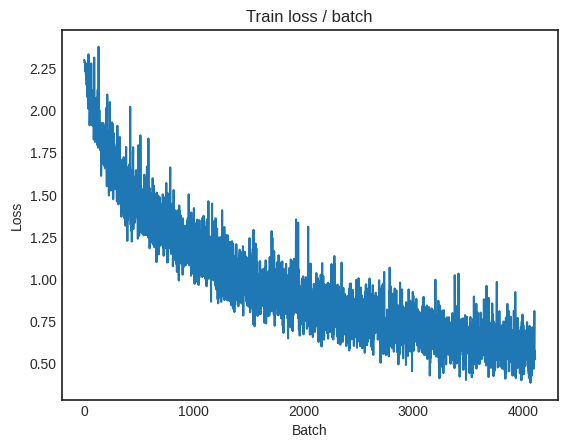


===============> Total time 19s	Avg loss 0.5836	Avg Prec@1 79.89 %	Avg Prec@5 98.96 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.7539 (0.7539)	Prec@1  79.7 ( 79.7)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7493	Avg Prec@1 74.58 %	Avg Prec@5 98.34 %



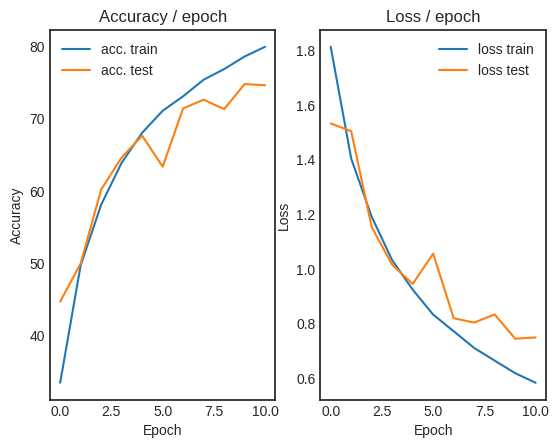

 55%|█████▌    | 11/20 [04:04<03:20, 22.26s/it]

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.213s (0.213s)	Loss 0.3853 (0.3853)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)


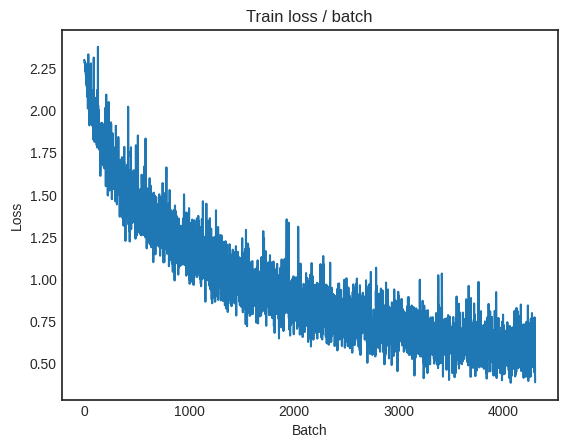

[TRAIN Batch 200/391]	Time 0.013s (0.051s)	Loss 0.5677 (0.5524)	Prec@1  82.0 ( 80.7)	Prec@5  97.7 ( 99.0)


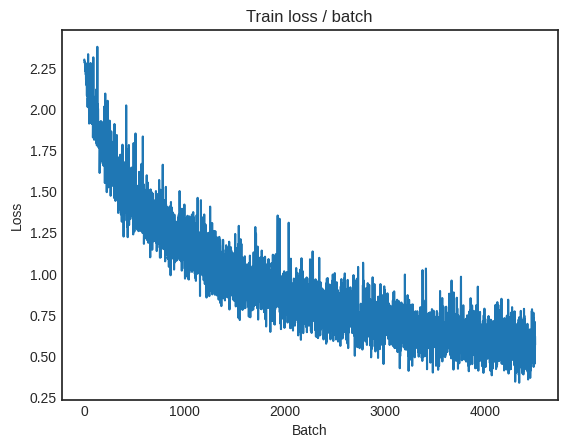


===============> Total time 18s	Avg loss 0.5570	Avg Prec@1 80.70 %	Avg Prec@5 99.04 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.8636 (0.8636)	Prec@1  80.5 ( 80.5)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8298	Avg Prec@1 72.17 %	Avg Prec@5 98.18 %



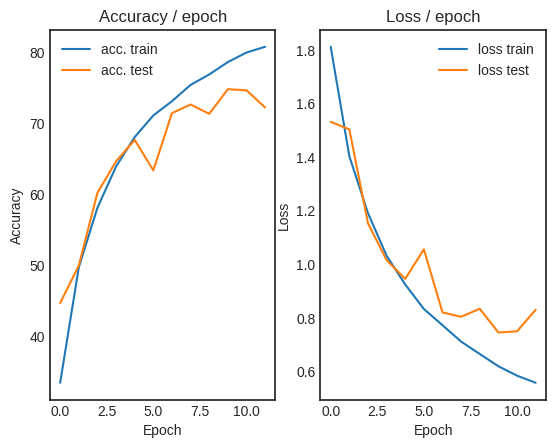

 60%|██████    | 12/20 [04:26<02:58, 22.32s/it]

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.5743 (0.5743)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


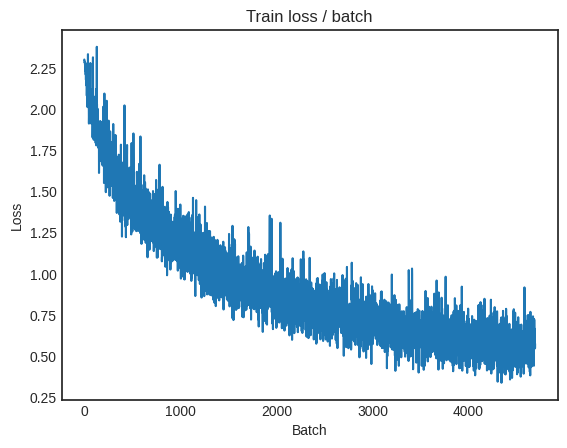

[TRAIN Batch 200/391]	Time 0.015s (0.047s)	Loss 0.6119 (0.5217)	Prec@1  75.0 ( 81.8)	Prec@5  98.4 ( 99.3)


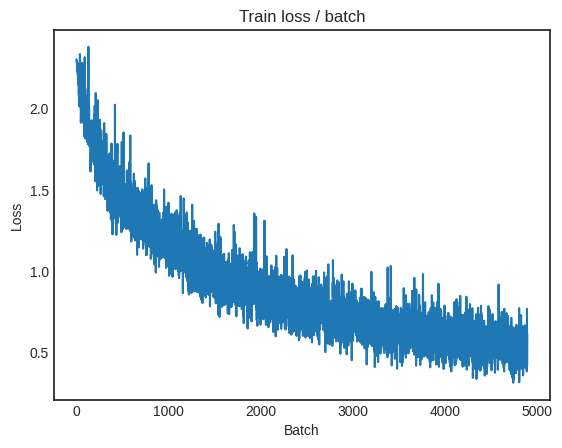


===============> Total time 20s	Avg loss 0.5292	Avg Prec@1 81.46 %	Avg Prec@5 99.22 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.7946 (0.7946)	Prec@1  75.8 ( 75.8)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7725	Avg Prec@1 74.33 %	Avg Prec@5 98.18 %



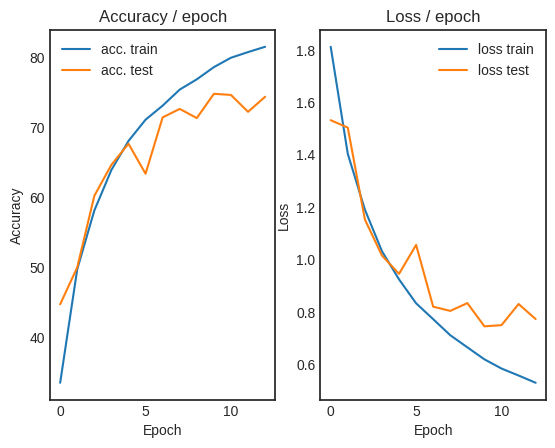

 65%|██████▌   | 13/20 [04:50<02:39, 22.85s/it]

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.367s (0.367s)	Loss 0.5492 (0.5492)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)


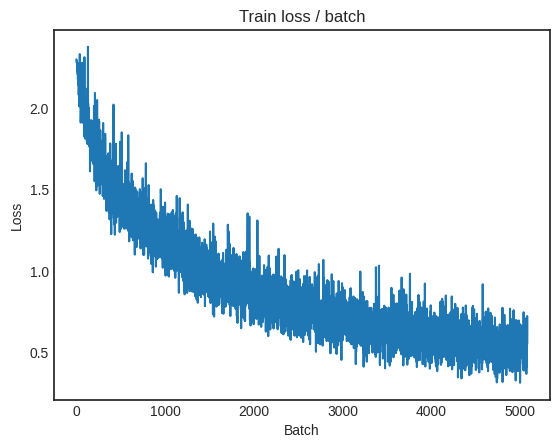

[TRAIN Batch 200/391]	Time 0.012s (0.047s)	Loss 0.5496 (0.4929)	Prec@1  80.5 ( 82.9)	Prec@5 100.0 ( 99.4)


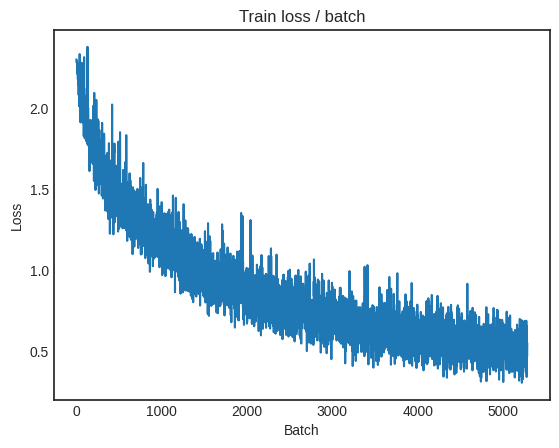


===============> Total time 19s	Avg loss 0.4962	Avg Prec@1 82.73 %	Avg Prec@5 99.31 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.7005 (0.7005)	Prec@1  80.5 ( 80.5)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7532	Avg Prec@1 75.88 %	Avg Prec@5 98.40 %



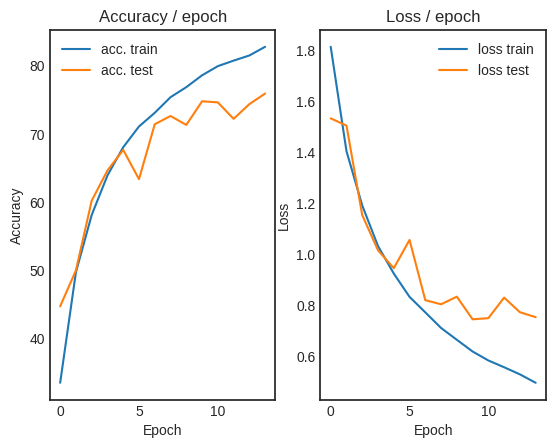

 70%|███████   | 14/20 [05:12<02:15, 22.59s/it]

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.229s (0.229s)	Loss 0.4402 (0.4402)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


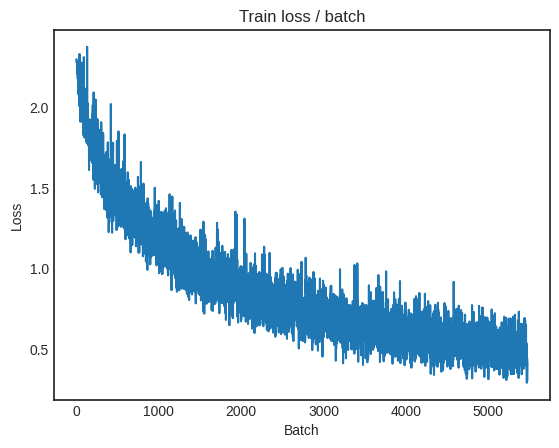

[TRAIN Batch 200/391]	Time 0.045s (0.051s)	Loss 0.5030 (0.4712)	Prec@1  82.0 ( 83.5)	Prec@5  99.2 ( 99.4)


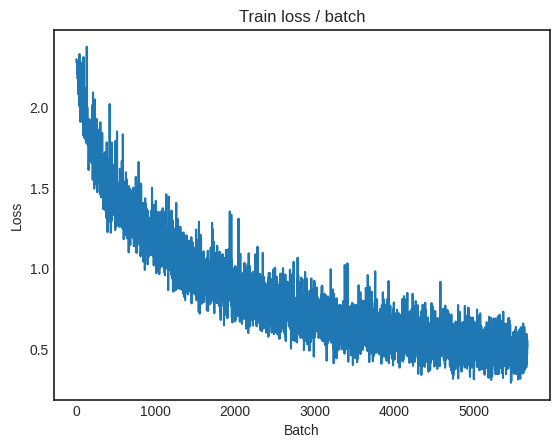


===============> Total time 19s	Avg loss 0.4750	Avg Prec@1 83.48 %	Avg Prec@5 99.40 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.7773 (0.7773)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7109	Avg Prec@1 76.09 %	Avg Prec@5 98.36 %



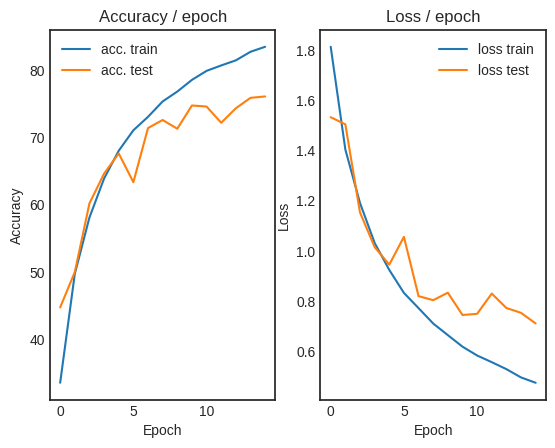

 75%|███████▌  | 15/20 [05:35<01:53, 22.60s/it]

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.214s (0.214s)	Loss 0.5295 (0.5295)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


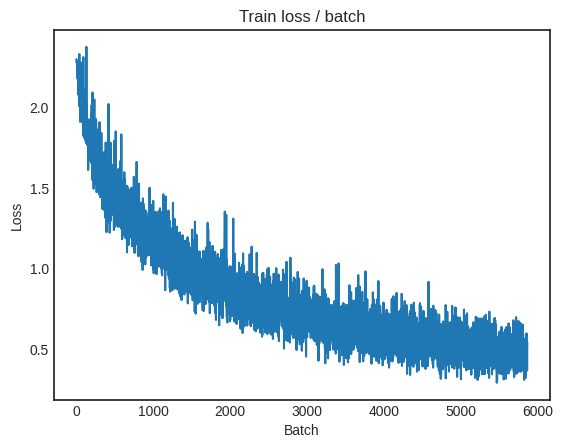

[TRAIN Batch 200/391]	Time 0.044s (0.051s)	Loss 0.3778 (0.4516)	Prec@1  89.1 ( 84.2)	Prec@5 100.0 ( 99.4)


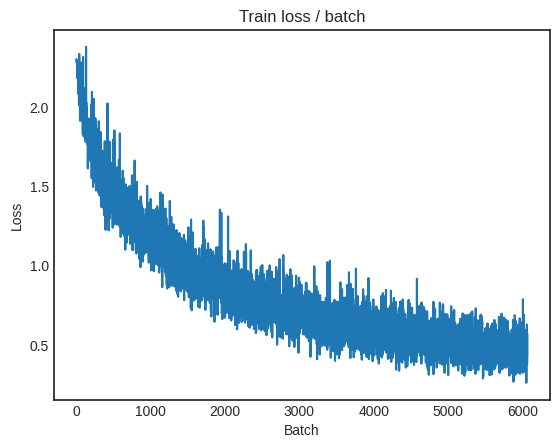


===============> Total time 19s	Avg loss 0.4551	Avg Prec@1 84.12 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.235s (0.235s)	Loss 0.8192 (0.8192)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7929	Avg Prec@1 74.84 %	Avg Prec@5 98.20 %



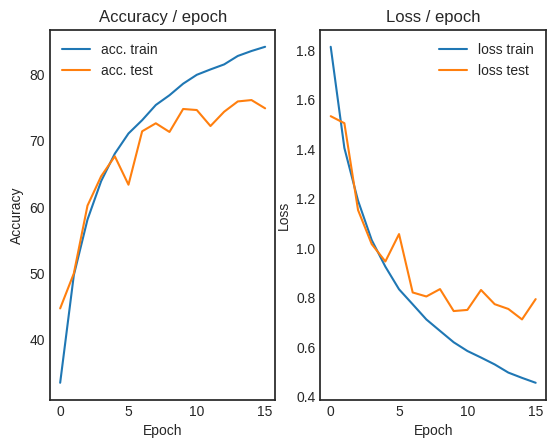

 80%|████████  | 16/20 [05:58<01:30, 22.61s/it]

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.192s (0.192s)	Loss 0.5389 (0.5389)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)


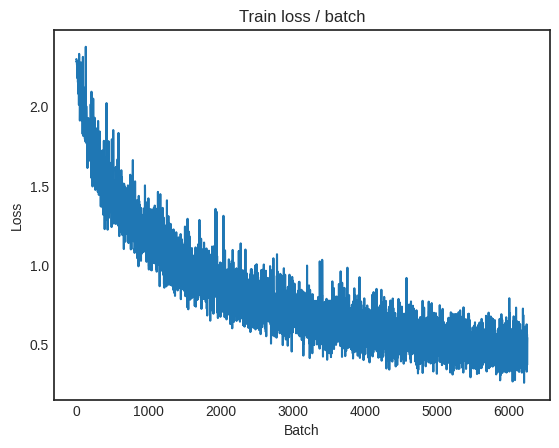

[TRAIN Batch 200/391]	Time 0.022s (0.050s)	Loss 0.2373 (0.4183)	Prec@1  93.0 ( 85.3)	Prec@5 100.0 ( 99.5)


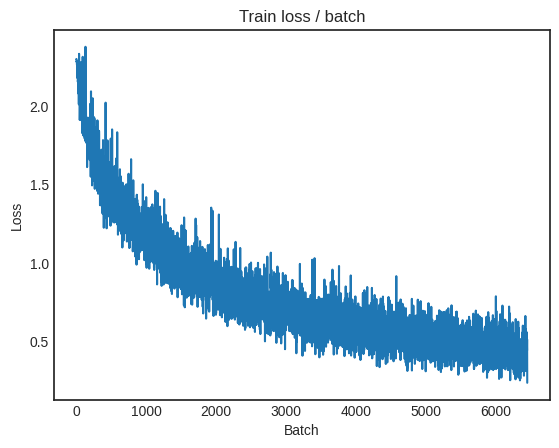


===============> Total time 18s	Avg loss 0.4278	Avg Prec@1 84.94 %	Avg Prec@5 99.51 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 0.7902 (0.7902)	Prec@1  82.0 ( 82.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7174	Avg Prec@1 76.57 %	Avg Prec@5 98.50 %



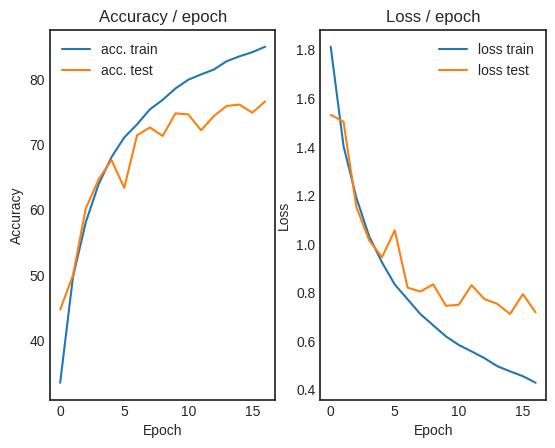

 85%|████████▌ | 17/20 [06:19<01:07, 22.36s/it]

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.349s (0.349s)	Loss 0.3184 (0.3184)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


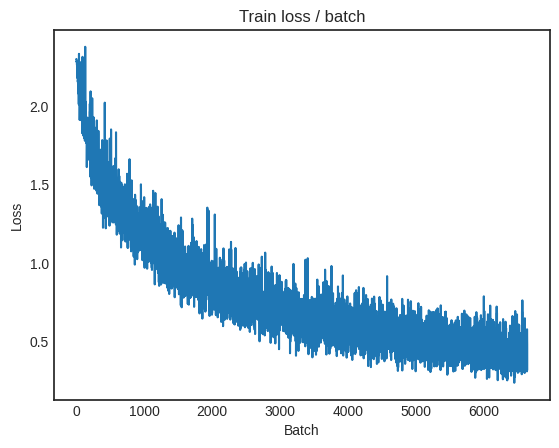

[TRAIN Batch 200/391]	Time 0.061s (0.048s)	Loss 0.5518 (0.4099)	Prec@1  79.7 ( 85.5)	Prec@5  99.2 ( 99.6)


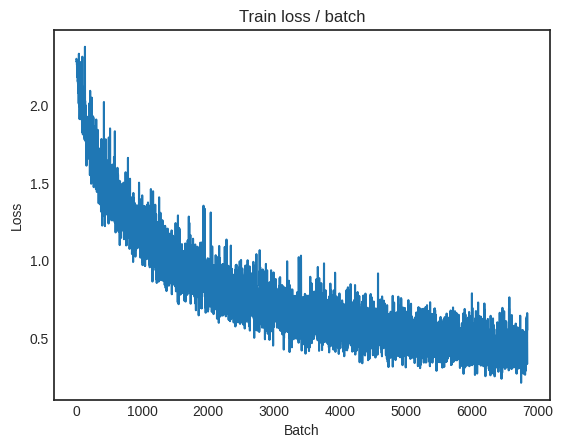


===============> Total time 19s	Avg loss 0.4123	Avg Prec@1 85.46 %	Avg Prec@5 99.54 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 0.7266 (0.7266)	Prec@1  82.0 ( 82.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.6768	Avg Prec@1 78.04 %	Avg Prec@5 98.57 %



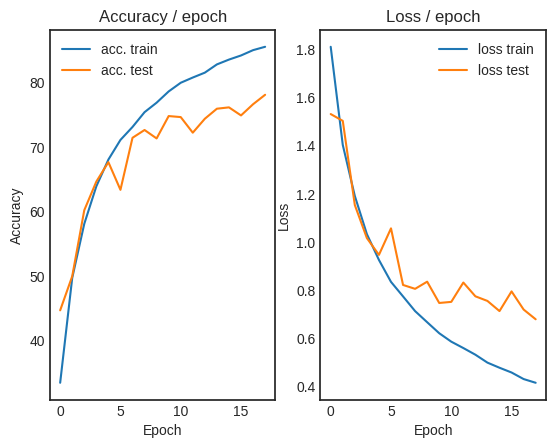

 90%|█████████ | 18/20 [06:42<00:44, 22.29s/it]

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 0.2928 (0.2928)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


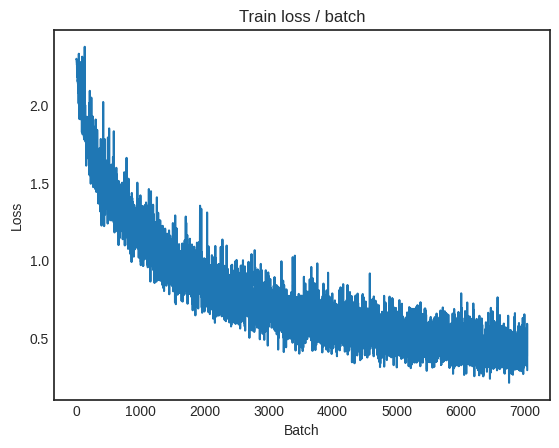

[TRAIN Batch 200/391]	Time 0.076s (0.050s)	Loss 0.4248 (0.3835)	Prec@1  85.9 ( 86.4)	Prec@5  99.2 ( 99.6)


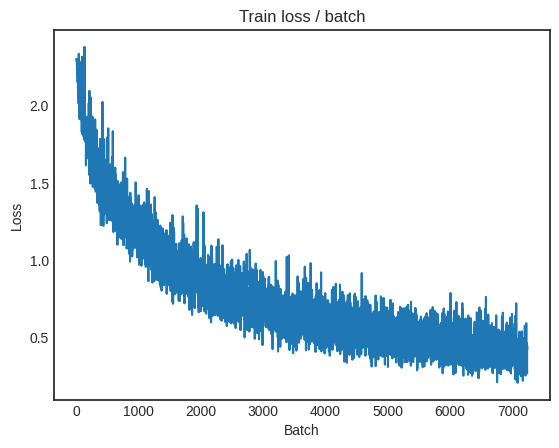


===============> Total time 19s	Avg loss 0.3909	Avg Prec@1 86.31 %	Avg Prec@5 99.57 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 0.7019 (0.7019)	Prec@1  82.0 ( 82.0)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7318	Avg Prec@1 77.37 %	Avg Prec@5 98.46 %



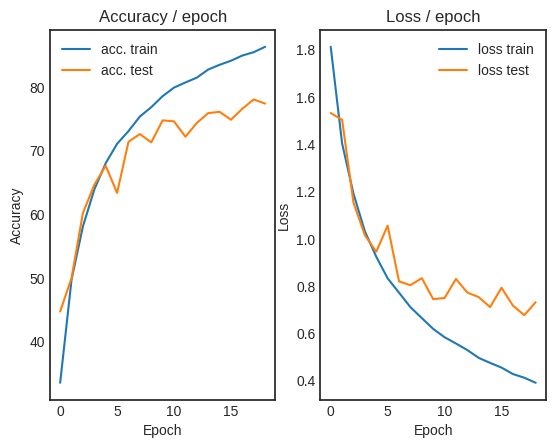

 95%|█████████▌| 19/20 [07:04<00:22, 22.34s/it]

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.230s (0.230s)	Loss 0.4821 (0.4821)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


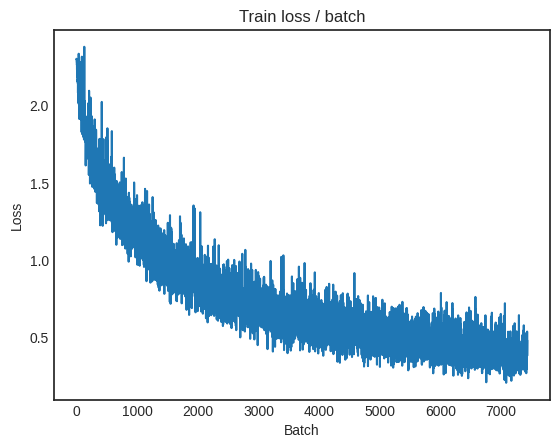

[TRAIN Batch 200/391]	Time 0.067s (0.050s)	Loss 0.3297 (0.3678)	Prec@1  90.6 ( 87.2)	Prec@5  99.2 ( 99.6)


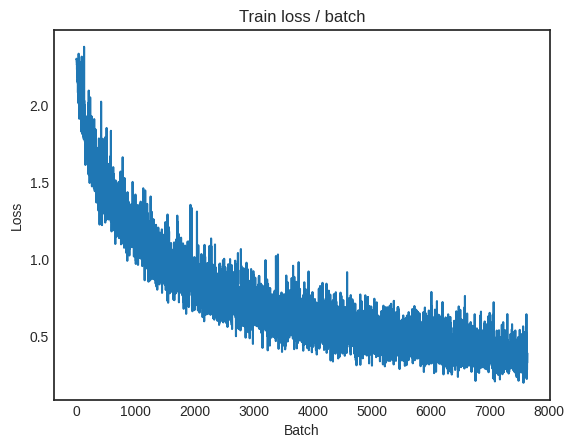


===============> Total time 18s	Avg loss 0.3755	Avg Prec@1 86.86 %	Avg Prec@5 99.63 %

[EVAL Batch 000/079]	Time 0.240s (0.240s)	Loss 0.6852 (0.6852)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7092	Avg Prec@1 77.65 %	Avg Prec@5 98.55 %



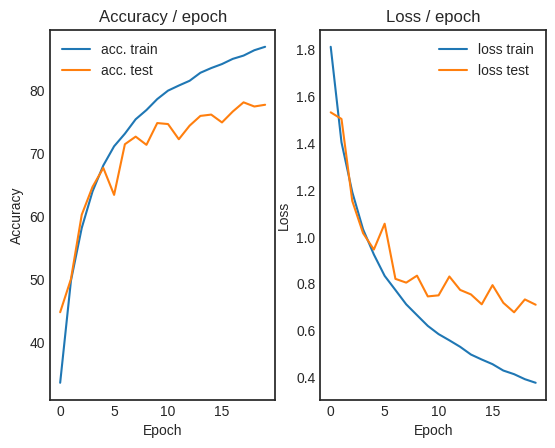

100%|██████████| 20/20 [07:26<00:00, 22.35s/it]


In [44]:
main_CIFAR_standardized(batch_size = 128, lr=0.1, epochs = 20, cuda = True)

25. **Bonus** : Other data augmentation methods are possible. Find out which ones and test some.

Files already downloaded and verified
Files already downloaded and verified


  0%|          | 0/20 [00:00<?, ?it/s]

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.296s (0.296s)	Loss 2.3024 (2.3024)	Prec@1  11.7 ( 11.7)	Prec@5  45.3 ( 45.3)


<Figure size 640x480 with 0 Axes>

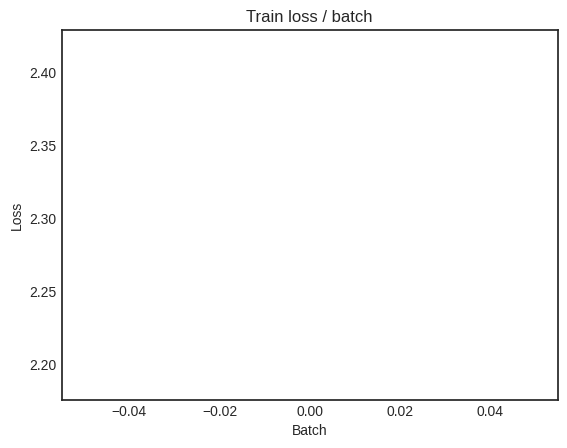

[TRAIN Batch 200/391]	Time 0.022s (0.096s)	Loss 1.8506 (2.0313)	Prec@1  30.5 ( 25.1)	Prec@5  89.1 ( 76.1)


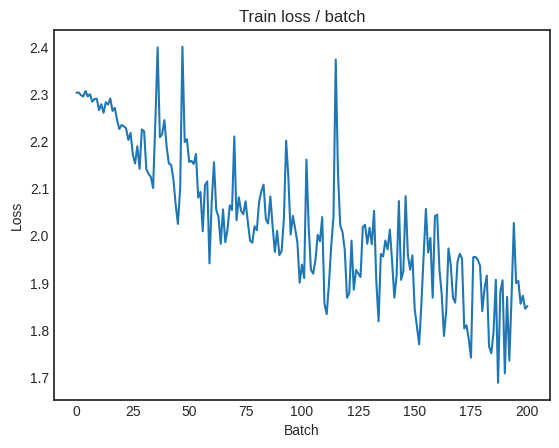


===============> Total time 38s	Avg loss 1.9281	Avg Prec@1 29.52 %	Avg Prec@5 80.50 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 1.6506 (1.6506)	Prec@1  41.4 ( 41.4)	Prec@5  87.5 ( 87.5)

===============> Total time 2s	Avg loss 1.6700	Avg Prec@1 40.62 %	Avg Prec@5 88.99 %



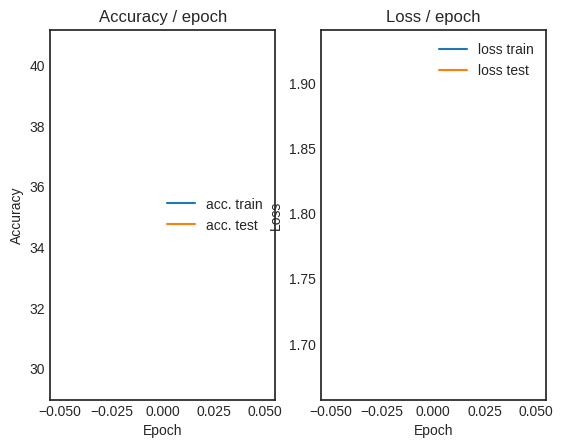

  5%|▌         | 1/20 [00:41<13:01, 41.11s/it]

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.259s (0.259s)	Loss 1.6327 (1.6327)	Prec@1  39.1 ( 39.1)	Prec@5  89.1 ( 89.1)


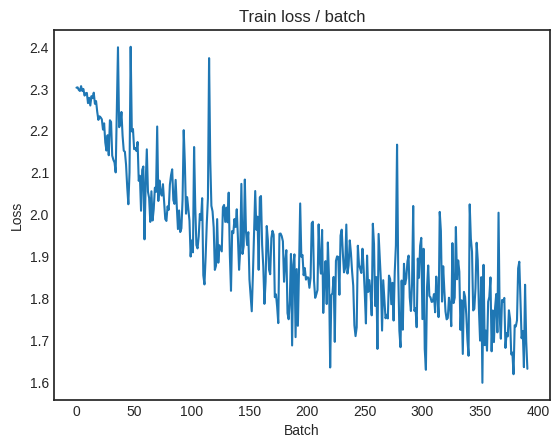

[TRAIN Batch 200/391]	Time 0.010s (0.098s)	Loss 1.6711 (1.7121)	Prec@1  36.7 ( 38.5)	Prec@5  86.7 ( 87.6)


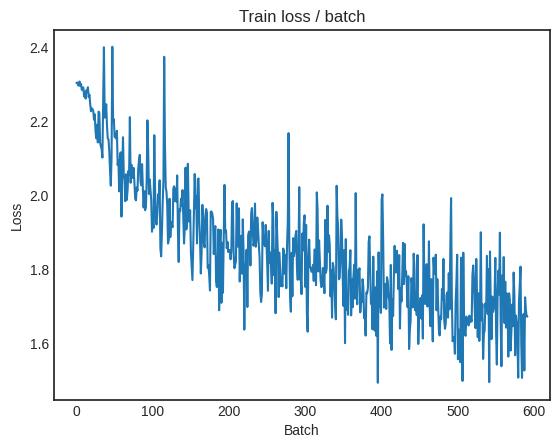


===============> Total time 37s	Avg loss 1.6751	Avg Prec@1 39.60 %	Avg Prec@5 88.27 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 1.5661 (1.5661)	Prec@1  43.8 ( 43.8)	Prec@5  92.2 ( 92.2)

===============> Total time 2s	Avg loss 1.5854	Avg Prec@1 43.11 %	Avg Prec@5 89.63 %



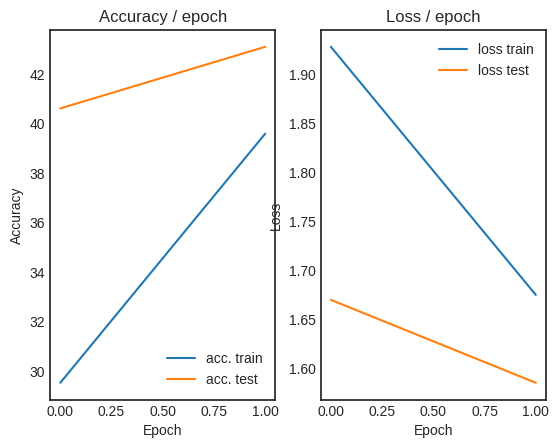

 10%|█         | 2/20 [01:21<12:08, 40.45s/it]

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.296s (0.296s)	Loss 1.6853 (1.6853)	Prec@1  39.8 ( 39.8)	Prec@5  87.5 ( 87.5)


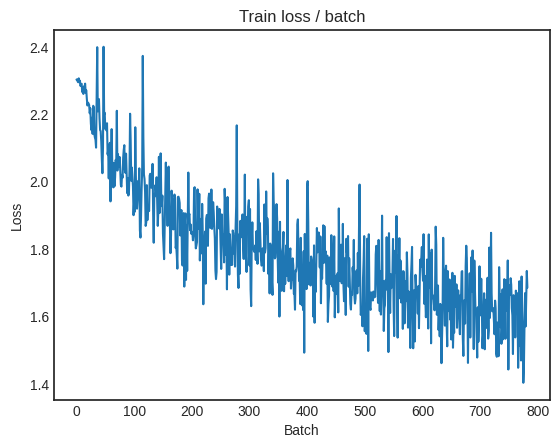

[TRAIN Batch 200/391]	Time 0.008s (0.101s)	Loss 1.5845 (1.5784)	Prec@1  43.0 ( 43.3)	Prec@5  89.8 ( 89.9)


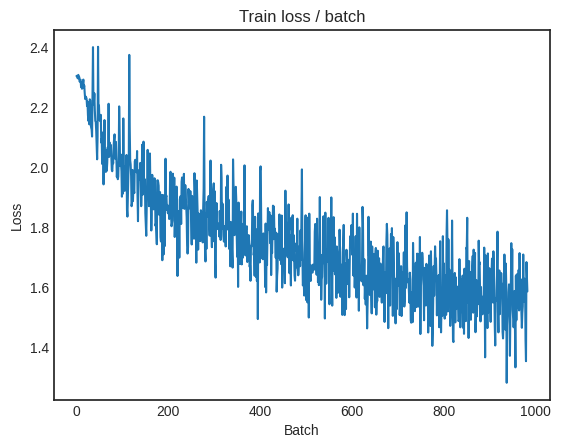


===============> Total time 37s	Avg loss 1.5538	Avg Prec@1 44.27 %	Avg Prec@5 90.36 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 1.3780 (1.3780)	Prec@1  57.8 ( 57.8)	Prec@5  93.0 ( 93.0)

===============> Total time 2s	Avg loss 1.4793	Avg Prec@1 46.84 %	Avg Prec@5 92.38 %



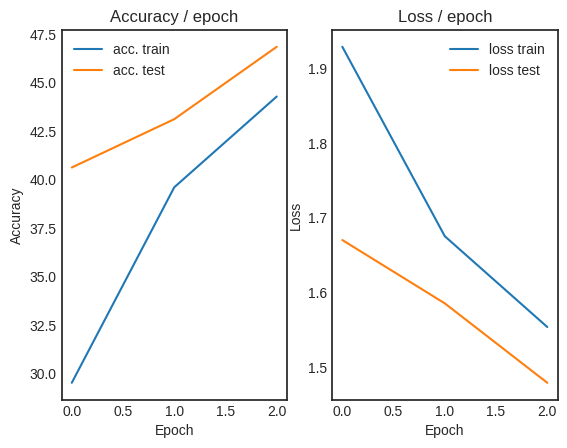

 15%|█▌        | 3/20 [02:01<11:28, 40.49s/it]

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.298s (0.298s)	Loss 1.5408 (1.5408)	Prec@1  47.7 ( 47.7)	Prec@5  94.5 ( 94.5)


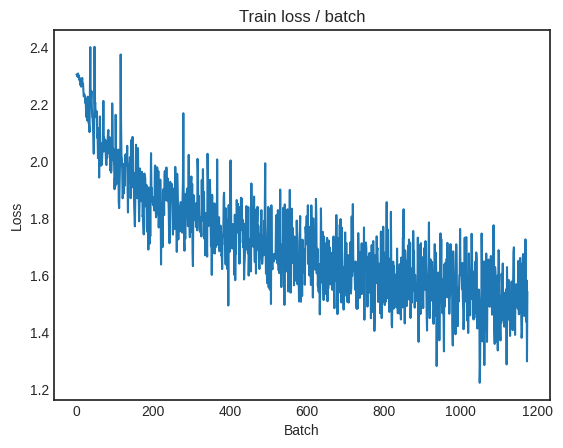

[TRAIN Batch 200/391]	Time 0.112s (0.100s)	Loss 1.4660 (1.4732)	Prec@1  40.6 ( 46.9)	Prec@5  93.8 ( 91.6)


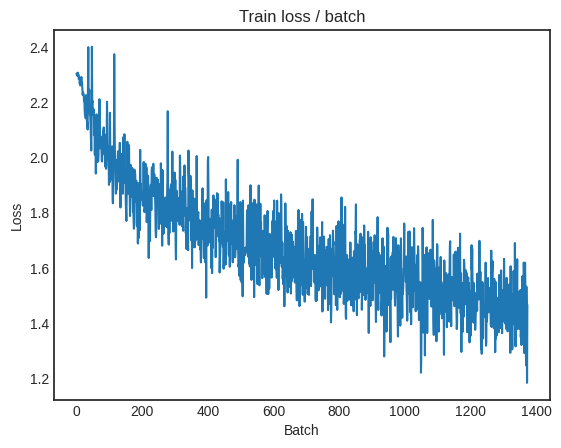


===============> Total time 37s	Avg loss 1.4633	Avg Prec@1 47.34 %	Avg Prec@5 91.72 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 1.3254 (1.3254)	Prec@1  57.8 ( 57.8)	Prec@5  92.2 ( 92.2)

===============> Total time 3s	Avg loss 1.4040	Avg Prec@1 50.20 %	Avg Prec@5 93.20 %



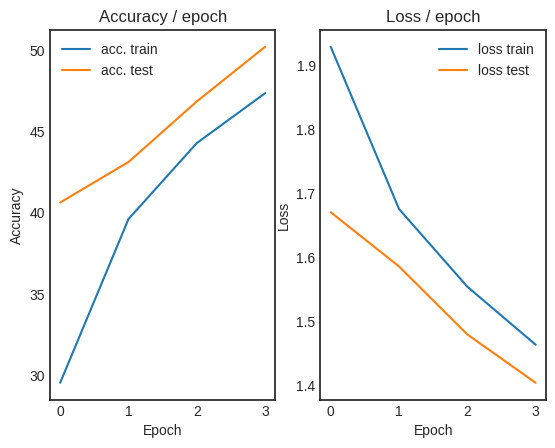

 20%|██        | 4/20 [02:43<10:55, 40.99s/it]

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.270s (0.270s)	Loss 1.3382 (1.3382)	Prec@1  47.7 ( 47.7)	Prec@5  93.8 ( 93.8)


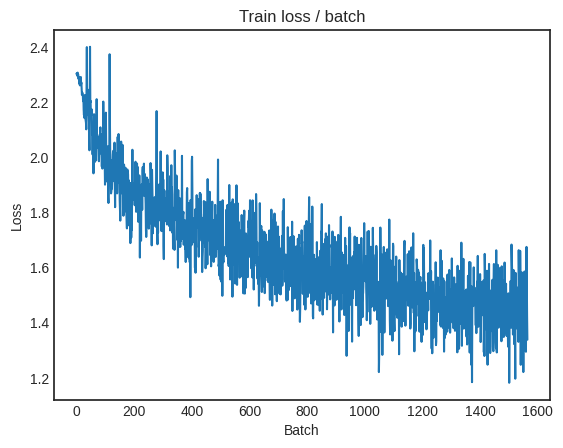

[TRAIN Batch 200/391]	Time 0.017s (0.093s)	Loss 1.4009 (1.4060)	Prec@1  53.9 ( 49.5)	Prec@5  91.4 ( 92.5)


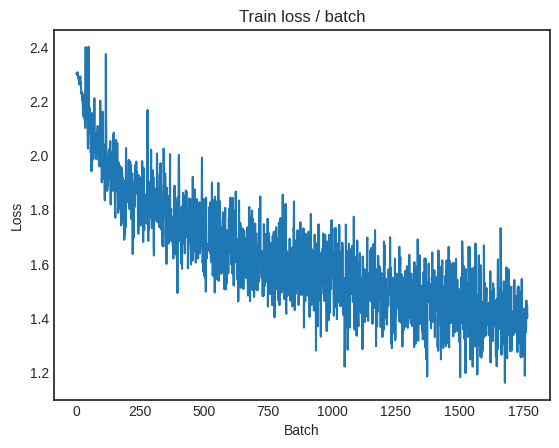


===============> Total time 38s	Avg loss 1.3850	Avg Prec@1 50.48 %	Avg Prec@5 92.80 %

[EVAL Batch 000/079]	Time 0.274s (0.274s)	Loss 1.2131 (1.2131)	Prec@1  59.4 ( 59.4)	Prec@5  94.5 ( 94.5)

===============> Total time 3s	Avg loss 1.2941	Avg Prec@1 54.48 %	Avg Prec@5 93.56 %



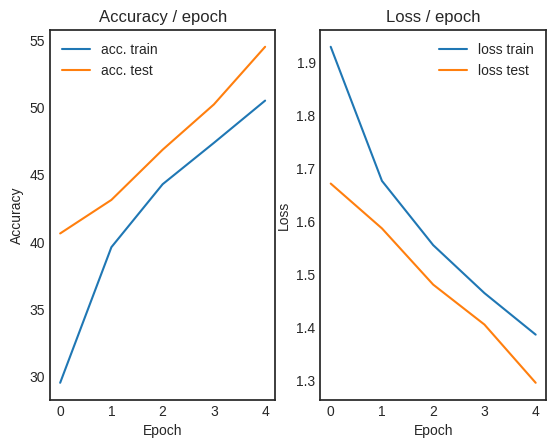

 25%|██▌       | 5/20 [03:25<10:20, 41.38s/it]

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.297s (0.297s)	Loss 1.3982 (1.3982)	Prec@1  50.8 ( 50.8)	Prec@5  95.3 ( 95.3)


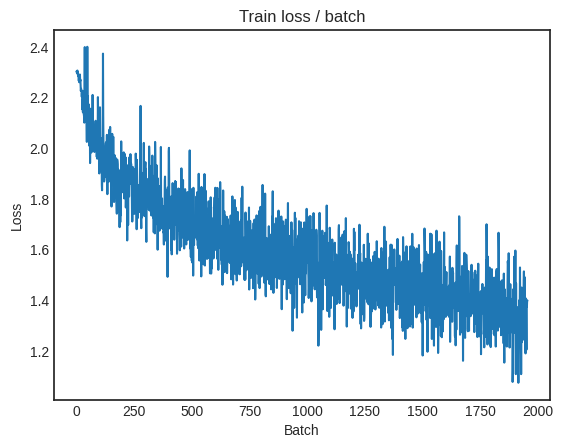

[TRAIN Batch 200/391]	Time 0.164s (0.093s)	Loss 1.4504 (1.3400)	Prec@1  50.8 ( 52.1)	Prec@5  92.2 ( 93.2)


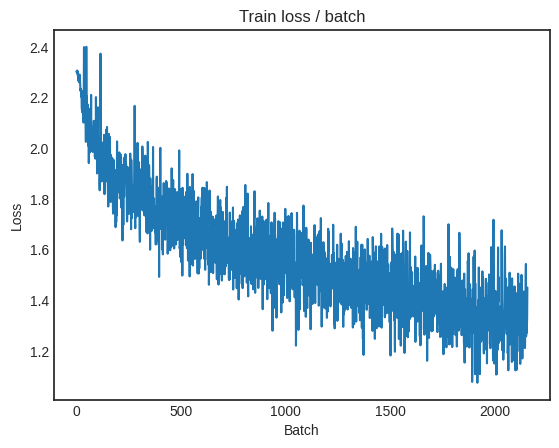


===============> Total time 37s	Avg loss 1.3238	Avg Prec@1 52.83 %	Avg Prec@5 93.52 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 1.2382 (1.2382)	Prec@1  61.7 ( 61.7)	Prec@5  93.8 ( 93.8)

===============> Total time 2s	Avg loss 1.2762	Avg Prec@1 55.06 %	Avg Prec@5 94.54 %



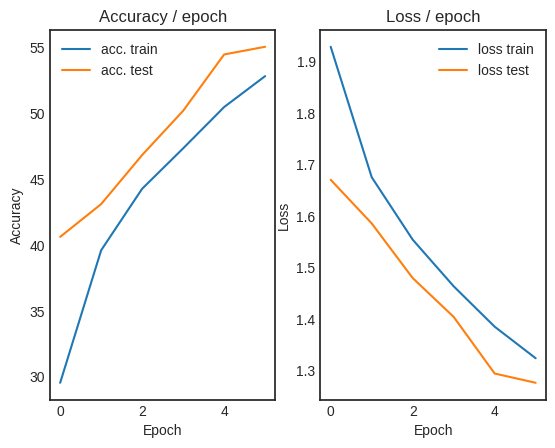

 30%|███       | 6/20 [04:05<09:33, 40.97s/it]

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.290s (0.290s)	Loss 1.3118 (1.3118)	Prec@1  48.4 ( 48.4)	Prec@5  95.3 ( 95.3)


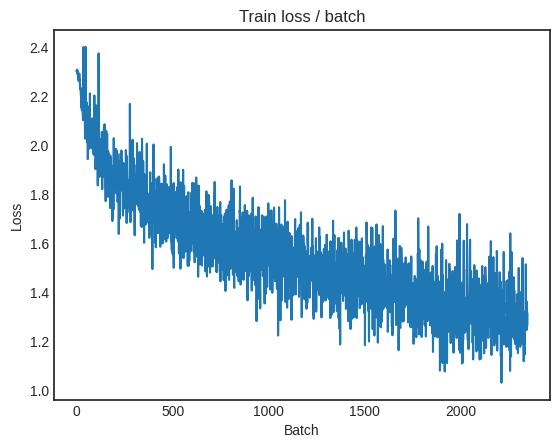

[TRAIN Batch 200/391]	Time 0.126s (0.094s)	Loss 1.2706 (1.2743)	Prec@1  51.6 ( 54.3)	Prec@5  95.3 ( 94.2)


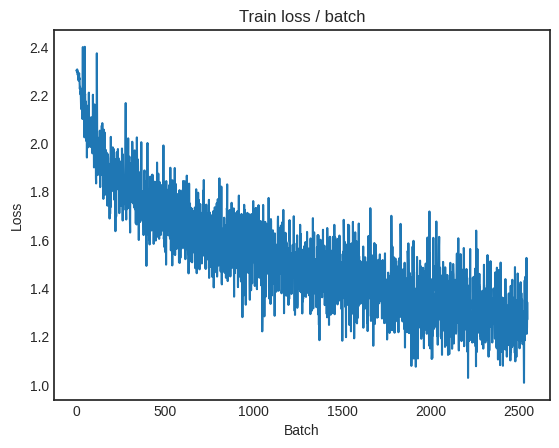


===============> Total time 37s	Avg loss 1.2669	Avg Prec@1 54.70 %	Avg Prec@5 94.23 %

[EVAL Batch 000/079]	Time 0.178s (0.178s)	Loss 1.1682 (1.1682)	Prec@1  63.3 ( 63.3)	Prec@5  93.8 ( 93.8)

===============> Total time 2s	Avg loss 1.2082	Avg Prec@1 57.39 %	Avg Prec@5 95.16 %



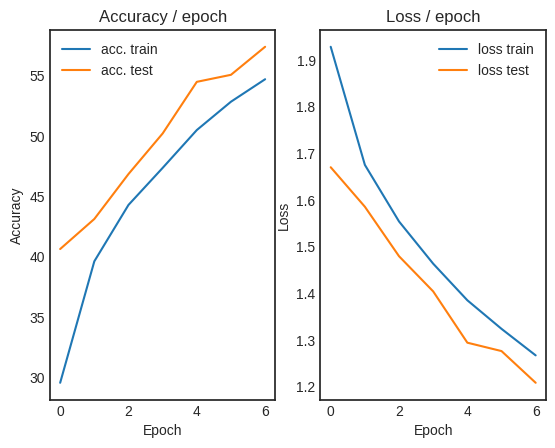

 35%|███▌      | 7/20 [04:45<08:49, 40.72s/it]

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.278s (0.278s)	Loss 1.1691 (1.1691)	Prec@1  57.8 ( 57.8)	Prec@5  96.9 ( 96.9)


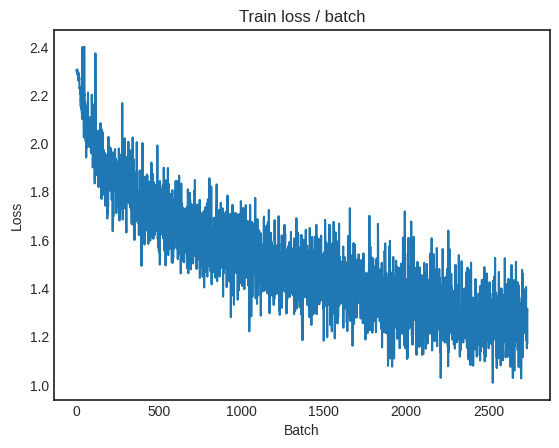

[TRAIN Batch 200/391]	Time 0.008s (0.096s)	Loss 1.2821 (1.2242)	Prec@1  53.9 ( 56.7)	Prec@5  92.2 ( 94.4)


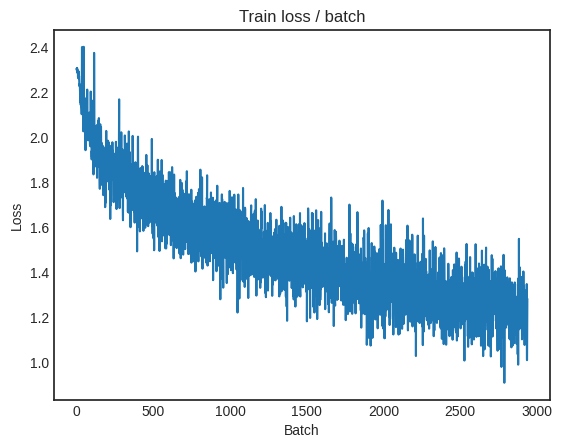


===============> Total time 36s	Avg loss 1.2155	Avg Prec@1 56.89 %	Avg Prec@5 94.61 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 1.1162 (1.1162)	Prec@1  66.4 ( 66.4)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.1983	Avg Prec@1 58.05 %	Avg Prec@5 95.83 %



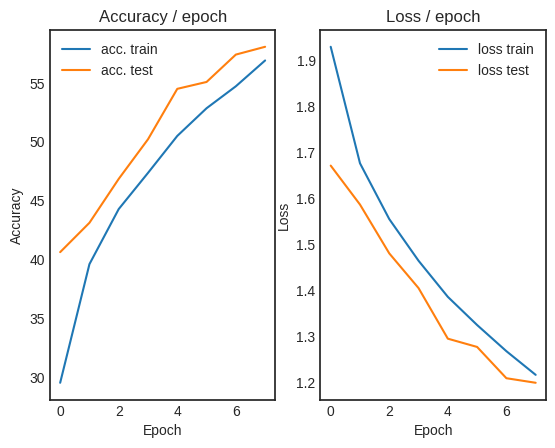

 40%|████      | 8/20 [05:25<08:04, 40.35s/it]

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.305s (0.305s)	Loss 1.2752 (1.2752)	Prec@1  50.8 ( 50.8)	Prec@5  92.2 ( 92.2)


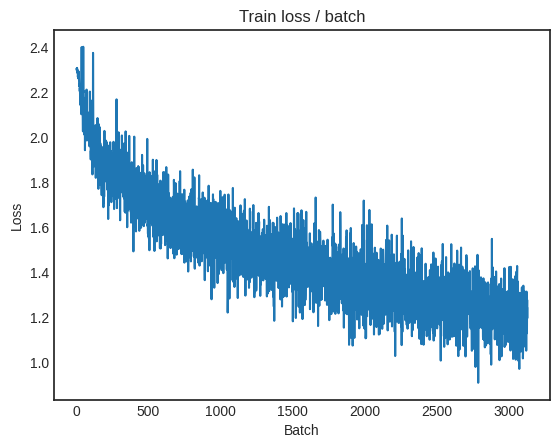

[TRAIN Batch 200/391]	Time 0.020s (0.098s)	Loss 1.1426 (1.1830)	Prec@1  63.3 ( 58.2)	Prec@5  96.1 ( 95.1)


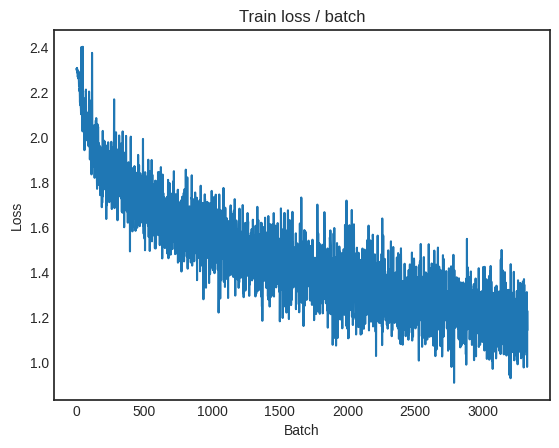


===============> Total time 36s	Avg loss 1.1735	Avg Prec@1 58.52 %	Avg Prec@5 95.15 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 1.1353 (1.1353)	Prec@1  64.8 ( 64.8)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.1599	Avg Prec@1 59.74 %	Avg Prec@5 95.47 %



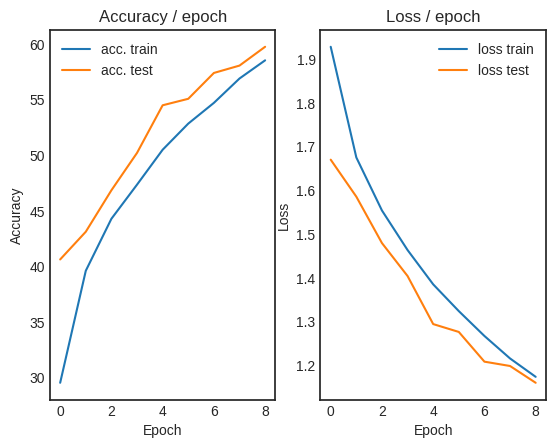

 45%|████▌     | 9/20 [06:05<07:21, 40.18s/it]

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.462s (0.462s)	Loss 1.0216 (1.0216)	Prec@1  64.8 ( 64.8)	Prec@5  95.3 ( 95.3)


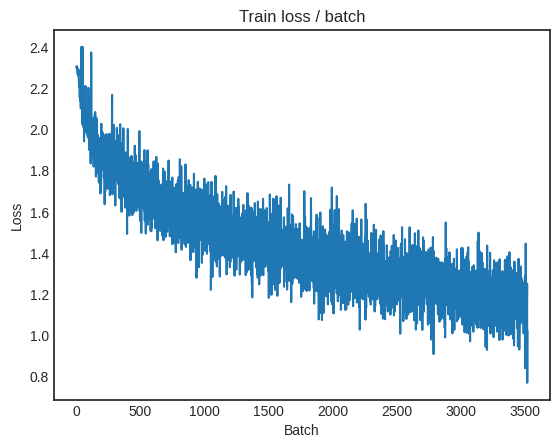

[TRAIN Batch 200/391]	Time 0.148s (0.098s)	Loss 1.2064 (1.1458)	Prec@1  58.6 ( 59.8)	Prec@5  95.3 ( 95.3)


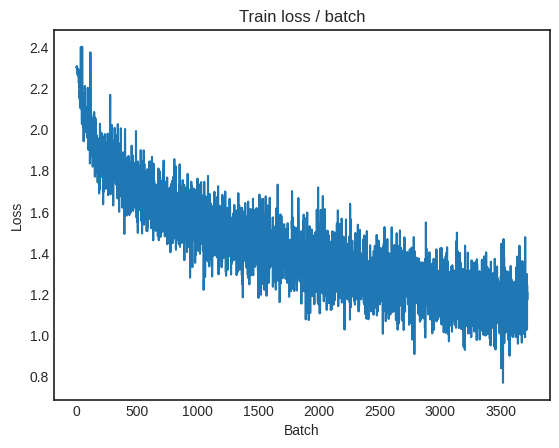


===============> Total time 36s	Avg loss 1.1403	Avg Prec@1 59.89 %	Avg Prec@5 95.43 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 1.2028 (1.2028)	Prec@1  58.6 ( 58.6)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 1.2379	Avg Prec@1 57.05 %	Avg Prec@5 94.50 %



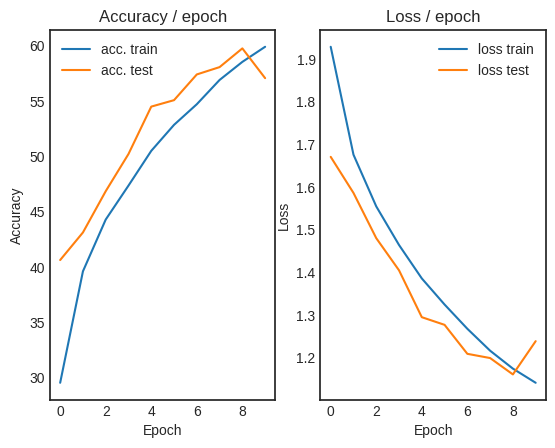

 50%|█████     | 10/20 [06:45<06:42, 40.29s/it]

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.339s (0.339s)	Loss 1.1943 (1.1943)	Prec@1  58.6 ( 58.6)	Prec@5  95.3 ( 95.3)


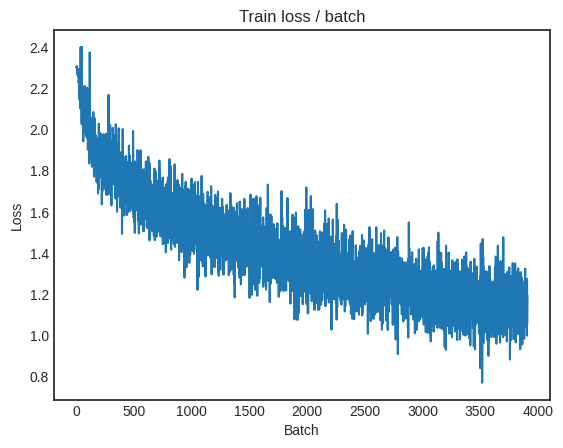

[TRAIN Batch 200/391]	Time 0.133s (0.093s)	Loss 0.9871 (1.1105)	Prec@1  64.1 ( 60.7)	Prec@5  98.4 ( 95.8)


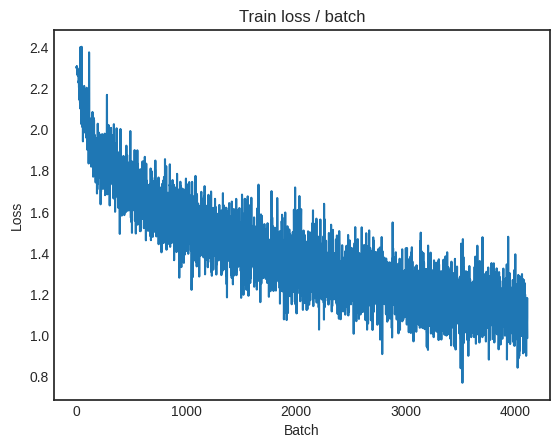


===============> Total time 36s	Avg loss 1.1079	Avg Prec@1 60.88 %	Avg Prec@5 95.67 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.9917 (0.9917)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 1.1245	Avg Prec@1 62.03 %	Avg Prec@5 95.75 %



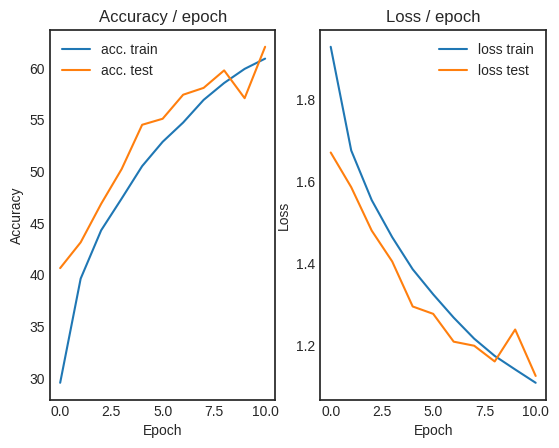

 55%|█████▌    | 11/20 [07:25<06:00, 40.08s/it]

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.293s (0.293s)	Loss 1.2148 (1.2148)	Prec@1  57.0 ( 57.0)	Prec@5  93.8 ( 93.8)


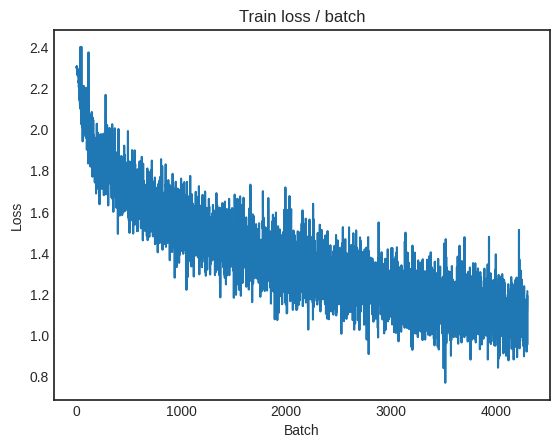

[TRAIN Batch 200/391]	Time 0.078s (0.092s)	Loss 1.1918 (1.0869)	Prec@1  57.8 ( 61.7)	Prec@5  96.9 ( 96.0)


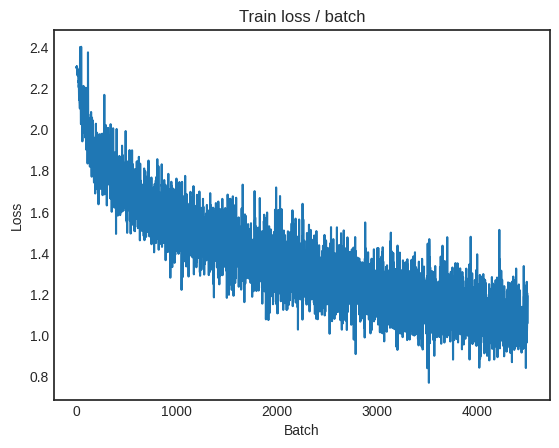


===============> Total time 36s	Avg loss 1.0799	Avg Prec@1 61.94 %	Avg Prec@5 95.89 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 1.0546 (1.0546)	Prec@1  68.0 ( 68.0)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.0393	Avg Prec@1 64.08 %	Avg Prec@5 96.36 %



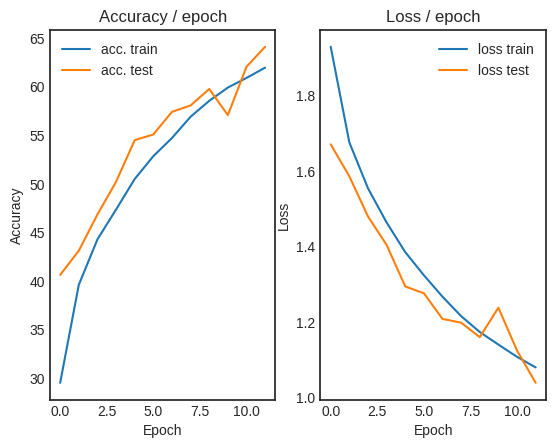

 60%|██████    | 12/20 [08:04<05:19, 39.92s/it]

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.286s (0.286s)	Loss 0.9850 (0.9850)	Prec@1  64.8 ( 64.8)	Prec@5  96.9 ( 96.9)


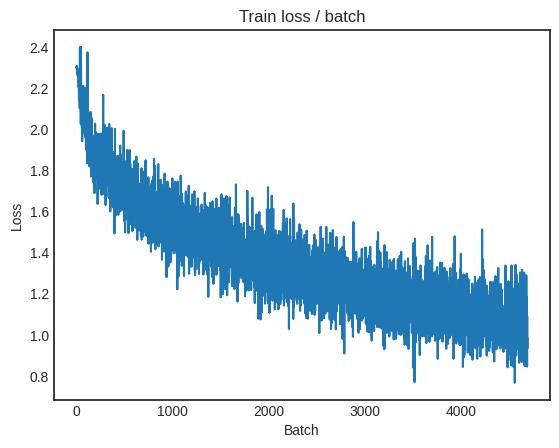

[TRAIN Batch 200/391]	Time 0.172s (0.092s)	Loss 1.1612 (1.0697)	Prec@1  58.6 ( 63.0)	Prec@5  95.3 ( 95.8)


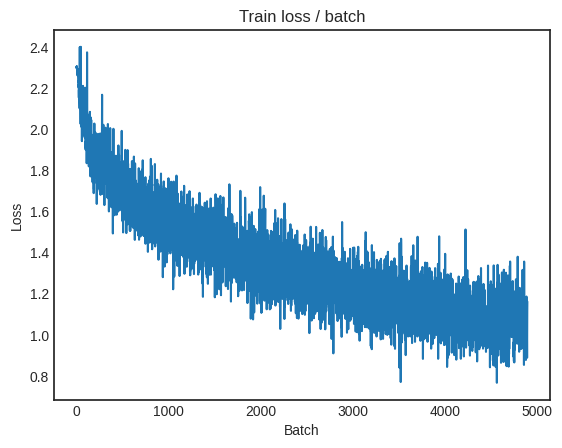


===============> Total time 36s	Avg loss 1.0587	Avg Prec@1 63.13 %	Avg Prec@5 95.99 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.9990 (0.9990)	Prec@1  69.5 ( 69.5)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.0629	Avg Prec@1 63.14 %	Avg Prec@5 96.01 %



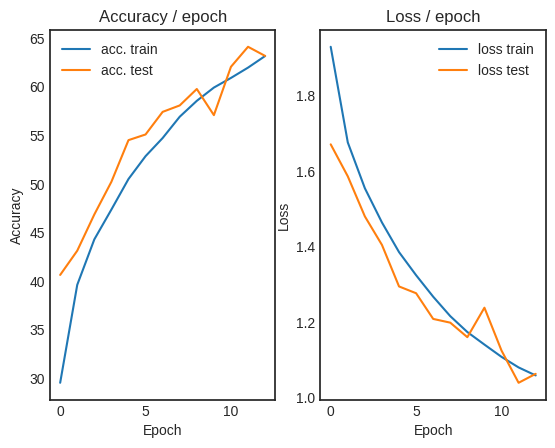

 65%|██████▌   | 13/20 [08:44<04:39, 39.96s/it]

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.296s (0.296s)	Loss 1.1420 (1.1420)	Prec@1  59.4 ( 59.4)	Prec@5  97.7 ( 97.7)


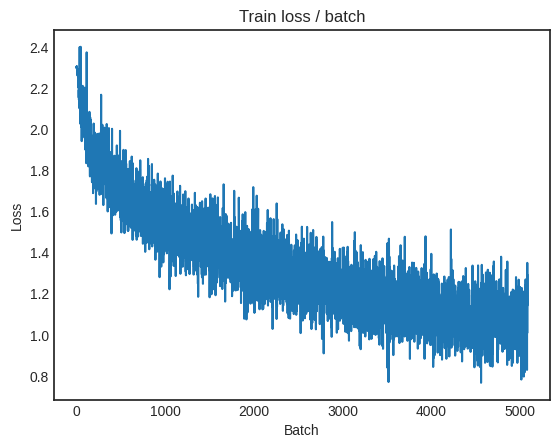

[TRAIN Batch 200/391]	Time 0.066s (0.100s)	Loss 1.2255 (1.0354)	Prec@1  52.3 ( 63.8)	Prec@5  94.5 ( 96.3)


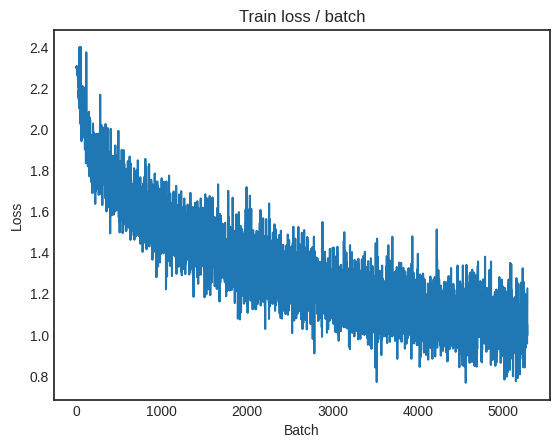


===============> Total time 38s	Avg loss 1.0282	Avg Prec@1 63.92 %	Avg Prec@5 96.35 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 0.9719 (0.9719)	Prec@1  69.5 ( 69.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9921	Avg Prec@1 65.80 %	Avg Prec@5 96.61 %



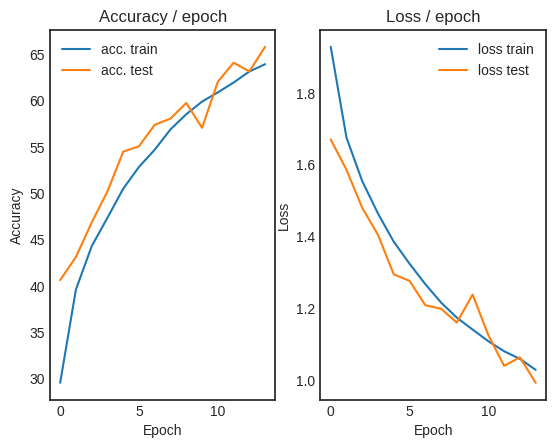

 70%|███████   | 14/20 [09:26<04:02, 40.38s/it]

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.323s (0.323s)	Loss 0.9167 (0.9167)	Prec@1  67.2 ( 67.2)	Prec@5  97.7 ( 97.7)


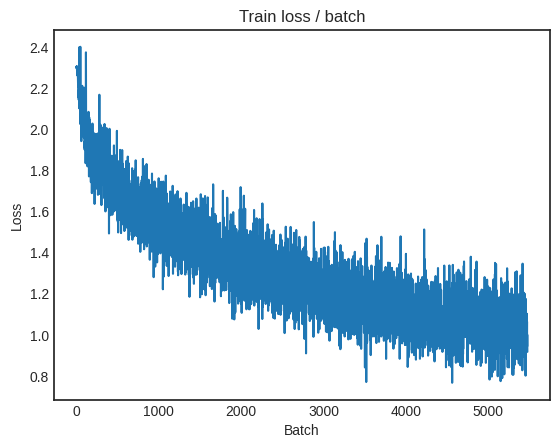

[TRAIN Batch 200/391]	Time 0.058s (0.113s)	Loss 1.0440 (1.0081)	Prec@1  69.5 ( 64.5)	Prec@5  95.3 ( 96.5)


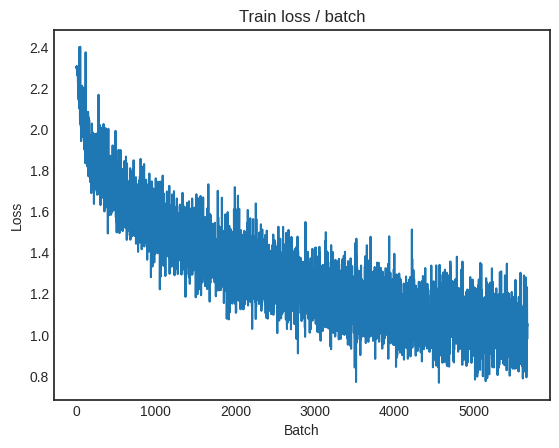


===============> Total time 40s	Avg loss 1.0080	Avg Prec@1 64.67 %	Avg Prec@5 96.47 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.9880 (0.9880)	Prec@1  67.2 ( 67.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.9809	Avg Prec@1 66.21 %	Avg Prec@5 97.01 %



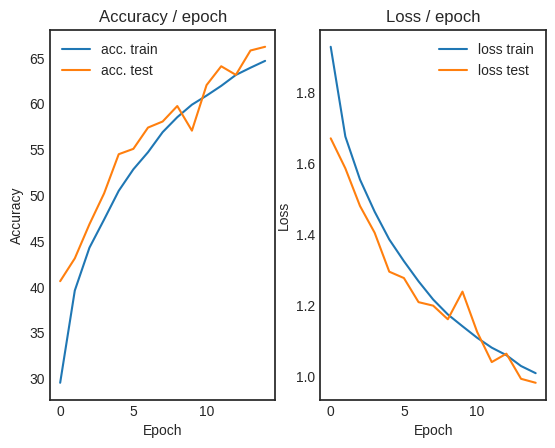

 75%|███████▌  | 15/20 [10:10<03:28, 41.60s/it]

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.329s (0.329s)	Loss 1.2339 (1.2339)	Prec@1  57.8 ( 57.8)	Prec@5  96.1 ( 96.1)


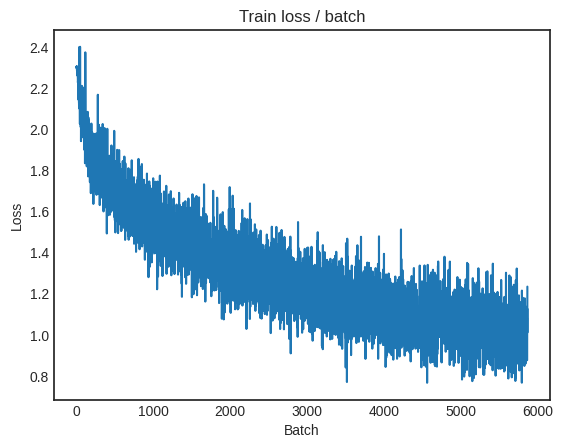

[TRAIN Batch 200/391]	Time 0.129s (0.094s)	Loss 0.9036 (0.9925)	Prec@1  70.3 ( 65.2)	Prec@5  96.9 ( 96.6)


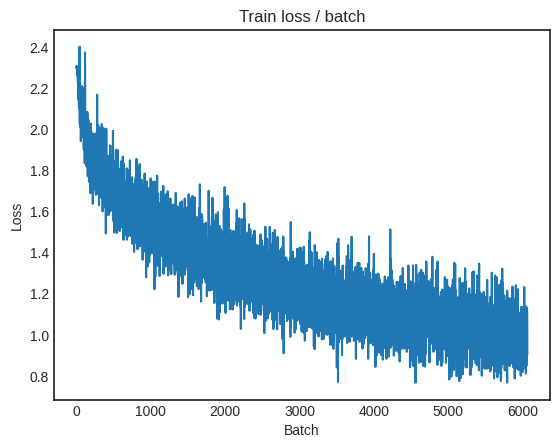


===============> Total time 37s	Avg loss 0.9931	Avg Prec@1 65.17 %	Avg Prec@5 96.58 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 0.9827 (0.9827)	Prec@1  70.3 ( 70.3)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.9839	Avg Prec@1 66.17 %	Avg Prec@5 96.45 %



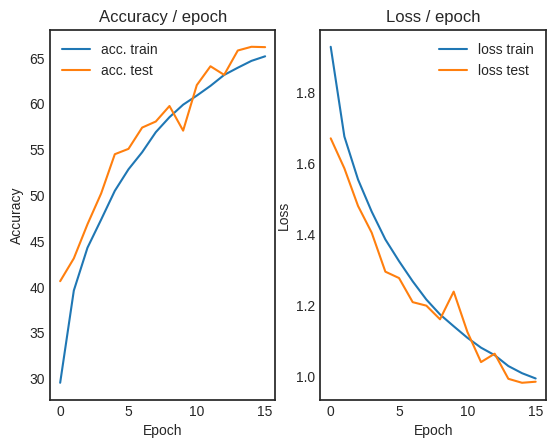

 80%|████████  | 16/20 [10:51<02:45, 41.30s/it]

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.314s (0.314s)	Loss 1.1512 (1.1512)	Prec@1  59.4 ( 59.4)	Prec@5  93.8 ( 93.8)


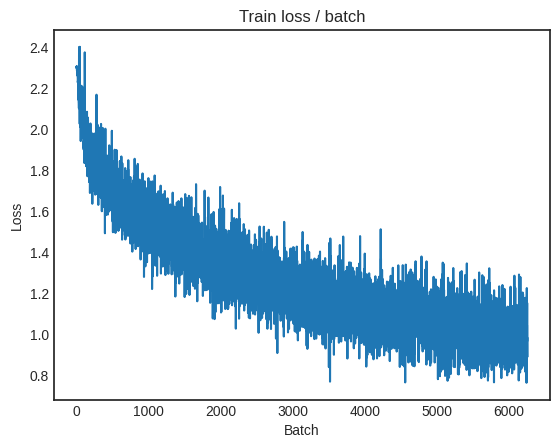

[TRAIN Batch 200/391]	Time 0.147s (0.092s)	Loss 1.0143 (0.9682)	Prec@1  66.4 ( 66.4)	Prec@5  96.1 ( 96.9)


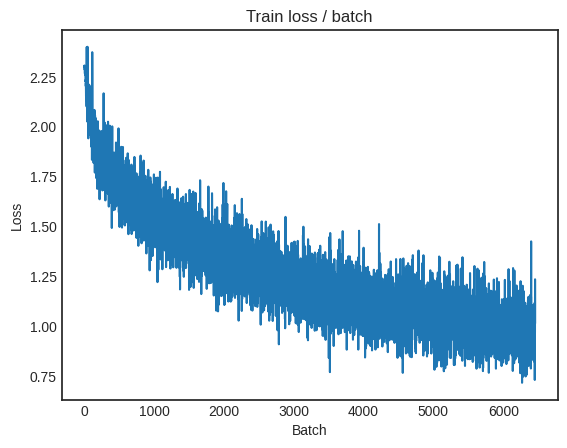


===============> Total time 36s	Avg loss 0.9694	Avg Prec@1 66.13 %	Avg Prec@5 96.79 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 1.0080 (1.0080)	Prec@1  64.8 ( 64.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9782	Avg Prec@1 66.59 %	Avg Prec@5 96.52 %



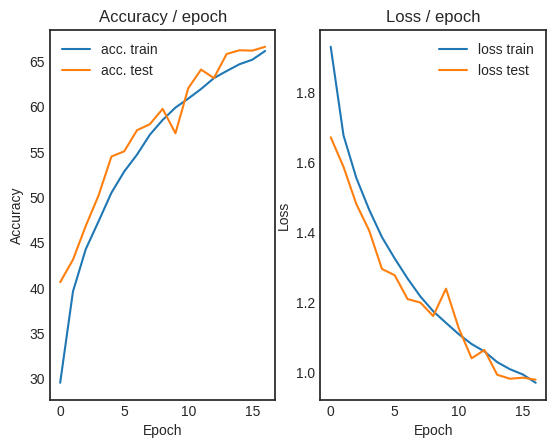

 85%|████████▌ | 17/20 [11:31<02:02, 40.86s/it]

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.343s (0.343s)	Loss 1.0163 (1.0163)	Prec@1  65.6 ( 65.6)	Prec@5  96.9 ( 96.9)


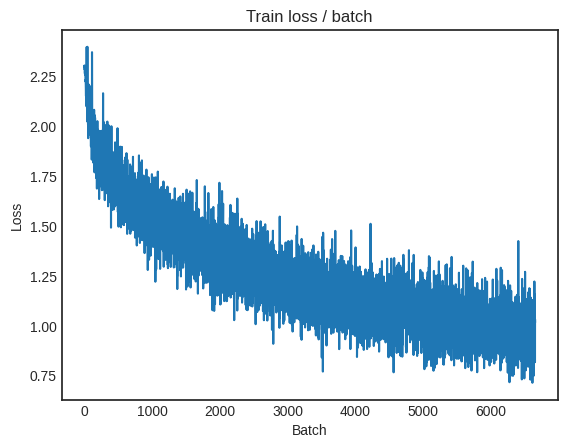

[TRAIN Batch 200/391]	Time 0.296s (0.096s)	Loss 0.8522 (0.9539)	Prec@1  68.8 ( 66.4)	Prec@5  96.1 ( 96.9)


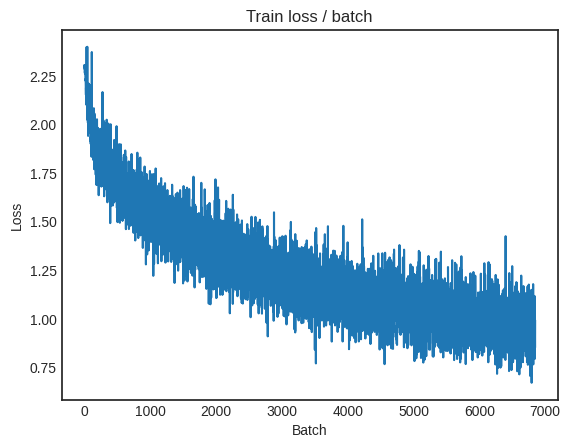


===============> Total time 37s	Avg loss 0.9543	Avg Prec@1 66.50 %	Avg Prec@5 96.86 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 1.0101 (1.0101)	Prec@1  68.0 ( 68.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9747	Avg Prec@1 66.71 %	Avg Prec@5 96.48 %



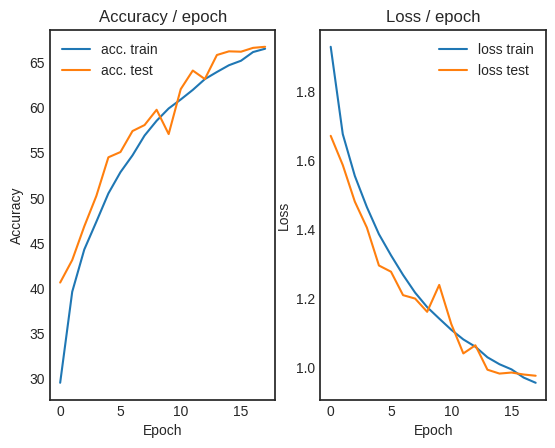

 90%|█████████ | 18/20 [12:11<01:21, 40.59s/it]

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.315s (0.315s)	Loss 1.0132 (1.0132)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)


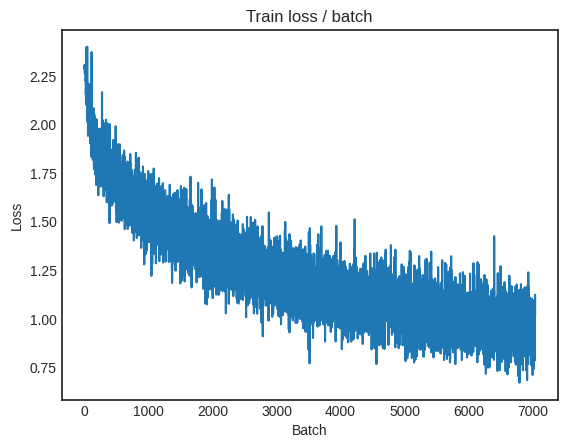

[TRAIN Batch 200/391]	Time 0.014s (0.098s)	Loss 1.0493 (0.9364)	Prec@1  64.1 ( 67.7)	Prec@5  97.7 ( 97.0)


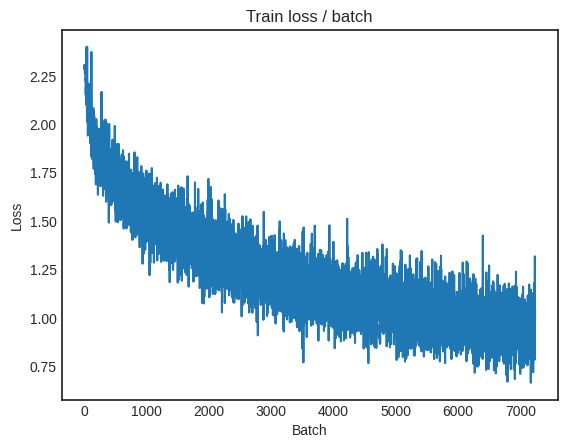


===============> Total time 36s	Avg loss 0.9416	Avg Prec@1 67.15 %	Avg Prec@5 97.02 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 1.0218 (1.0218)	Prec@1  65.6 ( 65.6)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.9753	Avg Prec@1 66.32 %	Avg Prec@5 96.88 %



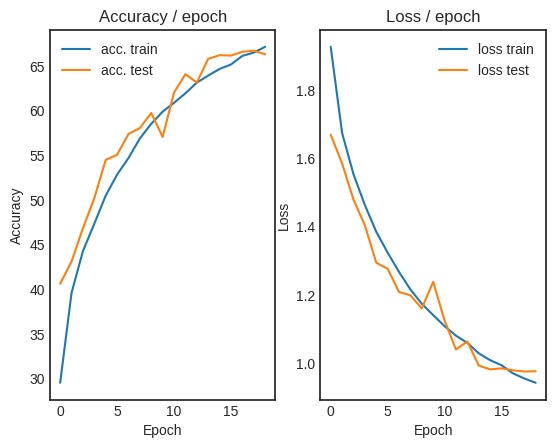

 95%|█████████▌| 19/20 [12:50<00:40, 40.35s/it]

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.346s (0.346s)	Loss 0.9030 (0.9030)	Prec@1  64.8 ( 64.8)	Prec@5  98.4 ( 98.4)


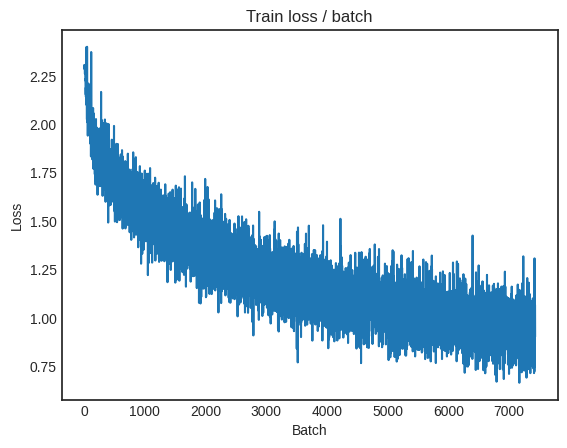

[TRAIN Batch 200/391]	Time 0.159s (0.098s)	Loss 0.7413 (0.9271)	Prec@1  74.2 ( 67.9)	Prec@5  98.4 ( 97.2)


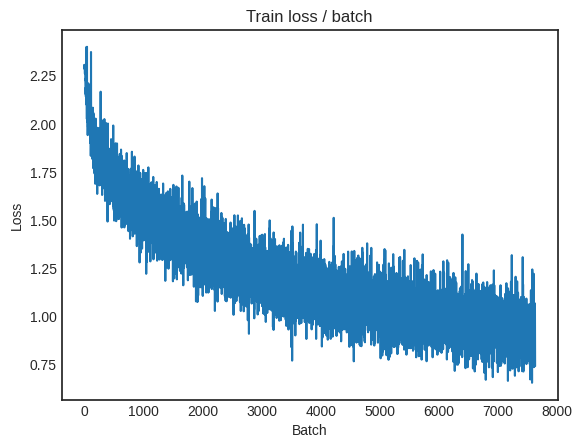


===============> Total time 36s	Avg loss 0.9301	Avg Prec@1 67.66 %	Avg Prec@5 97.12 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 1.0012 (1.0012)	Prec@1  67.2 ( 67.2)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.9492	Avg Prec@1 67.91 %	Avg Prec@5 96.88 %



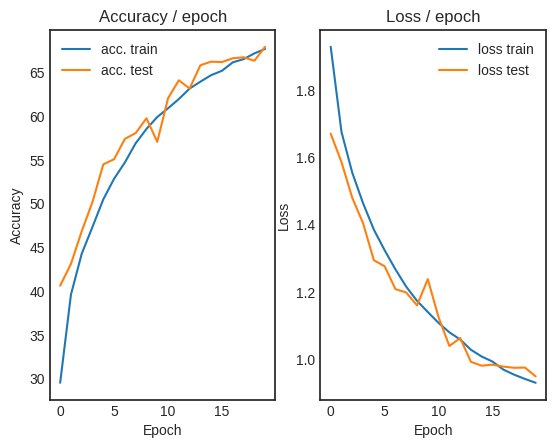

100%|██████████| 20/20 [13:30<00:00, 40.55s/it]


In [45]:
PRINT_INTERVAL = 200
PATH="datasets"

from tqdm import tqdm
import matplotlib as mpl


"""## 3.2 Increase in the number of training examples by data increase

### Modify network architecture
"""

# Transformation functions
def add_noise(image, noise_level=0.1):
    noise = torch.randn_like(torch.Tensor(image)) * noise_level
    noisy_image = image + noise
    return noisy_image


class ConvNet2(nn.Module):

    def __init__(self, channels = 3):
        super(ConvNet2, self).__init__()

        self.channels = channels # to handle color images
        self.conv1 = 32
        self.conv2 = 64
        self.conv3 = 64
        self.fc4 = 1000
        self.fc5 = 10

        # conv net as feature extractor
        self.features = nn.Sequential(

            nn.Conv2d(self.channels, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),

            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),

            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode = True),
        )

        self.classifier = nn.Sequential(
            nn.Linear(64 * 4 * 4, self.fc4),
            nn.ReLU(),
            nn.Linear(self.fc4, self.fc5),

            # Reminder: The softmax is included in the loss, do not put it here
            # nn.Softmax()
        )


    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers


        return output

"""### Modify call to datas for more data augmentations"""

# adapting the dataset function to CIFAR10

def get_dataset_CIFAR(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """

    # image mean and std for CIFAR10
    mean_CIFAR = (0.491, 0.482, 0.447)
    sig_CIFAR = (0.202, 0.199, 0.201)


    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.RandomCrop(size = 28),
            transforms.RandomHorizontalFlip(p=0.5),
            # transforms.ColorJitter(brightness=(0.1,0.6), contrast=1,saturation=0, hue=0.4)
            transforms.RandomRotation(degrees=66),
            transforms.Normalize(mean=mean_CIFAR, std=sig_CIFAR),
        ]))


    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=mean_CIFAR, std=sig_CIFAR)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

"""### New main function"""

def main_CIFAR_standardized(batch_size, lr, epochs, cuda):

    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet2()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset_CIFAR(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in tqdm(range(epochs)):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

main_CIFAR_standardized(batch_size = 128, lr=0.1, epochs = 20, cuda = True)

## 3.3 Variants of the optimization algorithm

In [46]:
# Import the package
from torch.optim import lr_scheduler

In [47]:
def main_CIFAR_3_3(batch_size=128, lr=0.1, epochs=50, cuda=False):

    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet2()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)
    lr_sched = lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset_CIFAR(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in tqdm(range(epochs)):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

        lr_sched.step()

Files already downloaded and verified
Files already downloaded and verified


  0%|          | 0/50 [00:00<?, ?it/s]

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.316s (0.316s)	Loss 2.3093 (2.3093)	Prec@1   8.6 (  8.6)	Prec@5  46.9 ( 46.9)


<Figure size 640x480 with 0 Axes>

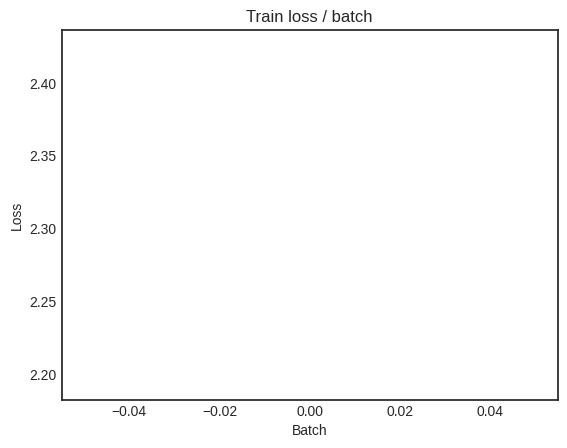

[TRAIN Batch 200/391]	Time 0.015s (0.091s)	Loss 1.9006 (2.0262)	Prec@1  30.5 ( 25.1)	Prec@5  82.8 ( 76.3)


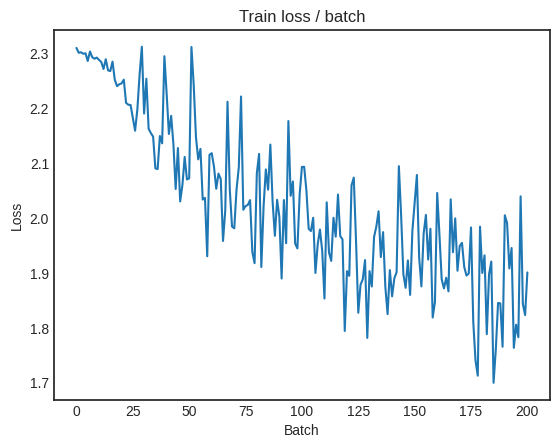


===============> Total time 35s	Avg loss 1.9190	Avg Prec@1 29.81 %	Avg Prec@5 80.60 %

[EVAL Batch 000/079]	Time 0.217s (0.217s)	Loss 1.6113 (1.6113)	Prec@1  42.2 ( 42.2)	Prec@5  90.6 ( 90.6)

===============> Total time 3s	Avg loss 1.6571	Avg Prec@1 41.30 %	Avg Prec@5 88.32 %



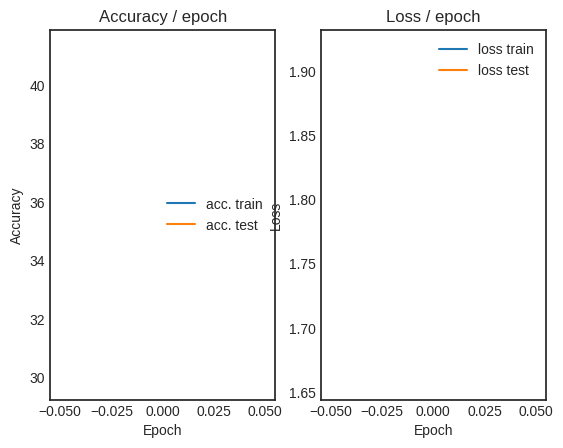

  2%|▏         | 1/50 [00:39<32:12, 39.44s/it]

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.273s (0.273s)	Loss 1.7367 (1.7367)	Prec@1  39.1 ( 39.1)	Prec@5  87.5 ( 87.5)


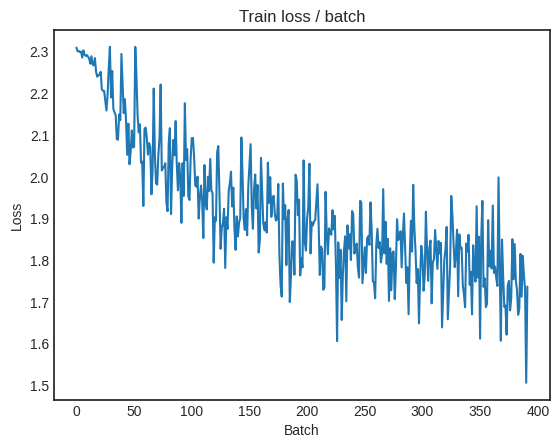

[TRAIN Batch 200/391]	Time 0.012s (0.091s)	Loss 1.5704 (1.6919)	Prec@1  43.0 ( 39.3)	Prec@5  91.4 ( 87.8)


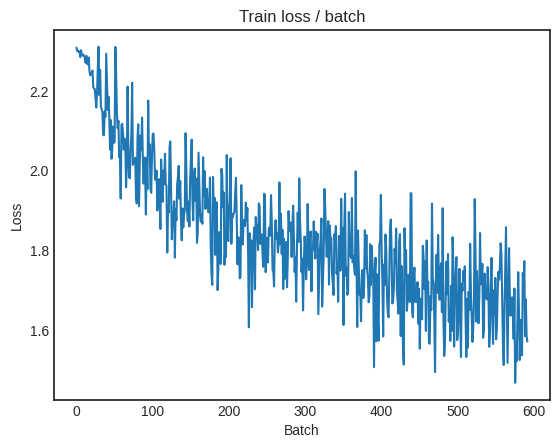


===============> Total time 36s	Avg loss 1.6627	Avg Prec@1 40.05 %	Avg Prec@5 88.44 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 1.4708 (1.4708)	Prec@1  47.7 ( 47.7)	Prec@5  88.3 ( 88.3)

===============> Total time 2s	Avg loss 1.5354	Avg Prec@1 44.19 %	Avg Prec@5 91.39 %



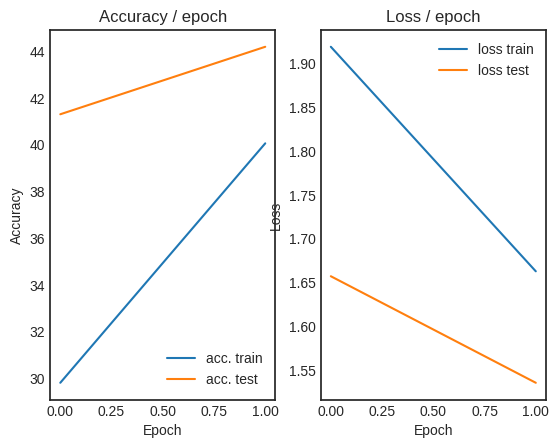

  4%|▍         | 2/50 [01:19<31:36, 39.51s/it]

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.263s (0.263s)	Loss 1.7412 (1.7412)	Prec@1  35.2 ( 35.2)	Prec@5  87.5 ( 87.5)


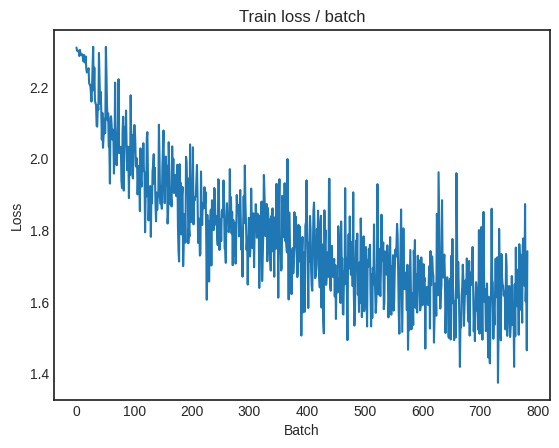

[TRAIN Batch 200/391]	Time 0.068s (0.091s)	Loss 1.4337 (1.5534)	Prec@1  46.1 ( 44.0)	Prec@5  92.2 ( 90.5)


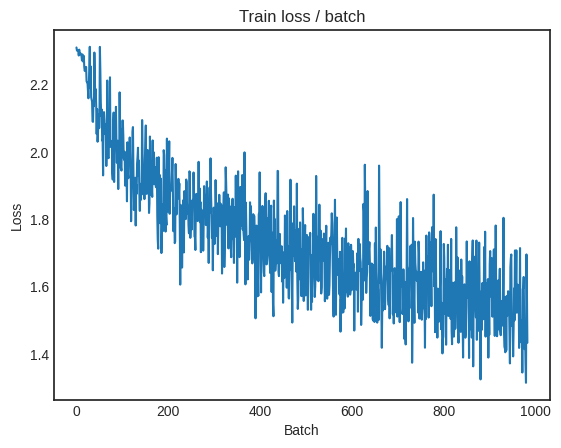


===============> Total time 37s	Avg loss 1.5386	Avg Prec@1 44.46 %	Avg Prec@5 90.67 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 1.3670 (1.3670)	Prec@1  54.7 ( 54.7)	Prec@5  93.0 ( 93.0)

===============> Total time 2s	Avg loss 1.4308	Avg Prec@1 49.64 %	Avg Prec@5 92.83 %



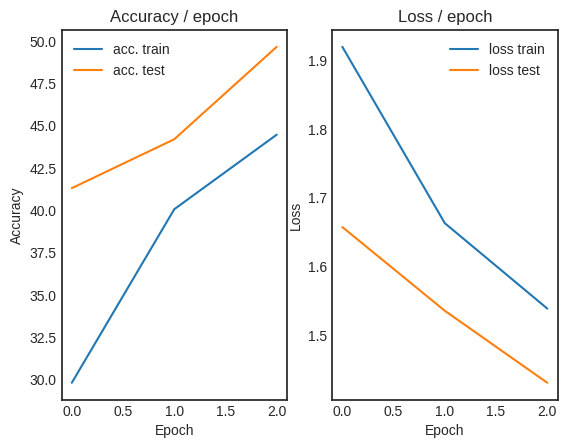

  6%|▌         | 3/50 [01:58<31:07, 39.73s/it]

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.279s (0.279s)	Loss 1.5055 (1.5055)	Prec@1  43.0 ( 43.0)	Prec@5  91.4 ( 91.4)


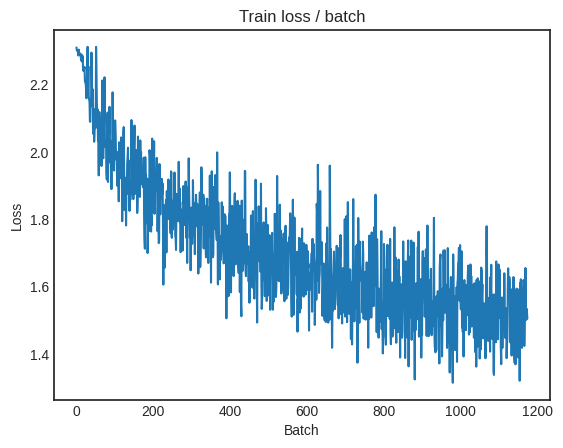

[TRAIN Batch 200/391]	Time 0.014s (0.106s)	Loss 1.3336 (1.4559)	Prec@1  55.5 ( 47.9)	Prec@5  89.8 ( 91.8)


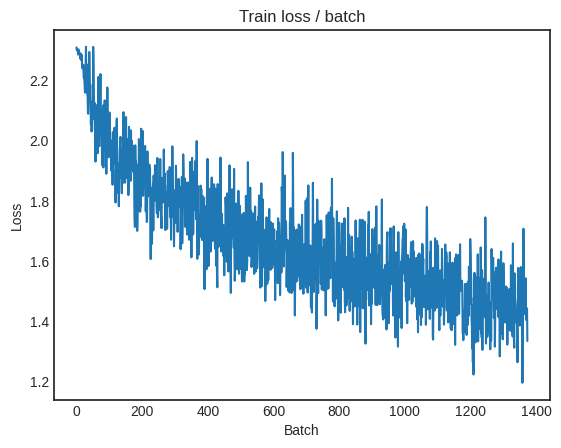


===============> Total time 38s	Avg loss 1.4438	Avg Prec@1 48.35 %	Avg Prec@5 92.00 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 1.2837 (1.2837)	Prec@1  57.8 ( 57.8)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.3458	Avg Prec@1 52.60 %	Avg Prec@5 93.12 %



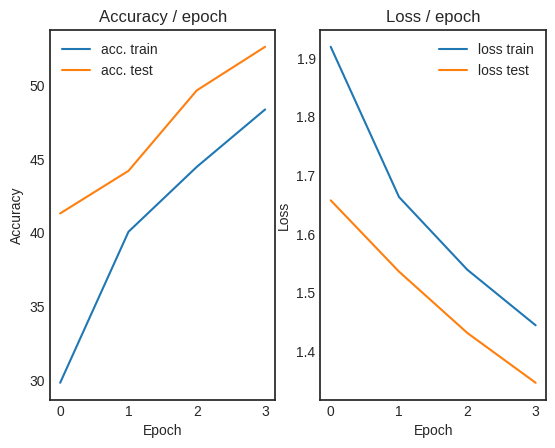

  8%|▊         | 4/50 [02:40<30:57, 40.39s/it]

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.306s (0.306s)	Loss 1.5042 (1.5042)	Prec@1  42.2 ( 42.2)	Prec@5  92.2 ( 92.2)


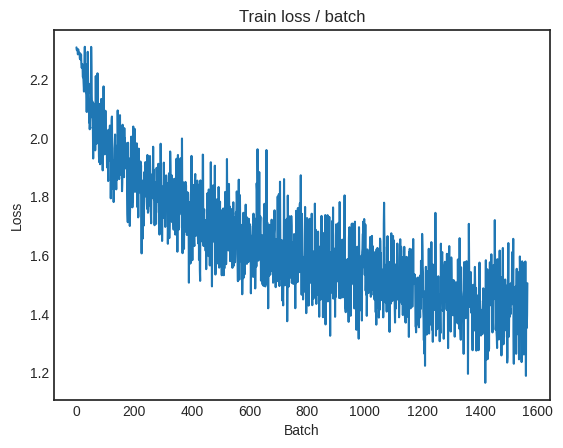

[TRAIN Batch 200/391]	Time 0.165s (0.099s)	Loss 1.4489 (1.3857)	Prec@1  49.2 ( 50.8)	Prec@5  93.8 ( 92.9)


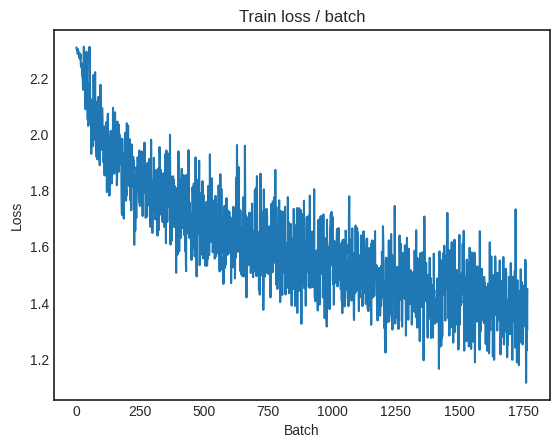


===============> Total time 37s	Avg loss 1.3692	Avg Prec@1 51.19 %	Avg Prec@5 93.08 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 1.2146 (1.2146)	Prec@1  60.2 ( 60.2)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.2928	Avg Prec@1 54.78 %	Avg Prec@5 94.12 %



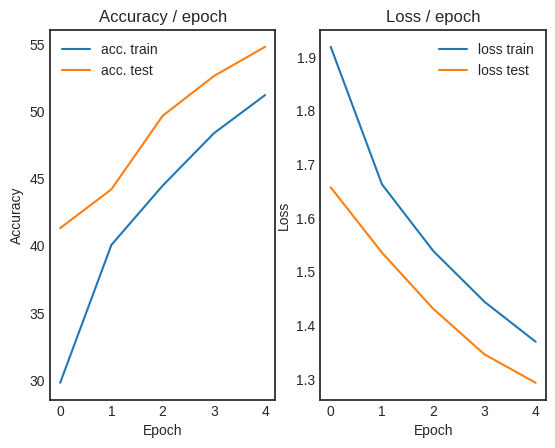

 10%|█         | 5/50 [03:21<30:25, 40.56s/it]

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.431s (0.431s)	Loss 1.3439 (1.3439)	Prec@1  50.8 ( 50.8)	Prec@5  93.0 ( 93.0)


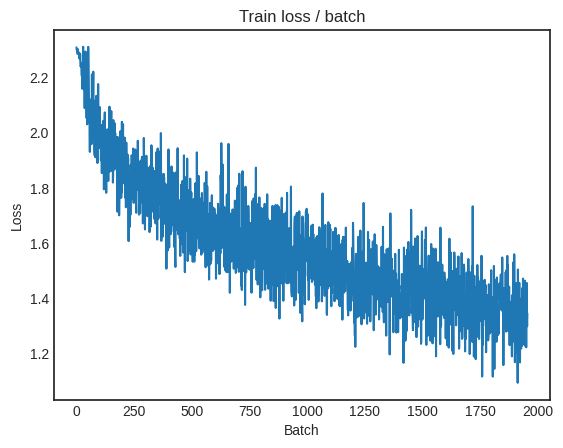

[TRAIN Batch 200/391]	Time 0.157s (0.093s)	Loss 1.1348 (1.3047)	Prec@1  63.3 ( 53.3)	Prec@5  96.9 ( 93.9)


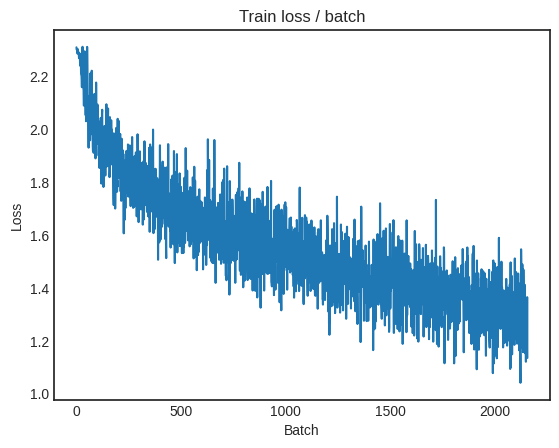


===============> Total time 36s	Avg loss 1.2953	Avg Prec@1 53.76 %	Avg Prec@5 93.90 %

[EVAL Batch 000/079]	Time 0.302s (0.302s)	Loss 1.2768 (1.2768)	Prec@1  58.6 ( 58.6)	Prec@5  94.5 ( 94.5)

===============> Total time 3s	Avg loss 1.2858	Avg Prec@1 55.10 %	Avg Prec@5 94.22 %



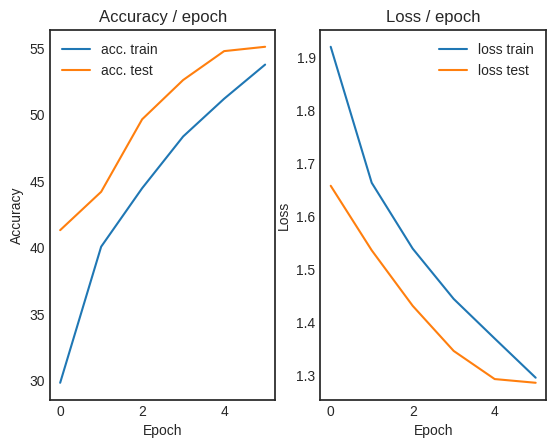

 12%|█▏        | 6/50 [04:01<29:36, 40.38s/it]

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.292s (0.292s)	Loss 1.3074 (1.3074)	Prec@1  53.9 ( 53.9)	Prec@5  94.5 ( 94.5)


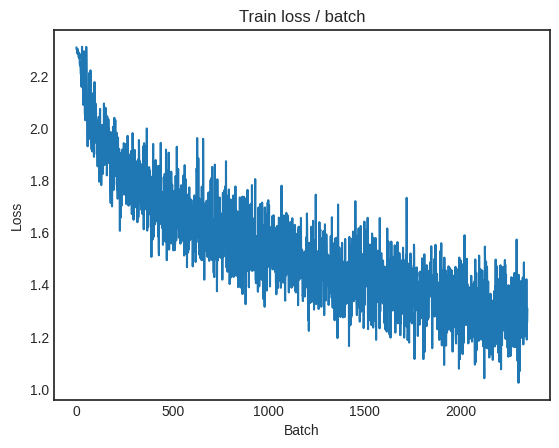

[TRAIN Batch 200/391]	Time 0.008s (0.094s)	Loss 1.1470 (1.2470)	Prec@1  57.0 ( 56.0)	Prec@5  93.8 ( 94.2)


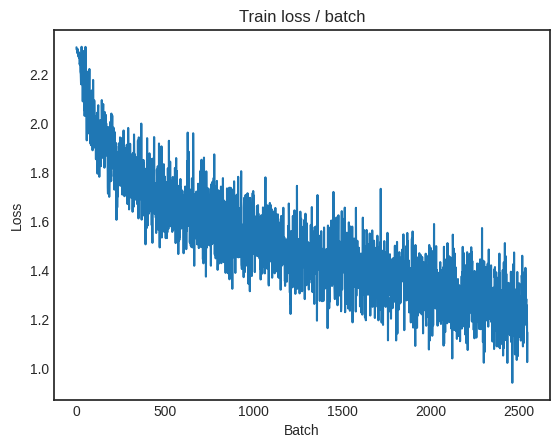


===============> Total time 37s	Avg loss 1.2440	Avg Prec@1 55.85 %	Avg Prec@5 94.36 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 1.1302 (1.1302)	Prec@1  62.5 ( 62.5)	Prec@5  93.8 ( 93.8)

===============> Total time 2s	Avg loss 1.2127	Avg Prec@1 56.81 %	Avg Prec@5 95.55 %



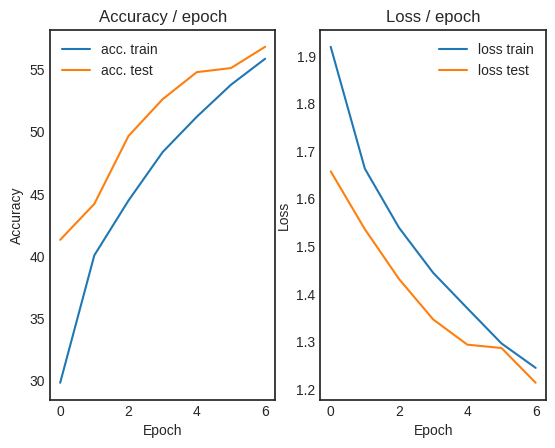

 14%|█▍        | 7/50 [04:41<28:59, 40.45s/it]

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.294s (0.294s)	Loss 1.1321 (1.1321)	Prec@1  60.9 ( 60.9)	Prec@5  96.9 ( 96.9)


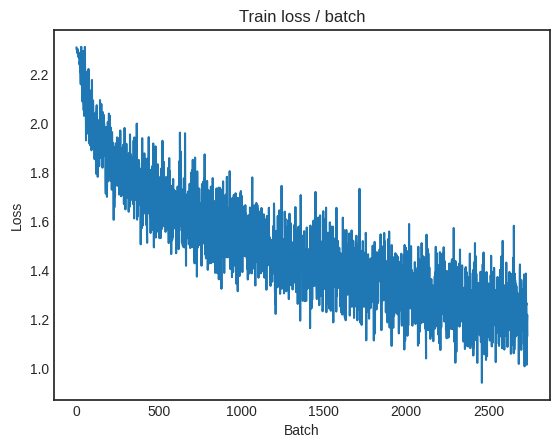

[TRAIN Batch 200/391]	Time 0.065s (0.094s)	Loss 1.2582 (1.2027)	Prec@1  53.1 ( 57.6)	Prec@5  95.3 ( 94.8)


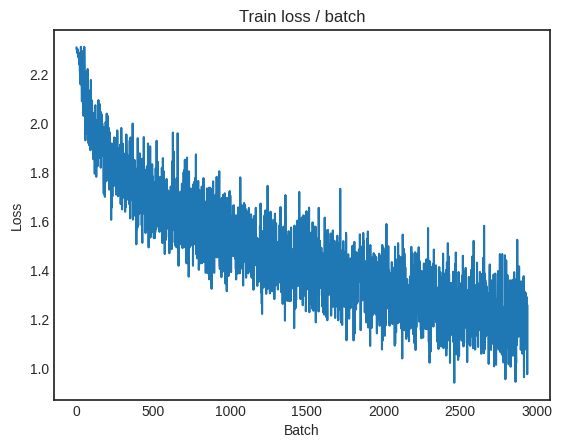


===============> Total time 37s	Avg loss 1.1999	Avg Prec@1 57.41 %	Avg Prec@5 94.86 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 1.1373 (1.1373)	Prec@1  64.1 ( 64.1)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.1535	Avg Prec@1 59.29 %	Avg Prec@5 95.36 %



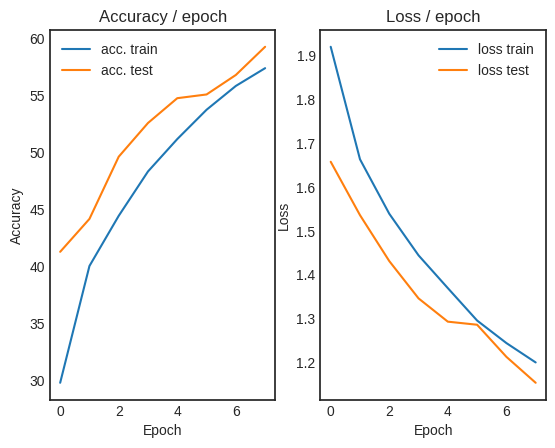

 16%|█▌        | 8/50 [05:22<28:24, 40.58s/it]

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.296s (0.296s)	Loss 1.0658 (1.0658)	Prec@1  64.8 ( 64.8)	Prec@5  94.5 ( 94.5)


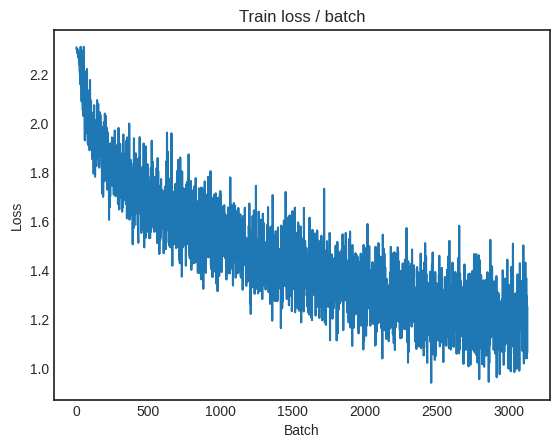

[TRAIN Batch 200/391]	Time 0.162s (0.098s)	Loss 1.1862 (1.1574)	Prec@1  60.9 ( 59.2)	Prec@5  90.6 ( 95.4)


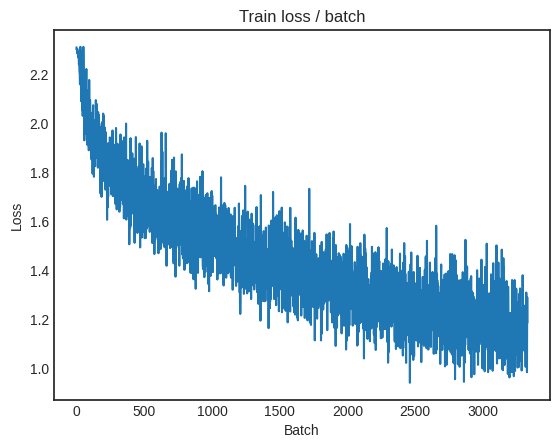


===============> Total time 37s	Avg loss 1.1532	Avg Prec@1 59.42 %	Avg Prec@5 95.39 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 1.1800 (1.1800)	Prec@1  58.6 ( 58.6)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.1446	Avg Prec@1 59.21 %	Avg Prec@5 95.83 %



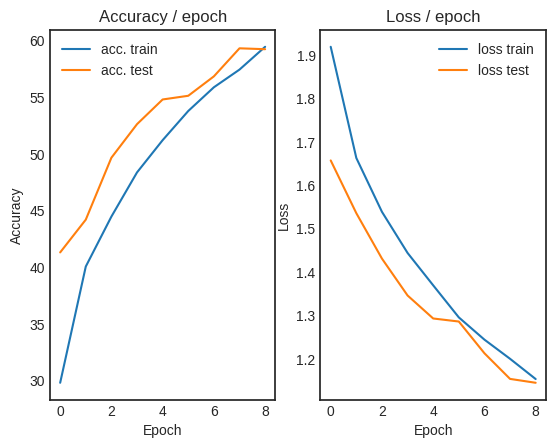

 18%|█▊        | 9/50 [06:02<27:34, 40.36s/it]

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.313s (0.313s)	Loss 1.1913 (1.1913)	Prec@1  59.4 ( 59.4)	Prec@5  94.5 ( 94.5)


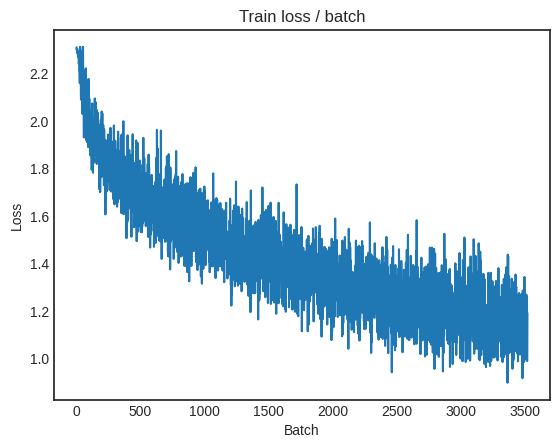

[TRAIN Batch 200/391]	Time 0.156s (0.099s)	Loss 1.1093 (1.1318)	Prec@1  60.2 ( 60.5)	Prec@5  96.9 ( 95.6)


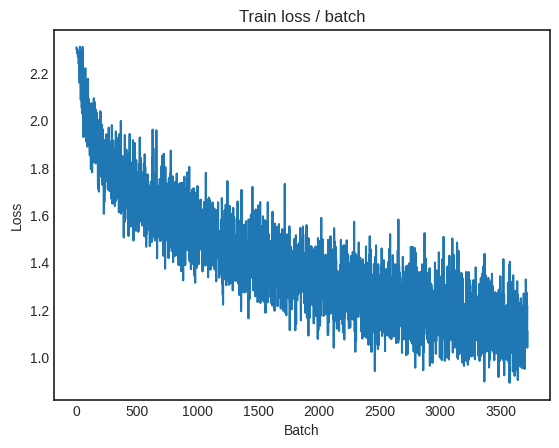


===============> Total time 37s	Avg loss 1.1173	Avg Prec@1 60.83 %	Avg Prec@5 95.64 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 1.1010 (1.1010)	Prec@1  63.3 ( 63.3)	Prec@5  92.2 ( 92.2)

===============> Total time 2s	Avg loss 1.1339	Avg Prec@1 60.39 %	Avg Prec@5 95.90 %



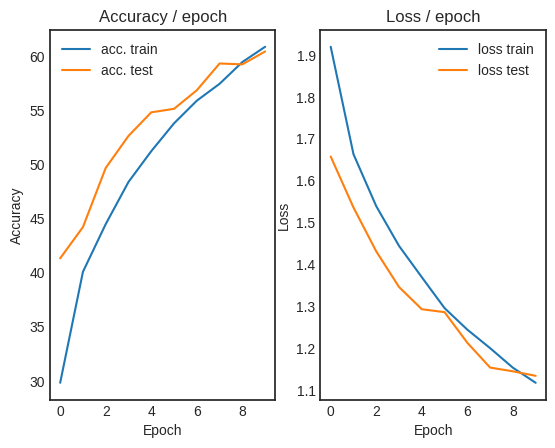

 20%|██        | 10/50 [06:42<26:51, 40.29s/it]

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.470s (0.470s)	Loss 1.1905 (1.1905)	Prec@1  58.6 ( 58.6)	Prec@5  95.3 ( 95.3)


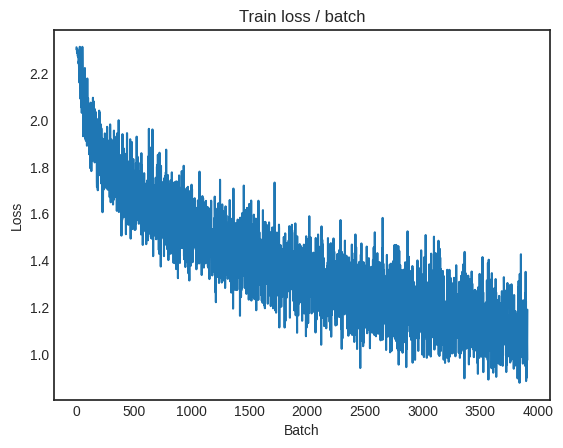

[TRAIN Batch 200/391]	Time 0.008s (0.097s)	Loss 1.1202 (1.0895)	Prec@1  60.9 ( 61.4)	Prec@5  94.5 ( 95.9)


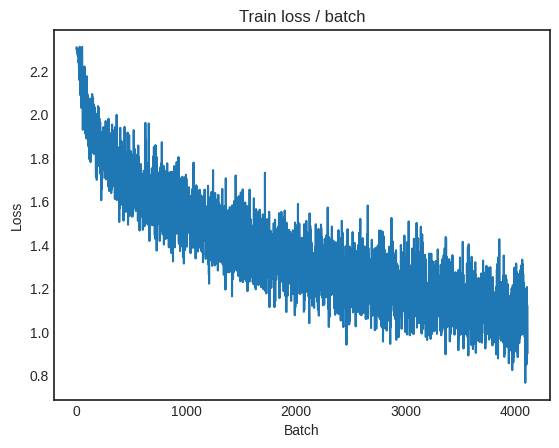


===============> Total time 36s	Avg loss 1.0862	Avg Prec@1 61.69 %	Avg Prec@5 95.89 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 1.0882 (1.0882)	Prec@1  64.1 ( 64.1)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 1.0832	Avg Prec@1 62.73 %	Avg Prec@5 96.22 %



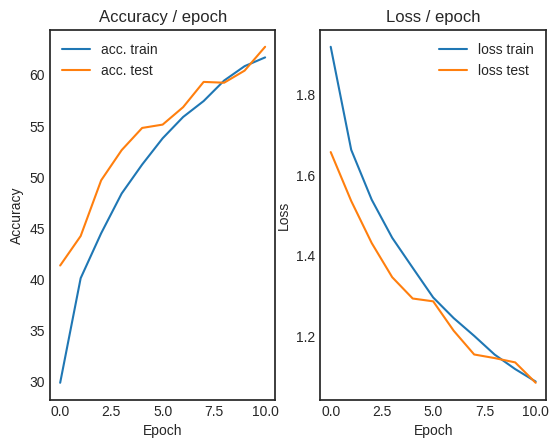

 22%|██▏       | 11/50 [07:23<26:17, 40.45s/it]

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.318s (0.318s)	Loss 1.0813 (1.0813)	Prec@1  57.8 ( 57.8)	Prec@5  96.1 ( 96.1)


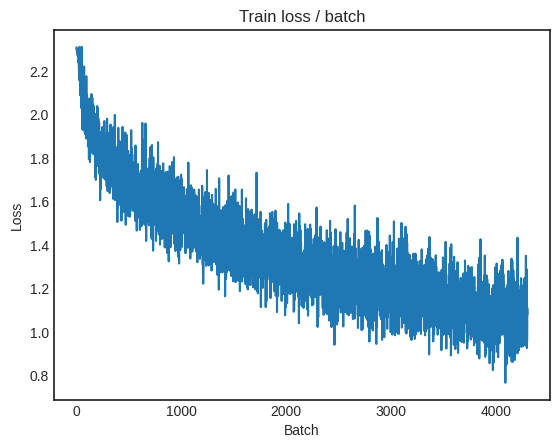

[TRAIN Batch 200/391]	Time 0.161s (0.091s)	Loss 1.0419 (1.0575)	Prec@1  65.6 ( 62.9)	Prec@5  97.7 ( 96.0)


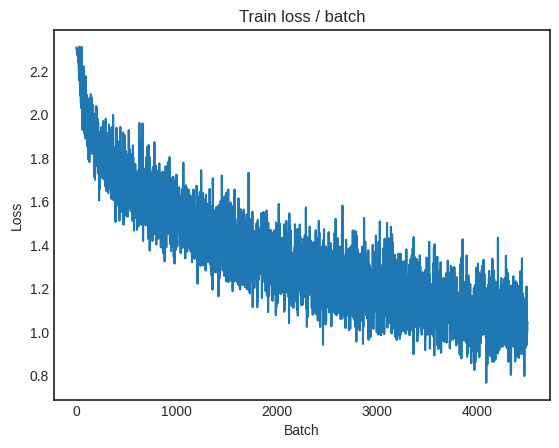


===============> Total time 36s	Avg loss 1.0615	Avg Prec@1 62.83 %	Avg Prec@5 96.01 %

[EVAL Batch 000/079]	Time 0.275s (0.275s)	Loss 1.0007 (1.0007)	Prec@1  70.3 ( 70.3)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.0409	Avg Prec@1 63.87 %	Avg Prec@5 96.51 %



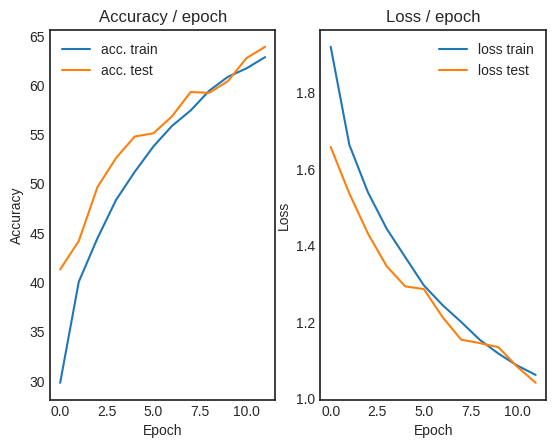

 24%|██▍       | 12/50 [08:03<25:28, 40.22s/it]

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.294s (0.294s)	Loss 1.0029 (1.0029)	Prec@1  61.7 ( 61.7)	Prec@5  96.1 ( 96.1)


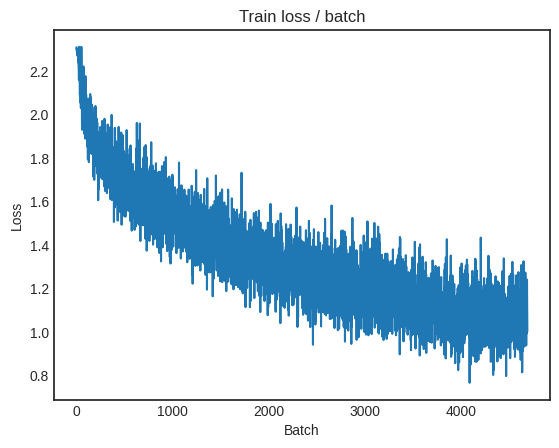

[TRAIN Batch 200/391]	Time 0.051s (0.103s)	Loss 0.9178 (1.0321)	Prec@1  67.2 ( 63.5)	Prec@5  98.4 ( 96.2)


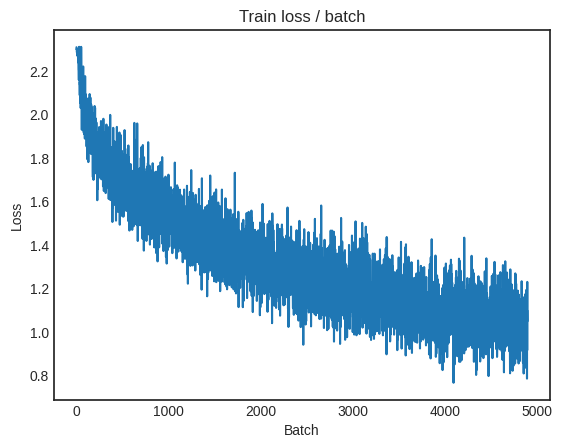


===============> Total time 39s	Avg loss 1.0334	Avg Prec@1 63.51 %	Avg Prec@5 96.20 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 1.0566 (1.0566)	Prec@1  64.8 ( 64.8)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.0376	Avg Prec@1 63.82 %	Avg Prec@5 96.58 %



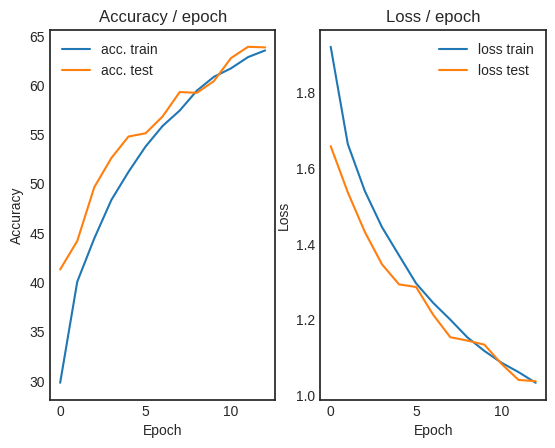

 26%|██▌       | 13/50 [08:45<25:09, 40.79s/it]

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.335s (0.335s)	Loss 0.9135 (0.9135)	Prec@1  69.5 ( 69.5)	Prec@5  97.7 ( 97.7)


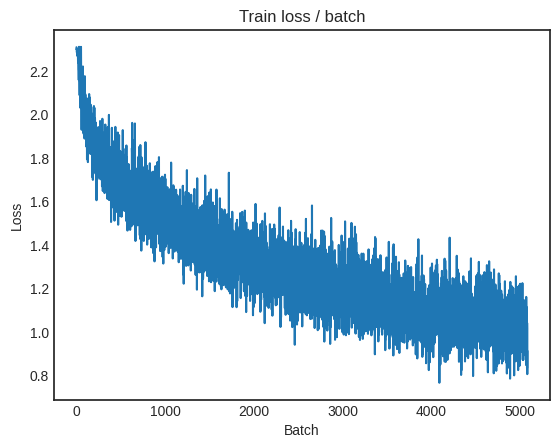

[TRAIN Batch 200/391]	Time 0.165s (0.101s)	Loss 0.9869 (0.9944)	Prec@1  67.2 ( 64.9)	Prec@5  96.9 ( 96.7)


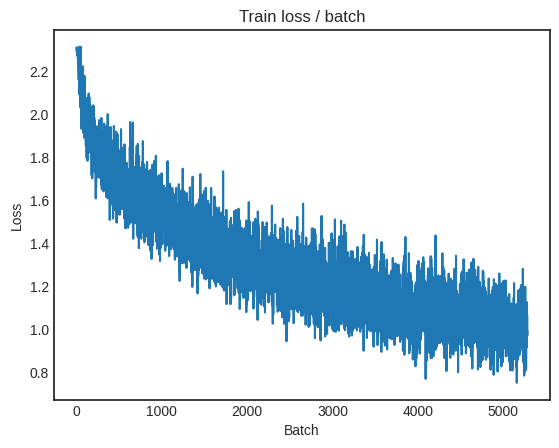


===============> Total time 38s	Avg loss 1.0010	Avg Prec@1 64.83 %	Avg Prec@5 96.59 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 1.0563 (1.0563)	Prec@1  66.4 ( 66.4)	Prec@5  93.8 ( 93.8)

===============> Total time 2s	Avg loss 1.0430	Avg Prec@1 64.45 %	Avg Prec@5 96.18 %



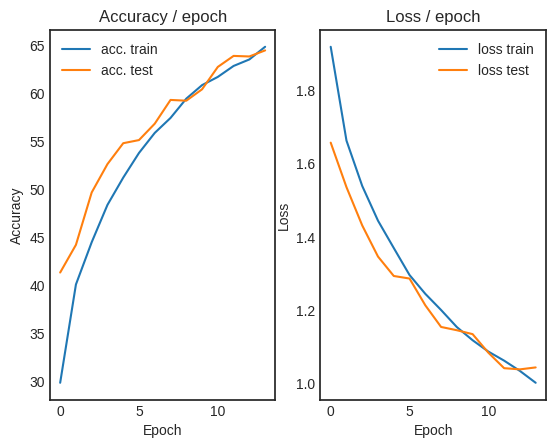

 28%|██▊       | 14/50 [09:26<24:30, 40.86s/it]

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.324s (0.324s)	Loss 0.9263 (0.9263)	Prec@1  67.2 ( 67.2)	Prec@5  97.7 ( 97.7)


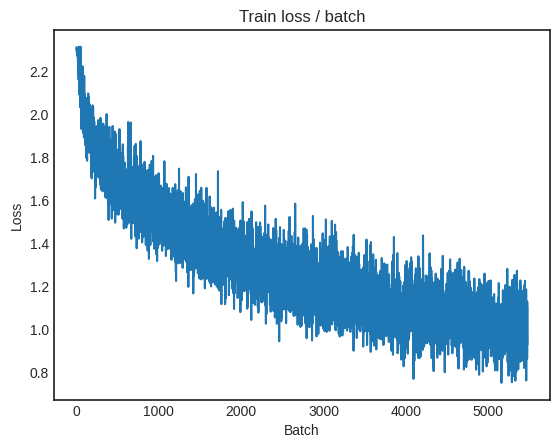

[TRAIN Batch 200/391]	Time 0.014s (0.099s)	Loss 1.0320 (0.9874)	Prec@1  64.1 ( 65.0)	Prec@5  94.5 ( 96.5)


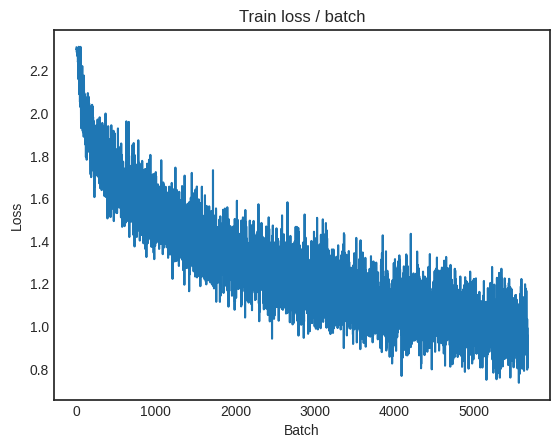


===============> Total time 37s	Avg loss 0.9862	Avg Prec@1 65.13 %	Avg Prec@5 96.56 %

[EVAL Batch 000/079]	Time 0.175s (0.175s)	Loss 1.0354 (1.0354)	Prec@1  65.6 ( 65.6)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.9917	Avg Prec@1 65.87 %	Avg Prec@5 96.71 %



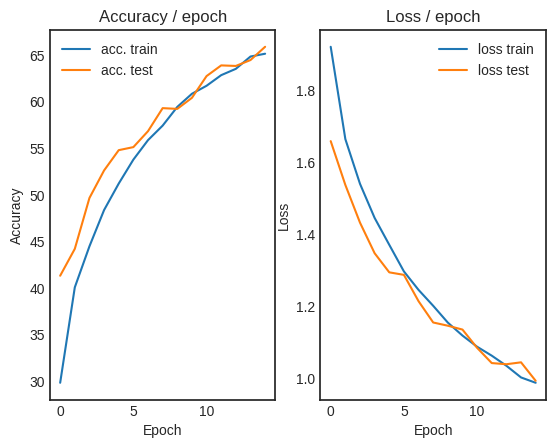

 30%|███       | 15/50 [10:08<23:59, 41.14s/it]

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.358s (0.358s)	Loss 0.9210 (0.9210)	Prec@1  68.0 ( 68.0)	Prec@5  95.3 ( 95.3)


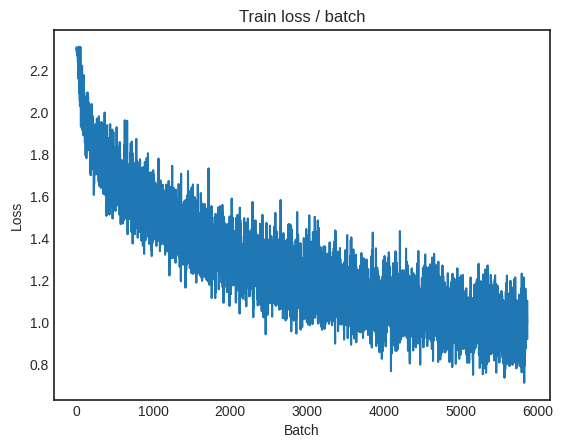

[TRAIN Batch 200/391]	Time 0.008s (0.095s)	Loss 0.9019 (0.9658)	Prec@1  67.2 ( 66.1)	Prec@5  98.4 ( 96.7)


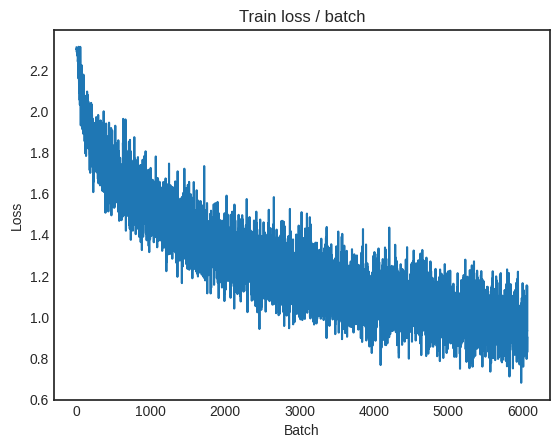


===============> Total time 37s	Avg loss 0.9644	Avg Prec@1 66.15 %	Avg Prec@5 96.69 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 0.9863 (0.9863)	Prec@1  67.2 ( 67.2)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.9657	Avg Prec@1 66.93 %	Avg Prec@5 97.06 %



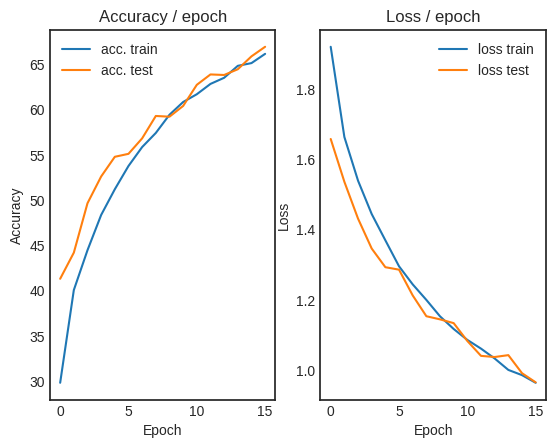

 32%|███▏      | 16/50 [10:49<23:17, 41.11s/it]

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.326s (0.326s)	Loss 0.9672 (0.9672)	Prec@1  68.0 ( 68.0)	Prec@5  95.3 ( 95.3)


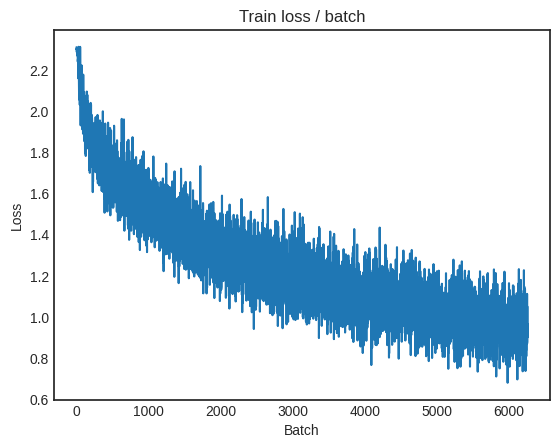

[TRAIN Batch 200/391]	Time 0.155s (0.095s)	Loss 1.0961 (0.9464)	Prec@1  57.0 ( 66.5)	Prec@5  95.3 ( 96.9)


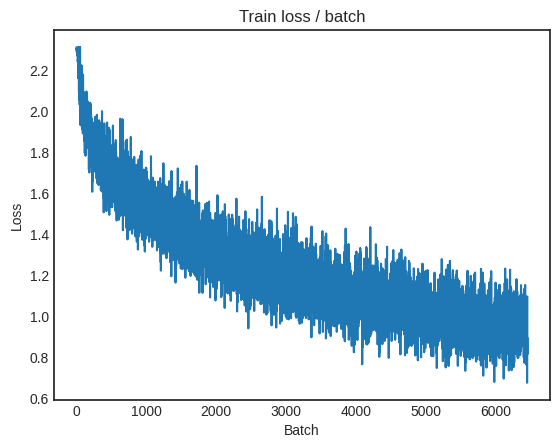


===============> Total time 37s	Avg loss 0.9449	Avg Prec@1 66.72 %	Avg Prec@5 96.92 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.9275 (0.9275)	Prec@1  68.8 ( 68.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9756	Avg Prec@1 66.54 %	Avg Prec@5 96.94 %



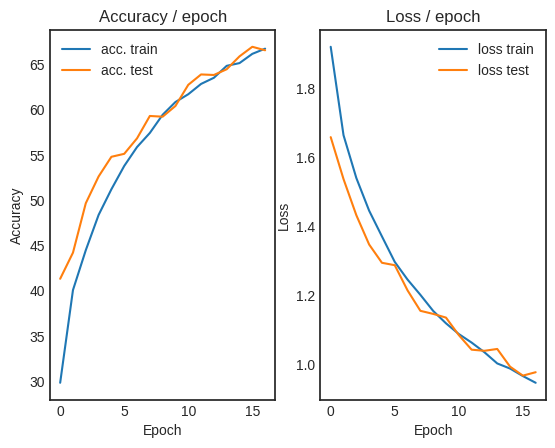

 34%|███▍      | 17/50 [11:29<22:30, 40.92s/it]

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.311s (0.311s)	Loss 1.0220 (1.0220)	Prec@1  58.6 ( 58.6)	Prec@5  96.1 ( 96.1)


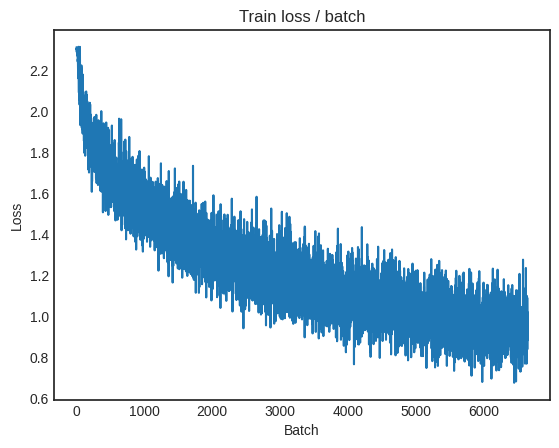

[TRAIN Batch 200/391]	Time 0.011s (0.095s)	Loss 0.9544 (0.9224)	Prec@1  67.2 ( 67.5)	Prec@5  95.3 ( 97.0)


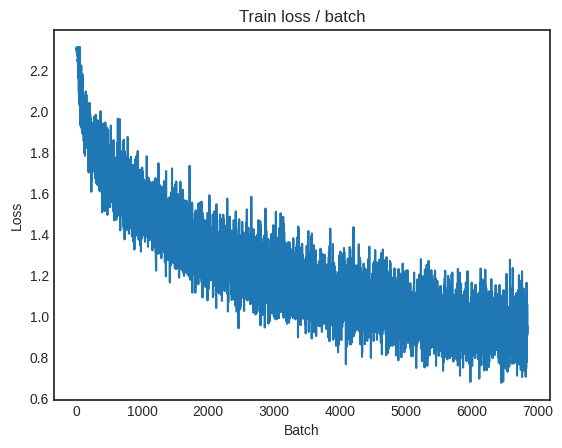


===============> Total time 37s	Avg loss 0.9287	Avg Prec@1 67.41 %	Avg Prec@5 97.01 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.9273 (0.9273)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9592	Avg Prec@1 66.94 %	Avg Prec@5 97.03 %



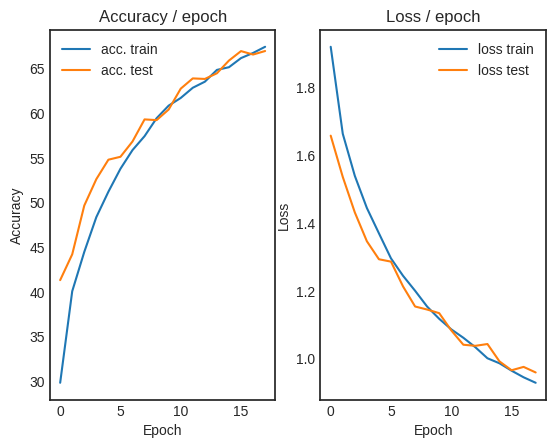

 36%|███▌      | 18/50 [12:10<21:46, 40.83s/it]

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.322s (0.322s)	Loss 0.9952 (0.9952)	Prec@1  64.8 ( 64.8)	Prec@5  96.1 ( 96.1)


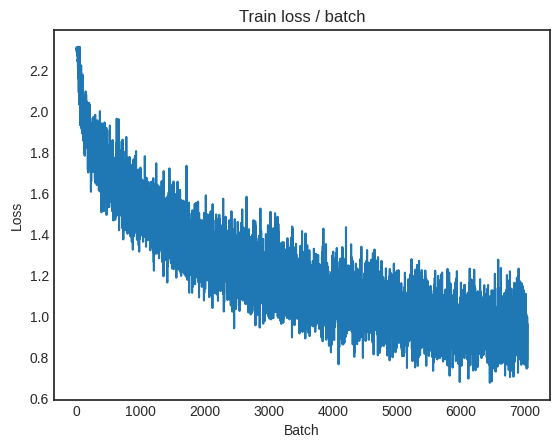

[TRAIN Batch 200/391]	Time 0.016s (0.100s)	Loss 0.8045 (0.9111)	Prec@1  68.8 ( 68.0)	Prec@5  96.9 ( 97.1)


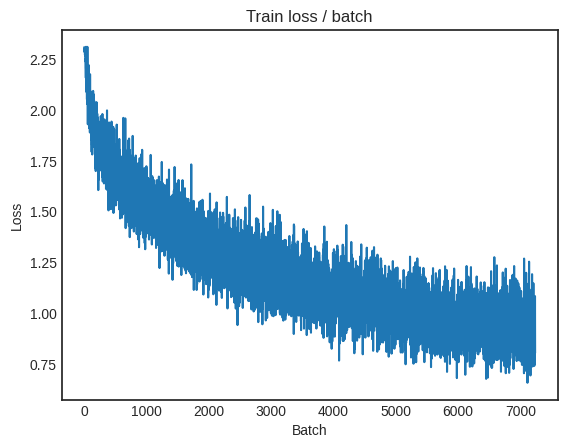


===============> Total time 37s	Avg loss 0.9137	Avg Prec@1 67.78 %	Avg Prec@5 97.16 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.8862 (0.8862)	Prec@1  71.1 ( 71.1)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9417	Avg Prec@1 67.64 %	Avg Prec@5 97.16 %



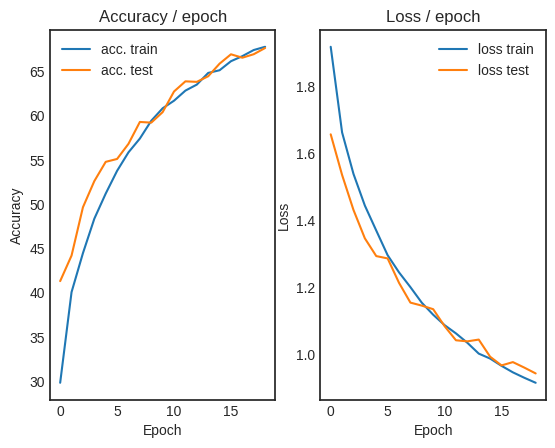

 38%|███▊      | 19/50 [12:50<21:03, 40.75s/it]

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.327s (0.327s)	Loss 0.9890 (0.9890)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)


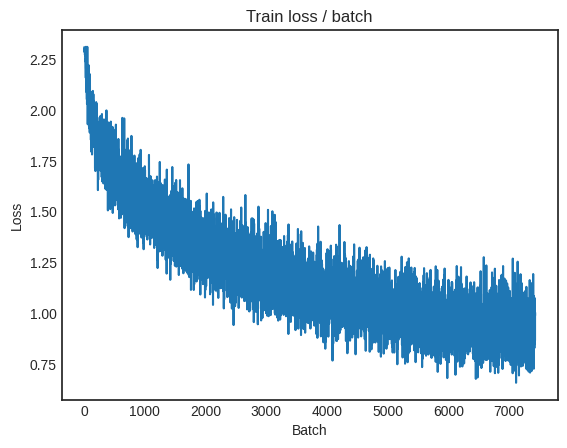

[TRAIN Batch 200/391]	Time 0.018s (0.098s)	Loss 1.0797 (0.9001)	Prec@1  63.3 ( 68.4)	Prec@5  94.5 ( 97.3)


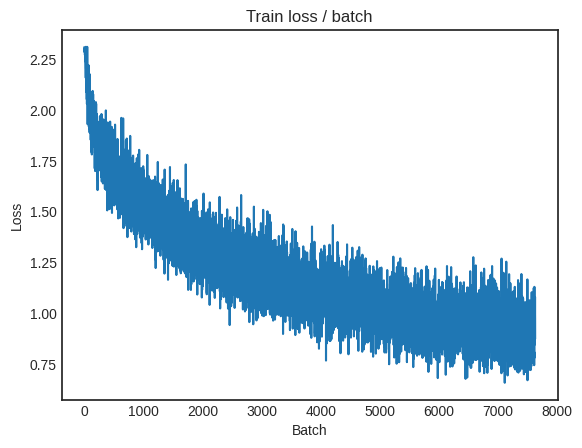


===============> Total time 37s	Avg loss 0.8971	Avg Prec@1 68.45 %	Avg Prec@5 97.34 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 0.9103 (0.9103)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.9040	Avg Prec@1 68.91 %	Avg Prec@5 97.46 %



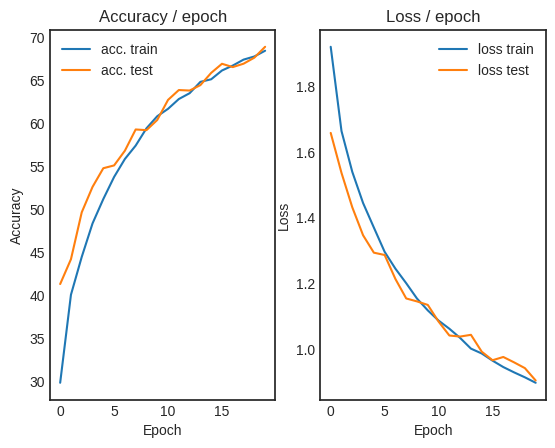

 40%|████      | 20/50 [13:31<20:24, 40.82s/it]

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.546s (0.546s)	Loss 0.8737 (0.8737)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)


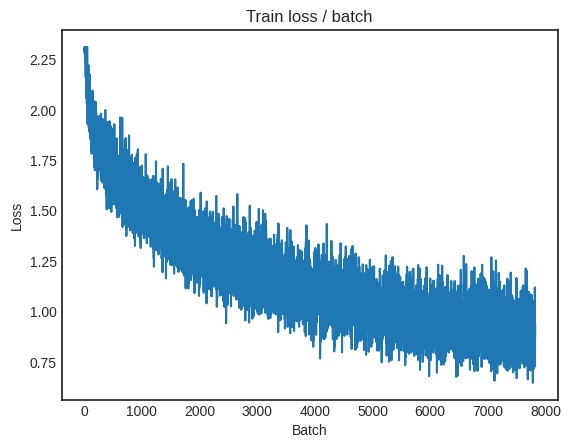

[TRAIN Batch 200/391]	Time 0.112s (0.094s)	Loss 0.7678 (0.8734)	Prec@1  71.1 ( 69.4)	Prec@5  97.7 ( 97.2)


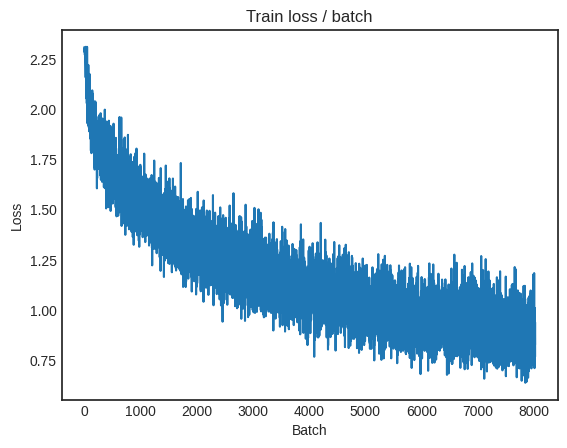


===============> Total time 36s	Avg loss 0.8837	Avg Prec@1 69.08 %	Avg Prec@5 97.26 %

[EVAL Batch 000/079]	Time 0.296s (0.296s)	Loss 0.8236 (0.8236)	Prec@1  74.2 ( 74.2)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.9290	Avg Prec@1 67.90 %	Avg Prec@5 97.20 %



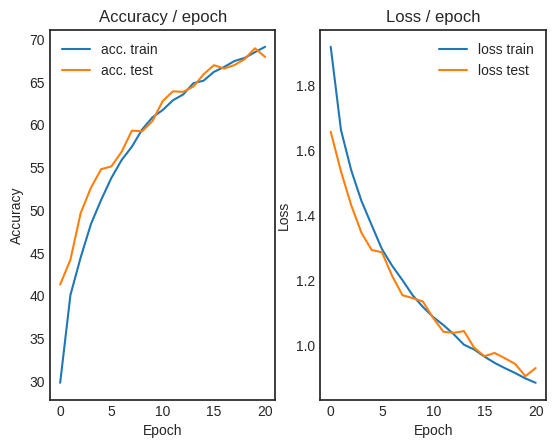

 42%|████▏     | 21/50 [14:12<19:40, 40.71s/it]

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.326s (0.326s)	Loss 0.9317 (0.9317)	Prec@1  66.4 ( 66.4)	Prec@5  96.1 ( 96.1)


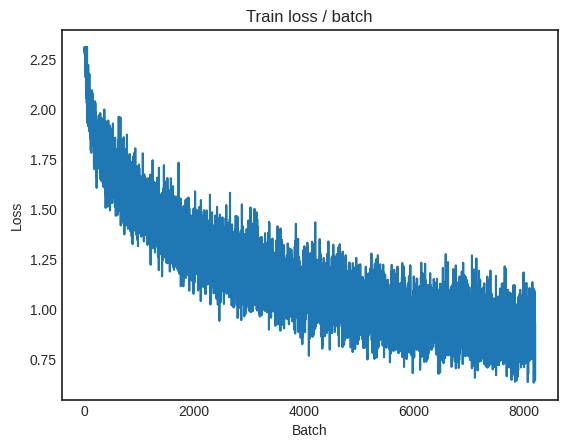

[TRAIN Batch 200/391]	Time 0.009s (0.101s)	Loss 0.9085 (0.8747)	Prec@1  71.1 ( 69.4)	Prec@5  93.8 ( 97.3)


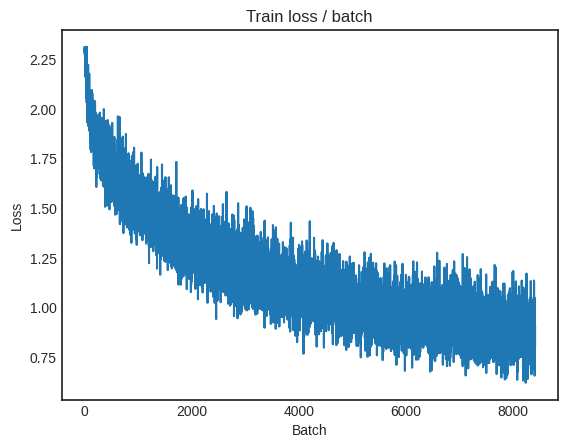


===============> Total time 39s	Avg loss 0.8672	Avg Prec@1 69.65 %	Avg Prec@5 97.39 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 0.9279 (0.9279)	Prec@1  69.5 ( 69.5)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.9086	Avg Prec@1 68.28 %	Avg Prec@5 97.35 %



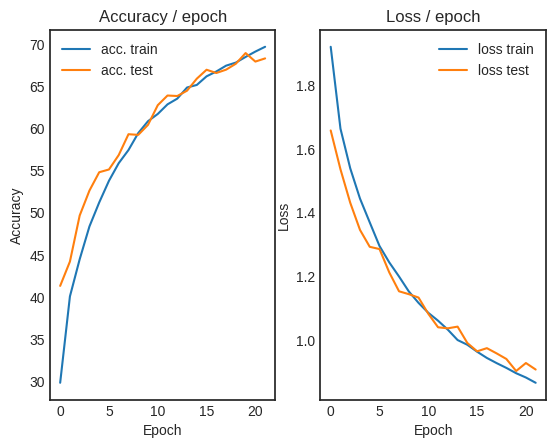

 44%|████▍     | 22/50 [14:54<19:12, 41.16s/it]

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.312s (0.312s)	Loss 0.8994 (0.8994)	Prec@1  71.1 ( 71.1)	Prec@5  96.1 ( 96.1)


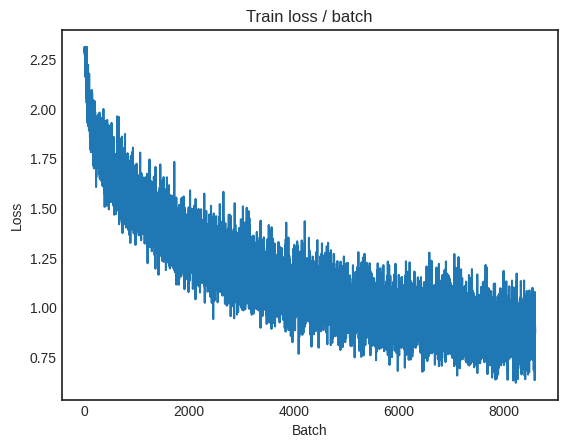

[TRAIN Batch 200/391]	Time 0.013s (0.099s)	Loss 0.7506 (0.8466)	Prec@1  76.6 ( 70.1)	Prec@5  98.4 ( 97.7)


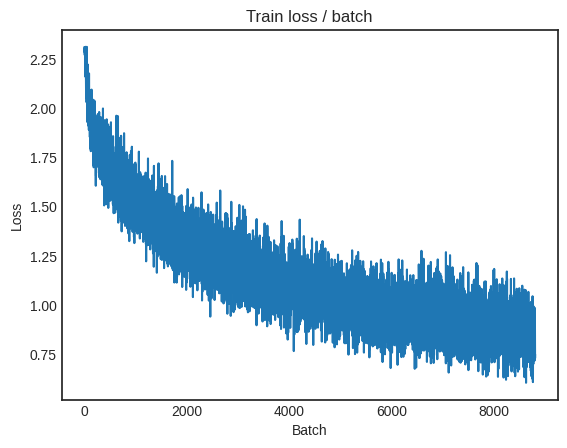


===============> Total time 37s	Avg loss 0.8507	Avg Prec@1 70.19 %	Avg Prec@5 97.56 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 0.9346 (0.9346)	Prec@1  68.0 ( 68.0)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.9006	Avg Prec@1 69.49 %	Avg Prec@5 97.38 %



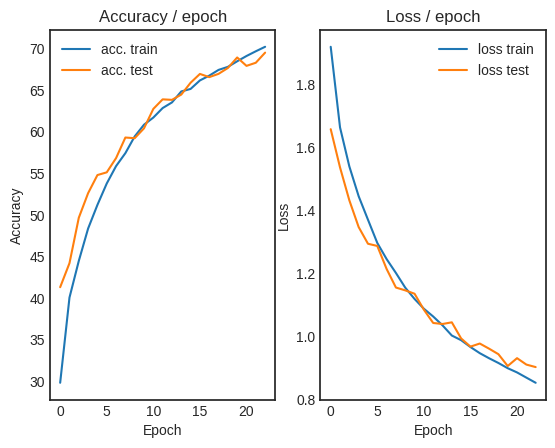

 46%|████▌     | 23/50 [15:35<18:27, 41.00s/it]

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.360s (0.360s)	Loss 0.7204 (0.7204)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)


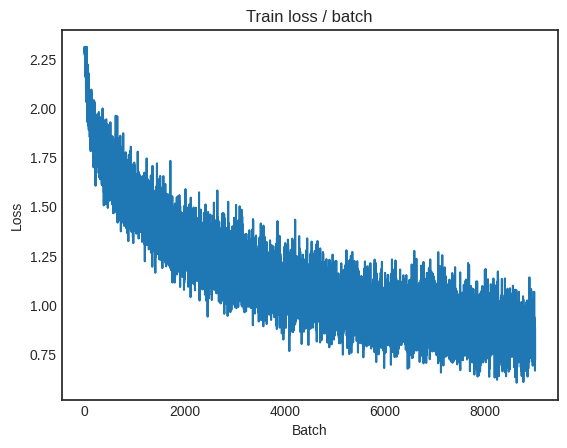

[TRAIN Batch 200/391]	Time 0.165s (0.102s)	Loss 1.0383 (0.8322)	Prec@1  64.8 ( 71.1)	Prec@5  95.3 ( 97.6)


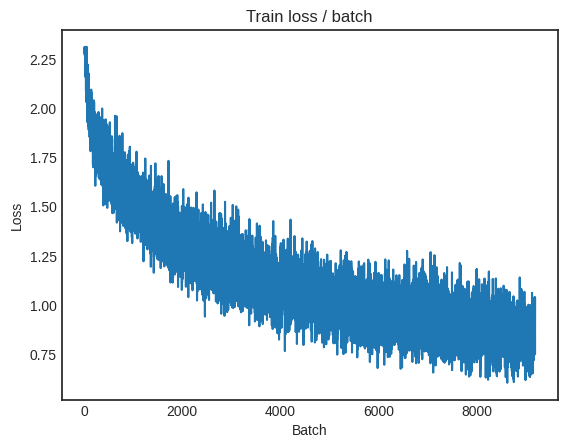


===============> Total time 38s	Avg loss 0.8373	Avg Prec@1 70.84 %	Avg Prec@5 97.60 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 0.8615 (0.8615)	Prec@1  71.1 ( 71.1)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8660	Avg Prec@1 70.03 %	Avg Prec@5 97.57 %



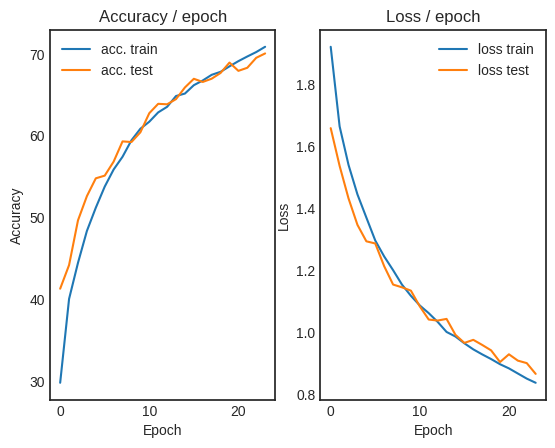

 48%|████▊     | 24/50 [16:17<17:56, 41.39s/it]

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.382s (0.382s)	Loss 0.8095 (0.8095)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)


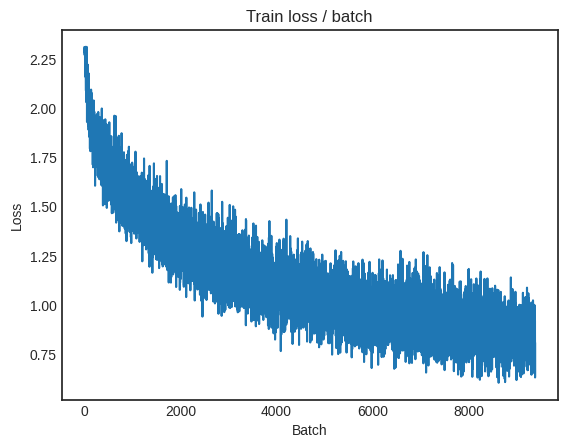

[TRAIN Batch 200/391]	Time 0.008s (0.095s)	Loss 0.8705 (0.8227)	Prec@1  67.2 ( 71.1)	Prec@5  97.7 ( 97.8)


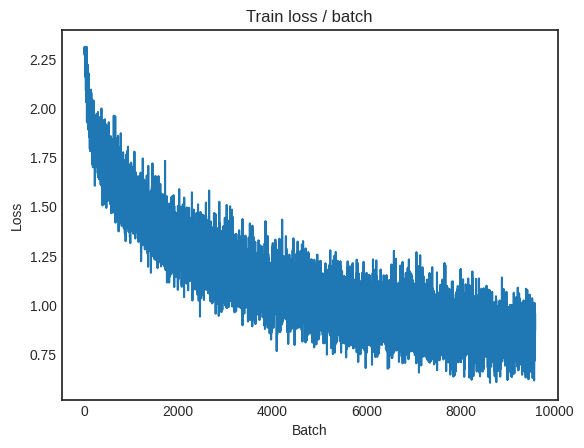


===============> Total time 37s	Avg loss 0.8306	Avg Prec@1 70.83 %	Avg Prec@5 97.76 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 0.8775 (0.8775)	Prec@1  71.1 ( 71.1)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.8769	Avg Prec@1 70.14 %	Avg Prec@5 97.37 %



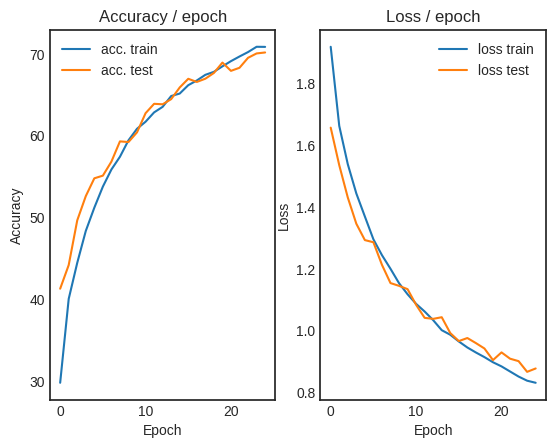

 50%|█████     | 25/50 [16:58<17:10, 41.24s/it]

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.345s (0.345s)	Loss 0.8427 (0.8427)	Prec@1  68.0 ( 68.0)	Prec@5  97.7 ( 97.7)


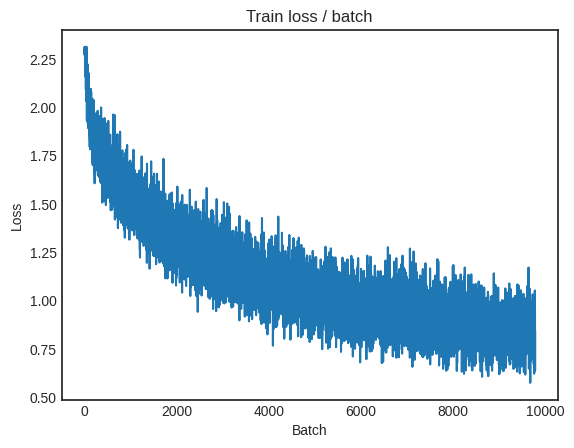

[TRAIN Batch 200/391]	Time 0.157s (0.096s)	Loss 0.7833 (0.8117)	Prec@1  70.3 ( 71.5)	Prec@5  96.9 ( 97.8)


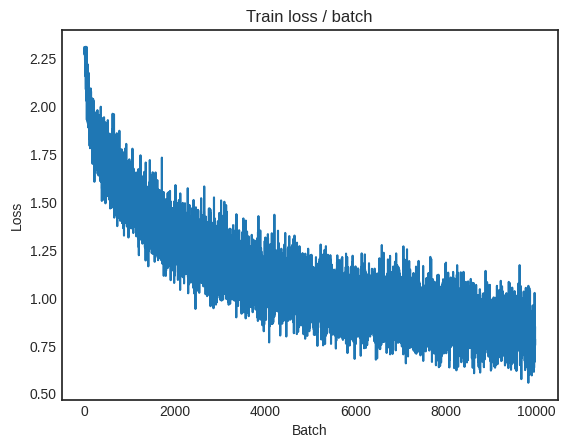


===============> Total time 38s	Avg loss 0.8170	Avg Prec@1 71.37 %	Avg Prec@5 97.84 %

[EVAL Batch 000/079]	Time 0.175s (0.175s)	Loss 0.8677 (0.8677)	Prec@1  69.5 ( 69.5)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.8746	Avg Prec@1 69.67 %	Avg Prec@5 97.44 %



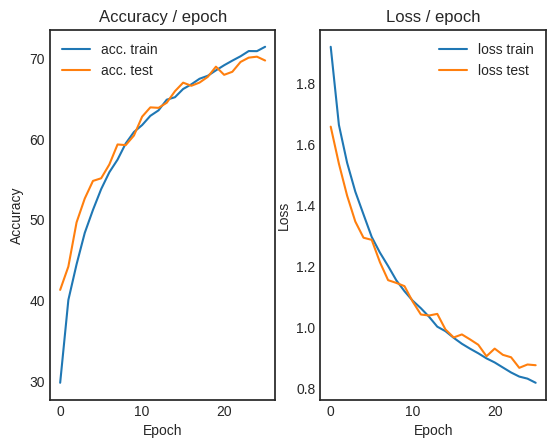

 52%|█████▏    | 26/50 [17:39<16:29, 41.24s/it]

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.351s (0.351s)	Loss 0.9272 (0.9272)	Prec@1  68.0 ( 68.0)	Prec@5  98.4 ( 98.4)


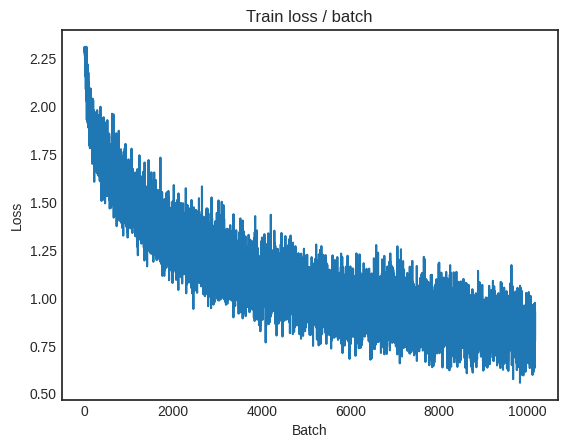

[TRAIN Batch 200/391]	Time 0.135s (0.102s)	Loss 0.8018 (0.8128)	Prec@1  64.8 ( 71.7)	Prec@5  98.4 ( 97.8)


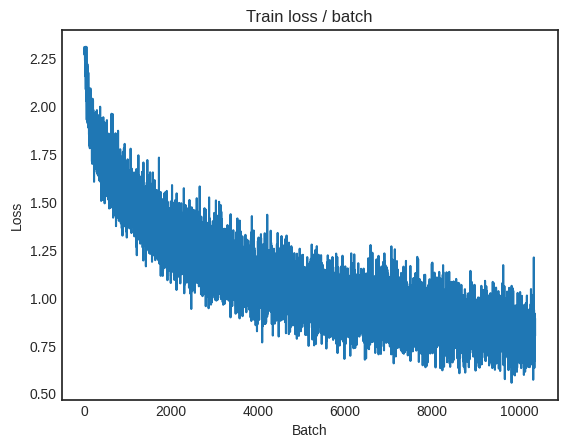


===============> Total time 38s	Avg loss 0.8063	Avg Prec@1 71.72 %	Avg Prec@5 97.91 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 0.8473 (0.8473)	Prec@1  71.1 ( 71.1)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8820	Avg Prec@1 69.70 %	Avg Prec@5 97.50 %



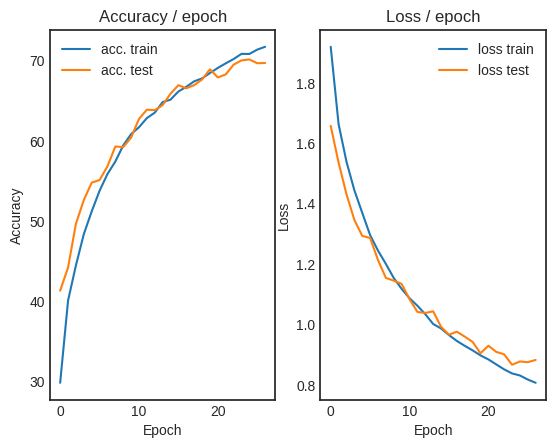

 54%|█████▍    | 27/50 [18:20<15:48, 41.25s/it]

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.325s (0.325s)	Loss 0.8037 (0.8037)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)


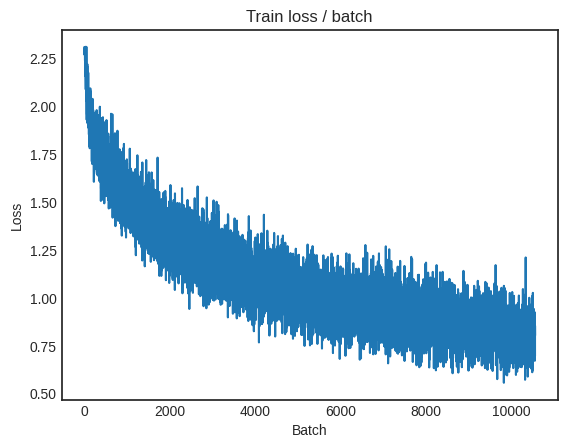

[TRAIN Batch 200/391]	Time 0.067s (0.099s)	Loss 0.8576 (0.8046)	Prec@1  64.1 ( 72.0)	Prec@5 100.0 ( 97.8)


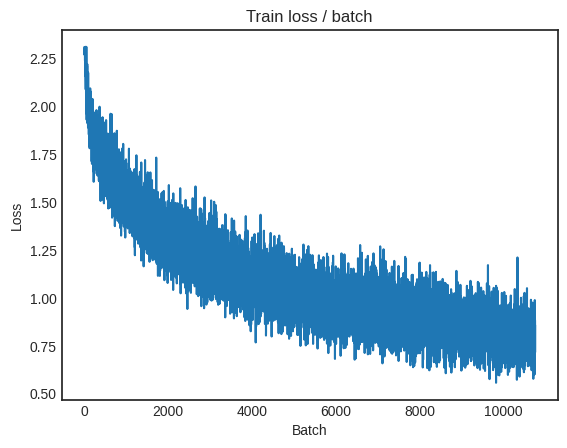


===============> Total time 37s	Avg loss 0.7977	Avg Prec@1 72.18 %	Avg Prec@5 97.91 %

[EVAL Batch 000/079]	Time 0.184s (0.184s)	Loss 0.8334 (0.8334)	Prec@1  71.1 ( 71.1)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8642	Avg Prec@1 70.34 %	Avg Prec@5 97.41 %



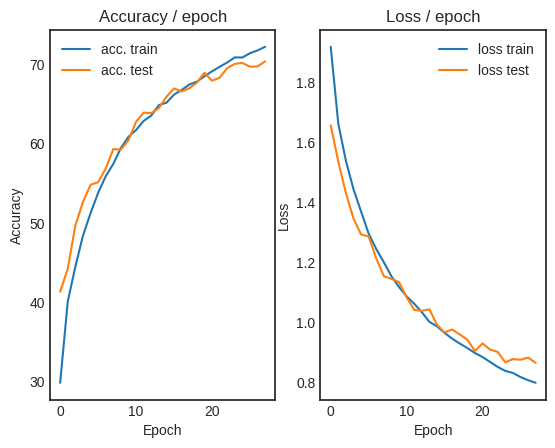

 56%|█████▌    | 28/50 [19:02<15:10, 41.38s/it]

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.351s (0.351s)	Loss 0.7727 (0.7727)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)


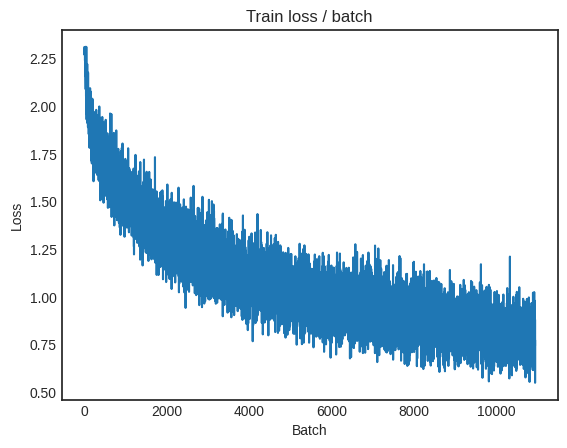

[TRAIN Batch 200/391]	Time 0.158s (0.096s)	Loss 0.7901 (0.7914)	Prec@1  70.3 ( 72.3)	Prec@5  96.1 ( 97.8)


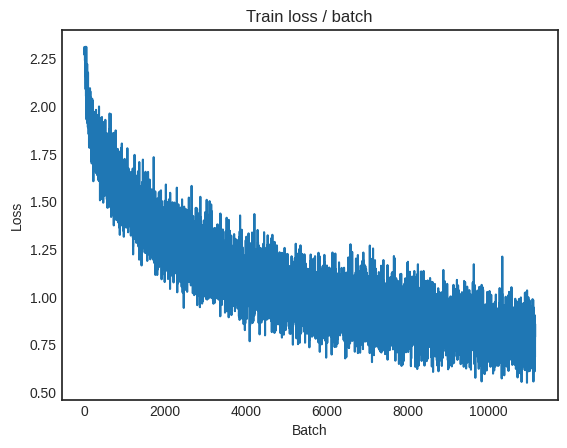


===============> Total time 37s	Avg loss 0.7923	Avg Prec@1 72.29 %	Avg Prec@5 97.91 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 0.8588 (0.8588)	Prec@1  73.4 ( 73.4)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.8608	Avg Prec@1 70.80 %	Avg Prec@5 97.47 %



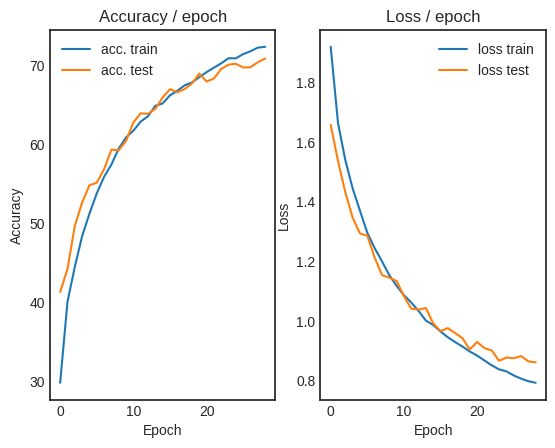

 58%|█████▊    | 29/50 [19:43<14:25, 41.23s/it]

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.389s (0.389s)	Loss 0.8333 (0.8333)	Prec@1  69.5 ( 69.5)	Prec@5  97.7 ( 97.7)


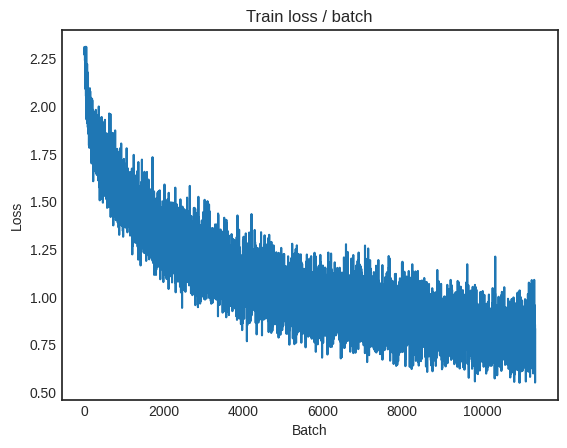

[TRAIN Batch 200/391]	Time 0.120s (0.094s)	Loss 0.8345 (0.7798)	Prec@1  72.7 ( 72.6)	Prec@5  98.4 ( 98.0)


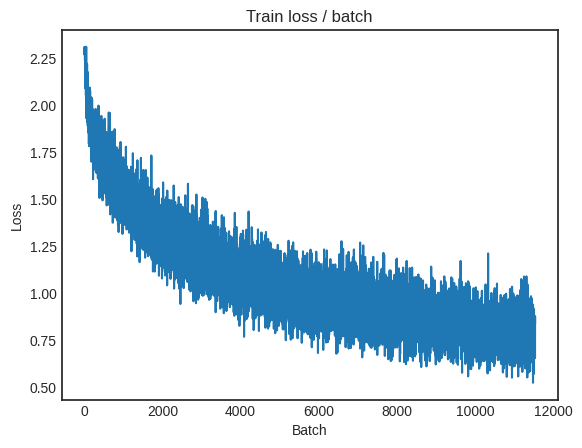


===============> Total time 39s	Avg loss 0.7767	Avg Prec@1 72.81 %	Avg Prec@5 97.95 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 0.8351 (0.8351)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8306	Avg Prec@1 71.47 %	Avg Prec@5 97.85 %



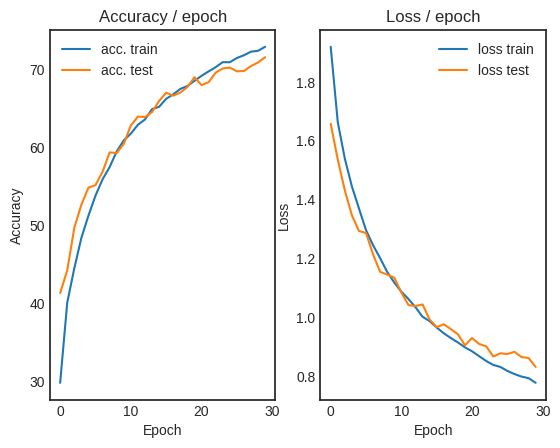

 60%|██████    | 30/50 [20:25<13:50, 41.53s/it]

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.354s (0.354s)	Loss 0.7676 (0.7676)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)


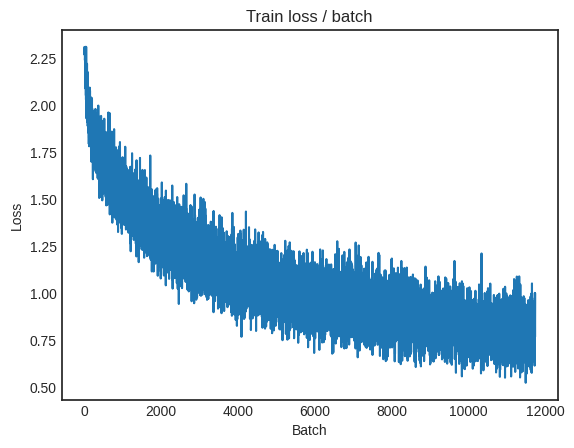

[TRAIN Batch 200/391]	Time 0.036s (0.100s)	Loss 0.8283 (0.7711)	Prec@1  73.4 ( 73.2)	Prec@5  98.4 ( 98.1)


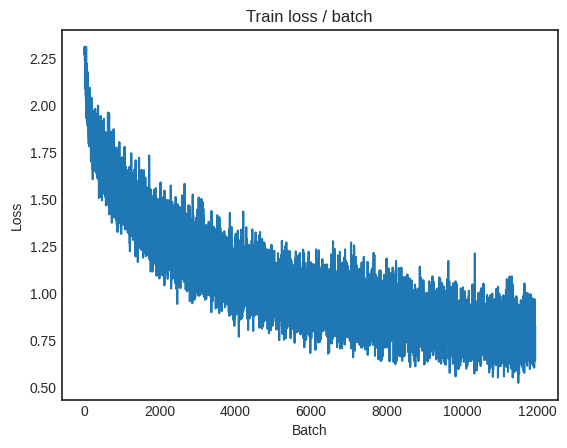


===============> Total time 37s	Avg loss 0.7740	Avg Prec@1 73.12 %	Avg Prec@5 98.04 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.8393 (0.8393)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8259	Avg Prec@1 72.09 %	Avg Prec@5 97.77 %



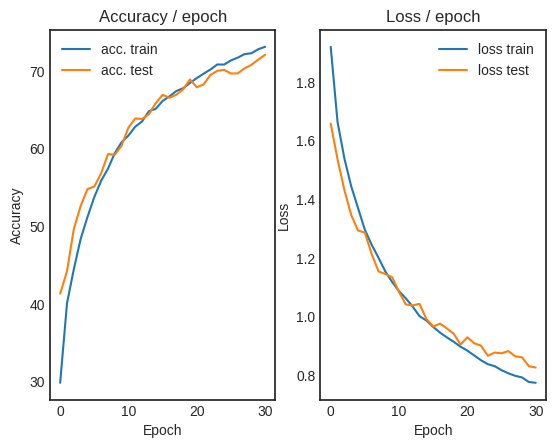

 62%|██████▏   | 31/50 [21:06<13:05, 41.32s/it]

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.328s (0.328s)	Loss 0.8612 (0.8612)	Prec@1  69.5 ( 69.5)	Prec@5  99.2 ( 99.2)


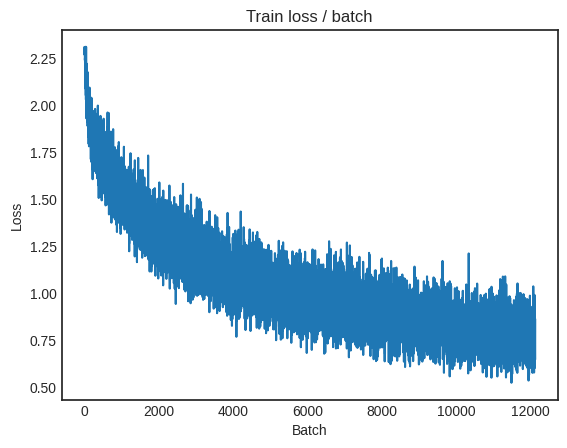

[TRAIN Batch 200/391]	Time 0.013s (0.099s)	Loss 0.6268 (0.7602)	Prec@1  78.9 ( 73.7)	Prec@5  99.2 ( 98.0)


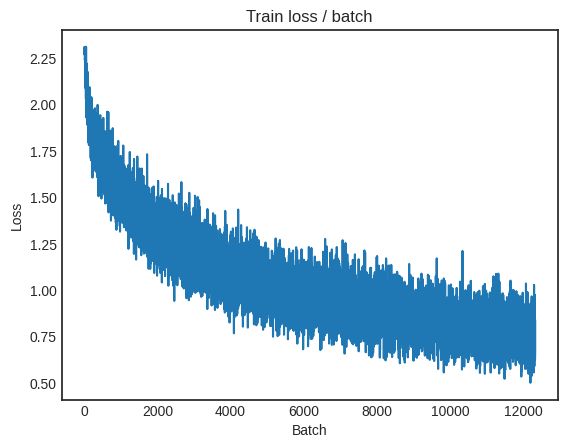


===============> Total time 37s	Avg loss 0.7633	Avg Prec@1 73.47 %	Avg Prec@5 98.08 %

[EVAL Batch 000/079]	Time 0.175s (0.175s)	Loss 0.8037 (0.8037)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8140	Avg Prec@1 72.12 %	Avg Prec@5 97.86 %



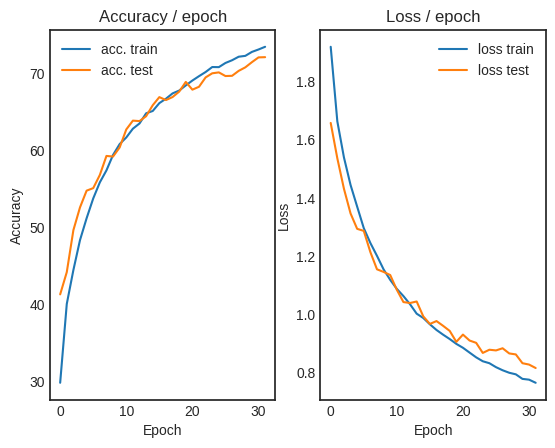

 64%|██████▍   | 32/50 [21:47<12:24, 41.36s/it]

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.399s (0.399s)	Loss 0.6371 (0.6371)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)


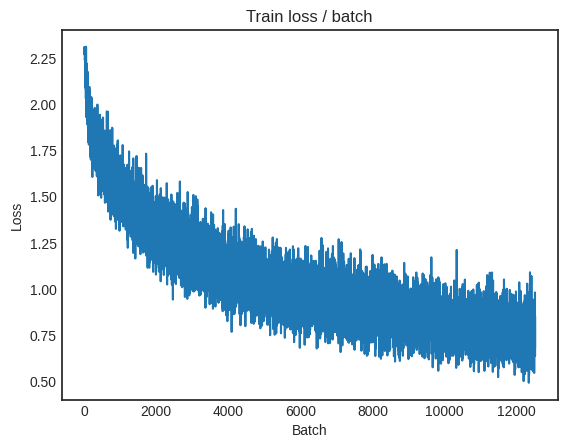

[TRAIN Batch 200/391]	Time 0.013s (0.093s)	Loss 0.7252 (0.7524)	Prec@1  75.8 ( 73.4)	Prec@5  95.3 ( 98.1)


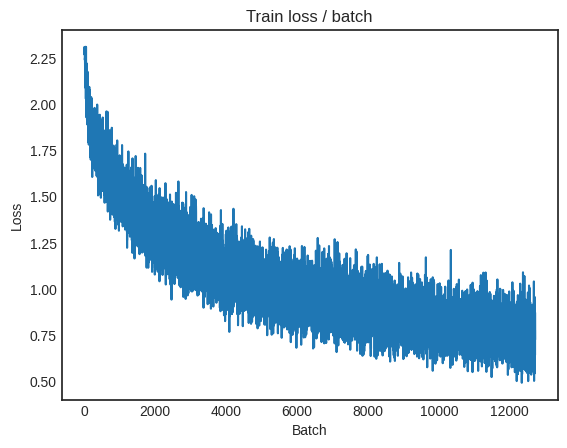


===============> Total time 36s	Avg loss 0.7525	Avg Prec@1 73.65 %	Avg Prec@5 98.09 %

[EVAL Batch 000/079]	Time 0.326s (0.326s)	Loss 0.8098 (0.8098)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8217	Avg Prec@1 71.77 %	Avg Prec@5 97.78 %



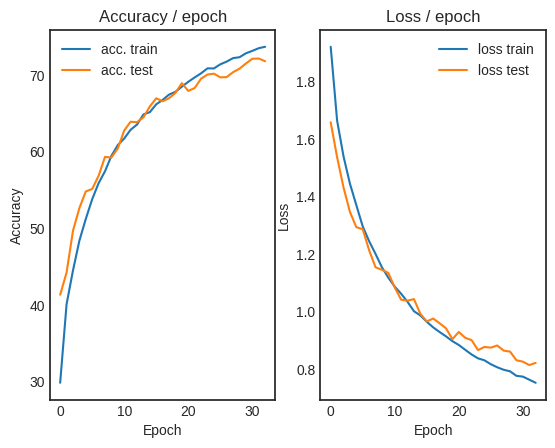

 66%|██████▌   | 33/50 [22:28<11:39, 41.15s/it]

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.381s (0.381s)	Loss 0.6314 (0.6314)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)


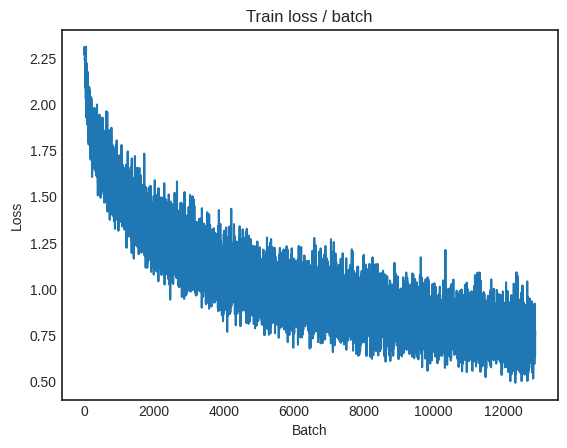

[TRAIN Batch 200/391]	Time 0.161s (0.098s)	Loss 0.7142 (0.7407)	Prec@1  75.0 ( 74.2)	Prec@5  97.7 ( 98.2)


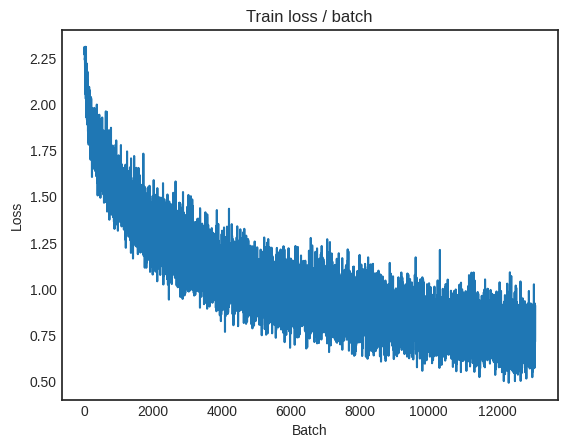


===============> Total time 38s	Avg loss 0.7432	Avg Prec@1 73.86 %	Avg Prec@5 98.24 %

[EVAL Batch 000/079]	Time 0.181s (0.181s)	Loss 0.8226 (0.8226)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8124	Avg Prec@1 72.23 %	Avg Prec@5 97.88 %



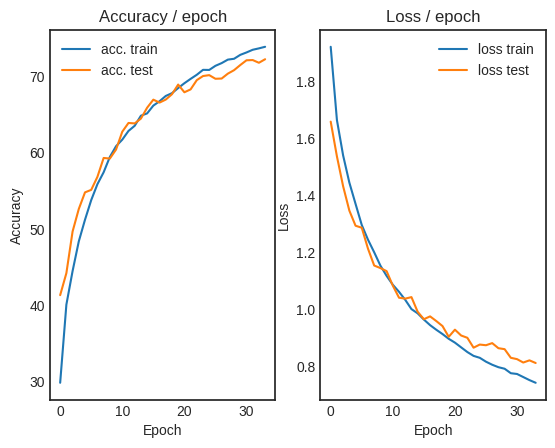

 68%|██████▊   | 34/50 [23:10<11:00, 41.28s/it]

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.400s (0.400s)	Loss 0.9047 (0.9047)	Prec@1  68.0 ( 68.0)	Prec@5  97.7 ( 97.7)


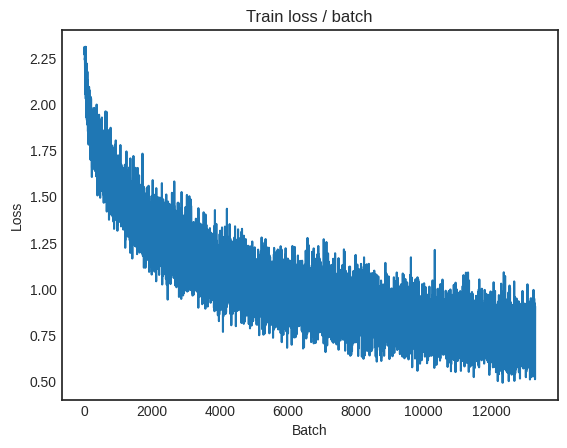

[TRAIN Batch 200/391]	Time 0.013s (0.103s)	Loss 0.6353 (0.7384)	Prec@1  78.9 ( 74.5)	Prec@5 100.0 ( 98.1)


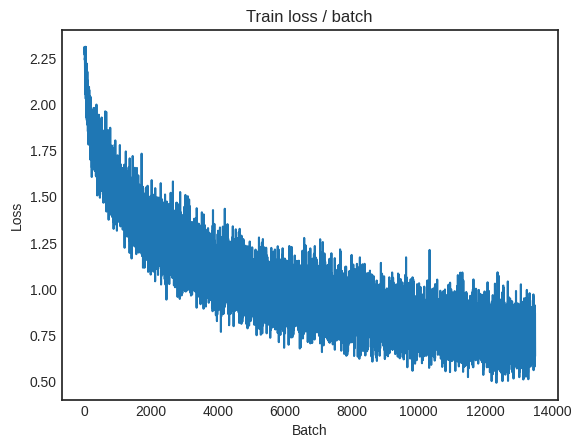


===============> Total time 38s	Avg loss 0.7428	Avg Prec@1 74.26 %	Avg Prec@5 98.13 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 0.8327 (0.8327)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8091	Avg Prec@1 72.25 %	Avg Prec@5 97.76 %



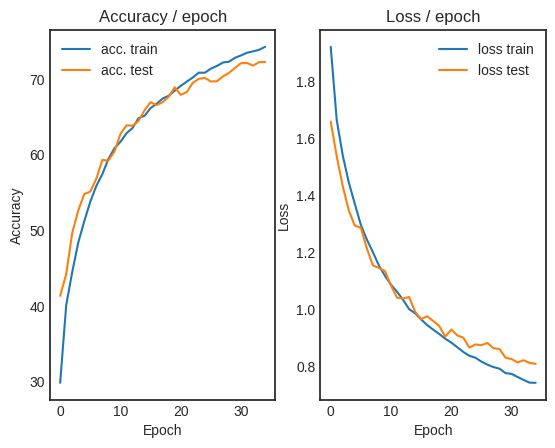

 70%|███████   | 35/50 [23:51<10:21, 41.42s/it]

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.342s (0.342s)	Loss 0.4826 (0.4826)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


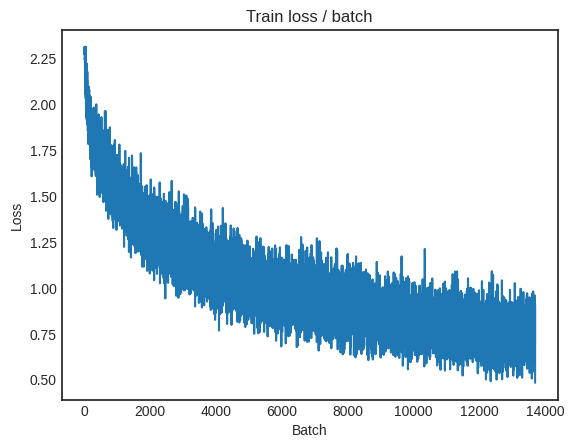

[TRAIN Batch 200/391]	Time 0.008s (0.101s)	Loss 0.6793 (0.7255)	Prec@1  75.8 ( 74.7)	Prec@5  98.4 ( 98.3)


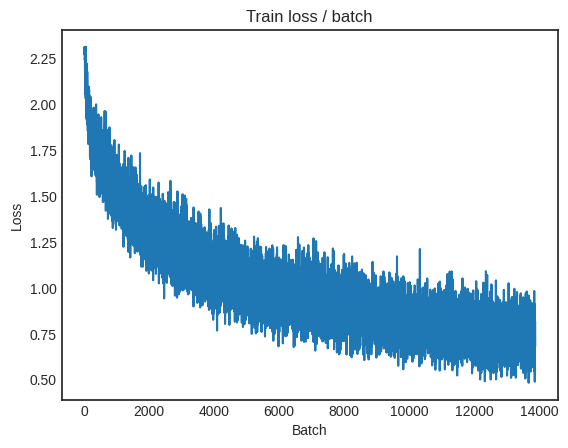


===============> Total time 38s	Avg loss 0.7352	Avg Prec@1 74.41 %	Avg Prec@5 98.17 %

[EVAL Batch 000/079]	Time 0.190s (0.190s)	Loss 0.7888 (0.7888)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7878	Avg Prec@1 72.82 %	Avg Prec@5 97.96 %



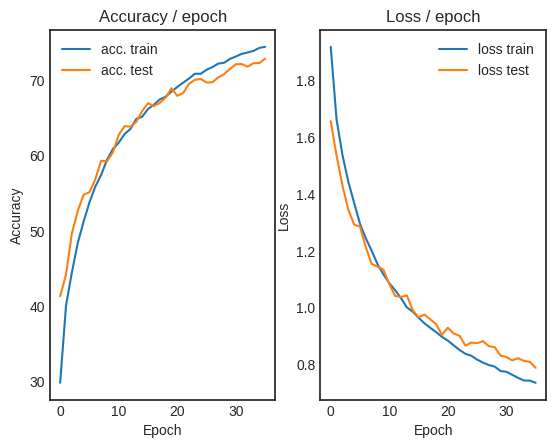

 72%|███████▏  | 36/50 [24:34<09:44, 41.74s/it]

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.386s (0.386s)	Loss 0.7241 (0.7241)	Prec@1  78.9 ( 78.9)	Prec@5  95.3 ( 95.3)


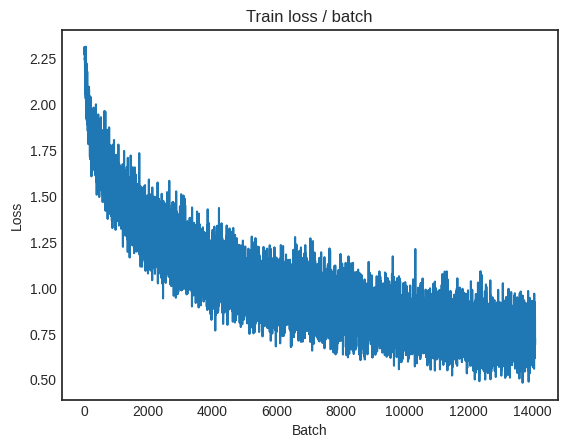

[TRAIN Batch 200/391]	Time 0.148s (0.097s)	Loss 0.8352 (0.7224)	Prec@1  66.4 ( 74.9)	Prec@5  98.4 ( 98.3)


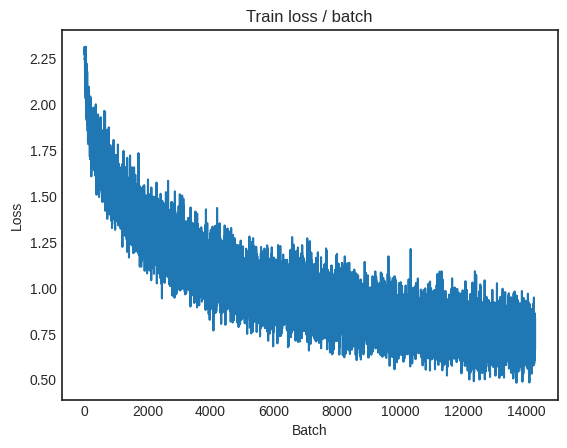


===============> Total time 38s	Avg loss 0.7252	Avg Prec@1 74.77 %	Avg Prec@5 98.27 %

[EVAL Batch 000/079]	Time 0.178s (0.178s)	Loss 0.8374 (0.8374)	Prec@1  68.0 ( 68.0)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8371	Avg Prec@1 71.23 %	Avg Prec@5 97.81 %



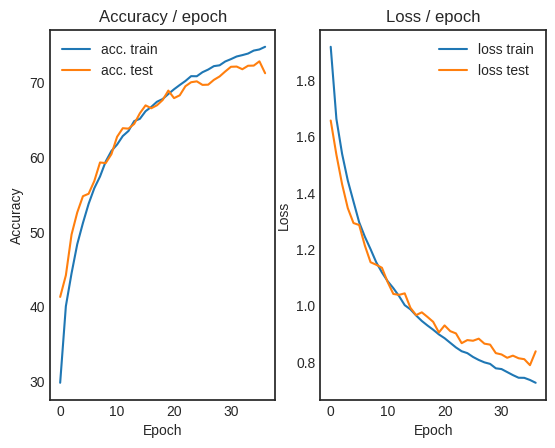

 74%|███████▍  | 37/50 [25:16<09:02, 41.71s/it]

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.352s (0.352s)	Loss 0.7867 (0.7867)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)


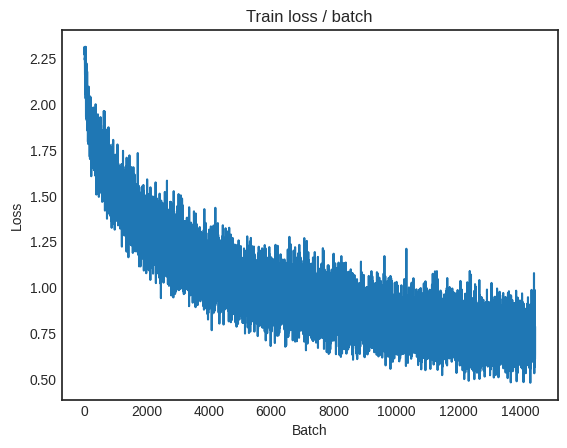

[TRAIN Batch 200/391]	Time 0.294s (0.098s)	Loss 0.7612 (0.7229)	Prec@1  71.9 ( 74.9)	Prec@5  98.4 ( 98.3)


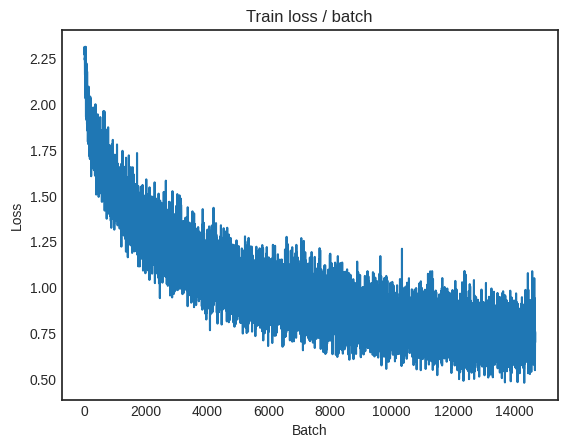


===============> Total time 38s	Avg loss 0.7236	Avg Prec@1 74.58 %	Avg Prec@5 98.35 %

[EVAL Batch 000/079]	Time 0.187s (0.187s)	Loss 0.8367 (0.8367)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8017	Avg Prec@1 72.94 %	Avg Prec@5 97.88 %



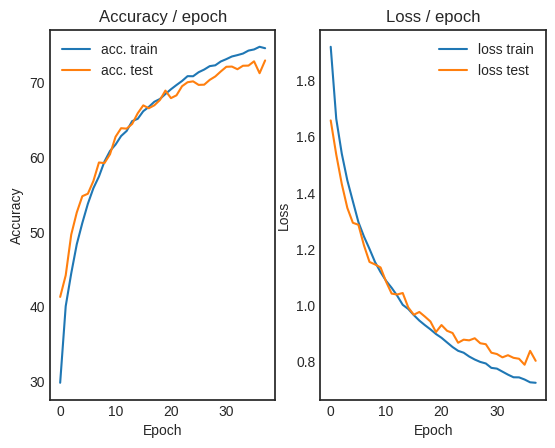

 76%|███████▌  | 38/50 [25:57<08:17, 41.50s/it]

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.359s (0.359s)	Loss 0.7115 (0.7115)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)


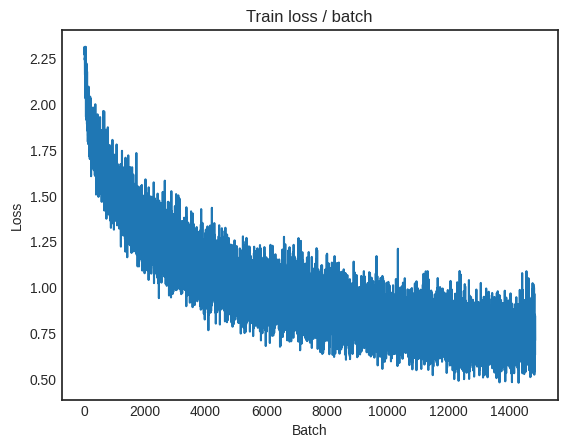

[TRAIN Batch 200/391]	Time 0.045s (0.101s)	Loss 0.7530 (0.7043)	Prec@1  67.2 ( 75.2)	Prec@5  98.4 ( 98.5)


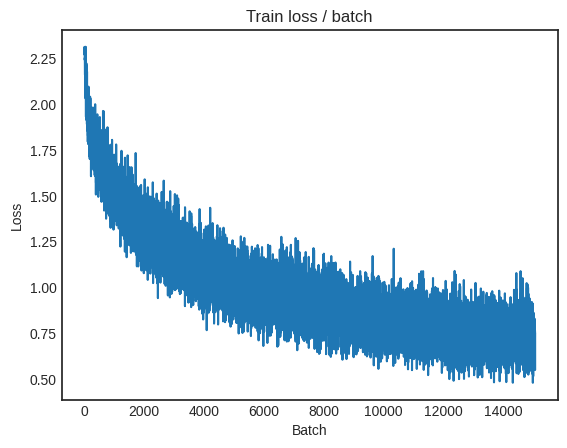


===============> Total time 39s	Avg loss 0.7108	Avg Prec@1 75.12 %	Avg Prec@5 98.36 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 0.7831 (0.7831)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8071	Avg Prec@1 72.73 %	Avg Prec@5 97.79 %



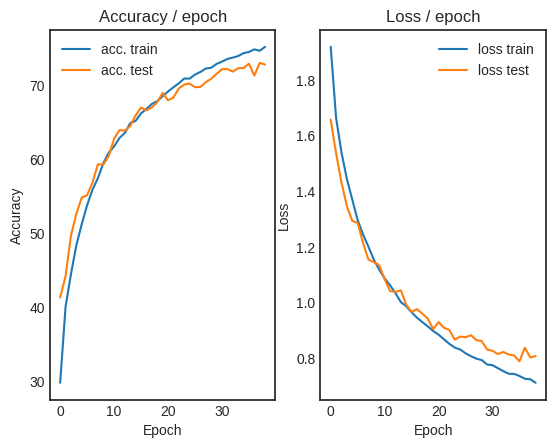

 78%|███████▊  | 39/50 [26:40<07:41, 41.94s/it]

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.474s (0.474s)	Loss 0.7889 (0.7889)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)


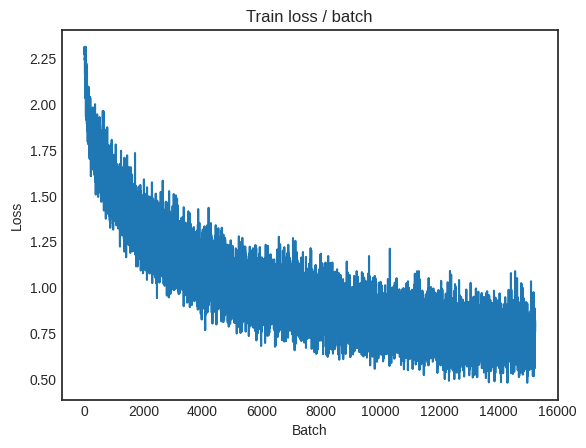

[TRAIN Batch 200/391]	Time 0.010s (0.095s)	Loss 0.7559 (0.7125)	Prec@1  70.3 ( 74.9)	Prec@5 100.0 ( 98.3)


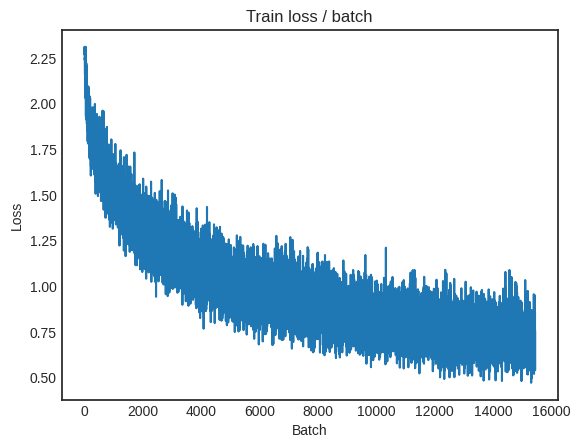


===============> Total time 37s	Avg loss 0.7108	Avg Prec@1 75.17 %	Avg Prec@5 98.37 %

[EVAL Batch 000/079]	Time 0.268s (0.268s)	Loss 0.7300 (0.7300)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7997	Avg Prec@1 72.39 %	Avg Prec@5 97.84 %



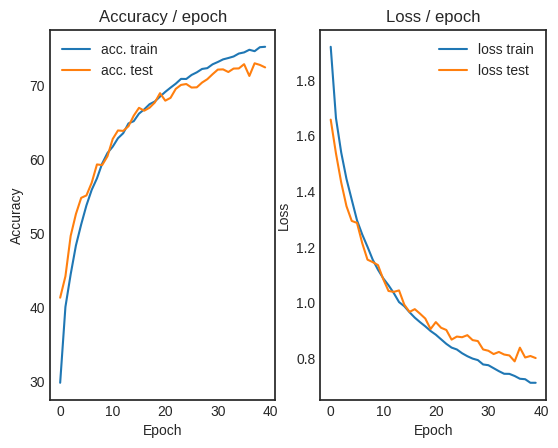

 80%|████████  | 40/50 [27:21<06:56, 41.65s/it]

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.331s (0.331s)	Loss 0.7750 (0.7750)	Prec@1  69.5 ( 69.5)	Prec@5  98.4 ( 98.4)


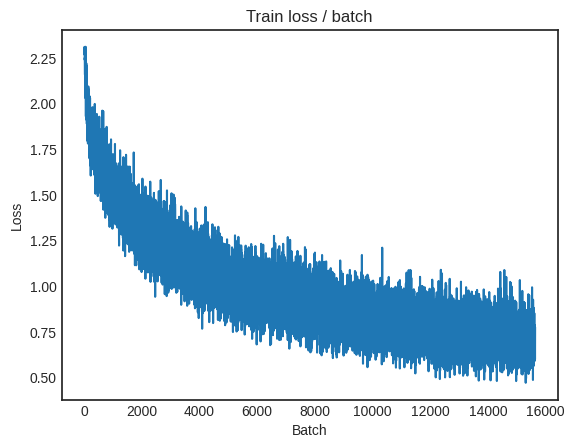

[TRAIN Batch 200/391]	Time 0.008s (0.093s)	Loss 0.6952 (0.6966)	Prec@1  75.8 ( 75.5)	Prec@5 100.0 ( 98.4)


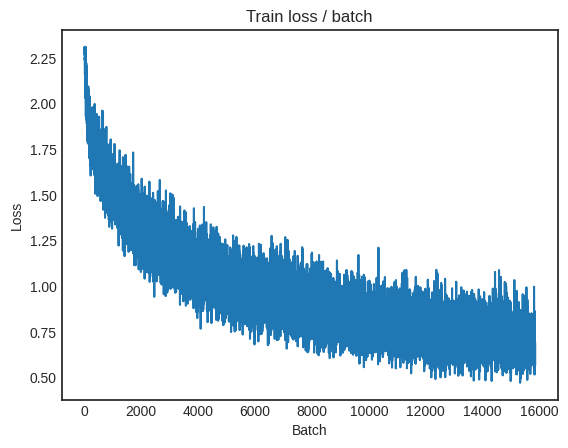


===============> Total time 37s	Avg loss 0.7041	Avg Prec@1 75.11 %	Avg Prec@5 98.39 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 0.7880 (0.7880)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7832	Avg Prec@1 73.44 %	Avg Prec@5 97.91 %



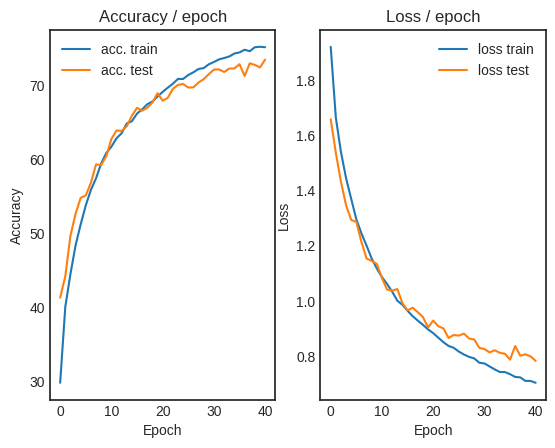

 82%|████████▏ | 41/50 [28:01<06:10, 41.21s/it]

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.398s (0.398s)	Loss 0.6478 (0.6478)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)


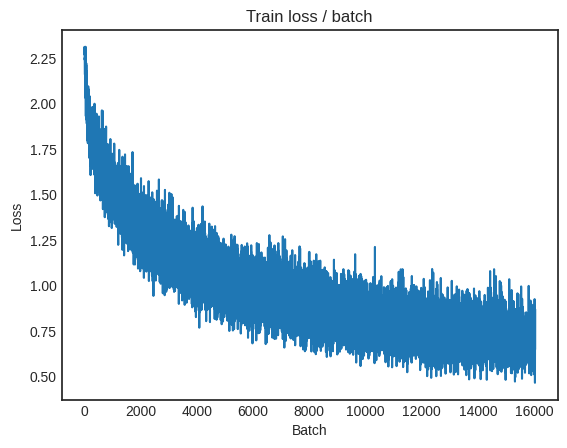

[TRAIN Batch 200/391]	Time 0.303s (0.096s)	Loss 0.7097 (0.7013)	Prec@1  75.8 ( 75.2)	Prec@5  99.2 ( 98.4)


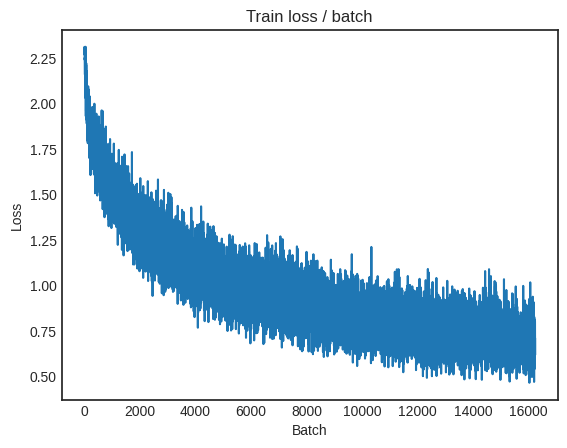


===============> Total time 37s	Avg loss 0.6965	Avg Prec@1 75.54 %	Avg Prec@5 98.37 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 0.8045 (0.8045)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7893	Avg Prec@1 73.32 %	Avg Prec@5 97.94 %



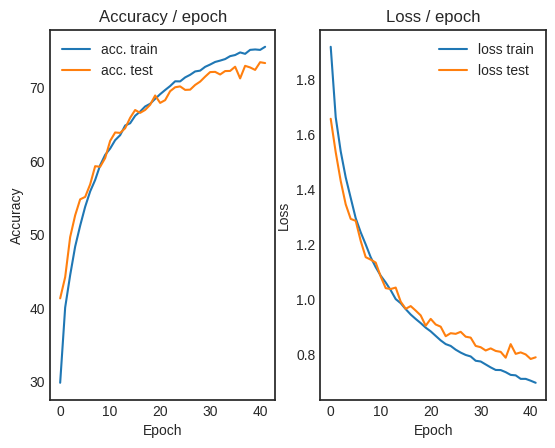

 84%|████████▍ | 42/50 [28:41<05:28, 41.04s/it]

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.335s (0.335s)	Loss 0.6496 (0.6496)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)


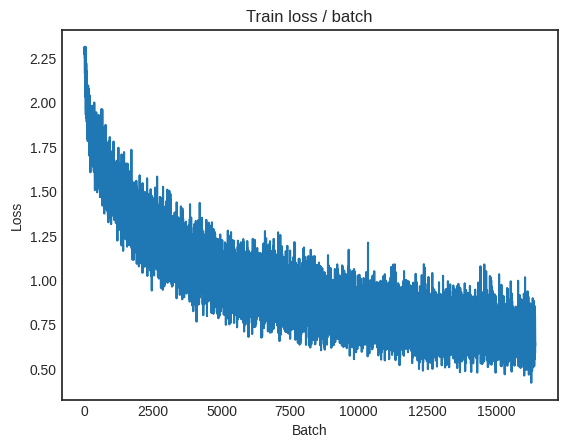

[TRAIN Batch 200/391]	Time 0.008s (0.099s)	Loss 0.6569 (0.6906)	Prec@1  74.2 ( 75.8)	Prec@5  98.4 ( 98.4)


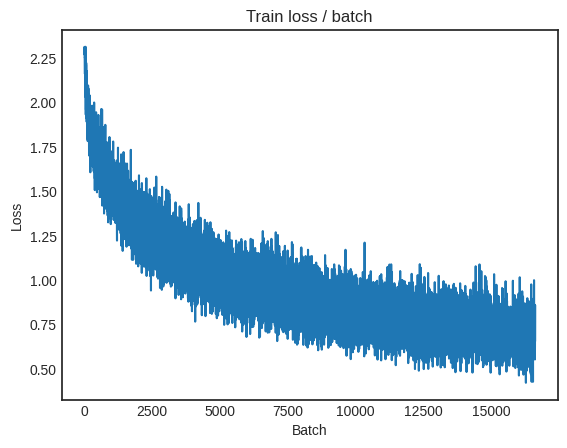


===============> Total time 37s	Avg loss 0.6923	Avg Prec@1 75.67 %	Avg Prec@5 98.50 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 0.7458 (0.7458)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8113	Avg Prec@1 72.29 %	Avg Prec@5 97.85 %



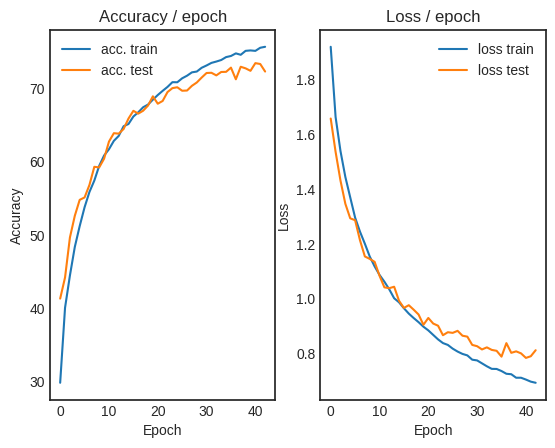

 86%|████████▌ | 43/50 [29:22<04:45, 40.82s/it]

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.385s (0.385s)	Loss 0.6140 (0.6140)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)


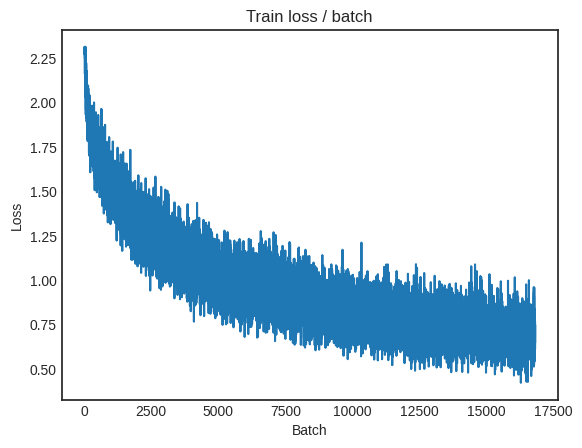

[TRAIN Batch 200/391]	Time 0.165s (0.101s)	Loss 0.6680 (0.6865)	Prec@1  75.8 ( 75.6)	Prec@5  99.2 ( 98.5)


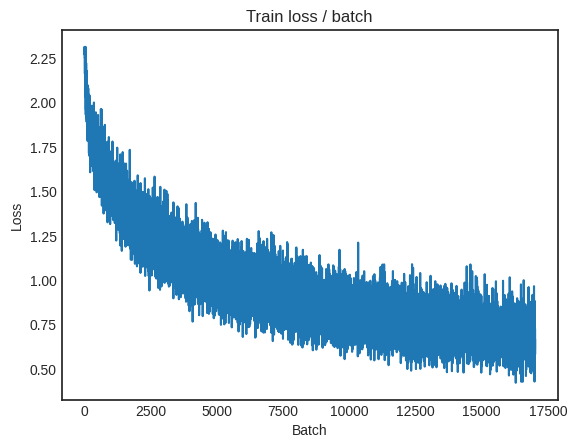


===============> Total time 37s	Avg loss 0.6896	Avg Prec@1 75.70 %	Avg Prec@5 98.48 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 0.7691 (0.7691)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7849	Avg Prec@1 73.52 %	Avg Prec@5 97.89 %



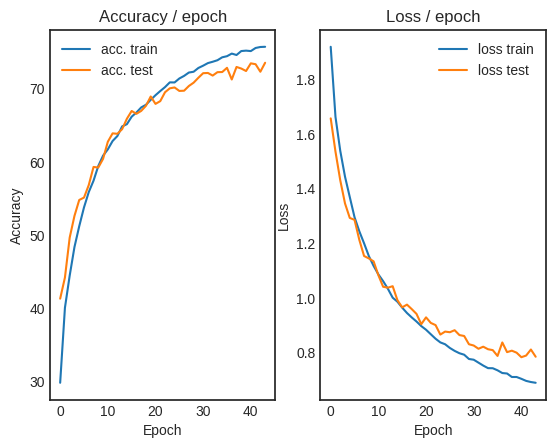

 88%|████████▊ | 44/50 [30:04<04:06, 41.15s/it]

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.328s (0.328s)	Loss 0.7134 (0.7134)	Prec@1  77.3 ( 77.3)	Prec@5  94.5 ( 94.5)


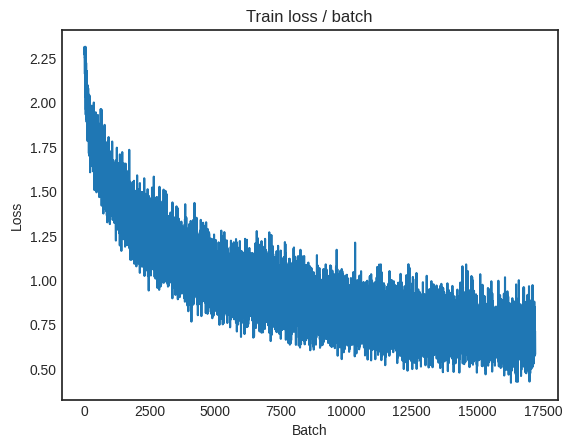

[TRAIN Batch 200/391]	Time 0.019s (0.097s)	Loss 0.7655 (0.6897)	Prec@1  71.1 ( 75.8)	Prec@5  99.2 ( 98.4)


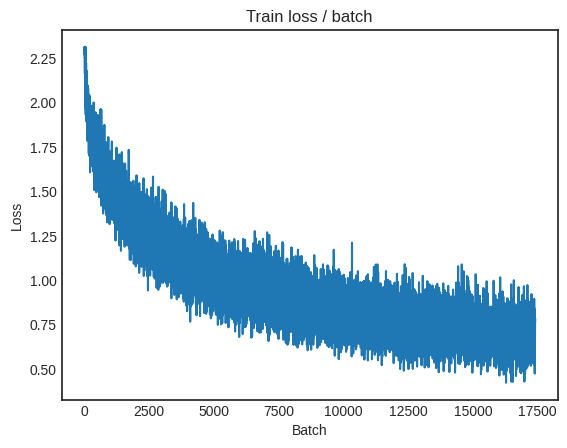


===============> Total time 38s	Avg loss 0.6879	Avg Prec@1 75.85 %	Avg Prec@5 98.42 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 0.7470 (0.7470)	Prec@1  72.7 ( 72.7)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7915	Avg Prec@1 73.26 %	Avg Prec@5 97.77 %



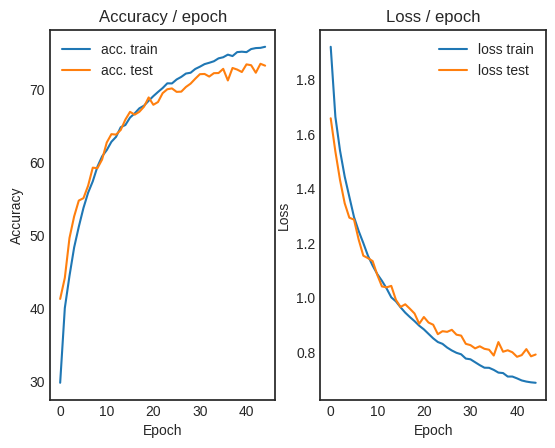

 90%|█████████ | 45/50 [30:45<03:26, 41.23s/it]

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.394s (0.394s)	Loss 0.6554 (0.6554)	Prec@1  74.2 ( 74.2)	Prec@5 100.0 (100.0)


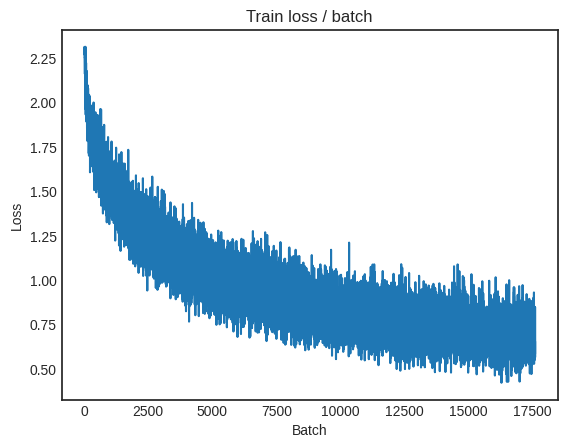

[TRAIN Batch 200/391]	Time 0.252s (0.097s)	Loss 0.6652 (0.6793)	Prec@1  76.6 ( 76.1)	Prec@5  99.2 ( 98.6)


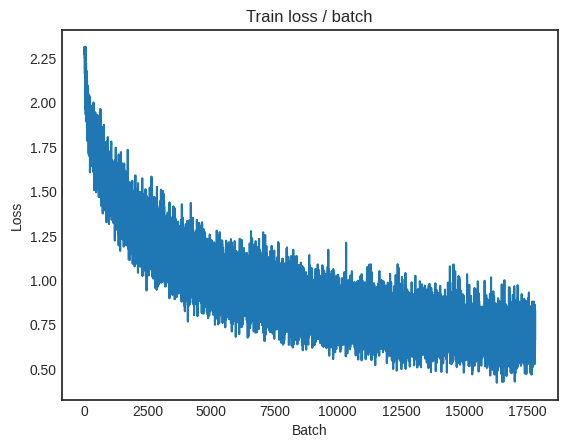


===============> Total time 38s	Avg loss 0.6794	Avg Prec@1 76.23 %	Avg Prec@5 98.50 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 0.7956 (0.7956)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7843	Avg Prec@1 73.41 %	Avg Prec@5 97.98 %



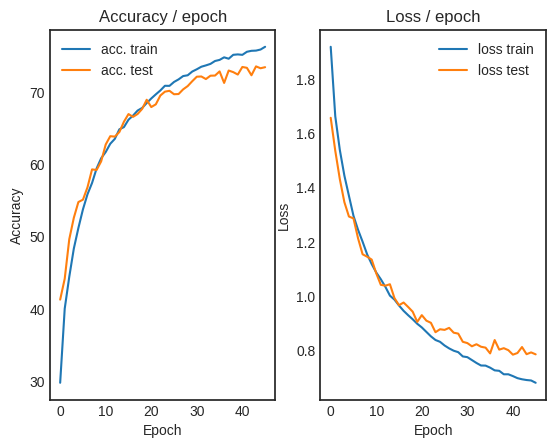

 92%|█████████▏| 46/50 [31:26<02:45, 41.31s/it]

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.411s (0.411s)	Loss 0.6490 (0.6490)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)


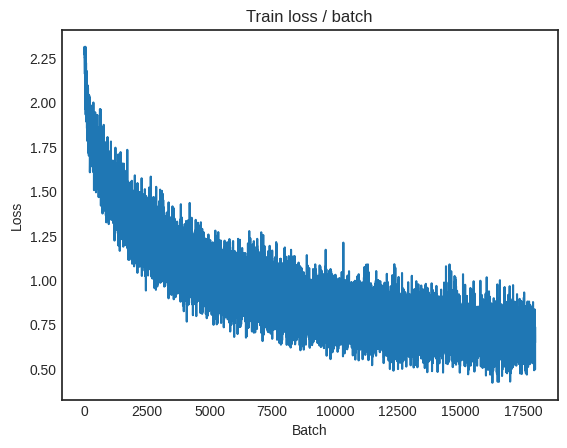

[TRAIN Batch 200/391]	Time 0.172s (0.102s)	Loss 0.6972 (0.6690)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 98.6)


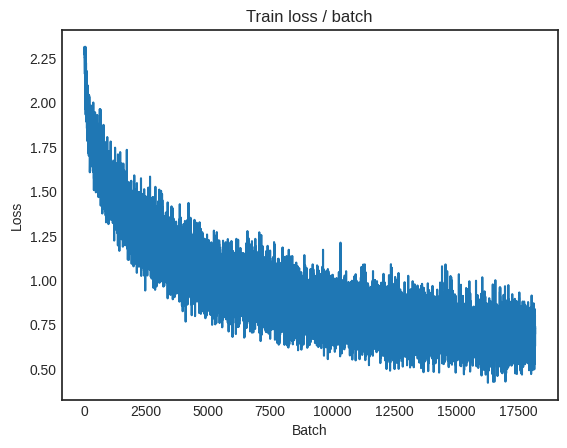


===============> Total time 38s	Avg loss 0.6753	Avg Prec@1 76.31 %	Avg Prec@5 98.56 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 0.7679 (0.7679)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7744	Avg Prec@1 73.89 %	Avg Prec@5 98.00 %



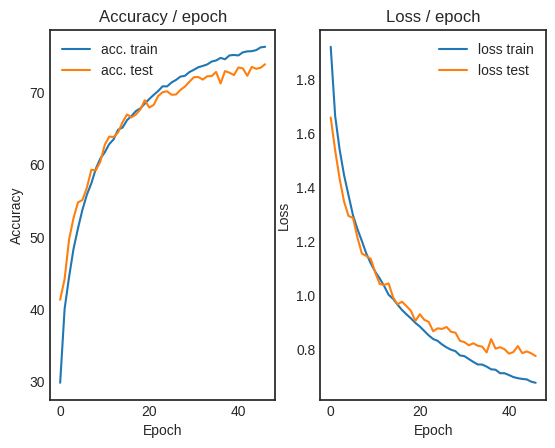

 94%|█████████▍| 47/50 [32:08<02:03, 41.24s/it]

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.483s (0.483s)	Loss 0.7026 (0.7026)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)


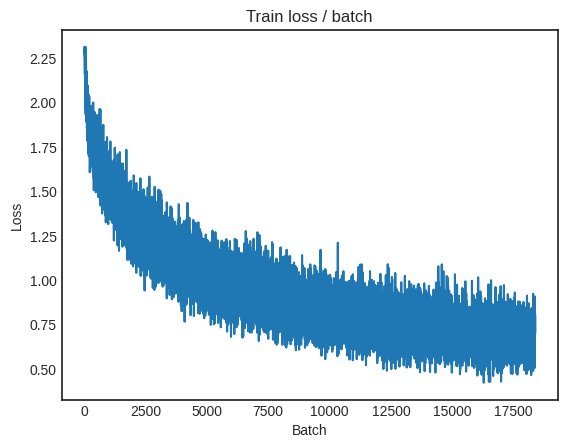

[TRAIN Batch 200/391]	Time 0.008s (0.108s)	Loss 0.5877 (0.6734)	Prec@1  78.9 ( 76.3)	Prec@5  98.4 ( 98.5)


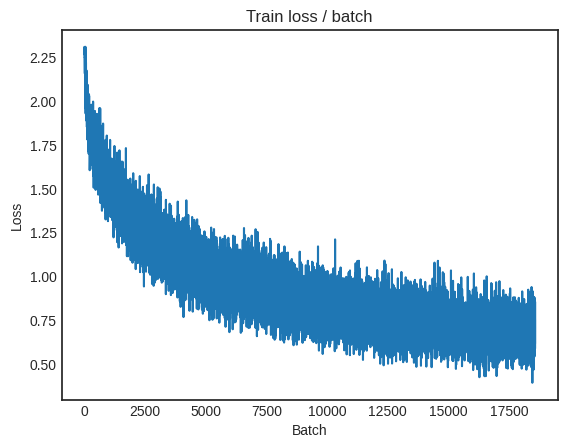


===============> Total time 41s	Avg loss 0.6694	Avg Prec@1 76.42 %	Avg Prec@5 98.49 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 0.7898 (0.7898)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7711	Avg Prec@1 74.06 %	Avg Prec@5 98.01 %



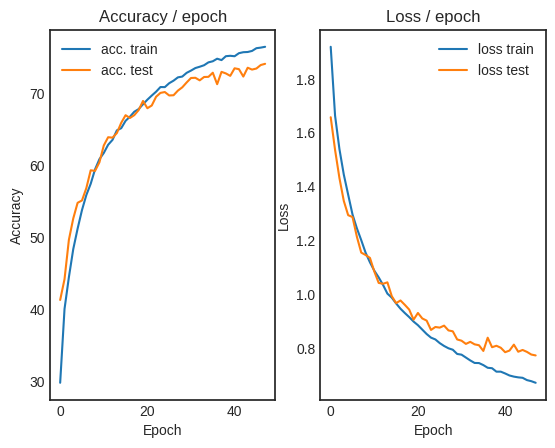

 96%|█████████▌| 48/50 [32:52<01:24, 42.09s/it]

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.438s (0.438s)	Loss 0.4325 (0.4325)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


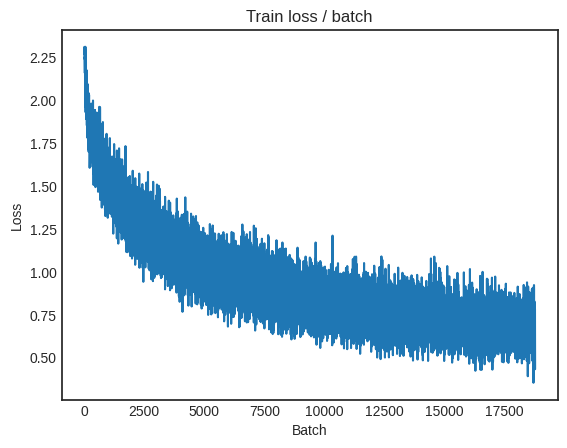

[TRAIN Batch 200/391]	Time 0.148s (0.095s)	Loss 0.6389 (0.6632)	Prec@1  77.3 ( 76.9)	Prec@5  99.2 ( 98.5)


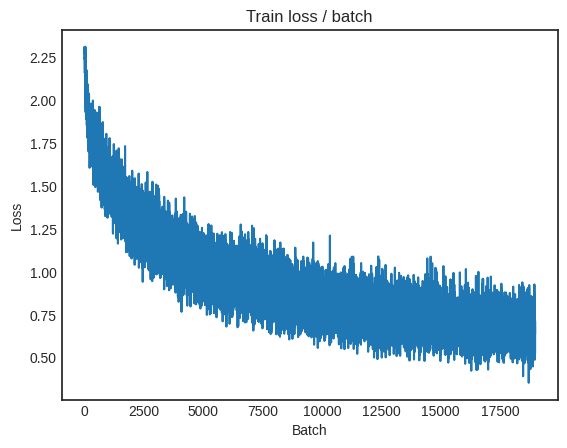


===============> Total time 37s	Avg loss 0.6653	Avg Prec@1 76.88 %	Avg Prec@5 98.54 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 0.8096 (0.8096)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7720	Avg Prec@1 73.59 %	Avg Prec@5 98.18 %



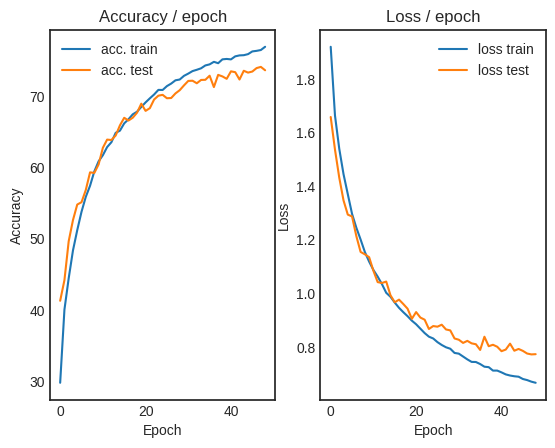

 98%|█████████▊| 49/50 [33:33<00:41, 41.73s/it]

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.383s (0.383s)	Loss 0.6708 (0.6708)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)


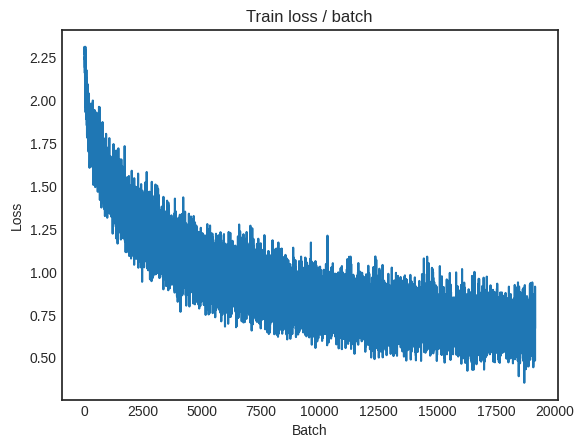

[TRAIN Batch 200/391]	Time 0.143s (0.100s)	Loss 0.6446 (0.6628)	Prec@1  78.9 ( 76.9)	Prec@5 100.0 ( 98.6)


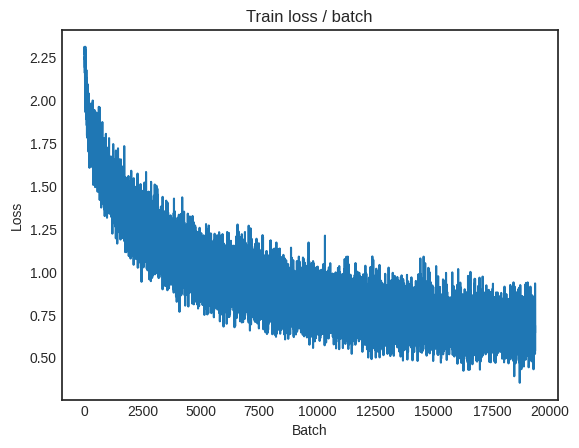


===============> Total time 37s	Avg loss 0.6607	Avg Prec@1 76.90 %	Avg Prec@5 98.54 %

[EVAL Batch 000/079]	Time 0.226s (0.226s)	Loss 0.8064 (0.8064)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7870	Avg Prec@1 73.51 %	Avg Prec@5 97.88 %



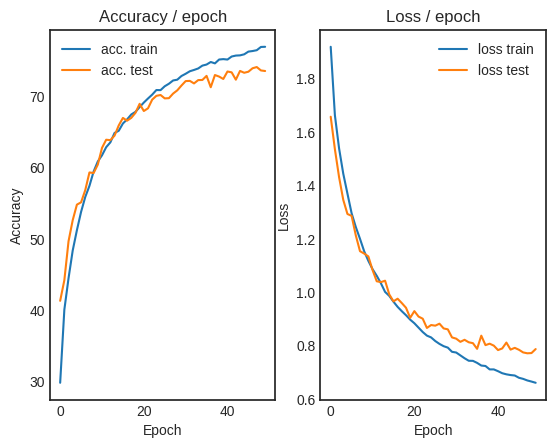

100%|██████████| 50/50 [34:13<00:00, 41.07s/it]


In [48]:
main_CIFAR_3_3(cuda = True)

28. **Bonus** : Many other variants of SGD exist and many learning rate planning strategies exist. Which ones ? Test some of them.

Files already downloaded and verified
Files already downloaded and verified


  0%|          | 0/20 [00:00<?, ?it/s]

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.309s (0.309s)	Loss 2.3038 (2.3038)	Prec@1  10.9 ( 10.9)	Prec@5  49.2 ( 49.2)


<Figure size 640x480 with 0 Axes>

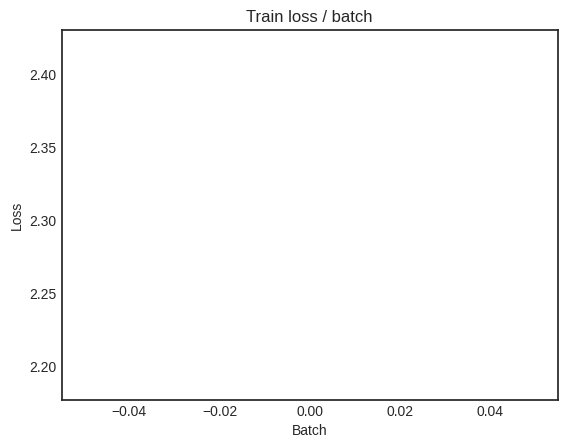

[TRAIN Batch 200/391]	Time 0.068s (0.049s)	Loss 1.5152 (1.9135)	Prec@1  50.0 ( 29.1)	Prec@5  92.2 ( 79.4)


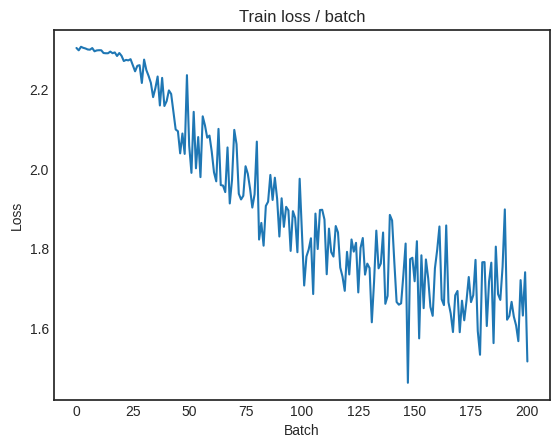


===============> Total time 19s	Avg loss 1.7243	Avg Prec@1 36.63 %	Avg Prec@5 85.15 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 1.4816 (1.4816)	Prec@1  52.3 ( 52.3)	Prec@5  91.4 ( 91.4)

===============> Total time 2s	Avg loss 1.4831	Avg Prec@1 46.11 %	Avg Prec@5 91.98 %



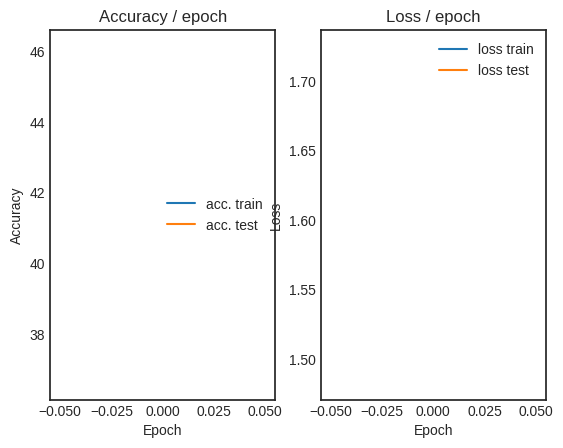

  5%|▌         | 1/20 [00:22<06:59, 22.09s/it]

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.208s (0.208s)	Loss 1.2258 (1.2258)	Prec@1  57.8 ( 57.8)	Prec@5  94.5 ( 94.5)


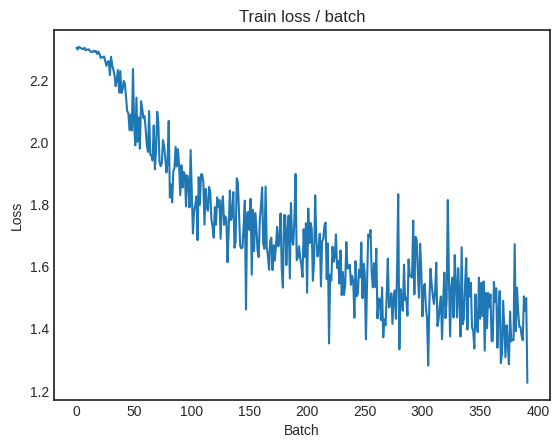

[TRAIN Batch 200/391]	Time 0.029s (0.050s)	Loss 1.1805 (1.3123)	Prec@1  60.9 ( 52.8)	Prec@5  94.5 ( 94.1)


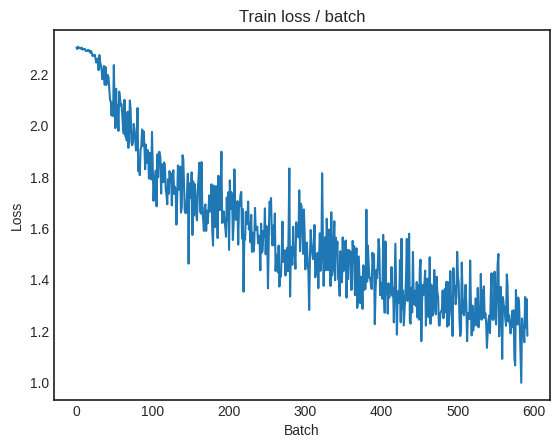


===============> Total time 19s	Avg loss 1.2639	Avg Prec@1 54.70 %	Avg Prec@5 94.57 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 1.0554 (1.0554)	Prec@1  64.1 ( 64.1)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.1420	Avg Prec@1 59.62 %	Avg Prec@5 95.54 %



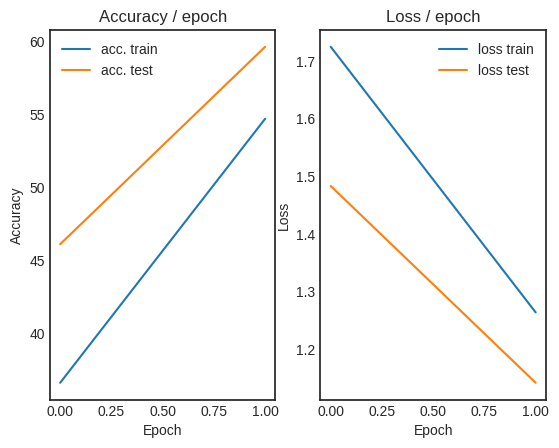

 10%|█         | 2/20 [00:44<06:40, 22.24s/it]

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 1.1554 (1.1554)	Prec@1  57.8 ( 57.8)	Prec@5  93.8 ( 93.8)


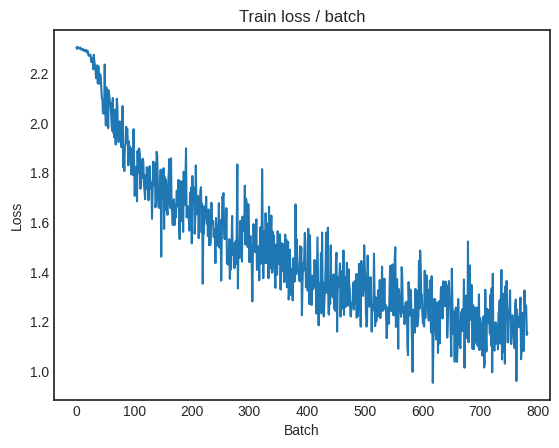

[TRAIN Batch 200/391]	Time 0.077s (0.050s)	Loss 1.0098 (1.0807)	Prec@1  60.9 ( 61.9)	Prec@5  96.9 ( 96.2)


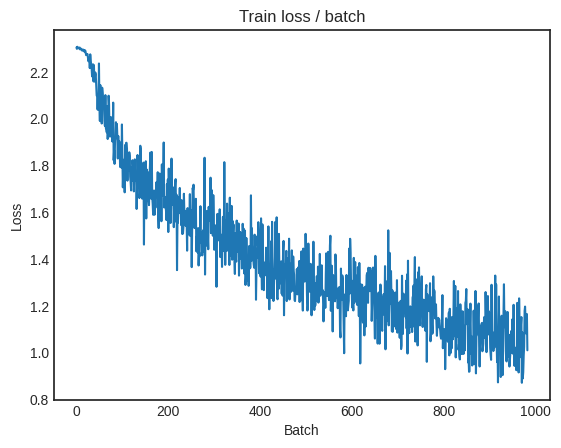


===============> Total time 18s	Avg loss 1.0543	Avg Prec@1 62.67 %	Avg Prec@5 96.33 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.9253 (0.9253)	Prec@1  71.1 ( 71.1)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.9876	Avg Prec@1 65.63 %	Avg Prec@5 96.86 %



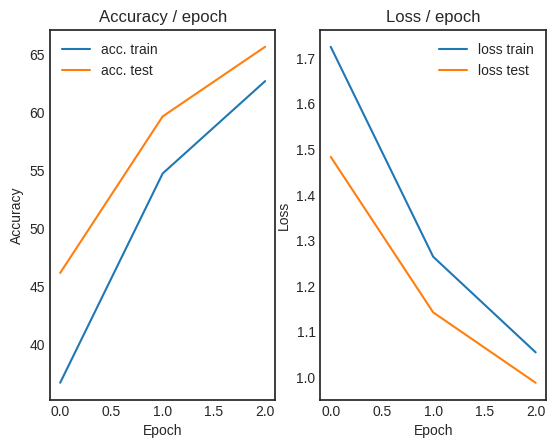

 15%|█▌        | 3/20 [01:06<06:19, 22.32s/it]

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.188s (0.188s)	Loss 1.0997 (1.0997)	Prec@1  57.8 ( 57.8)	Prec@5  95.3 ( 95.3)


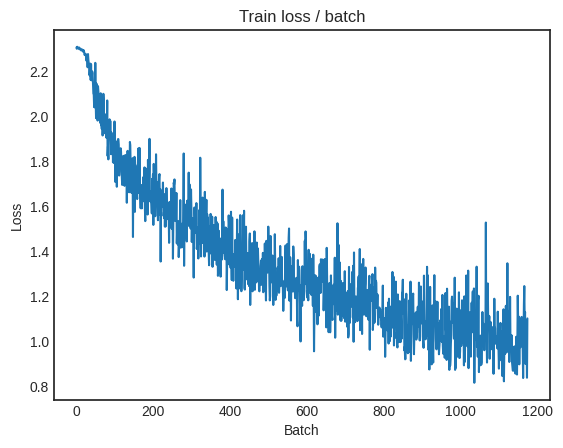

[TRAIN Batch 200/391]	Time 0.055s (0.051s)	Loss 0.9966 (0.9537)	Prec@1  60.9 ( 66.6)	Prec@5  96.1 ( 97.2)


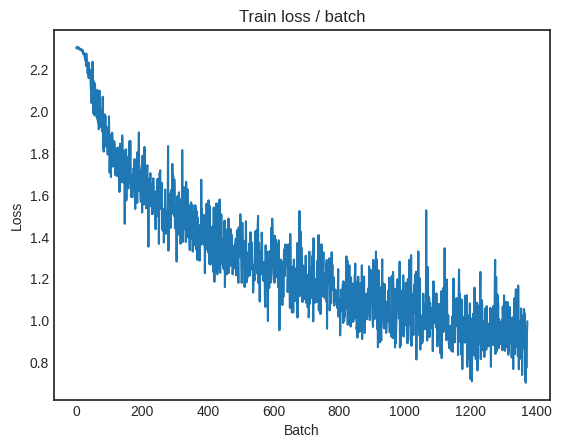


===============> Total time 19s	Avg loss 0.9225	Avg Prec@1 67.69 %	Avg Prec@5 97.31 %

[EVAL Batch 000/079]	Time 0.170s (0.170s)	Loss 0.9412 (0.9412)	Prec@1  64.8 ( 64.8)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.9378	Avg Prec@1 67.00 %	Avg Prec@5 97.07 %



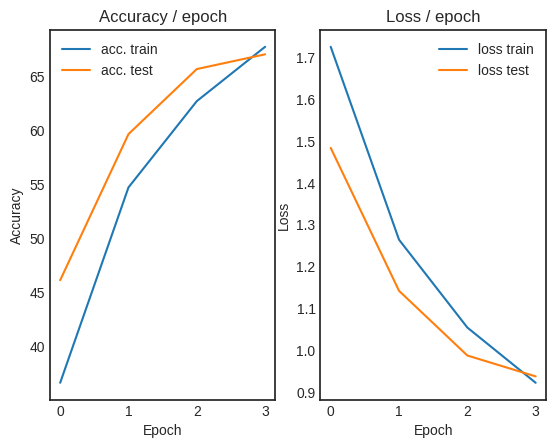

 20%|██        | 4/20 [01:29<05:57, 22.37s/it]

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.309s (0.309s)	Loss 0.9592 (0.9592)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)


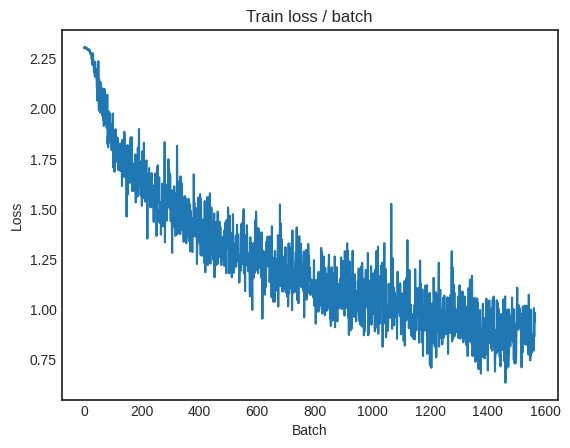

[TRAIN Batch 200/391]	Time 0.020s (0.049s)	Loss 0.8720 (0.8360)	Prec@1  68.8 ( 70.9)	Prec@5  97.7 ( 97.9)


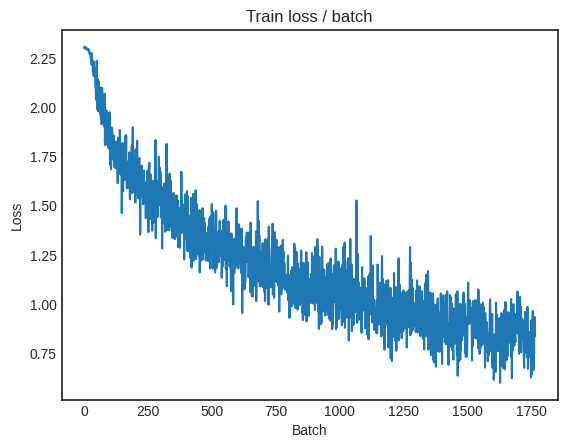


===============> Total time 19s	Avg loss 0.8305	Avg Prec@1 71.04 %	Avg Prec@5 97.77 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.8965 (0.8965)	Prec@1  67.2 ( 67.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8573	Avg Prec@1 70.09 %	Avg Prec@5 97.50 %



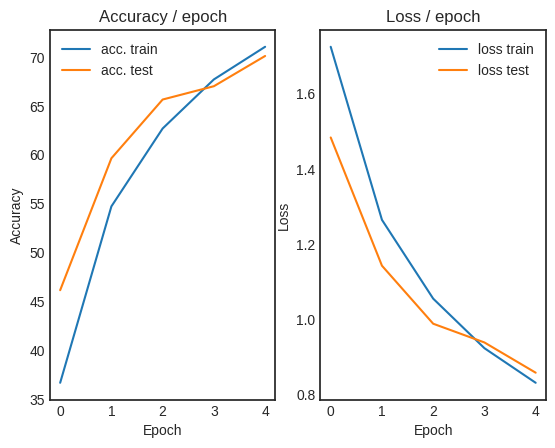

 25%|██▌       | 5/20 [01:51<05:35, 22.34s/it]

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.210s (0.210s)	Loss 0.8148 (0.8148)	Prec@1  70.3 ( 70.3)	Prec@5  99.2 ( 99.2)


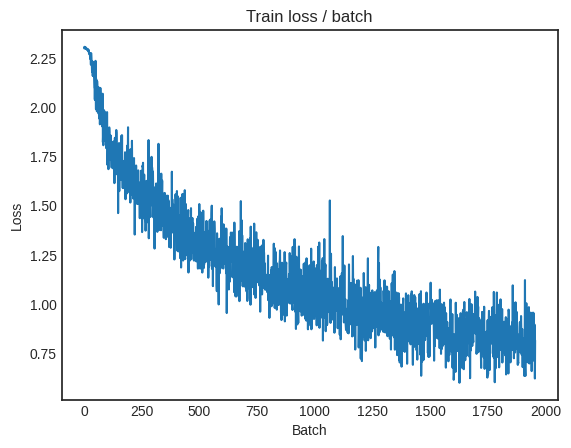

[TRAIN Batch 200/391]	Time 0.014s (0.051s)	Loss 0.6951 (0.7673)	Prec@1  78.1 ( 73.1)	Prec@5  96.9 ( 98.2)


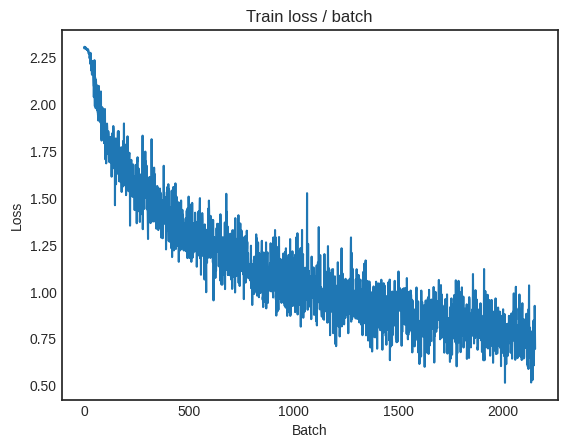


===============> Total time 19s	Avg loss 0.7618	Avg Prec@1 73.43 %	Avg Prec@5 98.17 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.9036 (0.9036)	Prec@1  69.5 ( 69.5)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8483	Avg Prec@1 71.02 %	Avg Prec@5 97.74 %



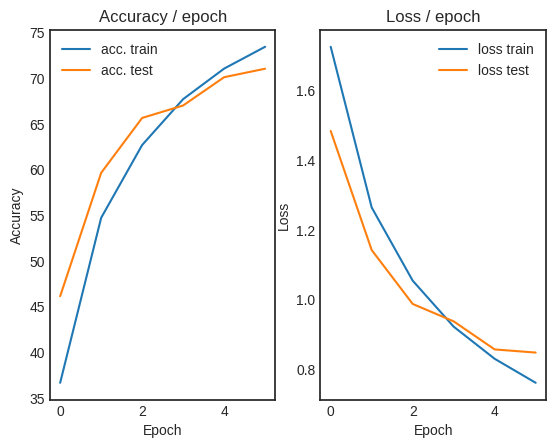

 30%|███       | 6/20 [02:14<05:14, 22.43s/it]

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.208s (0.208s)	Loss 0.7331 (0.7331)	Prec@1  72.7 ( 72.7)	Prec@5  99.2 ( 99.2)


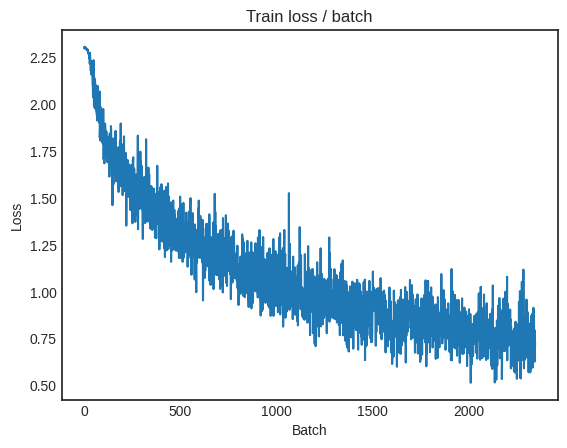

[TRAIN Batch 200/391]	Time 0.067s (0.051s)	Loss 0.6616 (0.7203)	Prec@1  73.4 ( 74.8)	Prec@5 100.0 ( 98.4)


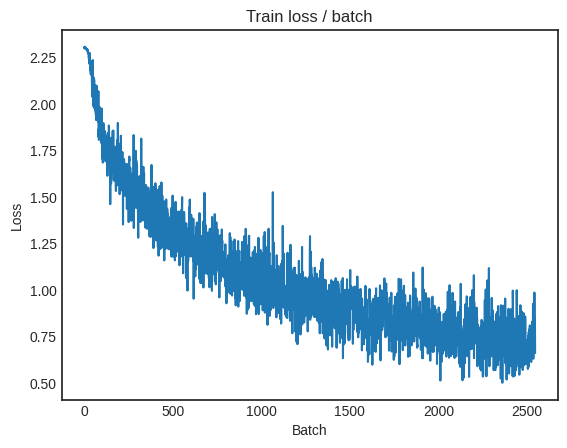


===============> Total time 19s	Avg loss 0.7136	Avg Prec@1 75.09 %	Avg Prec@5 98.41 %

[EVAL Batch 000/079]	Time 0.302s (0.302s)	Loss 0.7344 (0.7344)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7451	Avg Prec@1 74.02 %	Avg Prec@5 98.35 %



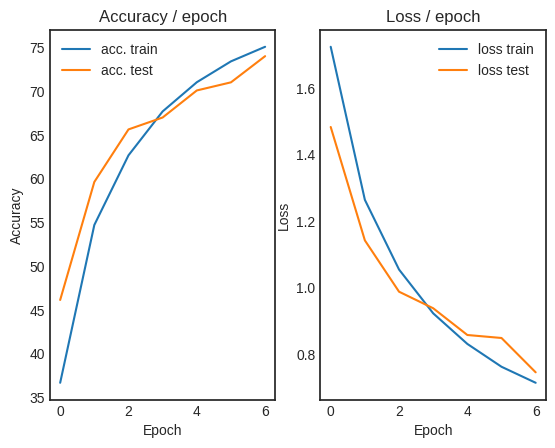

 35%|███▌      | 7/20 [02:36<04:52, 22.51s/it]

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.206s (0.206s)	Loss 0.5610 (0.5610)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)


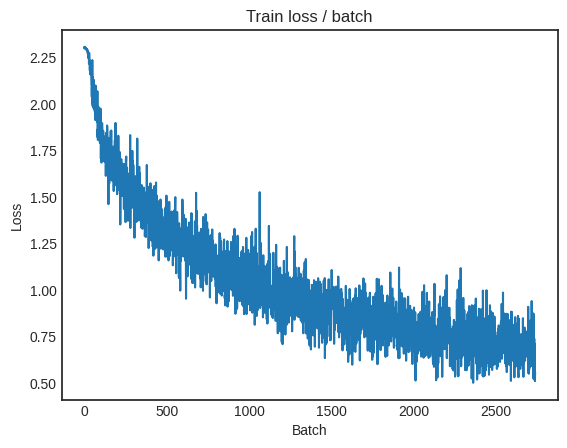

[TRAIN Batch 200/391]	Time 0.085s (0.049s)	Loss 0.6655 (0.6641)	Prec@1  77.3 ( 76.6)	Prec@5  98.4 ( 98.7)


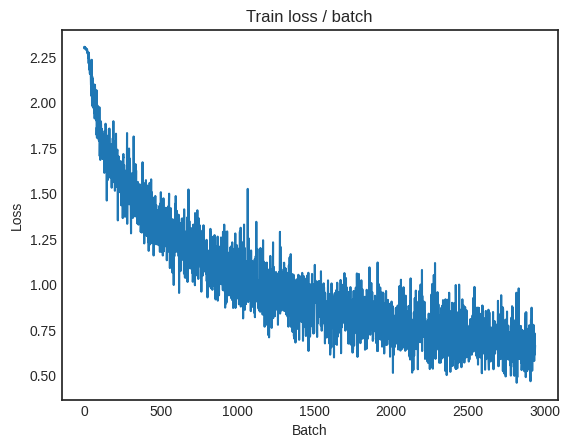


===============> Total time 18s	Avg loss 0.6619	Avg Prec@1 76.84 %	Avg Prec@5 98.66 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.7289 (0.7289)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7212	Avg Prec@1 75.31 %	Avg Prec@5 98.34 %



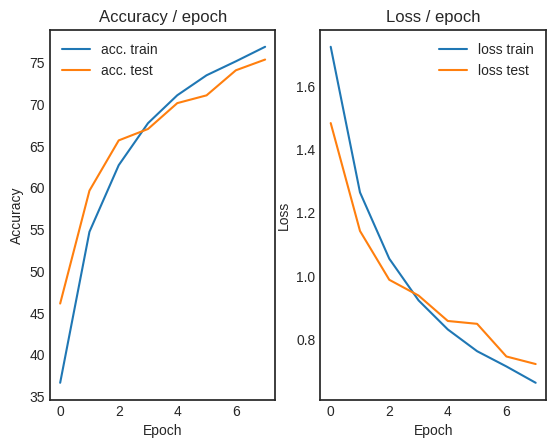

 40%|████      | 8/20 [02:58<04:26, 22.23s/it]

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.313s (0.313s)	Loss 0.5430 (0.5430)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)


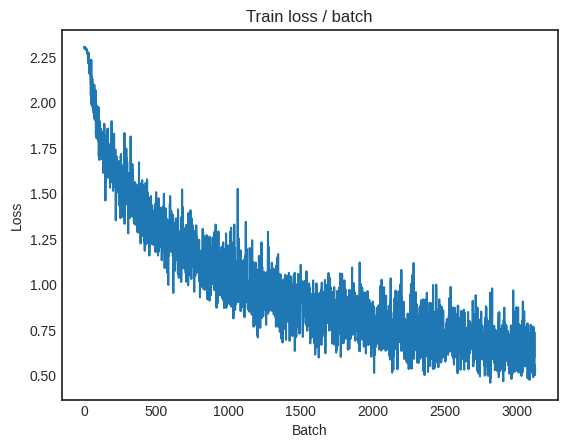

[TRAIN Batch 200/391]	Time 0.020s (0.049s)	Loss 0.6620 (0.6252)	Prec@1  76.6 ( 78.3)	Prec@5 100.0 ( 98.7)


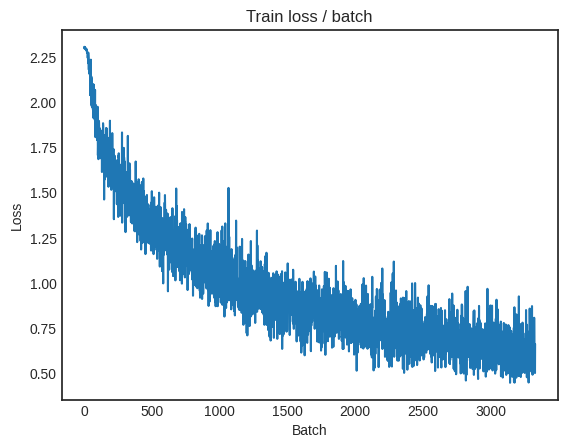


===============> Total time 19s	Avg loss 0.6196	Avg Prec@1 78.44 %	Avg Prec@5 98.69 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.7970 (0.7970)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.6928	Avg Prec@1 76.41 %	Avg Prec@5 98.53 %



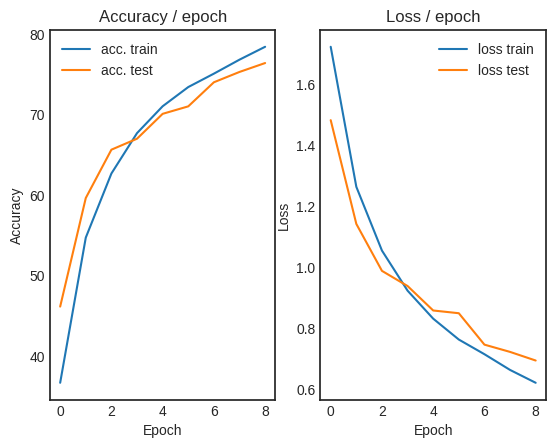

 45%|████▌     | 9/20 [03:20<04:03, 22.13s/it]

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 0.6672 (0.6672)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)


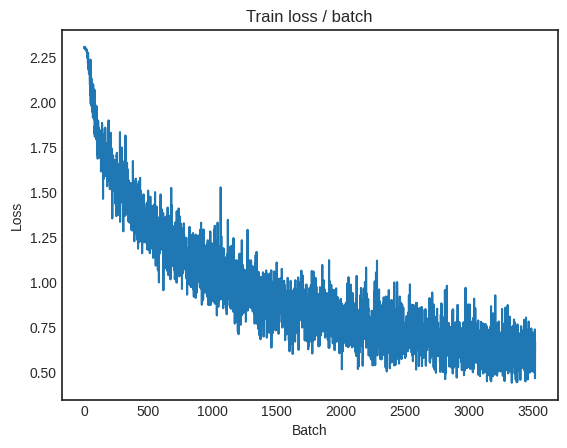

[TRAIN Batch 200/391]	Time 0.085s (0.050s)	Loss 0.6107 (0.5825)	Prec@1  77.3 ( 79.7)	Prec@5  99.2 ( 99.0)


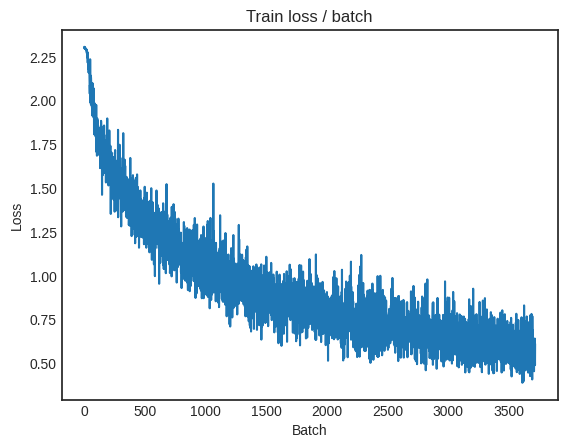


===============> Total time 19s	Avg loss 0.5853	Avg Prec@1 79.54 %	Avg Prec@5 98.95 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.7690 (0.7690)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7332	Avg Prec@1 75.76 %	Avg Prec@5 98.46 %



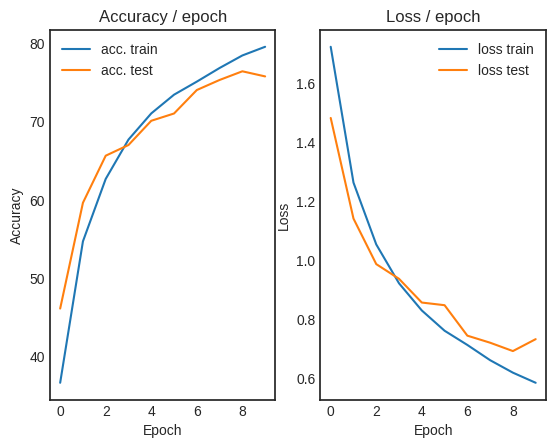

 50%|█████     | 10/20 [03:42<03:41, 22.16s/it]

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.4899 (0.4899)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)


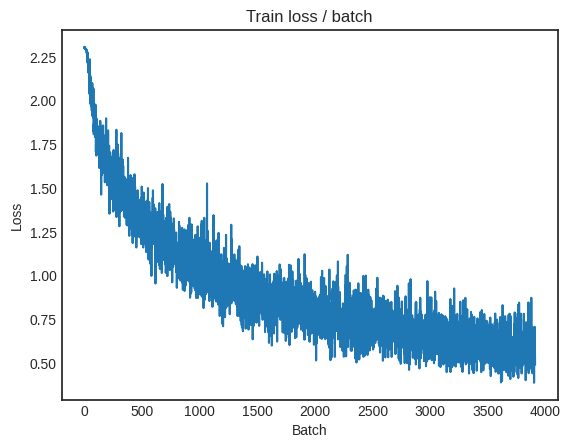

[TRAIN Batch 200/391]	Time 0.008s (0.050s)	Loss 0.4155 (0.5499)	Prec@1  89.1 ( 80.7)	Prec@5  98.4 ( 99.1)


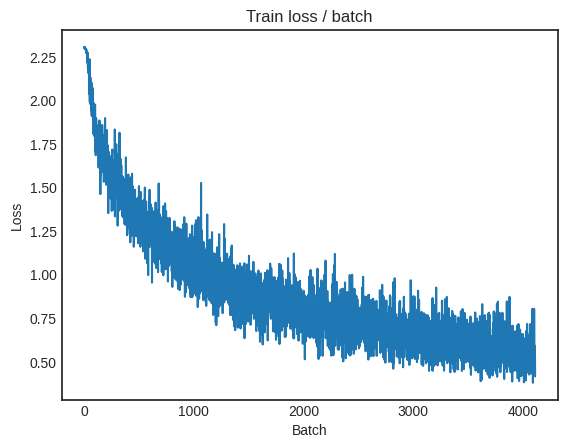


===============> Total time 20s	Avg loss 0.5546	Avg Prec@1 80.55 %	Avg Prec@5 99.06 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 0.7123 (0.7123)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6730	Avg Prec@1 76.98 %	Avg Prec@5 98.69 %



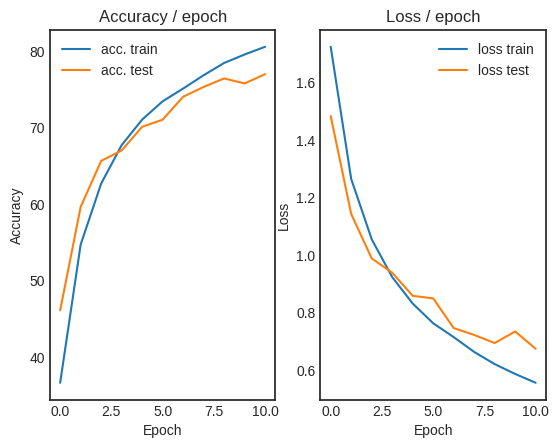

 55%|█████▌    | 11/20 [04:06<03:23, 22.59s/it]

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 0.6755 (0.6755)	Prec@1  75.8 ( 75.8)	Prec@5 100.0 (100.0)


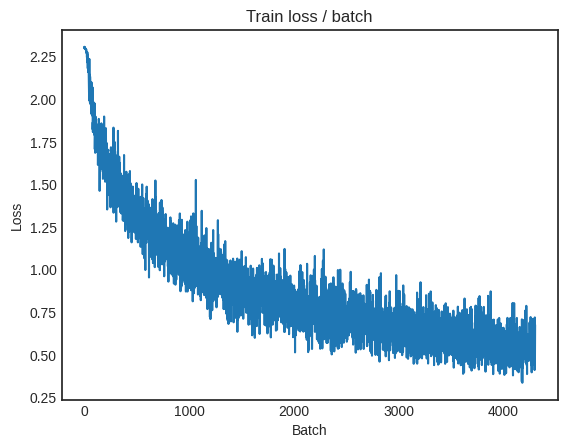

[TRAIN Batch 200/391]	Time 0.011s (0.047s)	Loss 0.5348 (0.5208)	Prec@1  81.2 ( 82.0)	Prec@5  99.2 ( 99.1)


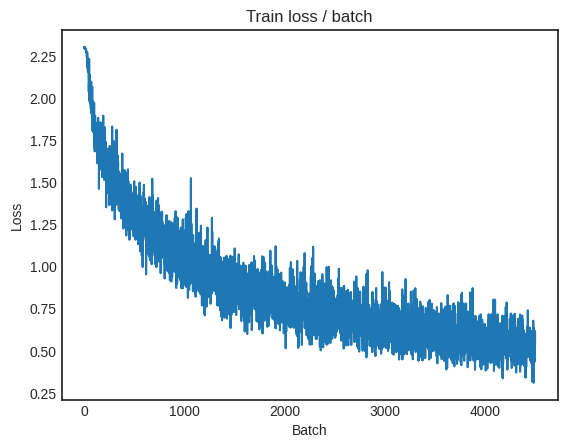


===============> Total time 18s	Avg loss 0.5272	Avg Prec@1 81.63 %	Avg Prec@5 99.13 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.6576 (0.6576)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6686	Avg Prec@1 77.41 %	Avg Prec@5 98.78 %



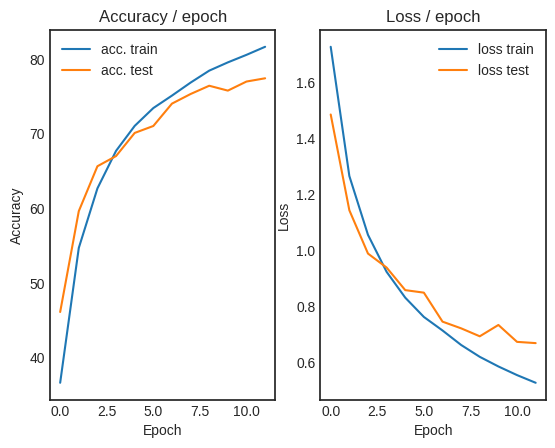

 60%|██████    | 12/20 [04:27<02:57, 22.16s/it]

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.358s (0.358s)	Loss 0.5128 (0.5128)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)


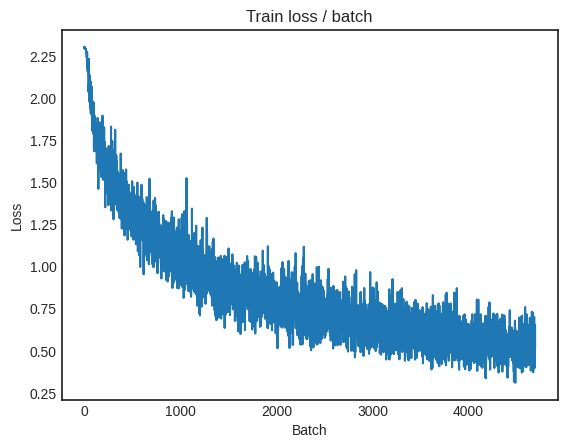

[TRAIN Batch 200/391]	Time 0.014s (0.048s)	Loss 0.5026 (0.4959)	Prec@1  80.5 ( 82.8)	Prec@5  98.4 ( 99.1)


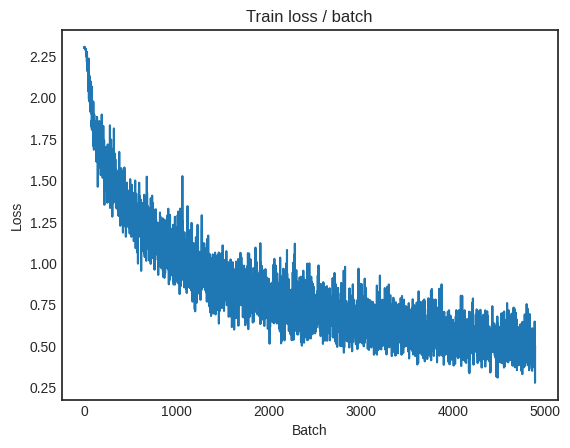


===============> Total time 18s	Avg loss 0.4969	Avg Prec@1 82.85 %	Avg Prec@5 99.17 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.7745 (0.7745)	Prec@1  77.3 ( 77.3)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.6721	Avg Prec@1 77.46 %	Avg Prec@5 98.66 %



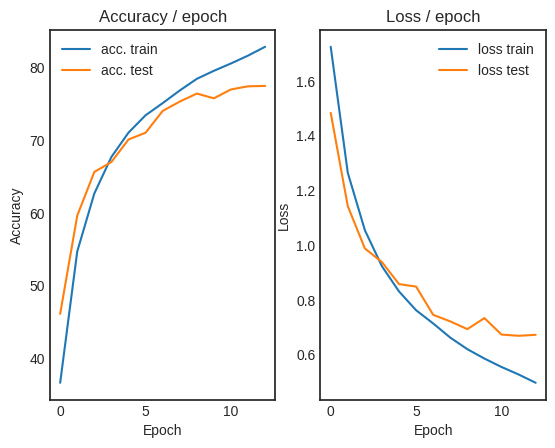

 65%|██████▌   | 13/20 [04:49<02:34, 22.12s/it]

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.4433 (0.4433)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


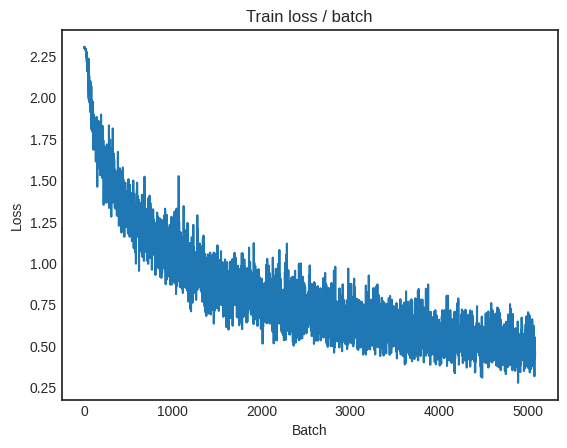

[TRAIN Batch 200/391]	Time 0.071s (0.051s)	Loss 0.4784 (0.4738)	Prec@1  80.5 ( 83.4)	Prec@5  99.2 ( 99.2)


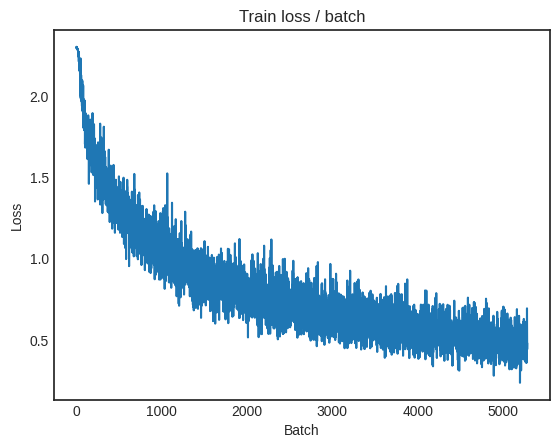


===============> Total time 19s	Avg loss 0.4767	Avg Prec@1 83.31 %	Avg Prec@5 99.28 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 0.8267 (0.8267)	Prec@1  76.6 ( 76.6)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.6627	Avg Prec@1 77.69 %	Avg Prec@5 98.71 %



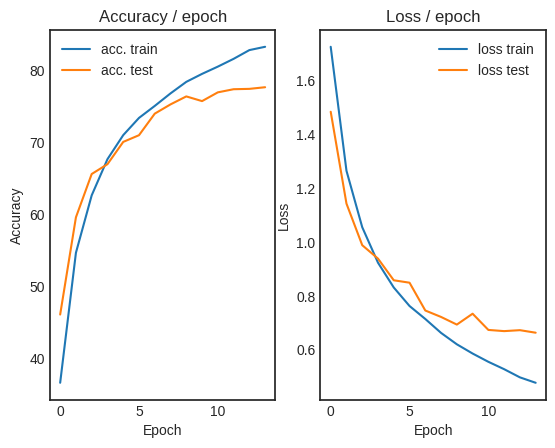

 70%|███████   | 14/20 [05:12<02:13, 22.27s/it]

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.239s (0.239s)	Loss 0.3191 (0.3191)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


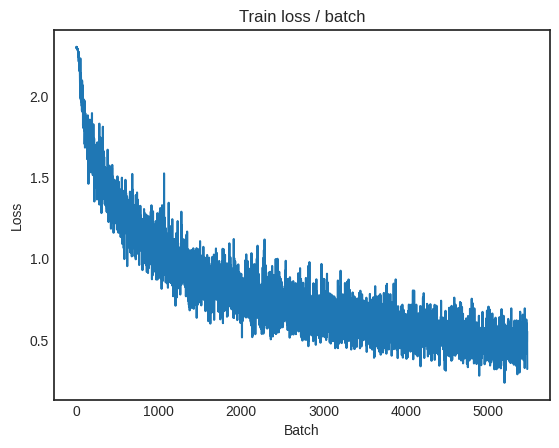

[TRAIN Batch 200/391]	Time 0.080s (0.051s)	Loss 0.4992 (0.4439)	Prec@1  82.8 ( 84.4)	Prec@5 100.0 ( 99.4)


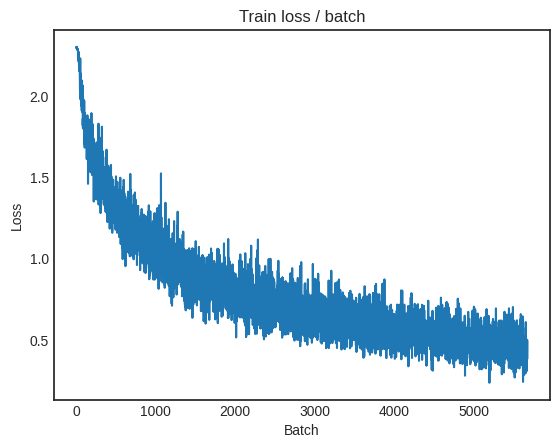


===============> Total time 18s	Avg loss 0.4511	Avg Prec@1 84.24 %	Avg Prec@5 99.33 %

[EVAL Batch 000/079]	Time 0.312s (0.312s)	Loss 0.7841 (0.7841)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6194	Avg Prec@1 78.77 %	Avg Prec@5 98.83 %



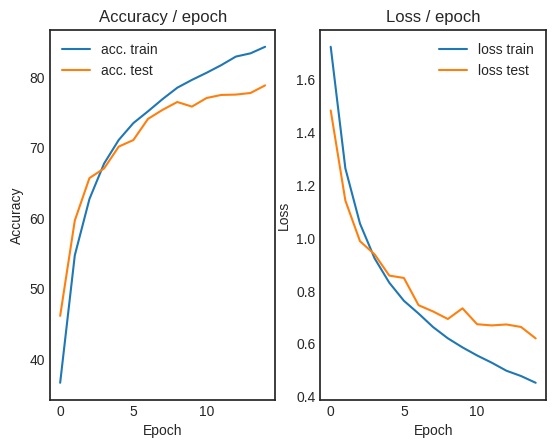

 75%|███████▌  | 15/20 [05:34<01:51, 22.33s/it]

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.227s (0.227s)	Loss 0.2641 (0.2641)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


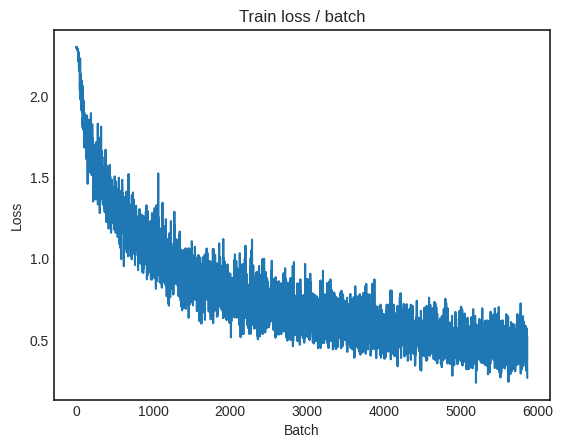

[TRAIN Batch 200/391]	Time 0.017s (0.047s)	Loss 0.5190 (0.4232)	Prec@1  85.2 ( 85.4)	Prec@5  99.2 ( 99.4)


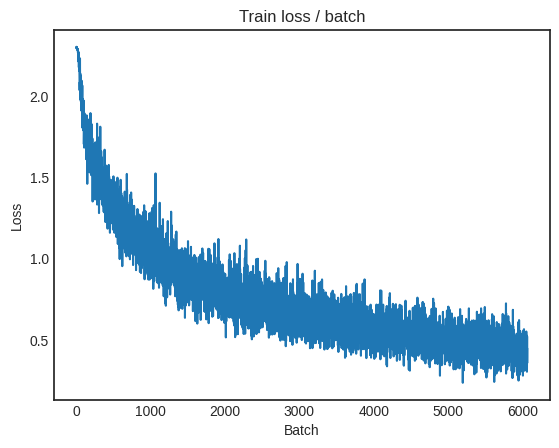


===============> Total time 18s	Avg loss 0.4335	Avg Prec@1 84.95 %	Avg Prec@5 99.40 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 0.6489 (0.6489)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6417	Avg Prec@1 78.60 %	Avg Prec@5 98.73 %



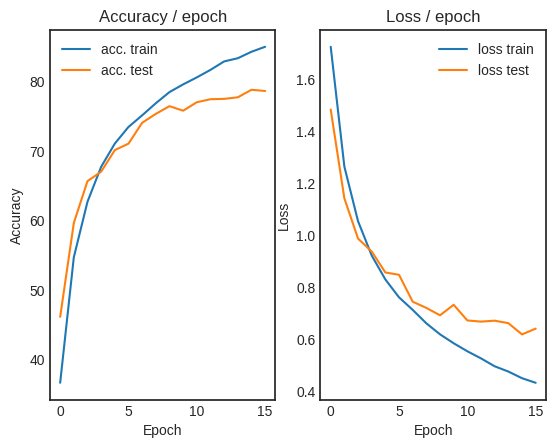

 80%|████████  | 16/20 [05:56<01:28, 22.13s/it]

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.399s (0.399s)	Loss 0.3525 (0.3525)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


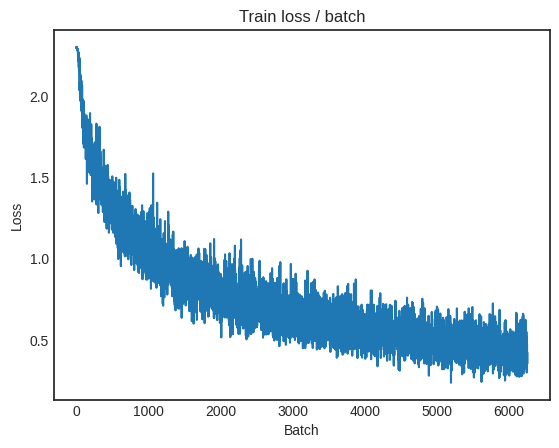

[TRAIN Batch 200/391]	Time 0.061s (0.049s)	Loss 0.4187 (0.4062)	Prec@1  83.6 ( 85.9)	Prec@5 100.0 ( 99.5)


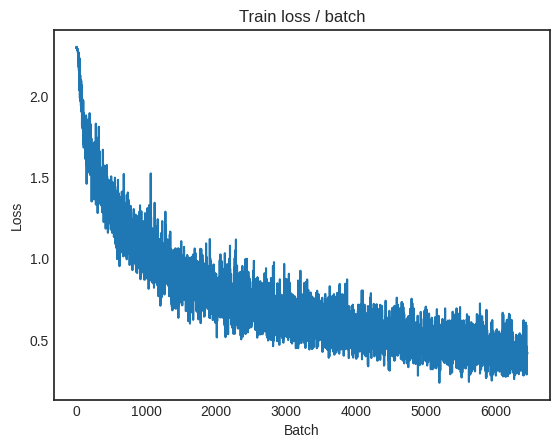


===============> Total time 19s	Avg loss 0.4080	Avg Prec@1 85.83 %	Avg Prec@5 99.50 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.7381 (0.7381)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6290	Avg Prec@1 79.21 %	Avg Prec@5 98.92 %



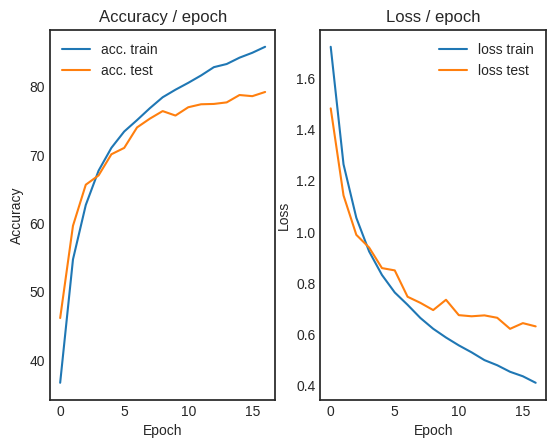

 85%|████████▌ | 17/20 [06:18<01:06, 22.19s/it]

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.291s (0.291s)	Loss 0.3467 (0.3467)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


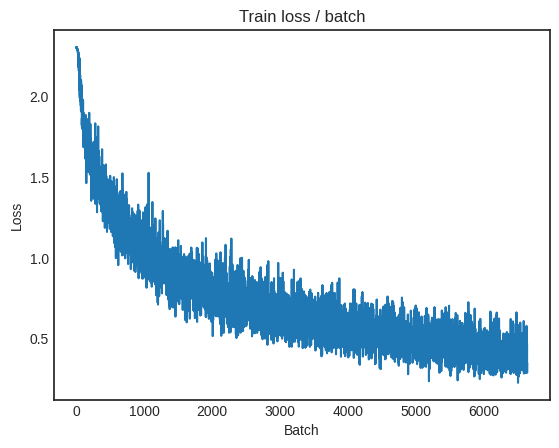

[TRAIN Batch 200/391]	Time 0.057s (0.051s)	Loss 0.5104 (0.3910)	Prec@1  84.4 ( 86.1)	Prec@5  98.4 ( 99.6)


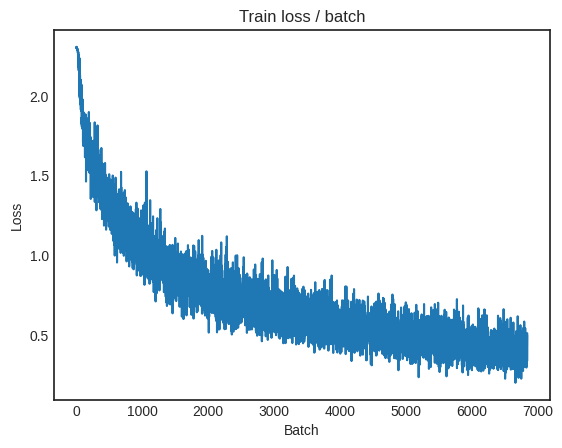


===============> Total time 19s	Avg loss 0.3929	Avg Prec@1 86.27 %	Avg Prec@5 99.55 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.7463 (0.7463)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6223	Avg Prec@1 78.92 %	Avg Prec@5 98.91 %



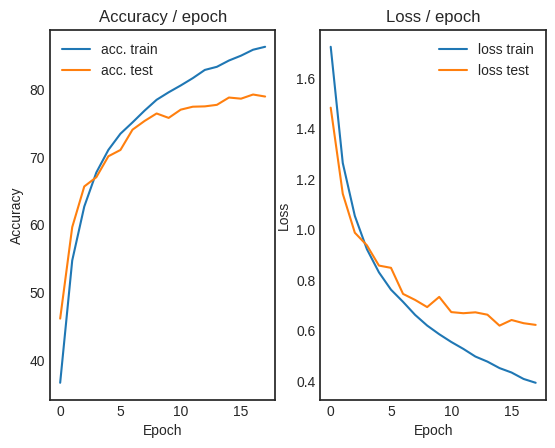

 90%|█████████ | 18/20 [06:40<00:44, 22.26s/it]

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.252s (0.252s)	Loss 0.4010 (0.4010)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


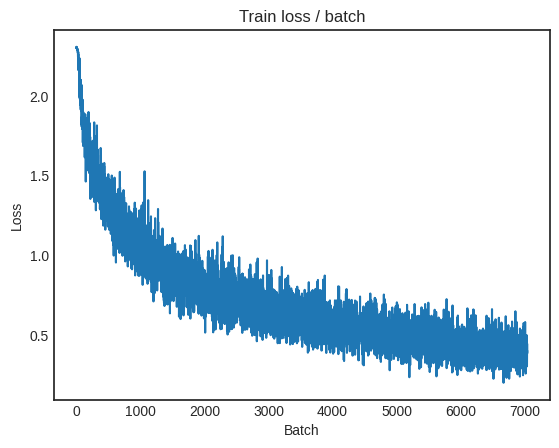

[TRAIN Batch 200/391]	Time 0.014s (0.051s)	Loss 0.2777 (0.3616)	Prec@1  92.2 ( 87.6)	Prec@5 100.0 ( 99.6)


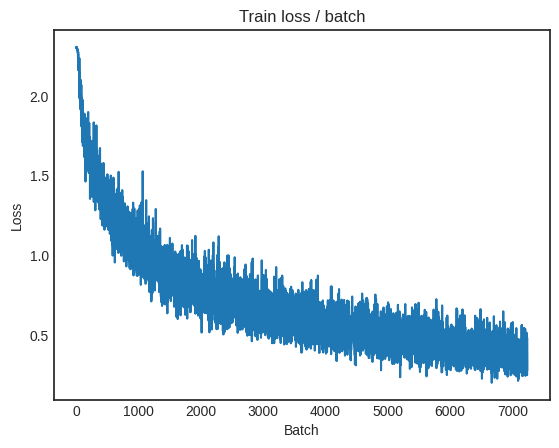


===============> Total time 19s	Avg loss 0.3719	Avg Prec@1 87.10 %	Avg Prec@5 99.61 %

[EVAL Batch 000/079]	Time 0.269s (0.269s)	Loss 0.7492 (0.7492)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6231	Avg Prec@1 78.99 %	Avg Prec@5 98.74 %



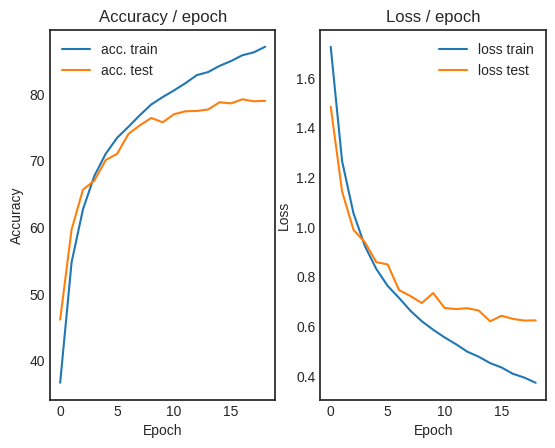

 95%|█████████▌| 19/20 [07:03<00:22, 22.39s/it]

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.247s (0.247s)	Loss 0.2933 (0.2933)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


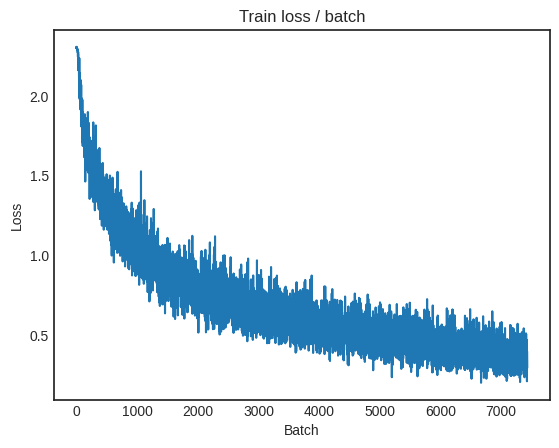

[TRAIN Batch 200/391]	Time 0.017s (0.051s)	Loss 0.2773 (0.3461)	Prec@1  87.5 ( 88.0)	Prec@5 100.0 ( 99.7)


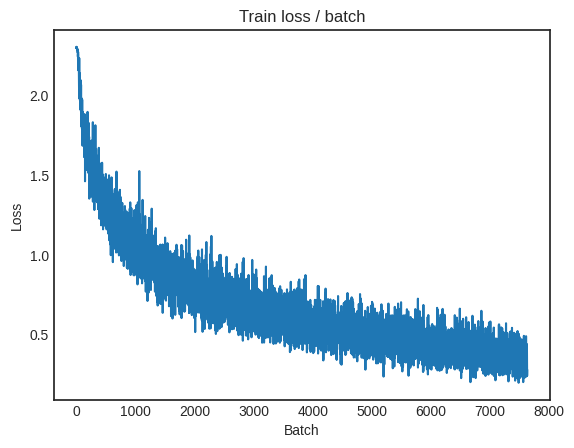


===============> Total time 18s	Avg loss 0.3547	Avg Prec@1 87.68 %	Avg Prec@5 99.67 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.7893 (0.7893)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6428	Avg Prec@1 79.43 %	Avg Prec@5 98.93 %



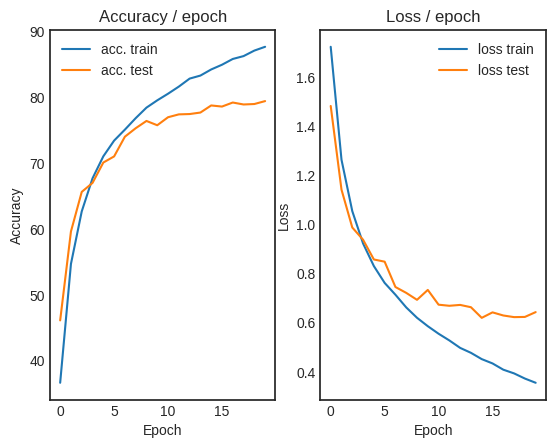

100%|██████████| 20/20 [07:25<00:00, 22.30s/it]


In [49]:
import argparse
import os
import time

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim
import torch.utils.data
import torchvision.transforms as transforms
import torchvision.datasets as datasets

PRINT_INTERVAL = 200
PATH="datasets"

# styling and helper packages
from tqdm import tqdm
import matplotlib as mpl

"""## 3.3 Variants of the optimization algorithm"""


def get_dataset_CIFAR(batch_size, cuda=True):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """

    # image mean and std for CIFAR10
    mean_CIFAR = (0.491, 0.482, 0.447)
    sig_CIFAR = (0.202, 0.199, 0.201)


    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.RandomCrop(size = 28),
            transforms.RandomHorizontalFlip(p=0.5),
            transforms.Normalize(mean=mean_CIFAR, std=sig_CIFAR),
        ]))


    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=mean_CIFAR, std=sig_CIFAR)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader


# Import the package
from torch.optim import lr_scheduler

def main_CIFAR_3_3(batch_size, lr, epochs, cuda):

    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet2()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr, momentum=0.9)
    # optimizer = torch.optim.Adam(model.parameters(), lr)
    lr_sched = lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset_CIFAR(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in tqdm(range(epochs)):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

        lr_sched.step()

main_CIFAR_3_3(batch_size=128, lr=0.01, epochs=20, cuda=True)


## 3.4 Dropout regularization

In [50]:
class ConvNet2_dropout(nn.Module):

    def __init__(self, channels = 3):
        super(ConvNet2_dropout, self).__init__()

        self.channels = channels # to handle color images
        self.conv1 = 32
        self.conv2 = 64
        self.conv3 = 64
        self.fc4 = 1000
        self.fc5 = 10

        # conv net as feature extractor
        self.features = nn.Sequential(
            nn.Conv2d(self.channels, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),

            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),

            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode = True),
        )

        self.classifier = nn.Sequential(
            nn.Linear(64 * 4 * 4, self.fc4),
            nn.ReLU(),
            nn.Dropout(p = 0.5), #Dropout layer with 0.5 probability
            nn.Linear(self.fc4, self.fc5),

            # Reminder: The softmax is included in the loss, do not put it here
            # nn.Softmax()
        )


    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers


        return output

In [51]:
def main_CIFAR_dropout(batch_size, lr, epochs, cuda):
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet2_dropout()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)
    lr_sched = lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset_CIFAR(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in tqdm(range(epochs)):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

        lr_sched.step()

Files already downloaded and verified
Files already downloaded and verified


  0%|          | 0/20 [00:00<?, ?it/s]

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.245s (0.245s)	Loss 2.3082 (2.3082)	Prec@1   6.2 (  6.2)	Prec@5  41.4 ( 41.4)


<Figure size 640x480 with 0 Axes>

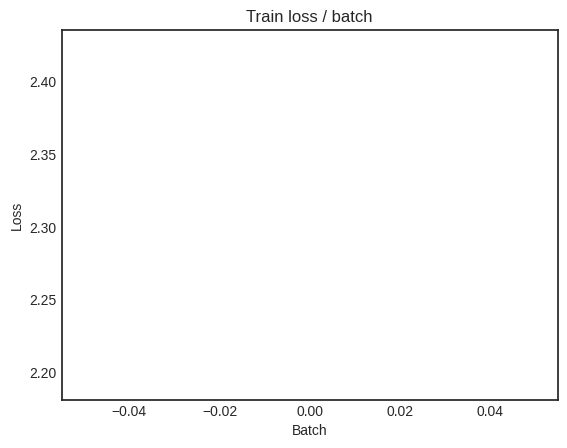

[TRAIN Batch 200/391]	Time 0.014s (0.045s)	Loss 1.7261 (2.0065)	Prec@1  38.3 ( 26.1)	Prec@5  89.1 ( 77.2)


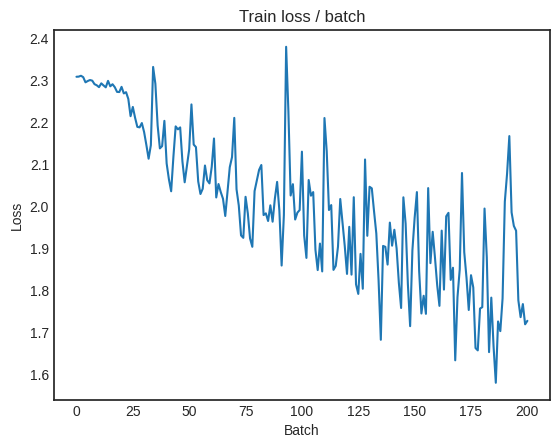


===============> Total time 18s	Avg loss 1.8463	Avg Prec@1 32.43 %	Avg Prec@5 82.69 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 1.5500 (1.5500)	Prec@1  48.4 ( 48.4)	Prec@5  88.3 ( 88.3)

===============> Total time 2s	Avg loss 1.5063	Avg Prec@1 45.92 %	Avg Prec@5 91.43 %



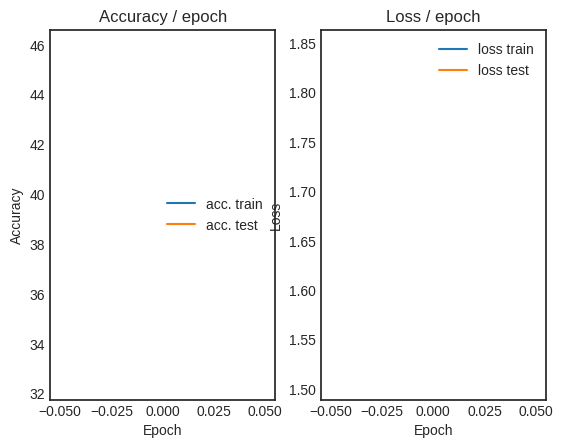

  5%|▌         | 1/20 [00:21<06:50, 21.59s/it]

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 1.5678 (1.5678)	Prec@1  43.8 ( 43.8)	Prec@5  89.8 ( 89.8)


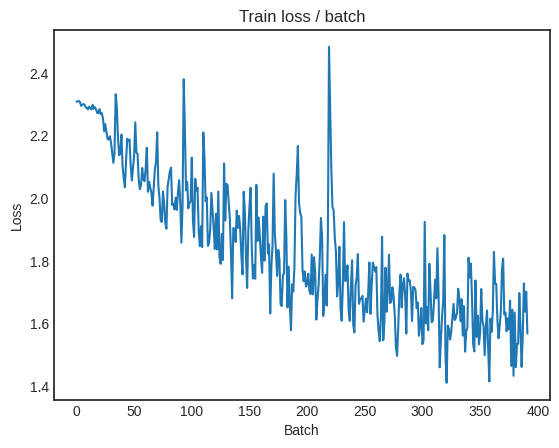

[TRAIN Batch 200/391]	Time 0.068s (0.051s)	Loss 1.5376 (1.4915)	Prec@1  38.3 ( 46.1)	Prec@5  89.8 ( 91.7)


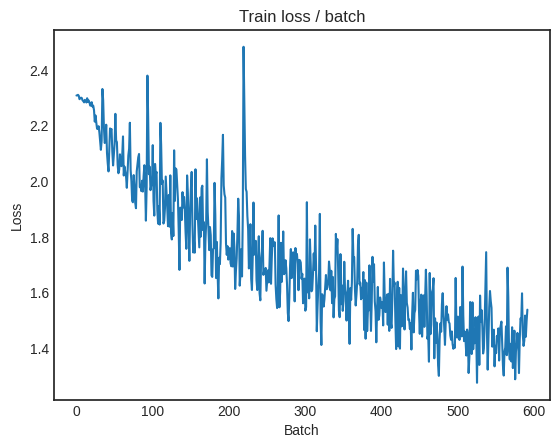


===============> Total time 19s	Avg loss 1.4306	Avg Prec@1 48.56 %	Avg Prec@5 92.46 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 1.3401 (1.3401)	Prec@1  58.6 ( 58.6)	Prec@5  93.0 ( 93.0)

===============> Total time 2s	Avg loss 1.3169	Avg Prec@1 53.44 %	Avg Prec@5 93.81 %



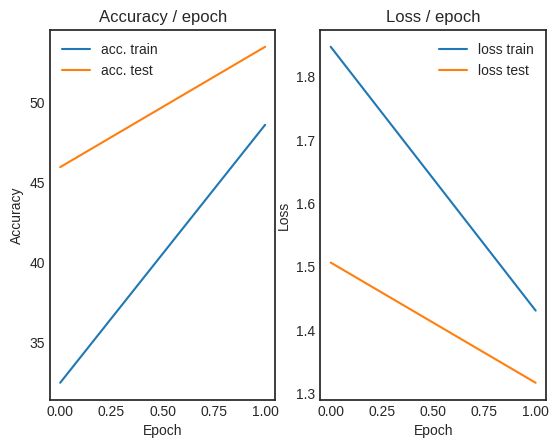

 10%|█         | 2/20 [00:44<06:38, 22.12s/it]

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 1.2387 (1.2387)	Prec@1  56.2 ( 56.2)	Prec@5  93.8 ( 93.8)


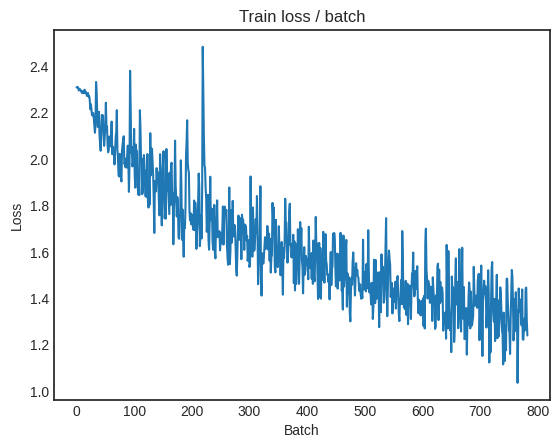

[TRAIN Batch 200/391]	Time 0.062s (0.050s)	Loss 1.1048 (1.2606)	Prec@1  66.4 ( 55.2)	Prec@5  95.3 ( 94.7)


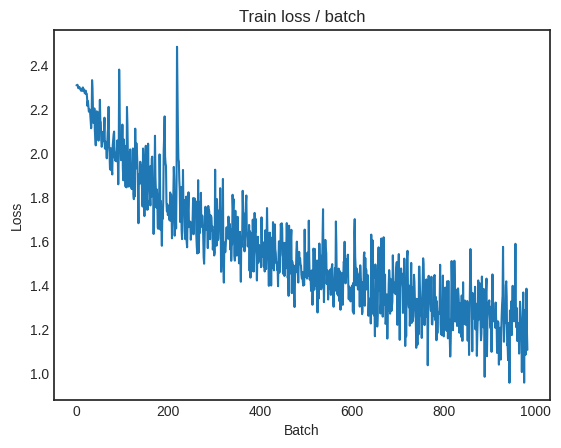


===============> Total time 19s	Avg loss 1.2224	Avg Prec@1 56.66 %	Avg Prec@5 94.94 %

[EVAL Batch 000/079]	Time 0.170s (0.170s)	Loss 1.4143 (1.4143)	Prec@1  50.0 ( 50.0)	Prec@5  89.8 ( 89.8)

===============> Total time 2s	Avg loss 1.3969	Avg Prec@1 50.66 %	Avg Prec@5 92.73 %



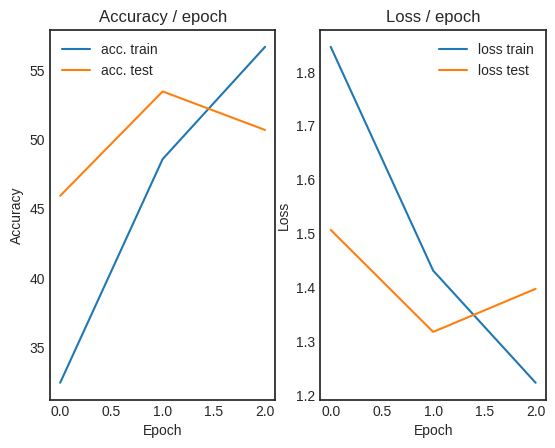

 15%|█▌        | 3/20 [01:06<06:17, 22.18s/it]

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.219s (0.219s)	Loss 1.2704 (1.2704)	Prec@1  54.7 ( 54.7)	Prec@5  95.3 ( 95.3)


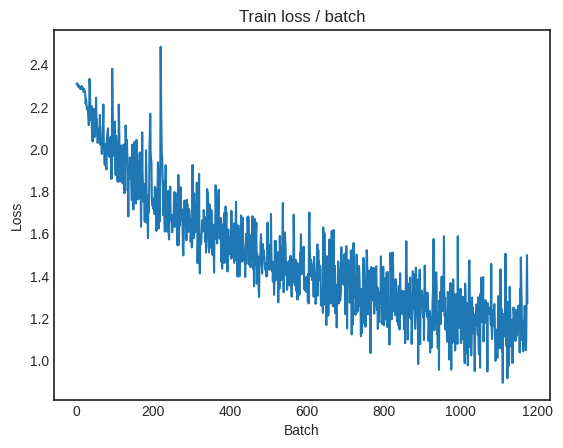

[TRAIN Batch 200/391]	Time 0.008s (0.052s)	Loss 1.0744 (1.0996)	Prec@1  58.6 ( 61.4)	Prec@5  96.1 ( 95.9)


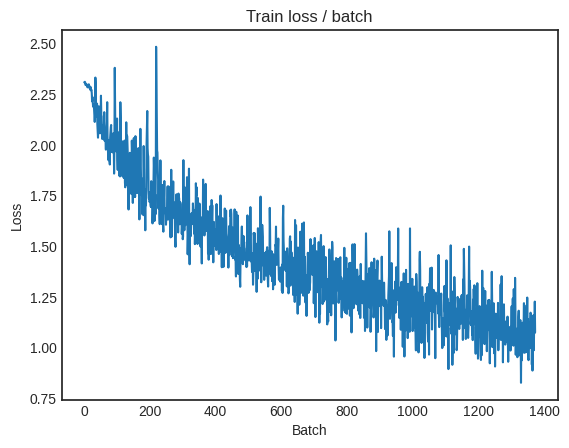


===============> Total time 18s	Avg loss 1.0739	Avg Prec@1 62.42 %	Avg Prec@5 96.15 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 1.0538 (1.0538)	Prec@1  68.0 ( 68.0)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 1.0510	Avg Prec@1 61.92 %	Avg Prec@5 96.60 %



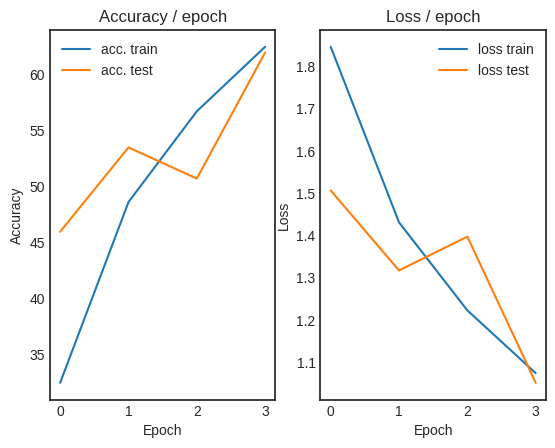

 20%|██        | 4/20 [01:29<05:59, 22.46s/it]

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.230s (0.230s)	Loss 0.9217 (0.9217)	Prec@1  66.4 ( 66.4)	Prec@5  98.4 ( 98.4)


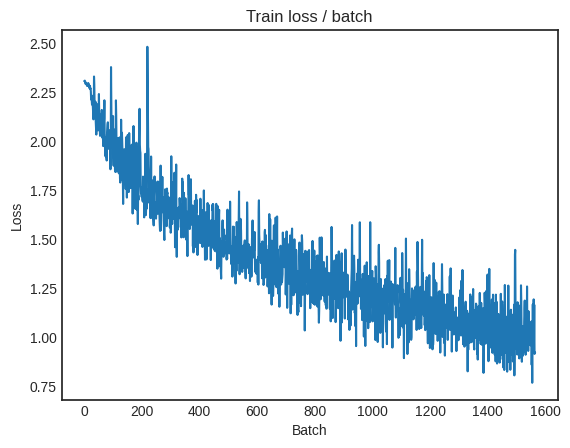

[TRAIN Batch 200/391]	Time 0.009s (0.048s)	Loss 1.0120 (0.9806)	Prec@1  69.5 ( 65.8)	Prec@5  96.9 ( 96.7)


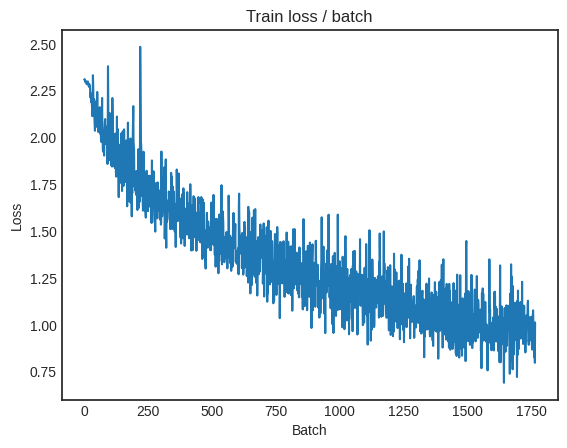


===============> Total time 19s	Avg loss 0.9561	Avg Prec@1 66.59 %	Avg Prec@5 97.00 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 0.9782 (0.9782)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9393	Avg Prec@1 67.75 %	Avg Prec@5 97.31 %



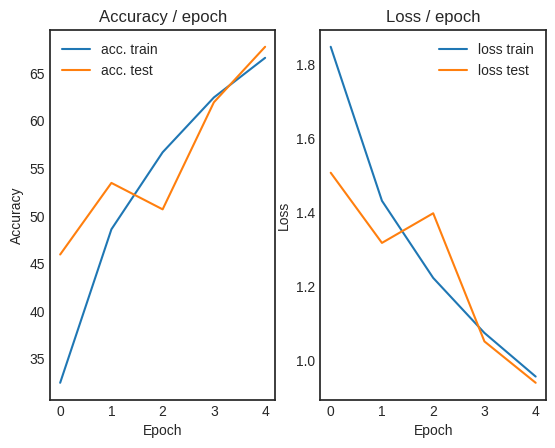

 25%|██▌       | 5/20 [01:51<05:34, 22.31s/it]

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.335s (0.335s)	Loss 1.0157 (1.0157)	Prec@1  62.5 ( 62.5)	Prec@5  94.5 ( 94.5)


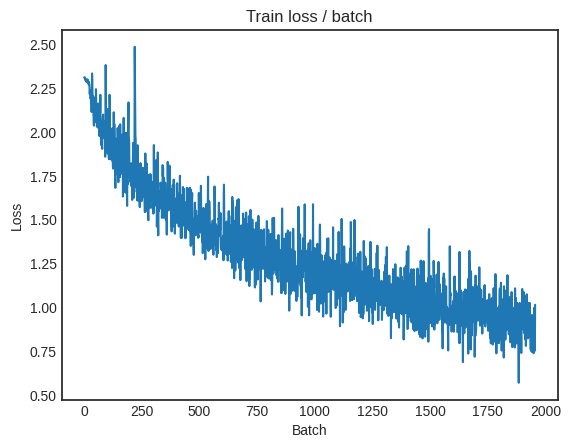

[TRAIN Batch 200/391]	Time 0.075s (0.050s)	Loss 0.9523 (0.8823)	Prec@1  69.5 ( 69.7)	Prec@5  95.3 ( 97.4)


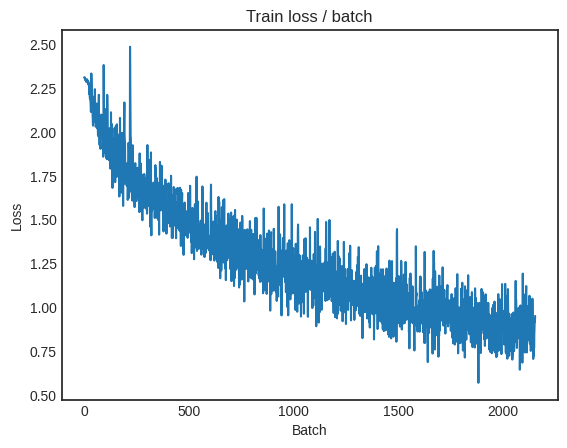


===============> Total time 19s	Avg loss 0.8748	Avg Prec@1 69.77 %	Avg Prec@5 97.46 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 0.8610 (0.8610)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8911	Avg Prec@1 68.89 %	Avg Prec@5 97.28 %



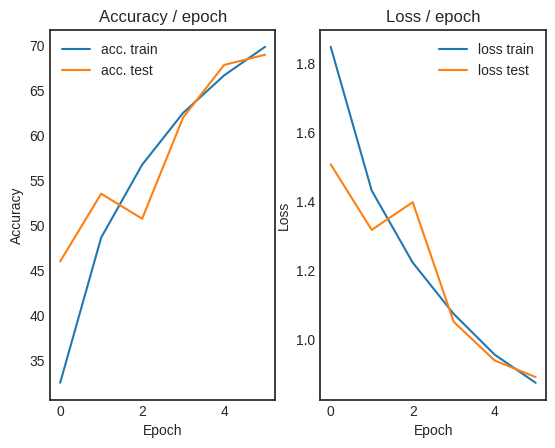

 30%|███       | 6/20 [02:13<05:13, 22.42s/it]

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.225s (0.225s)	Loss 0.8991 (0.8991)	Prec@1  67.2 ( 67.2)	Prec@5  98.4 ( 98.4)


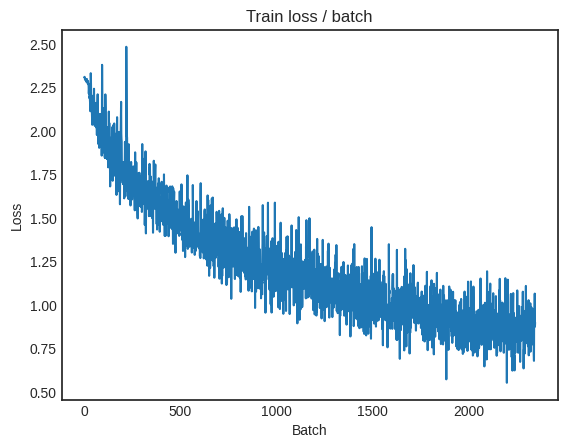

[TRAIN Batch 200/391]	Time 0.063s (0.051s)	Loss 0.6887 (0.8085)	Prec@1  76.6 ( 71.7)	Prec@5  98.4 ( 97.9)


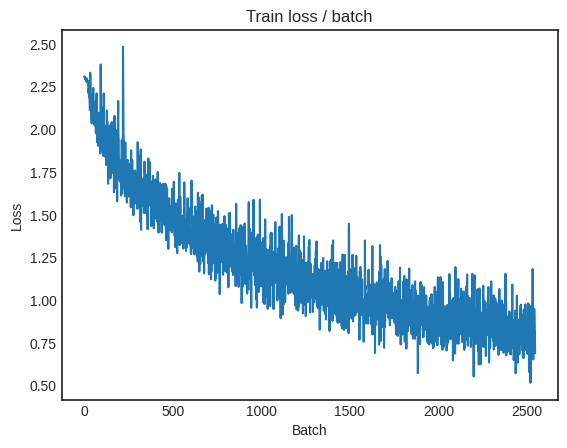


===============> Total time 21s	Avg loss 0.8074	Avg Prec@1 71.94 %	Avg Prec@5 97.88 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 0.9791 (0.9791)	Prec@1  66.4 ( 66.4)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.9278	Avg Prec@1 68.73 %	Avg Prec@5 96.71 %



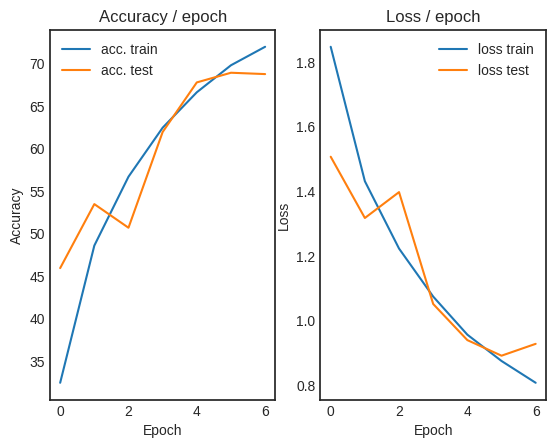

 35%|███▌      | 7/20 [02:38<04:59, 23.04s/it]

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.223s (0.223s)	Loss 1.0314 (1.0314)	Prec@1  63.3 ( 63.3)	Prec@5  97.7 ( 97.7)


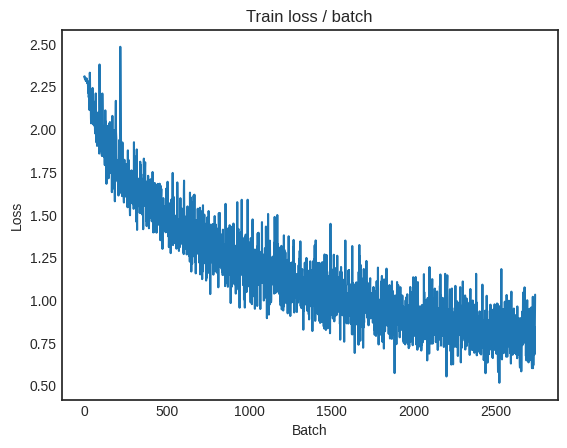

[TRAIN Batch 200/391]	Time 0.016s (0.050s)	Loss 0.6576 (0.7636)	Prec@1  78.9 ( 73.3)	Prec@5  99.2 ( 98.0)


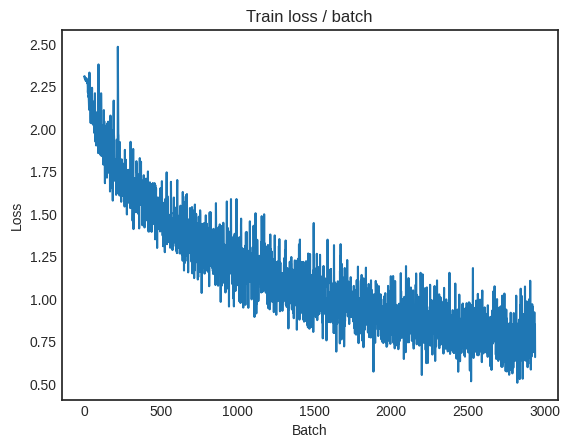


===============> Total time 19s	Avg loss 0.7568	Avg Prec@1 73.64 %	Avg Prec@5 98.13 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 0.8395 (0.8395)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8166	Avg Prec@1 71.97 %	Avg Prec@5 97.76 %



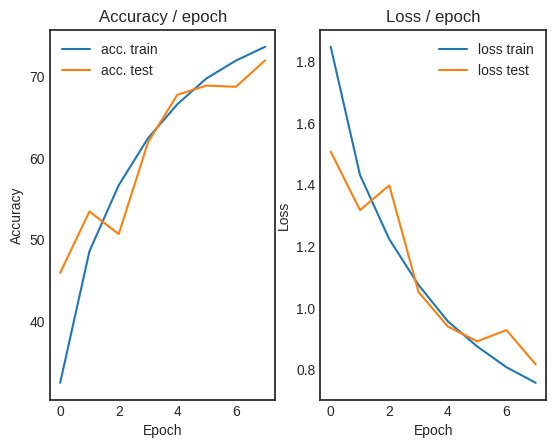

 40%|████      | 8/20 [03:01<04:35, 22.96s/it]

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.218s (0.218s)	Loss 0.6146 (0.6146)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)


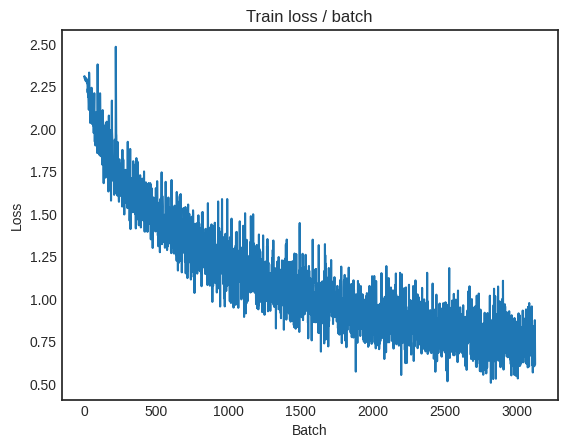

[TRAIN Batch 200/391]	Time 0.065s (0.051s)	Loss 0.7462 (0.7232)	Prec@1  78.1 ( 74.7)	Prec@5  97.7 ( 98.3)


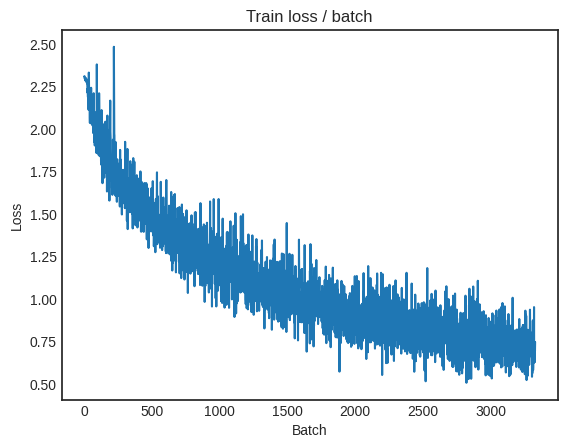


===============> Total time 18s	Avg loss 0.7207	Avg Prec@1 74.86 %	Avg Prec@5 98.32 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.8637 (0.8637)	Prec@1  72.7 ( 72.7)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.8017	Avg Prec@1 72.59 %	Avg Prec@5 97.93 %



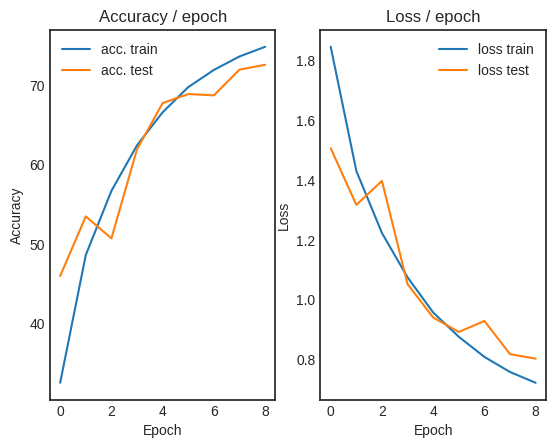

 45%|████▌     | 9/20 [03:23<04:11, 22.86s/it]

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 0.6836 (0.6836)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)


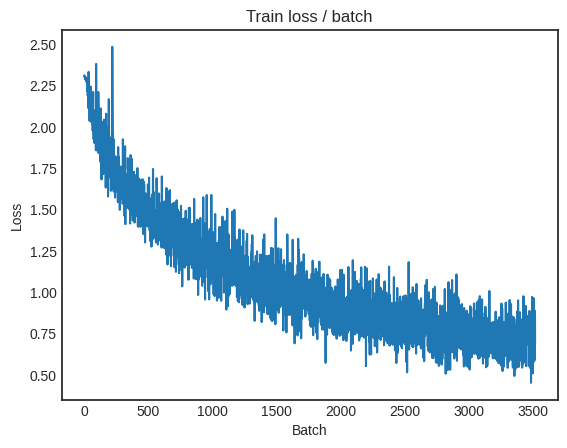

[TRAIN Batch 200/391]	Time 0.052s (0.045s)	Loss 0.7299 (0.6789)	Prec@1  74.2 ( 76.6)	Prec@5  99.2 ( 98.4)


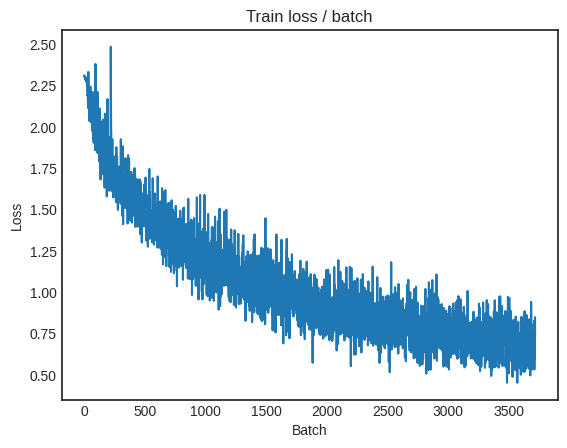


===============> Total time 18s	Avg loss 0.6813	Avg Prec@1 76.37 %	Avg Prec@5 98.43 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 0.7573 (0.7573)	Prec@1  78.1 ( 78.1)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7159	Avg Prec@1 74.97 %	Avg Prec@5 98.42 %



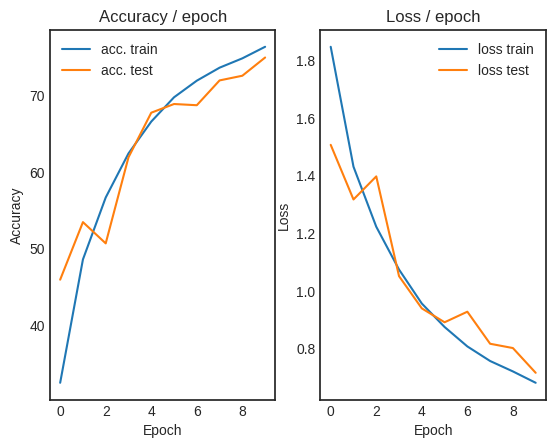

 50%|█████     | 10/20 [03:45<03:44, 22.46s/it]

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.227s (0.227s)	Loss 0.6388 (0.6388)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)


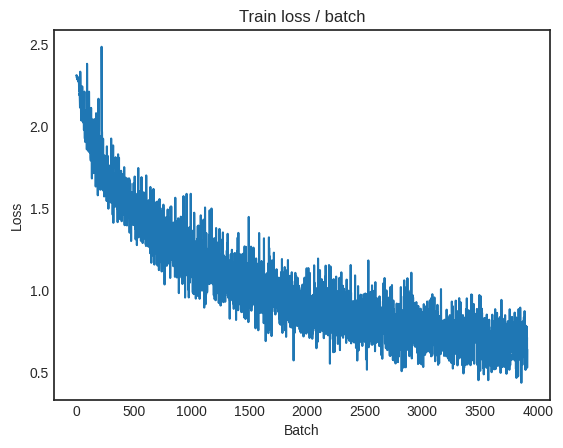

[TRAIN Batch 200/391]	Time 0.030s (0.052s)	Loss 0.7019 (0.6540)	Prec@1  75.0 ( 77.4)	Prec@5  99.2 ( 98.6)


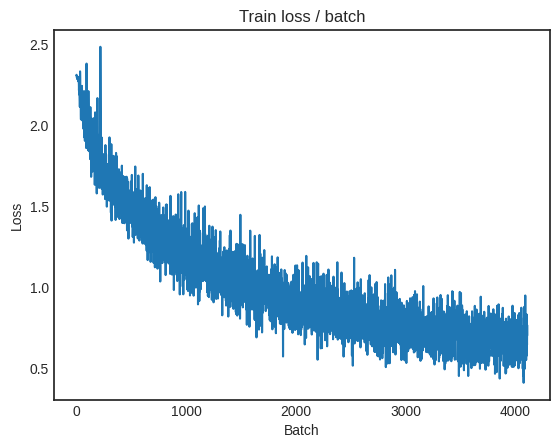


===============> Total time 19s	Avg loss 0.6502	Avg Prec@1 77.39 %	Avg Prec@5 98.64 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 0.7060 (0.7060)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7177	Avg Prec@1 75.52 %	Avg Prec@5 98.44 %



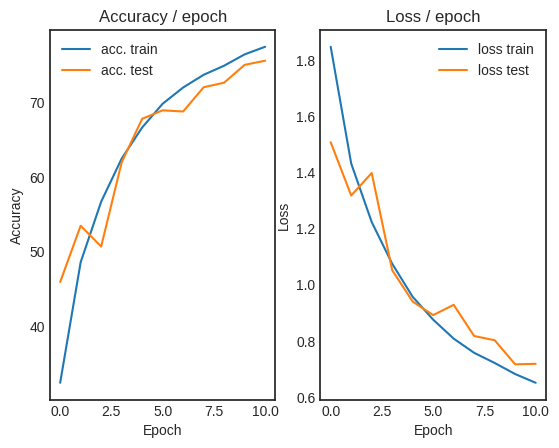

 55%|█████▌    | 11/20 [04:07<03:22, 22.54s/it]

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.218s (0.218s)	Loss 0.6433 (0.6433)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)


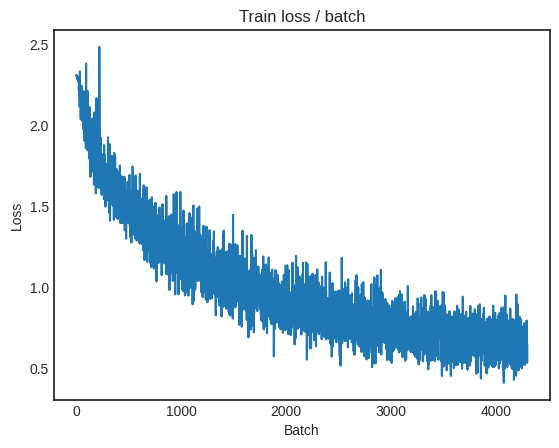

[TRAIN Batch 200/391]	Time 0.015s (0.050s)	Loss 0.5843 (0.6242)	Prec@1  80.5 ( 78.1)	Prec@5  98.4 ( 98.7)


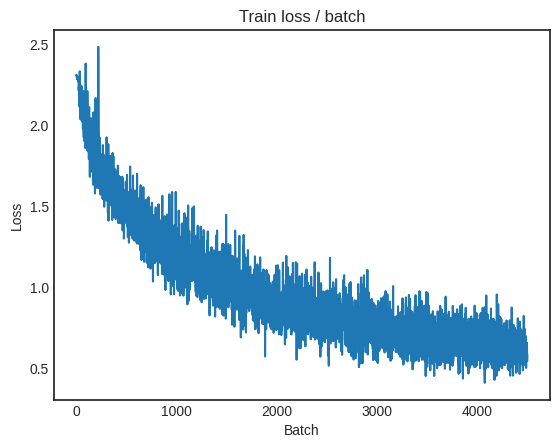


===============> Total time 19s	Avg loss 0.6187	Avg Prec@1 78.39 %	Avg Prec@5 98.69 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.6814 (0.6814)	Prec@1  77.3 ( 77.3)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7067	Avg Prec@1 75.23 %	Avg Prec@5 98.48 %



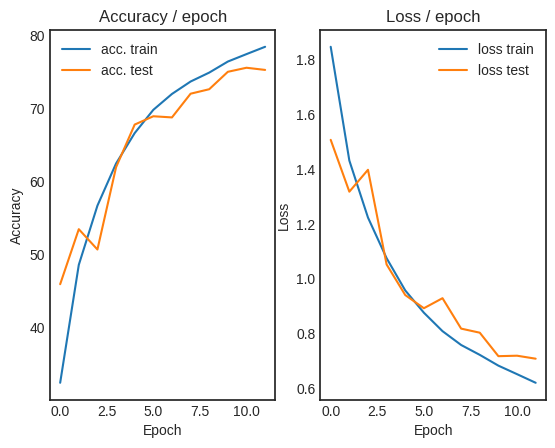

 60%|██████    | 12/20 [04:30<03:00, 22.57s/it]

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.240s (0.240s)	Loss 0.5823 (0.5823)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)


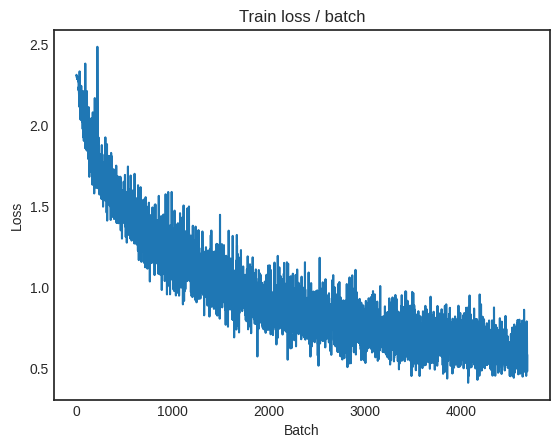

[TRAIN Batch 200/391]	Time 0.028s (0.051s)	Loss 0.6065 (0.5918)	Prec@1  78.9 ( 79.3)	Prec@5  99.2 ( 98.9)


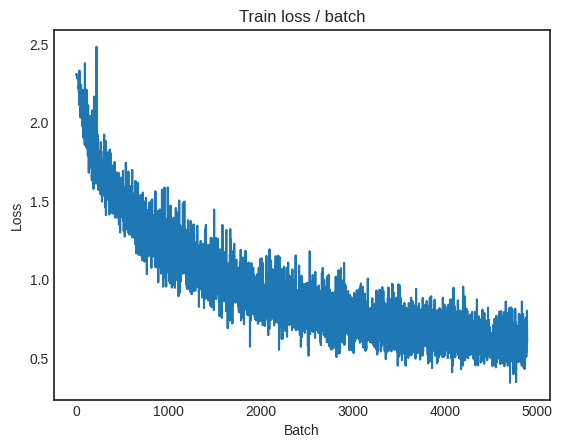


===============> Total time 18s	Avg loss 0.5998	Avg Prec@1 79.03 %	Avg Prec@5 98.87 %

[EVAL Batch 000/079]	Time 0.181s (0.181s)	Loss 0.7147 (0.7147)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.6851	Avg Prec@1 76.83 %	Avg Prec@5 98.62 %



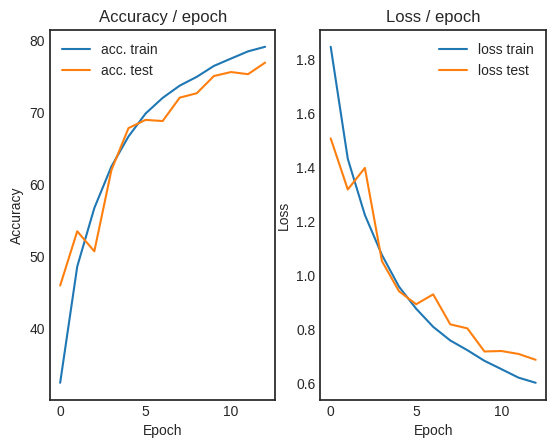

 65%|██████▌   | 13/20 [04:53<02:38, 22.60s/it]

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.234s (0.234s)	Loss 0.4523 (0.4523)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


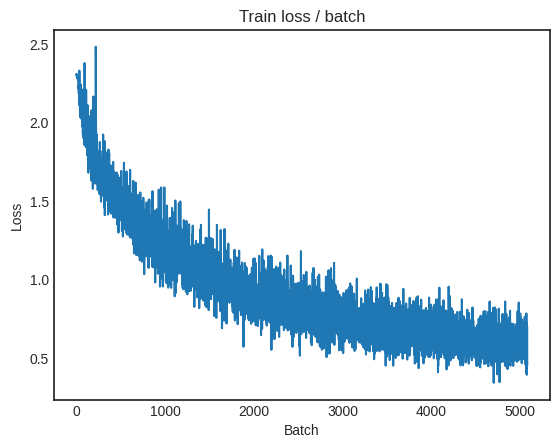

[TRAIN Batch 200/391]	Time 0.011s (0.047s)	Loss 0.5329 (0.5667)	Prec@1  78.9 ( 80.1)	Prec@5 100.0 ( 99.0)


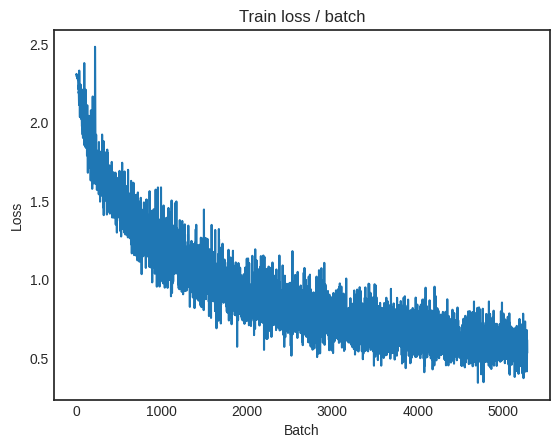


===============> Total time 18s	Avg loss 0.5692	Avg Prec@1 80.19 %	Avg Prec@5 99.01 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.6112 (0.6112)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6548	Avg Prec@1 77.80 %	Avg Prec@5 98.61 %



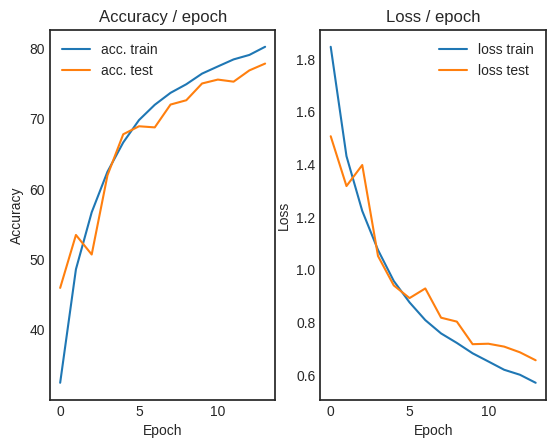

 70%|███████   | 14/20 [05:14<02:13, 22.33s/it]

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 0.5278 (0.5278)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)


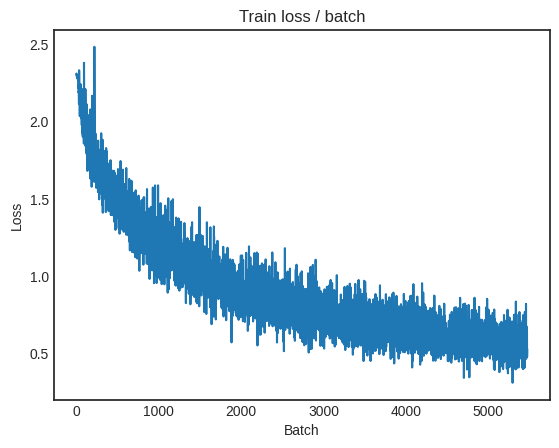

[TRAIN Batch 200/391]	Time 0.057s (0.052s)	Loss 0.4489 (0.5504)	Prec@1  85.9 ( 80.8)	Prec@5  99.2 ( 99.0)


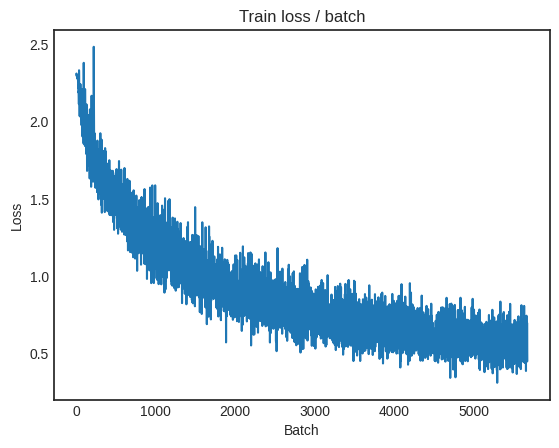


===============> Total time 20s	Avg loss 0.5547	Avg Prec@1 80.60 %	Avg Prec@5 99.05 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.6680 (0.6680)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6589	Avg Prec@1 77.38 %	Avg Prec@5 98.41 %



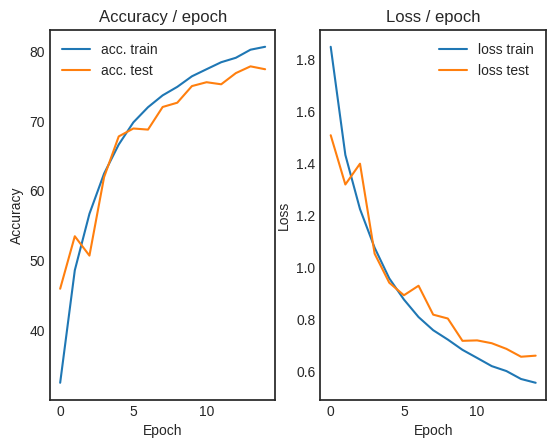

 75%|███████▌  | 15/20 [05:38<01:53, 22.61s/it]

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.274s (0.274s)	Loss 0.5732 (0.5732)	Prec@1  76.6 ( 76.6)	Prec@5 100.0 (100.0)


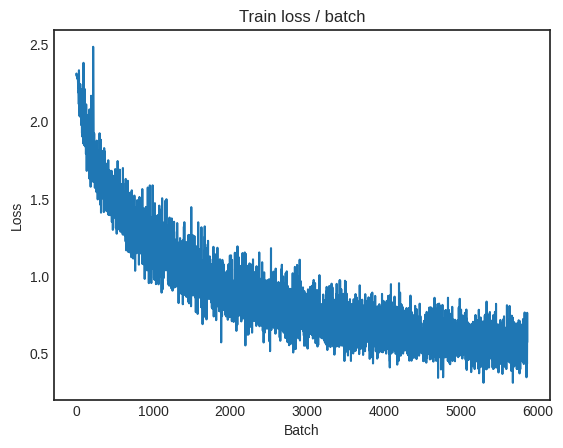

[TRAIN Batch 200/391]	Time 0.049s (0.053s)	Loss 0.5446 (0.5312)	Prec@1  83.6 ( 81.4)	Prec@5  99.2 ( 99.1)


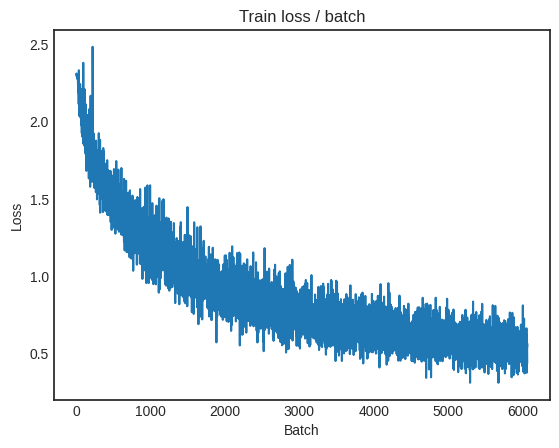


===============> Total time 20s	Avg loss 0.5340	Avg Prec@1 81.42 %	Avg Prec@5 99.11 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 0.5872 (0.5872)	Prec@1  80.5 ( 80.5)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.6401	Avg Prec@1 78.01 %	Avg Prec@5 98.58 %



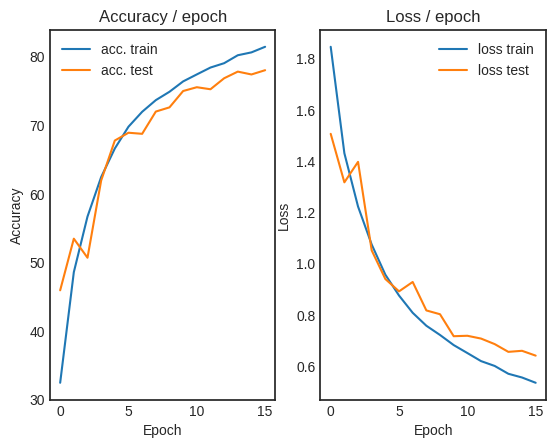

 80%|████████  | 16/20 [06:01<01:31, 22.85s/it]

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.239s (0.239s)	Loss 0.5289 (0.5289)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)


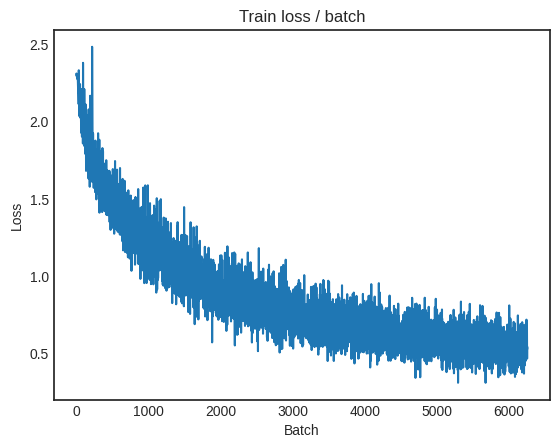

[TRAIN Batch 200/391]	Time 0.073s (0.052s)	Loss 0.4637 (0.5190)	Prec@1  84.4 ( 81.9)	Prec@5  98.4 ( 99.1)


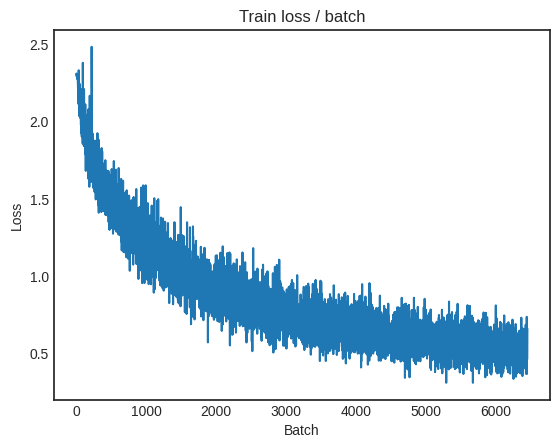


===============> Total time 19s	Avg loss 0.5160	Avg Prec@1 82.00 %	Avg Prec@5 99.16 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 0.6783 (0.6783)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6729	Avg Prec@1 77.51 %	Avg Prec@5 98.60 %



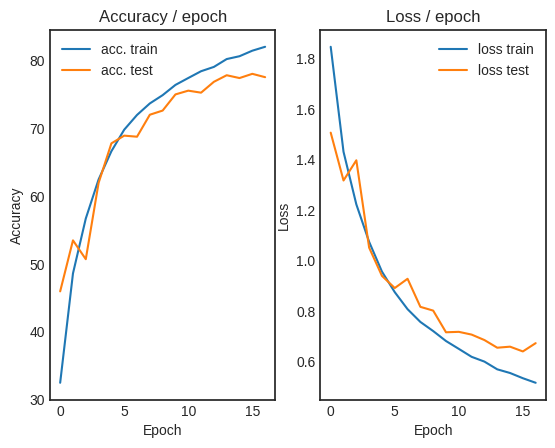

 85%|████████▌ | 17/20 [06:24<01:08, 22.89s/it]

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 0.5129 (0.5129)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)


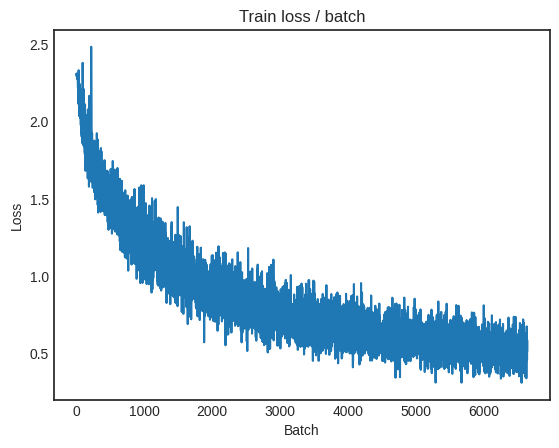

[TRAIN Batch 200/391]	Time 0.062s (0.051s)	Loss 0.4563 (0.4951)	Prec@1  85.2 ( 82.7)	Prec@5  99.2 ( 99.2)


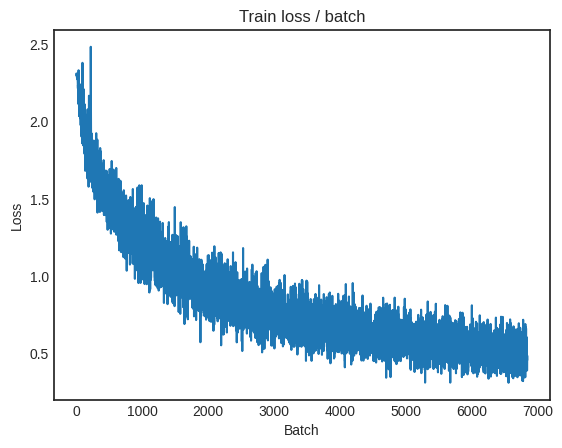


===============> Total time 18s	Avg loss 0.4989	Avg Prec@1 82.59 %	Avg Prec@5 99.22 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 0.5658 (0.5658)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6268	Avg Prec@1 78.90 %	Avg Prec@5 98.62 %



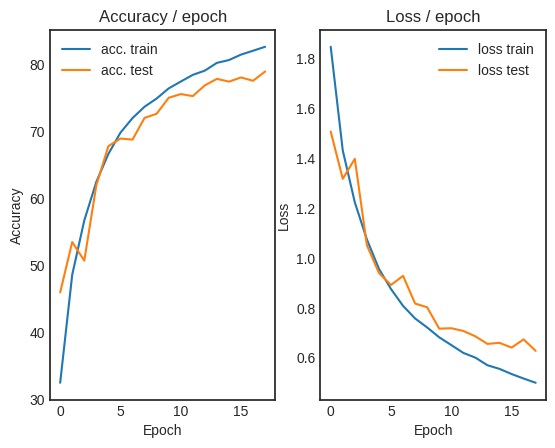

 90%|█████████ | 18/20 [06:47<00:45, 22.85s/it]

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.230s (0.230s)	Loss 0.4267 (0.4267)	Prec@1  87.5 ( 87.5)	Prec@5  97.7 ( 97.7)


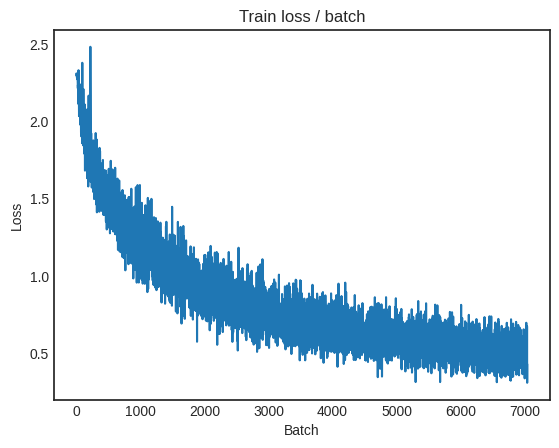

[TRAIN Batch 200/391]	Time 0.068s (0.046s)	Loss 0.4360 (0.4911)	Prec@1  85.9 ( 82.8)	Prec@5  99.2 ( 99.2)


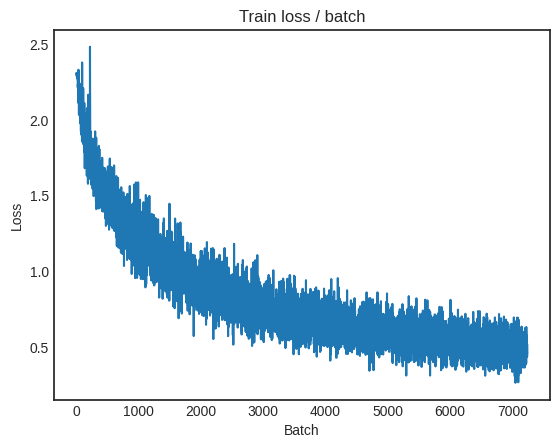


===============> Total time 18s	Avg loss 0.4913	Avg Prec@1 82.89 %	Avg Prec@5 99.24 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 0.5965 (0.5965)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6271	Avg Prec@1 78.49 %	Avg Prec@5 98.80 %



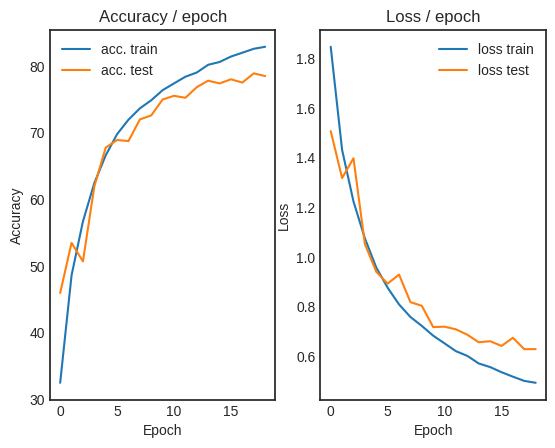

 95%|█████████▌| 19/20 [07:09<00:22, 22.52s/it]

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.5613 (0.5613)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)


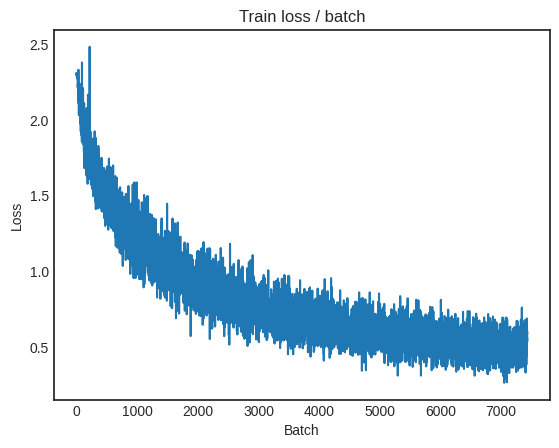

[TRAIN Batch 200/391]	Time 0.014s (0.051s)	Loss 0.4081 (0.4644)	Prec@1  84.4 ( 83.9)	Prec@5 100.0 ( 99.3)


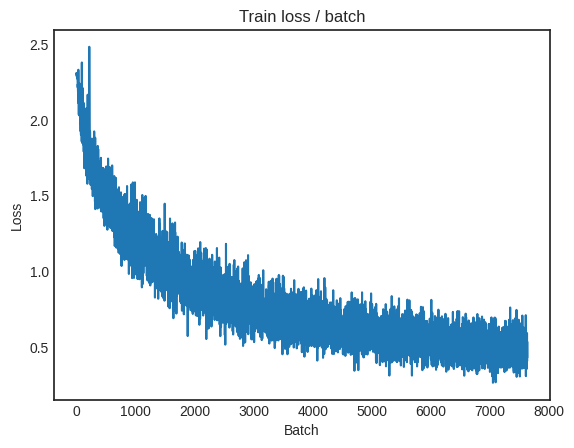


===============> Total time 19s	Avg loss 0.4715	Avg Prec@1 83.51 %	Avg Prec@5 99.30 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 0.5282 (0.5282)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.5885	Avg Prec@1 80.01 %	Avg Prec@5 98.89 %



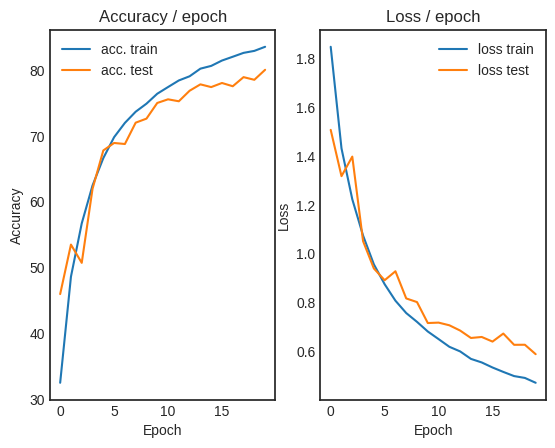

100%|██████████| 20/20 [07:31<00:00, 22.60s/it]


In [52]:
main_CIFAR_dropout(batch_size=128, lr=0.1, epochs=20, cuda=True)

## 3.5 Batch normalization

In [53]:
class ConvNet2_batch(nn.Module):

    def __init__(self, channels = 3):
        super(ConvNet2_batch, self).__init__()

        self.channels = channels # to handle color images
        self.conv1 = 32
        self.conv2 = 64
        self.conv3 = 64
        self.fc4 = 1000
        self.fc5 = 10

        # conv net as feature extractor
        self.features = nn.Sequential(
            nn.Conv2d(self.channels, 32, (5, 5), stride=1, padding=2),
            nn.BatchNorm2d(num_features = self.conv1),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),

            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.BatchNorm2d(num_features = self.conv2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),

            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.BatchNorm2d(num_features = self.conv3),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode = True),
        )

        self.classifier = nn.Sequential(
            nn.Linear(64 * 4 * 4, self.fc4),
            nn.ReLU(),
            #nn.Dropout(p = 0.5),
            nn.Linear(self.fc4, self.fc5),

            # Reminder: The softmax is included in the loss, do not put it here
            # nn.Softmax()
        )


    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers


        return output

In [54]:
def main_CIFAR_batch(batch_size=128, lr=0.1, epochs=20, cuda=True):
    #{"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet2_batch()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)
    lr_sched = lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset_CIFAR(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in tqdm(range(epochs)):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

        lr_sched.step()

Files already downloaded and verified
Files already downloaded and verified


  0%|          | 0/20 [00:00<?, ?it/s]

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.311s (0.311s)	Loss 2.3134 (2.3134)	Prec@1   8.6 (  8.6)	Prec@5  52.3 ( 52.3)


<Figure size 640x480 with 0 Axes>

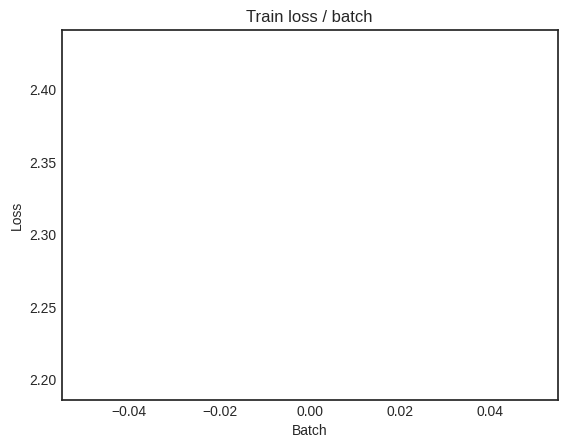

[TRAIN Batch 200/391]	Time 0.025s (0.051s)	Loss 1.2624 (1.6245)	Prec@1  51.6 ( 39.9)	Prec@5  95.3 ( 89.1)


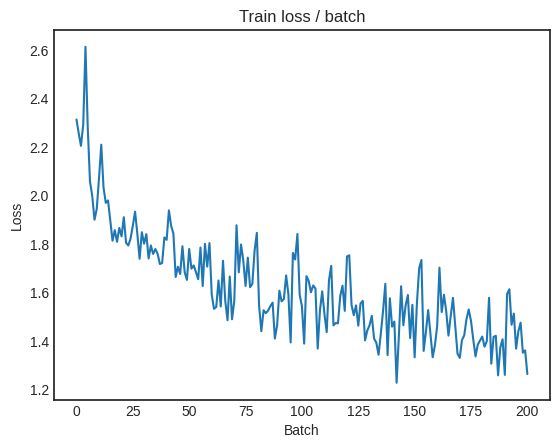


===============> Total time 20s	Avg loss 1.4683	Avg Prec@1 46.00 %	Avg Prec@5 91.69 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 1.3553 (1.3553)	Prec@1  50.8 ( 50.8)	Prec@5  93.8 ( 93.8)

===============> Total time 2s	Avg loss 1.3398	Avg Prec@1 52.07 %	Avg Prec@5 93.74 %



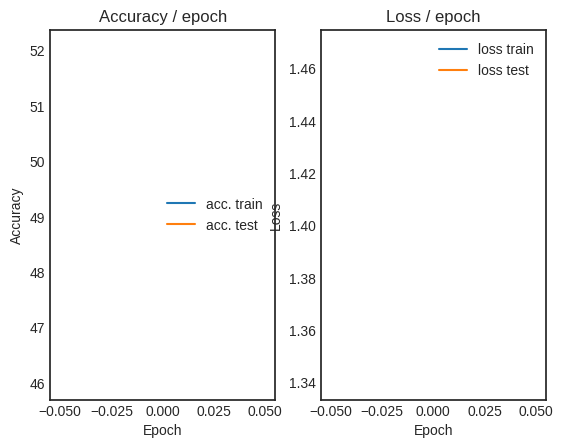

  5%|▌         | 1/20 [00:23<07:18, 23.06s/it]

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 1.2019 (1.2019)	Prec@1  54.7 ( 54.7)	Prec@5  95.3 ( 95.3)


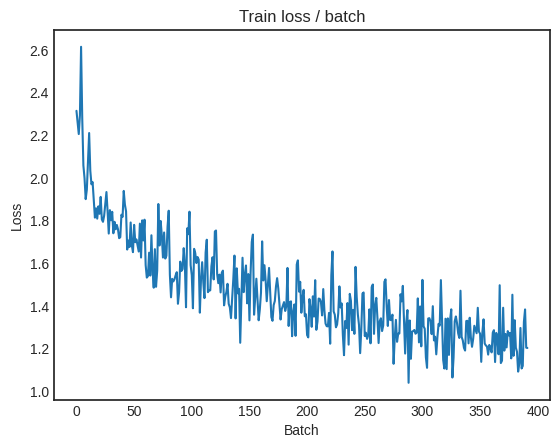

[TRAIN Batch 200/391]	Time 0.020s (0.050s)	Loss 0.9424 (1.1190)	Prec@1  66.4 ( 59.5)	Prec@5  97.7 ( 96.0)


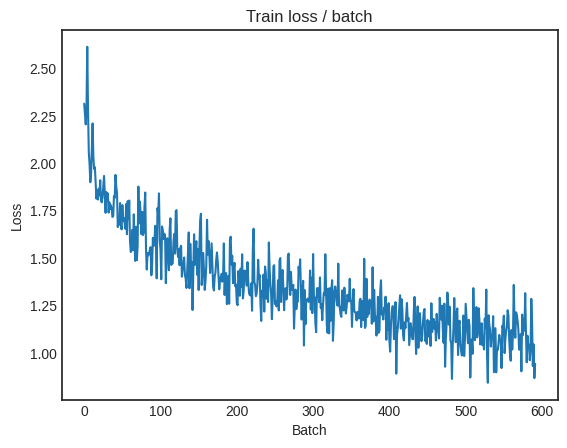


===============> Total time 19s	Avg loss 1.0783	Avg Prec@1 61.17 %	Avg Prec@5 96.23 %

[EVAL Batch 000/079]	Time 0.254s (0.254s)	Loss 1.0437 (1.0437)	Prec@1  65.6 ( 65.6)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.0698	Avg Prec@1 62.66 %	Avg Prec@5 95.79 %



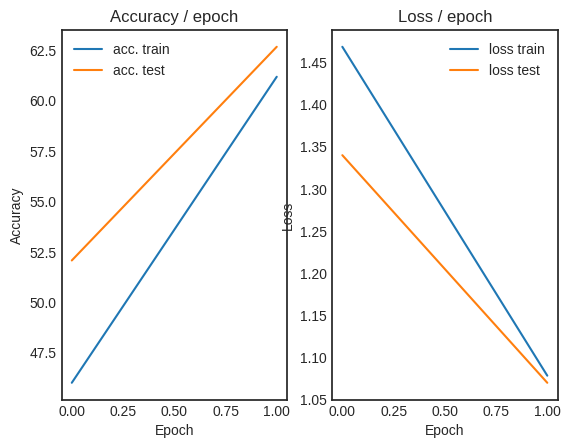

 10%|█         | 2/20 [00:45<06:46, 22.57s/it]

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.8638 (0.8638)	Prec@1  72.7 ( 72.7)	Prec@5  96.1 ( 96.1)


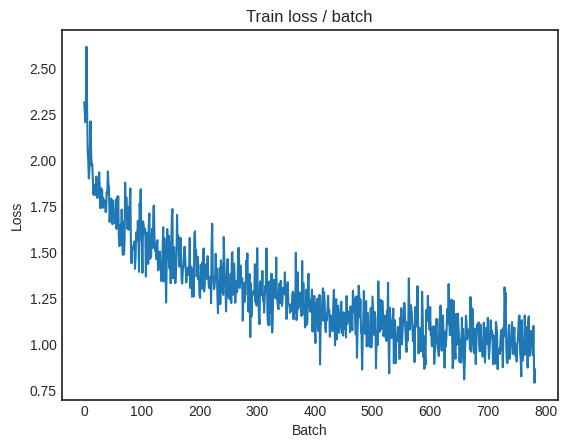

[TRAIN Batch 200/391]	Time 0.018s (0.058s)	Loss 0.9703 (0.9252)	Prec@1  68.8 ( 67.1)	Prec@5  97.7 ( 97.3)


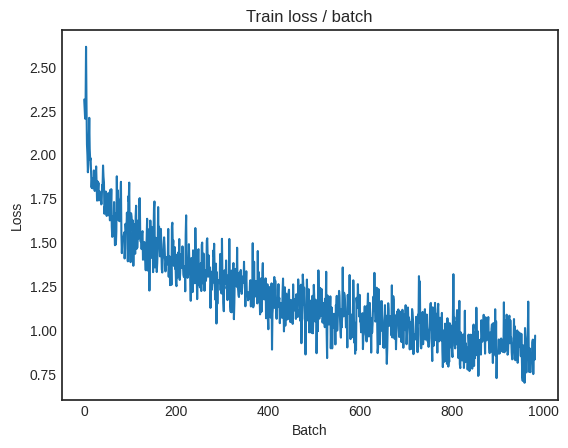


===============> Total time 19s	Avg loss 0.9121	Avg Prec@1 67.68 %	Avg Prec@5 97.34 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 1.4444 (1.4444)	Prec@1  46.1 ( 46.1)	Prec@5  94.5 ( 94.5)

===============> Total time 3s	Avg loss 1.3725	Avg Prec@1 52.40 %	Avg Prec@5 94.57 %



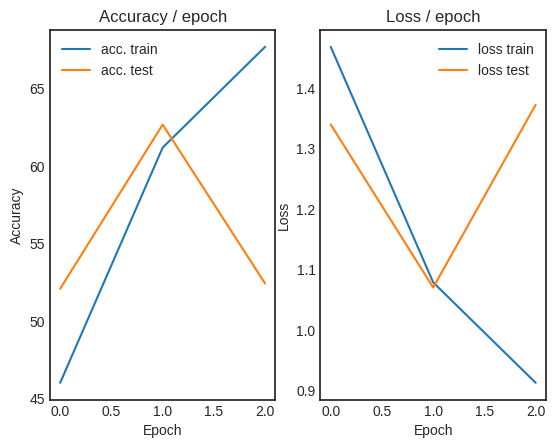

 15%|█▌        | 3/20 [01:09<06:32, 23.11s/it]

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.201s (0.201s)	Loss 0.9822 (0.9822)	Prec@1  66.4 ( 66.4)	Prec@5  95.3 ( 95.3)


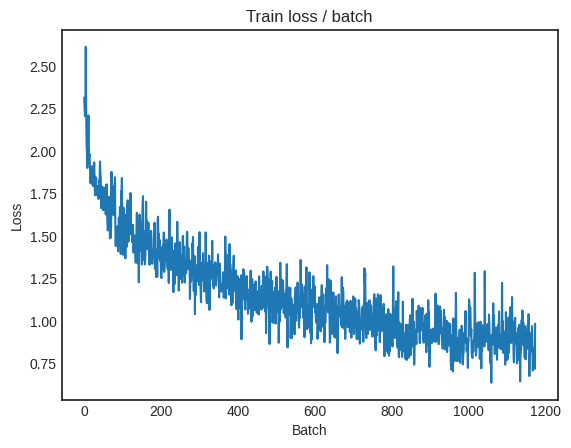

[TRAIN Batch 200/391]	Time 0.014s (0.045s)	Loss 1.0975 (0.8165)	Prec@1  57.8 ( 70.9)	Prec@5  96.9 ( 98.0)


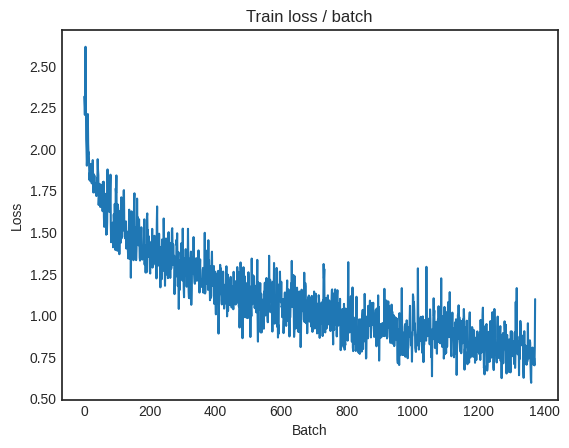


===============> Total time 18s	Avg loss 0.8055	Avg Prec@1 71.39 %	Avg Prec@5 97.99 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 1.0890 (1.0890)	Prec@1  64.8 ( 64.8)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.0018	Avg Prec@1 65.73 %	Avg Prec@5 96.74 %



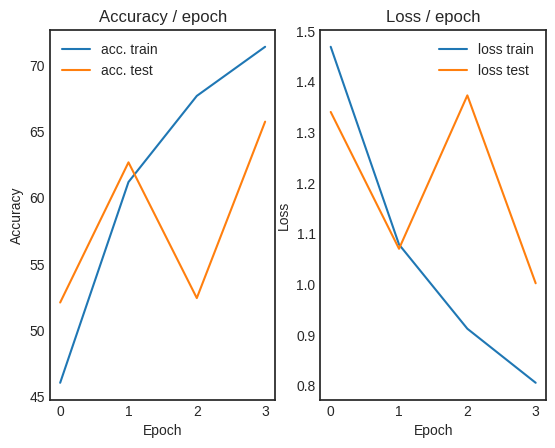

 20%|██        | 4/20 [01:30<05:59, 22.49s/it]

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.208s (0.208s)	Loss 0.6299 (0.6299)	Prec@1  79.7 ( 79.7)	Prec@5 100.0 (100.0)


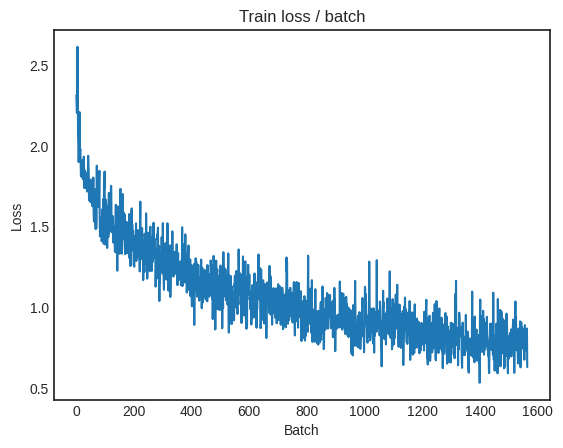

[TRAIN Batch 200/391]	Time 0.048s (0.051s)	Loss 0.8137 (0.7456)	Prec@1  73.4 ( 73.9)	Prec@5  97.7 ( 98.2)


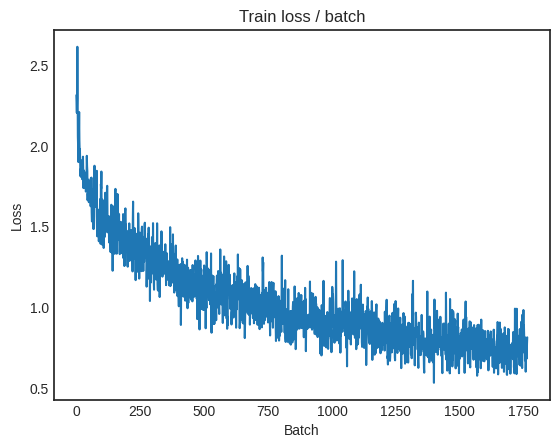


===============> Total time 19s	Avg loss 0.7352	Avg Prec@1 74.33 %	Avg Prec@5 98.28 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 0.9474 (0.9474)	Prec@1  68.8 ( 68.8)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.9330	Avg Prec@1 67.14 %	Avg Prec@5 96.88 %



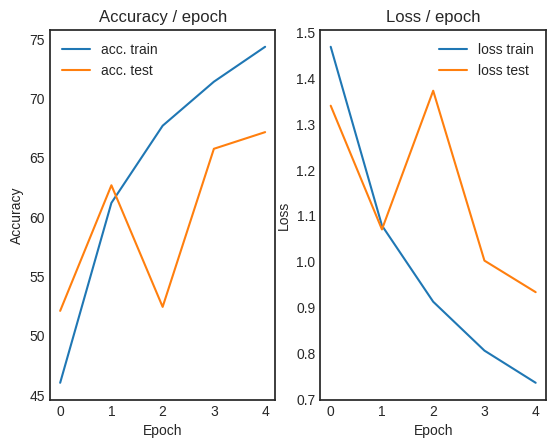

 25%|██▌       | 5/20 [01:53<05:39, 22.65s/it]

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.210s (0.210s)	Loss 0.7578 (0.7578)	Prec@1  69.5 ( 69.5)	Prec@5  99.2 ( 99.2)


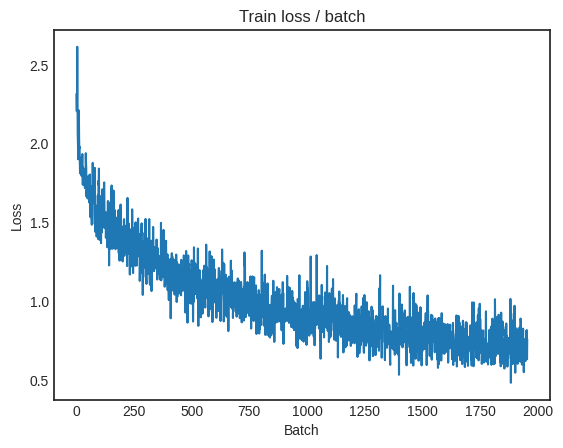

[TRAIN Batch 200/391]	Time 0.064s (0.050s)	Loss 0.7512 (0.6742)	Prec@1  78.1 ( 76.0)	Prec@5  95.3 ( 98.6)


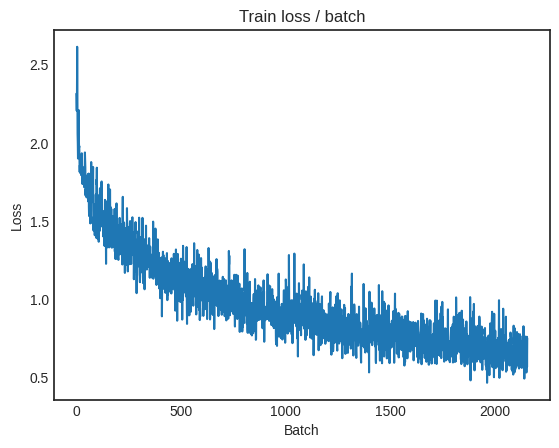


===============> Total time 19s	Avg loss 0.6784	Avg Prec@1 75.96 %	Avg Prec@5 98.57 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 0.8259 (0.8259)	Prec@1  77.3 ( 77.3)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7965	Avg Prec@1 72.56 %	Avg Prec@5 97.41 %



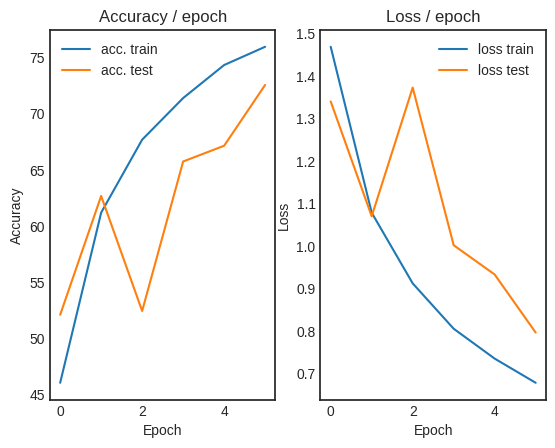

 30%|███       | 6/20 [02:16<05:17, 22.67s/it]

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.224s (0.224s)	Loss 0.6737 (0.6737)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)


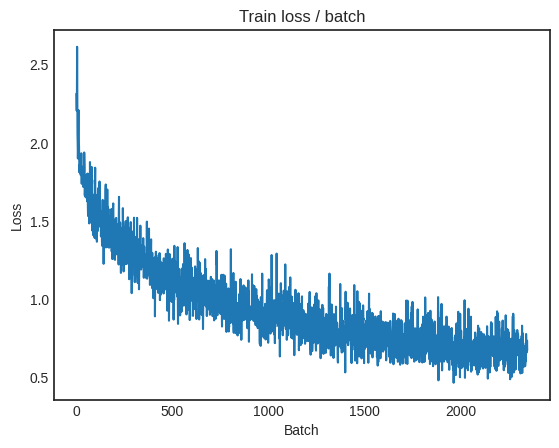

[TRAIN Batch 200/391]	Time 0.021s (0.051s)	Loss 0.6270 (0.6371)	Prec@1  78.1 ( 77.7)	Prec@5  98.4 ( 98.7)


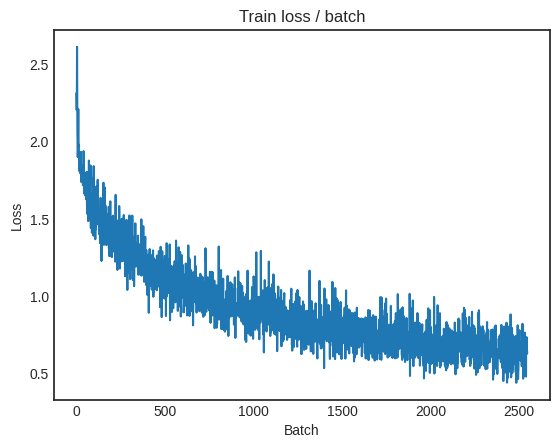


===============> Total time 19s	Avg loss 0.6339	Avg Prec@1 77.79 %	Avg Prec@5 98.76 %

[EVAL Batch 000/079]	Time 0.333s (0.333s)	Loss 0.8480 (0.8480)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8557	Avg Prec@1 71.55 %	Avg Prec@5 97.47 %



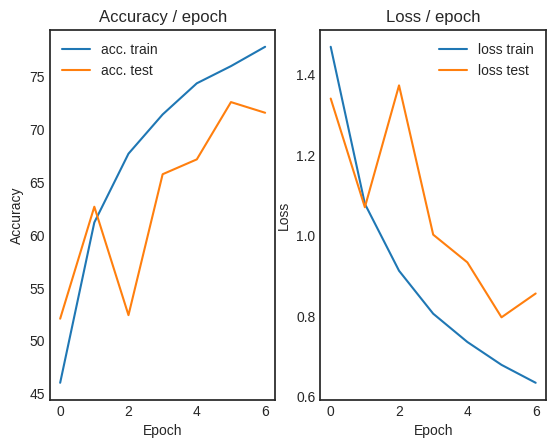

 35%|███▌      | 7/20 [02:39<04:56, 22.79s/it]

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 0.5758 (0.5758)	Prec@1  75.0 ( 75.0)	Prec@5 100.0 (100.0)


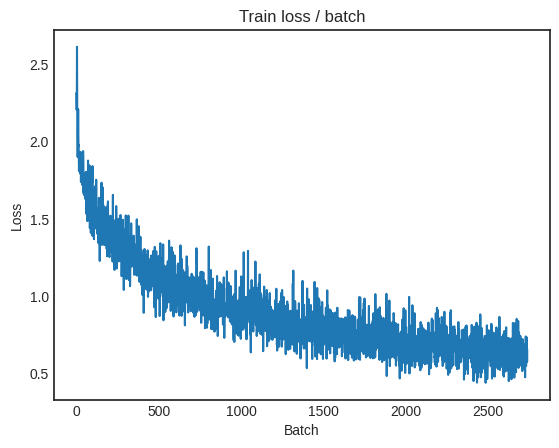

[TRAIN Batch 200/391]	Time 0.140s (0.050s)	Loss 0.6197 (0.5972)	Prec@1  80.5 ( 79.0)	Prec@5 100.0 ( 98.9)


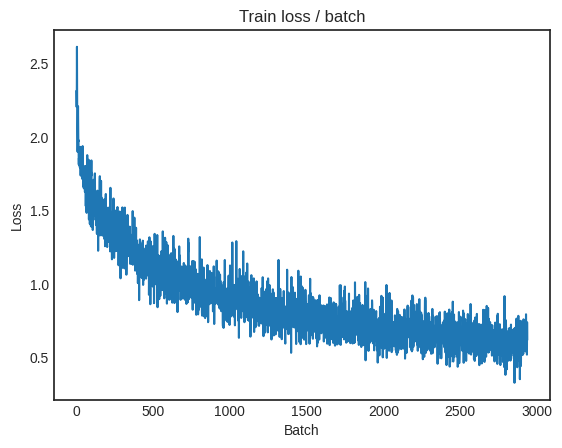


===============> Total time 18s	Avg loss 0.5935	Avg Prec@1 79.16 %	Avg Prec@5 98.93 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 0.8069 (0.8069)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8130	Avg Prec@1 72.33 %	Avg Prec@5 97.86 %



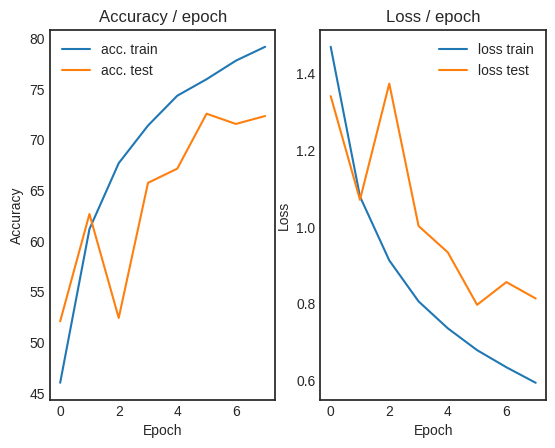

 40%|████      | 8/20 [03:01<04:30, 22.56s/it]

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.6376 (0.6376)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)


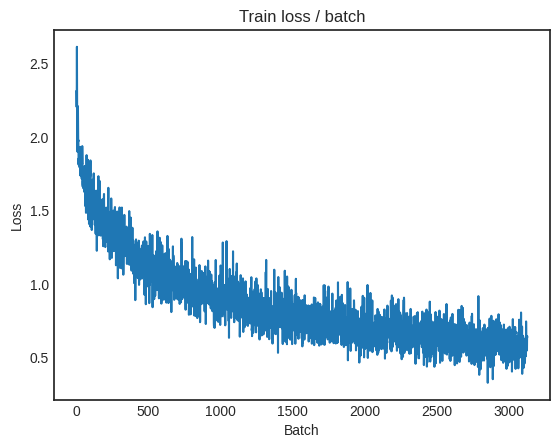

[TRAIN Batch 200/391]	Time 0.016s (0.046s)	Loss 0.6881 (0.5545)	Prec@1  74.2 ( 80.5)	Prec@5  97.7 ( 99.1)


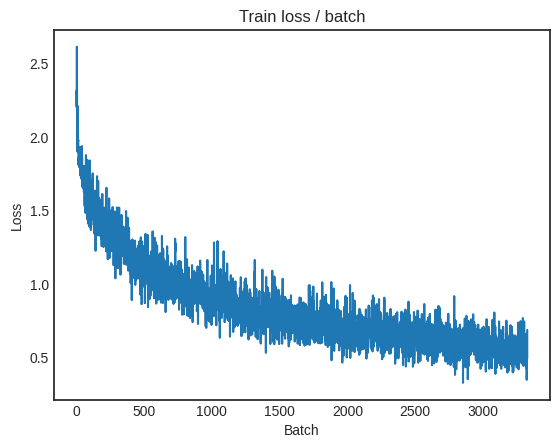


===============> Total time 18s	Avg loss 0.5599	Avg Prec@1 80.38 %	Avg Prec@5 99.07 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 0.7267 (0.7267)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7213	Avg Prec@1 75.25 %	Avg Prec@5 98.47 %



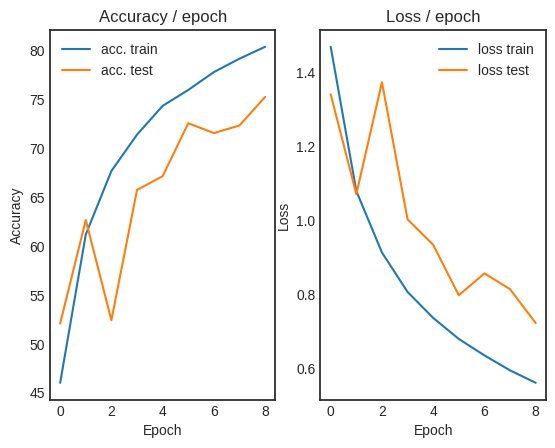

 45%|████▌     | 9/20 [03:22<04:04, 22.27s/it]

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 0.5678 (0.5678)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)


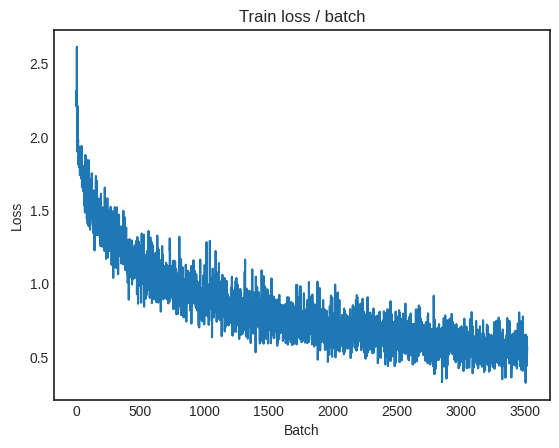

[TRAIN Batch 200/391]	Time 0.019s (0.051s)	Loss 0.5067 (0.5311)	Prec@1  80.5 ( 81.2)	Prec@5  99.2 ( 99.2)


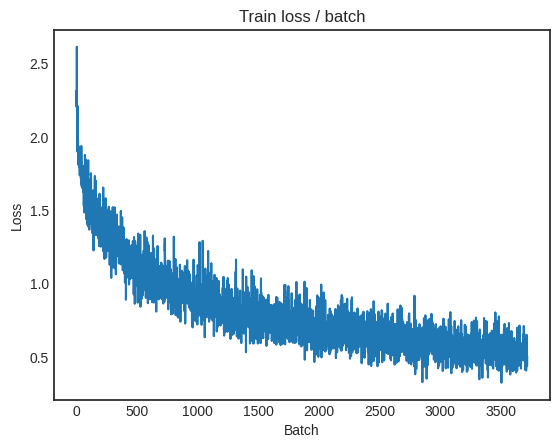


===============> Total time 19s	Avg loss 0.5303	Avg Prec@1 81.40 %	Avg Prec@5 99.16 %

[EVAL Batch 000/079]	Time 0.166s (0.166s)	Loss 1.0633 (1.0633)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.0067	Avg Prec@1 68.08 %	Avg Prec@5 97.56 %



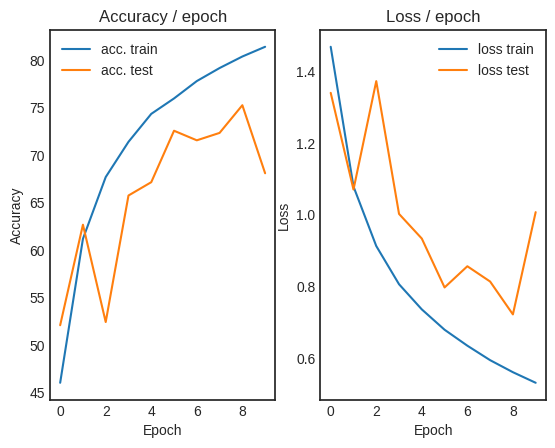

 50%|█████     | 10/20 [03:45<03:43, 22.34s/it]

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.6511 (0.6511)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)


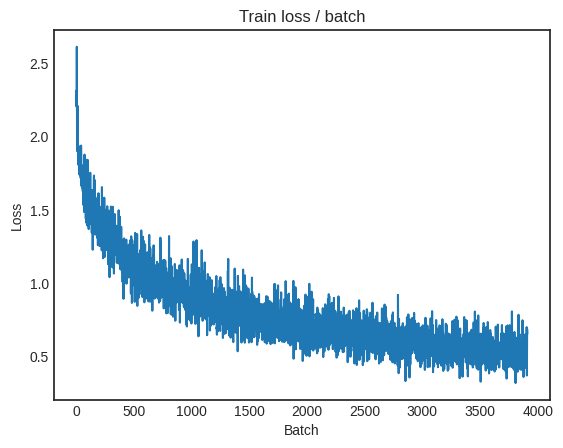

[TRAIN Batch 200/391]	Time 0.015s (0.050s)	Loss 0.5313 (0.5100)	Prec@1  83.6 ( 82.3)	Prec@5  98.4 ( 99.2)


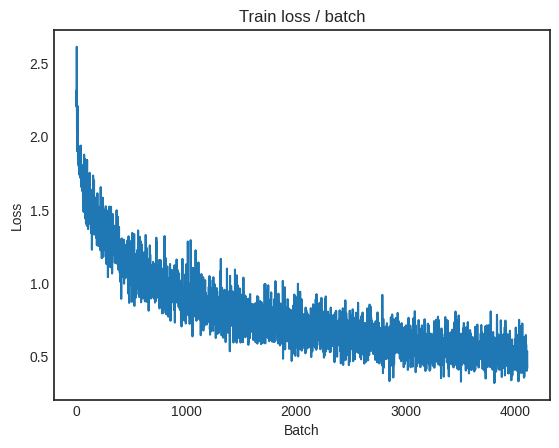


===============> Total time 18s	Avg loss 0.5090	Avg Prec@1 82.33 %	Avg Prec@5 99.17 %

[EVAL Batch 000/079]	Time 0.348s (0.348s)	Loss 0.6214 (0.6214)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6020	Avg Prec@1 78.68 %	Avg Prec@5 98.83 %



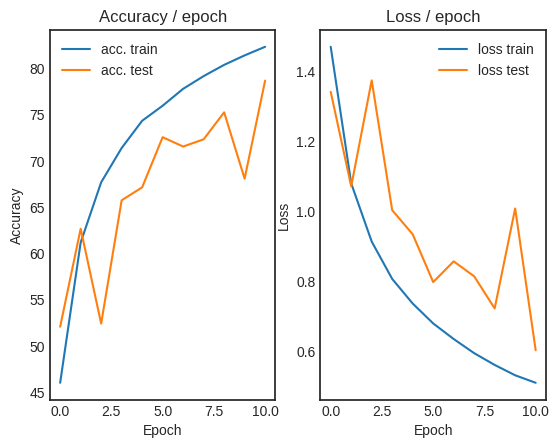

 55%|█████▌    | 11/20 [04:07<03:20, 22.29s/it]

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.227s (0.227s)	Loss 0.4796 (0.4796)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)


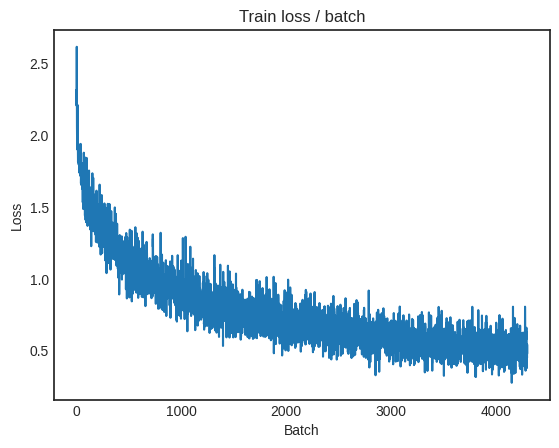

[TRAIN Batch 200/391]	Time 0.164s (0.048s)	Loss 0.4077 (0.4769)	Prec@1  85.9 ( 83.3)	Prec@5  99.2 ( 99.3)


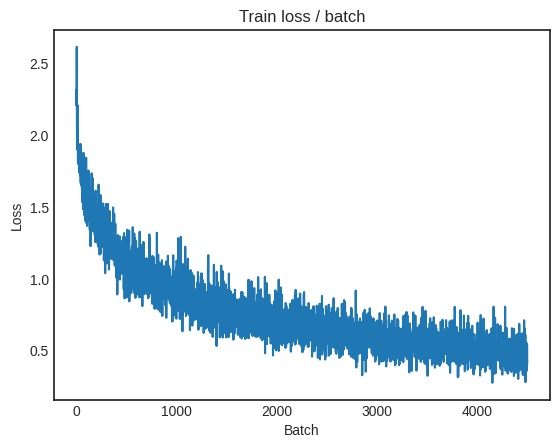


===============> Total time 19s	Avg loss 0.4819	Avg Prec@1 83.21 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 0.6450 (0.6450)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6162	Avg Prec@1 78.76 %	Avg Prec@5 98.78 %



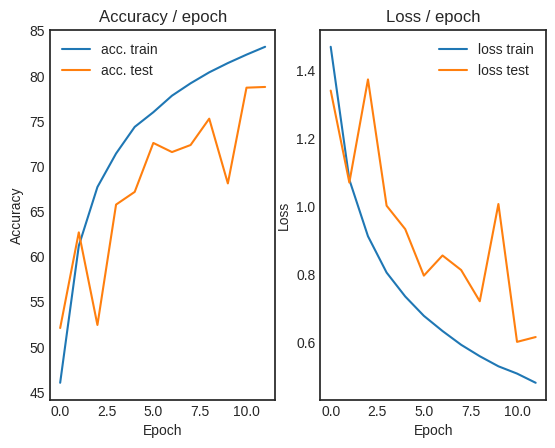

 60%|██████    | 12/20 [04:30<02:58, 22.34s/it]

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.286s (0.286s)	Loss 0.5225 (0.5225)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


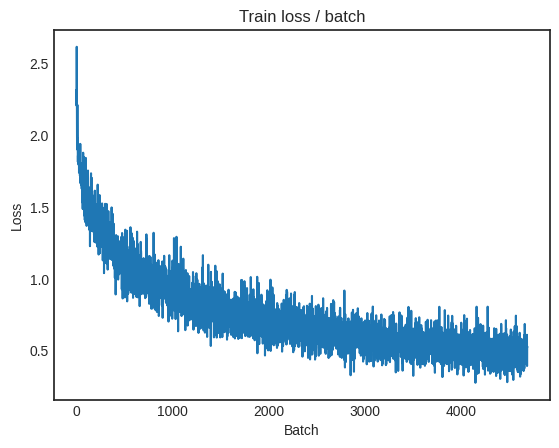

[TRAIN Batch 200/391]	Time 0.015s (0.048s)	Loss 0.4705 (0.4552)	Prec@1  82.0 ( 84.1)	Prec@5 100.0 ( 99.4)


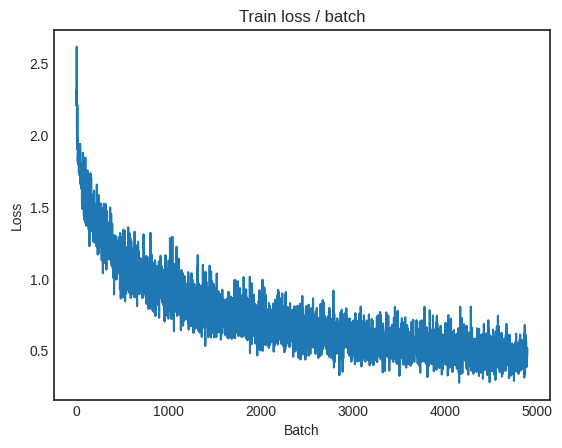


===============> Total time 19s	Avg loss 0.4568	Avg Prec@1 84.07 %	Avg Prec@5 99.38 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 0.6091 (0.6091)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.5890	Avg Prec@1 79.73 %	Avg Prec@5 98.99 %



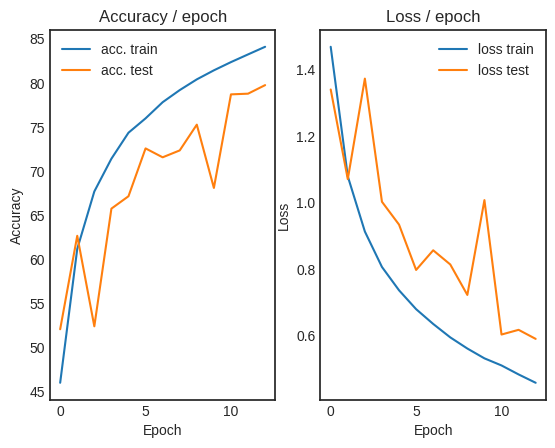

 65%|██████▌   | 13/20 [04:52<02:35, 22.27s/it]

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.234s (0.234s)	Loss 0.4587 (0.4587)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)


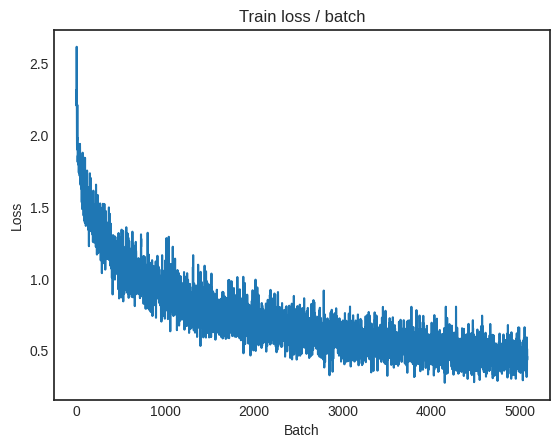

[TRAIN Batch 200/391]	Time 0.014s (0.051s)	Loss 0.3343 (0.4458)	Prec@1  85.9 ( 84.4)	Prec@5 100.0 ( 99.4)


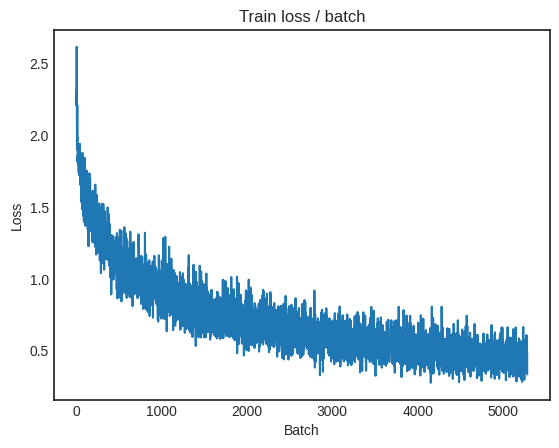


===============> Total time 19s	Avg loss 0.4410	Avg Prec@1 84.57 %	Avg Prec@5 99.38 %

[EVAL Batch 000/079]	Time 0.184s (0.184s)	Loss 0.6895 (0.6895)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6586	Avg Prec@1 77.83 %	Avg Prec@5 98.68 %



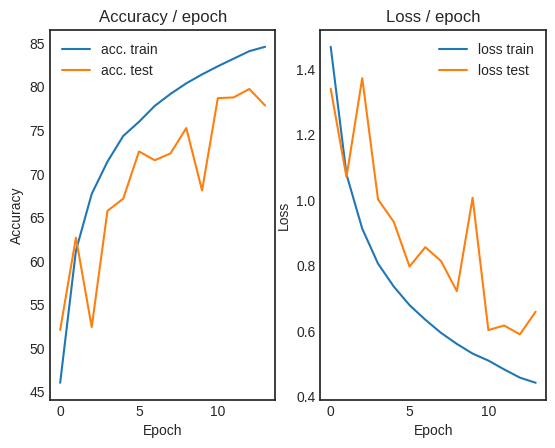

 70%|███████   | 14/20 [05:14<02:14, 22.42s/it]

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.254s (0.254s)	Loss 0.5832 (0.5832)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)


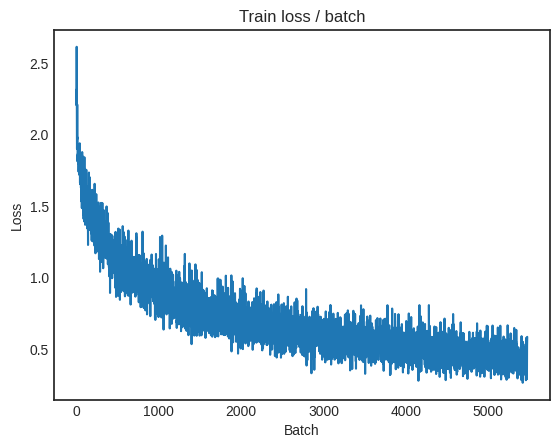

[TRAIN Batch 200/391]	Time 0.025s (0.051s)	Loss 0.4505 (0.4199)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 ( 99.5)


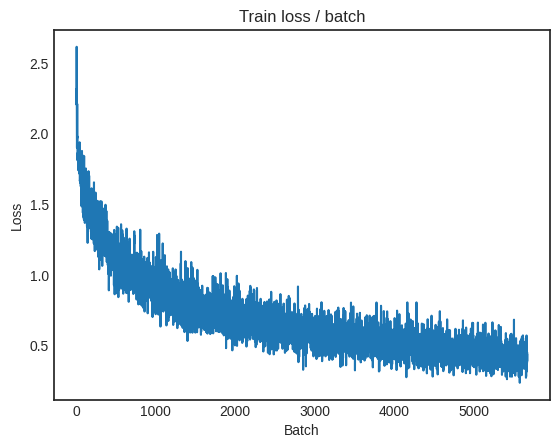


===============> Total time 18s	Avg loss 0.4255	Avg Prec@1 85.11 %	Avg Prec@5 99.44 %

[EVAL Batch 000/079]	Time 0.333s (0.333s)	Loss 0.6661 (0.6661)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5855	Avg Prec@1 79.89 %	Avg Prec@5 98.92 %



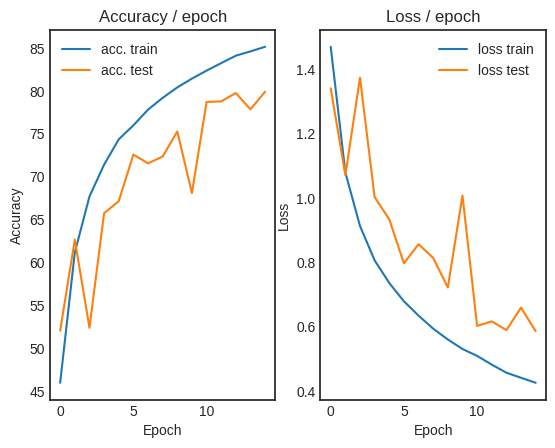

 75%|███████▌  | 15/20 [05:37<01:52, 22.54s/it]

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.240s (0.240s)	Loss 0.2798 (0.2798)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


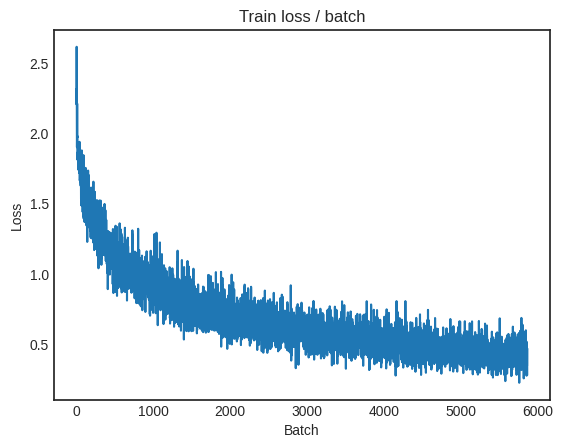

[TRAIN Batch 200/391]	Time 0.017s (0.053s)	Loss 0.3126 (0.4018)	Prec@1  86.7 ( 86.3)	Prec@5 100.0 ( 99.5)


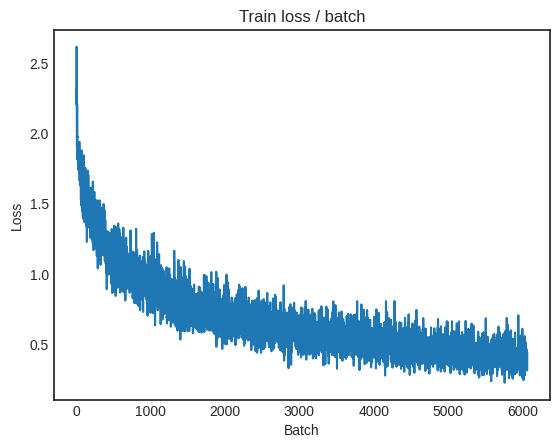


===============> Total time 19s	Avg loss 0.4044	Avg Prec@1 86.00 %	Avg Prec@5 99.49 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 0.6742 (0.6742)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.6153	Avg Prec@1 79.04 %	Avg Prec@5 98.83 %



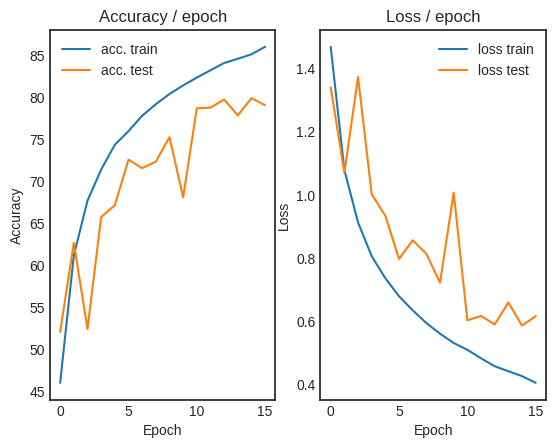

 80%|████████  | 16/20 [06:01<01:31, 22.84s/it]

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.243s (0.243s)	Loss 0.4028 (0.4028)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


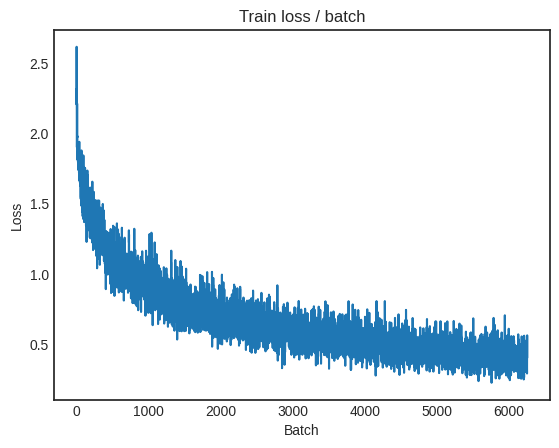

[TRAIN Batch 200/391]	Time 0.047s (0.047s)	Loss 0.3736 (0.3901)	Prec@1  83.6 ( 86.4)	Prec@5 100.0 ( 99.5)


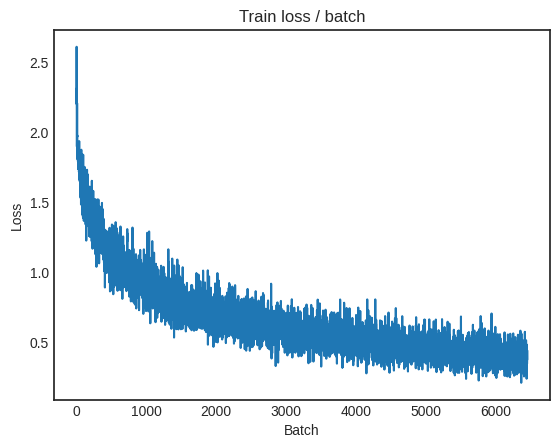


===============> Total time 19s	Avg loss 0.3902	Avg Prec@1 86.42 %	Avg Prec@5 99.51 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 0.6034 (0.6034)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.5848	Avg Prec@1 79.78 %	Avg Prec@5 98.86 %



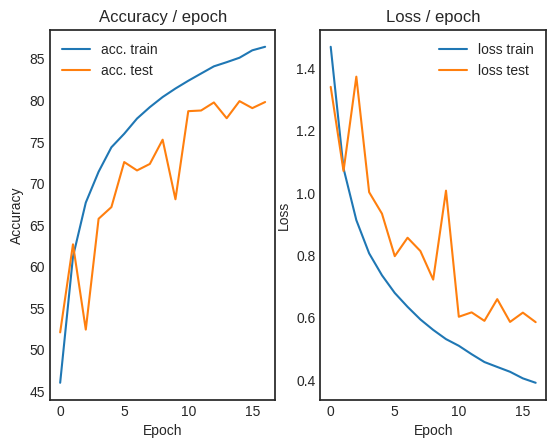

 85%|████████▌ | 17/20 [06:23<01:07, 22.62s/it]

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.240s (0.240s)	Loss 0.3357 (0.3357)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


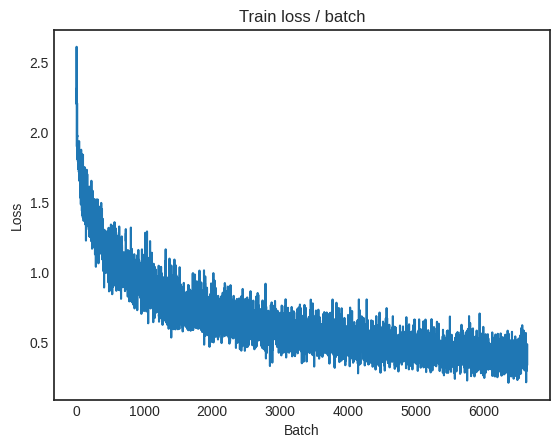

[TRAIN Batch 200/391]	Time 0.059s (0.052s)	Loss 0.3267 (0.3757)	Prec@1  92.2 ( 87.1)	Prec@5 100.0 ( 99.5)


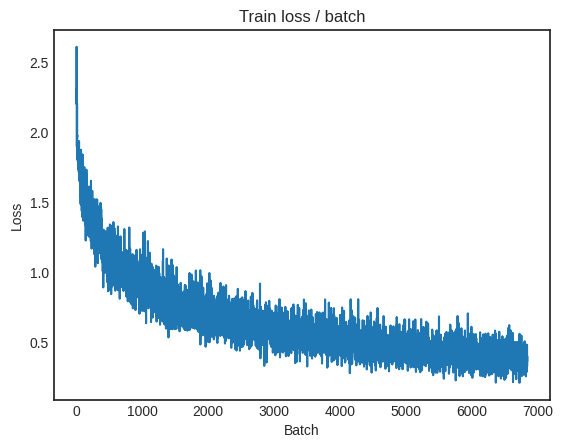


===============> Total time 21s	Avg loss 0.3795	Avg Prec@1 86.83 %	Avg Prec@5 99.51 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 0.5651 (0.5651)	Prec@1  82.0 ( 82.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.5688	Avg Prec@1 80.81 %	Avg Prec@5 99.03 %



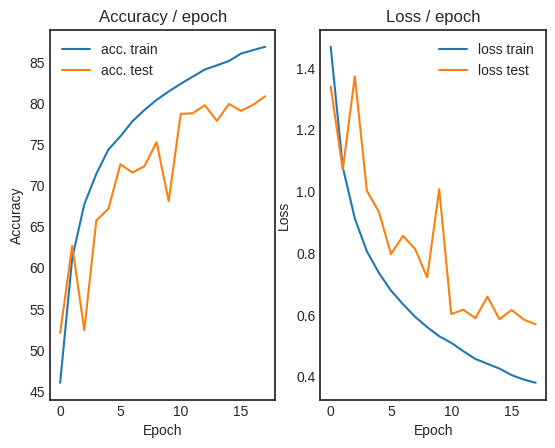

 90%|█████████ | 18/20 [06:48<00:46, 23.22s/it]

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.255s (0.255s)	Loss 0.4021 (0.4021)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


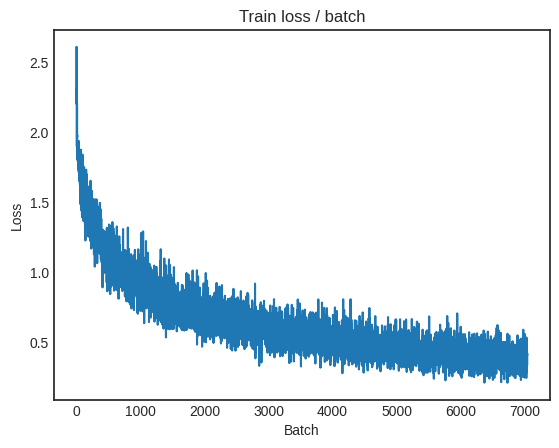

[TRAIN Batch 200/391]	Time 0.009s (0.052s)	Loss 0.3268 (0.3640)	Prec@1  91.4 ( 87.3)	Prec@5 100.0 ( 99.5)


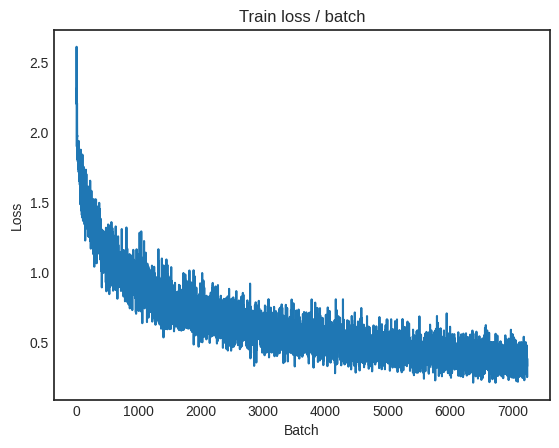


===============> Total time 19s	Avg loss 0.3653	Avg Prec@1 87.27 %	Avg Prec@5 99.56 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 0.5459 (0.5459)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.5525	Avg Prec@1 81.31 %	Avg Prec@5 99.08 %



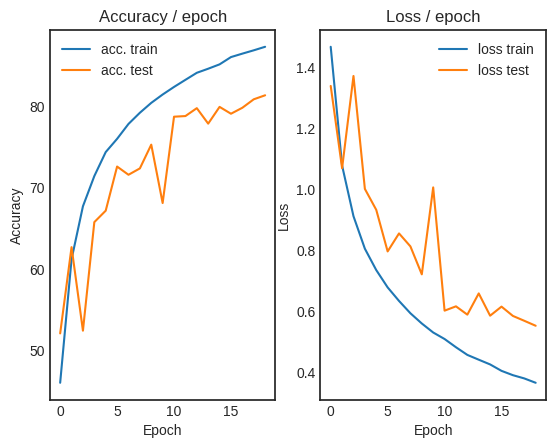

 95%|█████████▌| 19/20 [07:11<00:23, 23.15s/it]

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.237s (0.237s)	Loss 0.2496 (0.2496)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


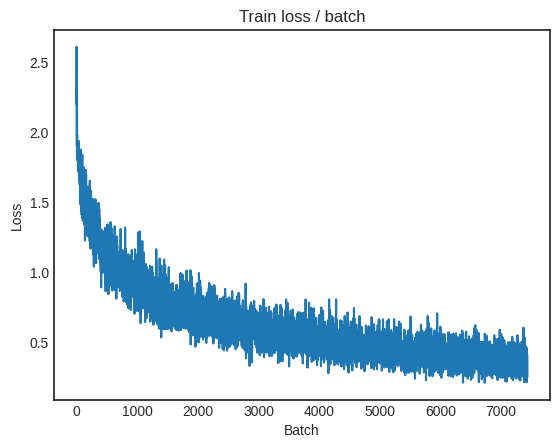

[TRAIN Batch 200/391]	Time 0.082s (0.052s)	Loss 0.2541 (0.3452)	Prec@1  88.3 ( 88.0)	Prec@5 100.0 ( 99.6)


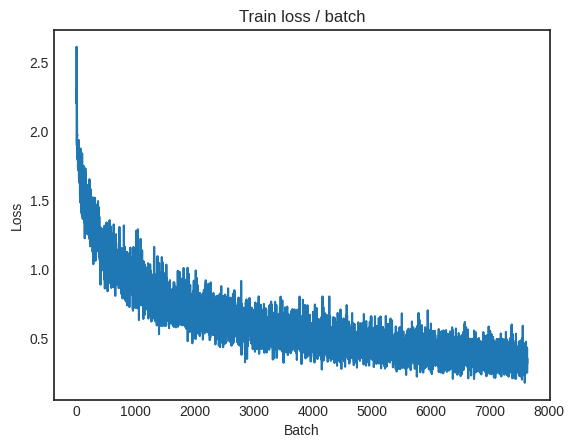


===============> Total time 20s	Avg loss 0.3484	Avg Prec@1 87.86 %	Avg Prec@5 99.63 %

[EVAL Batch 000/079]	Time 0.177s (0.177s)	Loss 0.5749 (0.5749)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.5741	Avg Prec@1 80.53 %	Avg Prec@5 98.88 %



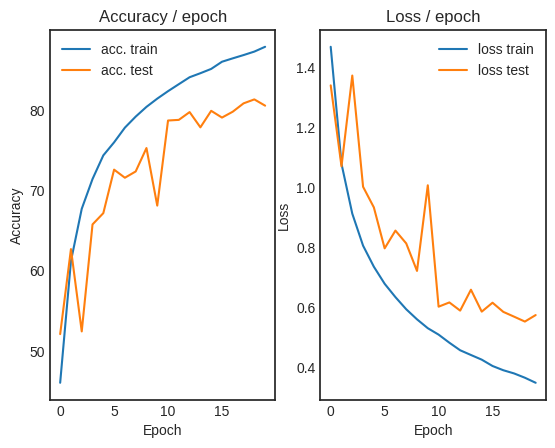

100%|██████████| 20/20 [07:34<00:00, 22.71s/it]


In [55]:
main_CIFAR_batch(cuda=True)